# Movie Recommendation System

In [2]:
import warnings
warnings.filterwarnings('ignore')

### import of the necessary library 

In [3]:
import pymongo
from pprint import pprint 
from bson.objectid import ObjectId 
import string
import operator
import re
import csv
import numpy as np
import seaborn as sns 

print (pymongo.version)

4.0.2


In [4]:
import pymongo
client = pymongo.MongoClient('mongodb://localhost:27017/')

In [5]:
#connect to the database
mydatabase = client['Coursework']
print(mydatabase)

Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'Coursework')


In [6]:
#connecting to the collections 
connectcollections = mydatabase['movies']
print(connectcollections)

Collection(Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'Coursework'), 'movies')


In [7]:
#connecting to the collections 
connectcollections1 = mydatabase['ratings']
print(connectcollections1)

Collection(Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'Coursework'), 'ratings')


In [8]:
import pandas as pd

In [9]:
movies_df = pd.read_csv('movies.csv')

In [10]:
movies_df

,movieId,title,genres,Unnamed: 32
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,NaN
1,2,Jumanji (1995),Adventure|Children|Fantasy,NaN
2,3,Grumpier Old Men (1995),Comedy|Romance,NaN
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,NaN
4,5,Father of the Bride Part II (1995),Comedy,NaN
...,...,...,...,...
9737,193581,Black Butler: Book of the Atlantic (2017),Action|Animation|Comedy|Fantasy,NaN
9738,193583,No Game No Life: Zero (2017),Animation|Comedy|Fantasy,NaN
9739,193585,Flint (2017),Drama,NaN
9740,193587,Bungo Stray Dogs: Dead Apple (2018),Action|Animation,NaN


### distinct

In [11]:
connectcollections1.distinct('userId')

['1',
 '10',
 '100',
 '101',
 '102',
 '103',
 '104',
 '105',
 '106',
 '107',
 '108',
 '109',
 '11',
 '110',
 '111',
 '112',
 '113',
 '114',
 '115',
 '116',
 '117',
 '118',
 '119',
 '12',
 '120',
 '121',
 '122',
 '123',
 '124',
 '125',
 '126',
 '127',
 '128',
 '129',
 '13',
 '130',
 '131',
 '132',
 '133',
 '134',
 '135',
 '136',
 '137',
 '138',
 '139',
 '14',
 '140',
 '141',
 '142',
 '143',
 '144',
 '145',
 '146',
 '147',
 '148',
 '149',
 '15',
 '150',
 '151',
 '152',
 '153',
 '154',
 '155',
 '156',
 '157',
 '158',
 '159',
 '16',
 '160',
 '161',
 '162',
 '163',
 '164',
 '165',
 '166',
 '167',
 '168',
 '169',
 '17',
 '170',
 '171',
 '172',
 '173',
 '174',
 '175',
 '176',
 '177',
 '178',
 '179',
 '18',
 '180',
 '181',
 '182',
 '183',
 '184',
 '185',
 '186',
 '187',
 '188',
 '189',
 '19',
 '190',
 '191',
 '192',
 '193',
 '194',
 '195',
 '196',
 '197',
 '198',
 '199',
 '2',
 '20',
 '200',
 '201',
 '202',
 '203',
 '204',
 '205',
 '206',
 '207',
 '208',
 '209',
 '21',
 '210',
 '211',
 '212',


In [12]:
ratings_df = pd.read_csv('ratings.csv')

In [13]:
ratings_df

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931
...,...,...,...,...
100831,610,166534,4.0,1493848402
100832,610,168248,5.0,1493850091
100833,610,168250,5.0,1494273047
100834,610,168252,5.0,1493846352


##### put together the columns for the further process

In [14]:
df = pd.merge(ratings_df, movies_df, on='movieId')
df.head()

,userId,movieId,rating,timestamp,title,genres,Unnamed: 32
0,1,1,4.0,964982703,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,NaN
1,5,1,4.0,847434962,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,NaN
2,7,1,4.5,1106635946,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,NaN
3,15,1,2.5,1510577970,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,NaN
4,17,1,4.5,1305696483,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,NaN


In [15]:
df = df.drop(columns = ['timestamp'])

In [16]:
len(df.index)

100836

representing the data on the basis of model

to know how many rows and columns are there

rows = 100836

column = 6

In [17]:
df.shape

(100836, 6)

checking of the missing value since there is unnecessary data in the dataset we need to remove it

In [18]:
df.isna().sum()

userId              0
movieId             0
rating              0
title               0
genres              0
Unnamed: 32    100836
dtype: int64

since there are null values in the column there must be the remove from the column

dropping the missing values

In [19]:
df = df.dropna(axis = 1)

for the calculation of the descriptive statistics for each variable

In [20]:
df.describe()

,userId,movieId,rating
count,100836.000000,100836.000000,100836.000000
mean,326.127564,19435.295718,3.501557
std,182.618491,35530.987199,1.042529
min,1.000000,1.000000,0.500000
25%,177.000000,1199.000000,3.000000
50%,325.000000,2991.000000,3.500000
75%,477.000000,8122.000000,4.000000
max,610.000000,193609.000000,5.000000


this method returns the data about the Dataframe.

the number of columns, column labels, column data types, memory use, range index, and the number of each columns are all listed here

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100836 entries, 0 to 100835
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   userId   100836 non-null  int64  
 1   movieId  100836 non-null  int64  
 2   rating   100836 non-null  float64
 3   title    100836 non-null  object 
 4   genres   100836 non-null  object 
dtypes: float64(1), int64(2), object(2)
memory usage: 4.6+ MB


since we have removed the necessary columns so there is no null values left in the rows. 

In [22]:
df.isna().sum() 

userId     0
movieId    0
rating     0
title      0
genres     0
dtype: int64

the data visualization allows us to see how variables are distributed and how they are related in a dataset. the data preparation procedures to use prior to modeling and which algorithms are best suited to the data. the seaborn module is a python module for statistical plotting that is built on top of matplotlib.

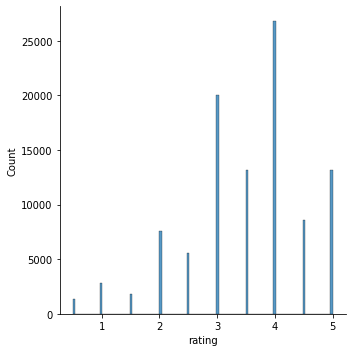

In [23]:
sns.displot(df['rating'])

the countplot is used to show the number of times an observation appears in the ratings. it is quite simple to display the number of times the items appears and is dependent on a certain sort of category.

<AxesSubplot:xlabel='rating', ylabel='count'>

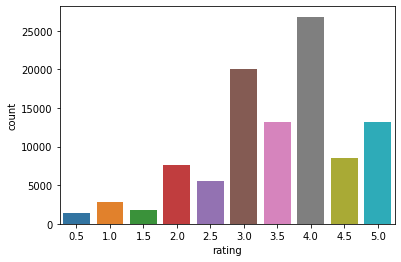

In [24]:
sns.countplot(df['rating'])

the linear line across the plot is the best match for the trend of the average rating given by the user in relation to the userid. the outliers in the dataset are the data points in the top right corner that are far away from the line. if we look attentively, we may see a shadow converging towards the center which contains a portion of our data. the statistical mean is what this convergent point is.

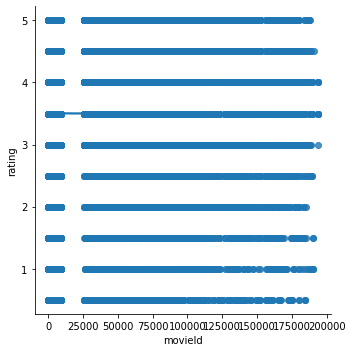

In [25]:
sns.lmplot(x="movieId", y="rating", data = df)

it basically creates the jointplot between all the possible numerical columns. the pair plot is used to figure out which attributes are best for explaining the relationship between the two variables for formating the most separated groups.

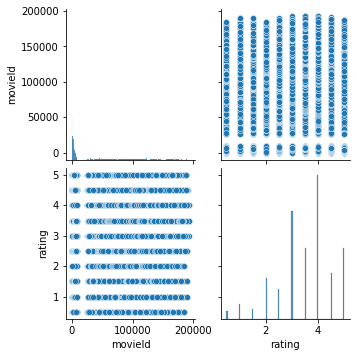

In [26]:
sns.pairplot(df[['movieId','rating']])

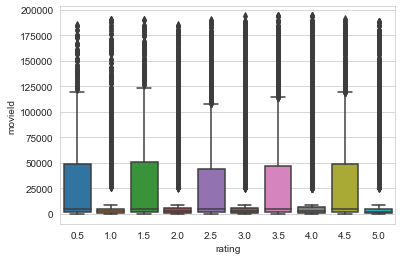

In [27]:
sns.set_style('whitegrid')
ax= sns.boxplot(x='rating',y='movieId',data=df)

<AxesSubplot:xlabel='rating'>

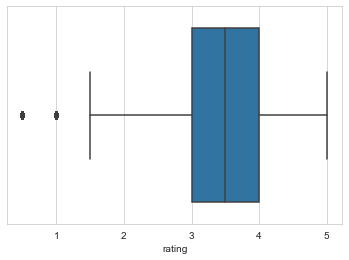

In [28]:
sns.boxplot(df['rating'])

selecting the features and dropping according to the study and keeping the columns which are necessary for further receommendations process

In [29]:
combine_movie_rating= df.dropna(axis = 0, subset=['title'])


In [30]:
df =df.drop(columns =['genres'])
df.head()

,userId,movieId,rating,title
0,1,1,4.0,Toy Story (1995)
1,5,1,4.0,Toy Story (1995)
2,7,1,4.5,Toy Story (1995)
3,15,1,2.5,Toy Story (1995)
4,17,1,4.5,Toy Story (1995)


In [31]:
movie_ratingCount = (df.groupby(by =['title'])['rating'].count().reset_index().rename(columns = {'rating':'totalRatingCount'})[['title', 'totalRatingCount']])

In [32]:
movie_ratingCount.head()

,title,totalRatingCount
0,'71 (2014),1
1,'Hellboy': The Seeds of Creation (2004),1
2,'Round Midnight (1986),2
3,'Salem's Lot (2004),1
4,'Til There Was You (1997),2


In [33]:
import matplotlib.pyplot as plt

# Bargraph 

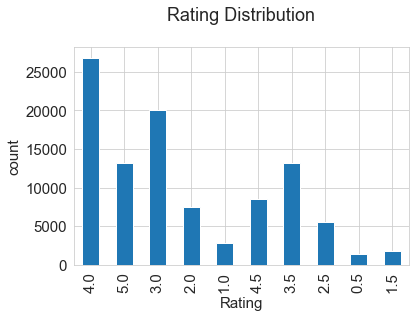

In [34]:
plt.rc("font", size = 15)
ratings_df.rating.value_counts(sort = False).plot(kind = 'bar')
plt.title('Rating Distribution\n')
plt.xlabel('Rating')
plt.ylabel('count')
plt.show()

In [35]:
rating_with_totalRatingCount = pd.merge(df, movie_ratingCount[['title','totalRatingCount']], on = 'title')

In [36]:
rating_with_totalRatingCount.head()

,userId,movieId,rating,title,totalRatingCount
0,1,1,4.0,Toy Story (1995),215
1,5,1,4.0,Toy Story (1995),215
2,7,1,4.5,Toy Story (1995),215
3,15,1,2.5,Toy Story (1995),215
4,17,1,4.5,Toy Story (1995),215


describe() function makes a summary of the statistics about the columns in dataframe

In [37]:
movie_ratingCount.describe()

,totalRatingCount
count,9719.000000
mean,10.375141
std,22.406220
min,1.000000
25%,1.000000
50%,3.000000
75%,9.000000
max,329.000000


if there are two users exceeds the certain level they are considered similar.in cf based recommendation the similarity threshold is the lowest level of similarity between the users that determines whether two users are considered similar or not. So here the threshold is set to 50 accordingly. 

In [38]:
popularity_threshold = 50
rating_popular_movie = rating_with_totalRatingCount.query('totalRatingCount >= @popularity_threshold')

rating_popular_movie.head()

,userId,movieId,rating,title,totalRatingCount
0,1,1,4.0,Toy Story (1995),215
1,5,1,4.0,Toy Story (1995),215
2,7,1,4.5,Toy Story (1995),215
3,15,1,2.5,Toy Story (1995),215
4,17,1,4.5,Toy Story (1995),215


In [39]:
rating_popular_movie.shape

(41362, 5)

In [40]:
movie_features_df = rating_popular_movie.pivot_table(index = 'title', columns = 'userId', values = 'rating').fillna(0)

In [41]:
from scipy.sparse import csr_matrix

movie_features_df_matrix = csr_matrix(movie_features_df.values)

### use of metric cosine and algorithm brute 
 
 # Model fitting

In [42]:
from sklearn.neighbors import NearestNeighbors

model_knn = NearestNeighbors(metric = 'cosine', algorithm = 'brute')
model_knn.fit(movie_features_df_matrix)

NearestNeighbors(algorithm='brute', metric='cosine')

In [43]:
movie_features_df.shape

(450, 606)

In [44]:
def function(movie_name):
    distances, indices = model_knn.kneighbors(movie_features_df.loc[movie_name,:].values.reshape(1,-1), n_neighbors = 11)
    
    return distances, indices

In [45]:
movie_name = input("enter a movie name: ")


enter a movie name: Toy Story (1995)


### final process for the recommendation explained in report

In [46]:
distances, indices = function(movie_name)

ind = indices.flatten()
dist = distances.flatten()

recommended_movie =[]

In [47]:
for i in range(0, len(distances.flatten())):
    if i == 0:
        
        print(f'recommendations for {movie_name}:\n')
        
    else:
        print(f' {i}: {movie_features_df.index[ind[i]]}, {dist[i]}')
        recommended_movie.append(movie_features_df.index[ind[i]])
        

recommendations for Toy Story (1995):

 1: Toy Story 2 (1999), 0.4273987396802844
 2: Jurassic Park (1993), 0.4343631959138433
 3: Independence Day (a.k.a. ID4) (1996), 0.43573830647233425
 4: Star Wars: Episode IV - A New Hope (1977), 0.4426118294200634
 5: Forrest Gump (1994), 0.4529040920598262
 6: Lion King, The (1994), 0.4588546505397667
 7: Star Wars: Episode VI - Return of the Jedi (1983), 0.4589106952274158
 8: Mission: Impossible (1996), 0.46108722944164227
 9: Groundhog Day (1993), 0.465831237415656
 10: Back to the Future (1985), 0.46961865347827914


# Pymongo

### greater than

In [48]:
for x in connectcollections1.find({"rating": {"$gte": '2'}}):
    print(x)

{'_id': ObjectId('62568718a7e632f04dc551cb'), 'userId': '1', 'movieId': '1', 'rating': '4.0', 'timestamp': '964982703'}
{'_id': ObjectId('62568718a7e632f04dc551cc'), 'userId': '1', 'movieId': '3', 'rating': '4.0', 'timestamp': '964981247'}
{'_id': ObjectId('62568718a7e632f04dc551cd'), 'userId': '1', 'movieId': '6', 'rating': '4.0', 'timestamp': '964982224'}
{'_id': ObjectId('62568718a7e632f04dc551ce'), 'userId': '1', 'movieId': '47', 'rating': '5.0', 'timestamp': '964983815'}
{'_id': ObjectId('62568718a7e632f04dc551cf'), 'userId': '1', 'movieId': '50', 'rating': '5.0', 'timestamp': '964982931'}
{'_id': ObjectId('62568718a7e632f04dc551d0'), 'userId': '1', 'movieId': '70', 'rating': '3.0', 'timestamp': '964982400'}
{'_id': ObjectId('62568718a7e632f04dc551d1'), 'userId': '1', 'movieId': '101', 'rating': '5.0', 'timestamp': '964980868'}
{'_id': ObjectId('62568718a7e632f04dc551d2'), 'userId': '1', 'movieId': '110', 'rating': '4.0', 'timestamp': '964982176'}
{'_id': ObjectId('62568718a7e632f

{'_id': ObjectId('62568718a7e632f04dc55230'), 'userId': '1', 'movieId': '1580', 'rating': '3.0', 'timestamp': '964981125'}
{'_id': ObjectId('62568718a7e632f04dc55231'), 'userId': '1', 'movieId': '1587', 'rating': '5.0', 'timestamp': '964982346'}
{'_id': ObjectId('62568718a7e632f04dc55232'), 'userId': '1', 'movieId': '1617', 'rating': '5.0', 'timestamp': '964982951'}
{'_id': ObjectId('62568718a7e632f04dc55233'), 'userId': '1', 'movieId': '1620', 'rating': '4.0', 'timestamp': '964983056'}
{'_id': ObjectId('62568718a7e632f04dc55234'), 'userId': '1', 'movieId': '1625', 'rating': '5.0', 'timestamp': '964983504'}
{'_id': ObjectId('62568718a7e632f04dc55235'), 'userId': '1', 'movieId': '1644', 'rating': '3.0', 'timestamp': '964983536'}
{'_id': ObjectId('62568718a7e632f04dc55236'), 'userId': '1', 'movieId': '1676', 'rating': '3.0', 'timestamp': '964982620'}
{'_id': ObjectId('62568718a7e632f04dc55237'), 'userId': '1', 'movieId': '1732', 'rating': '5.0', 'timestamp': '964981125'}
{'_id': ObjectId

{'_id': ObjectId('62568718a7e632f04dc554d3'), 'userId': '6', 'movieId': '493', 'rating': '3.0', 'timestamp': '845555172'}
{'_id': ObjectId('62568718a7e632f04dc554d4'), 'userId': '6', 'movieId': '494', 'rating': '3.0', 'timestamp': '845554176'}
{'_id': ObjectId('62568718a7e632f04dc554d5'), 'userId': '6', 'movieId': '497', 'rating': '3.0', 'timestamp': '845553819'}
{'_id': ObjectId('62568718a7e632f04dc554d6'), 'userId': '6', 'movieId': '500', 'rating': '5.0', 'timestamp': '845553354'}
{'_id': ObjectId('62568718a7e632f04dc554d7'), 'userId': '6', 'movieId': '502', 'rating': '3.0', 'timestamp': '845554455'}
{'_id': ObjectId('62568718a7e632f04dc554d8'), 'userId': '6', 'movieId': '505', 'rating': '3.0', 'timestamp': '845555317'}
{'_id': ObjectId('62568718a7e632f04dc554d9'), 'userId': '6', 'movieId': '508', 'rating': '4.0', 'timestamp': '845553586'}
{'_id': ObjectId('62568718a7e632f04dc554da'), 'userId': '6', 'movieId': '509', 'rating': '3.0', 'timestamp': '845553522'}
{'_id': ObjectId('625687

{'_id': ObjectId('62568718a7e632f04dc55695'), 'userId': '10', 'movieId': '88163', 'rating': '4.0', 'timestamp': '1455357504'}
{'_id': ObjectId('62568718a7e632f04dc55696'), 'userId': '10', 'movieId': '88810', 'rating': '3.0', 'timestamp': '1455399281'}
{'_id': ObjectId('62568718a7e632f04dc55697'), 'userId': '10', 'movieId': '91104', 'rating': '3.0', 'timestamp': '1455356990'}
{'_id': ObjectId('62568718a7e632f04dc55698'), 'userId': '10', 'movieId': '91529', 'rating': '5.0', 'timestamp': '1455302120'}
{'_id': ObjectId('62568718a7e632f04dc55699'), 'userId': '10', 'movieId': '92259', 'rating': '5.0', 'timestamp': '1455301553'}
{'_id': ObjectId('62568718a7e632f04dc5569a'), 'userId': '10', 'movieId': '94070', 'rating': '4.5', 'timestamp': '1455357387'}
{'_id': ObjectId('62568718a7e632f04dc5569b'), 'userId': '10', 'movieId': '95167', 'rating': '4.0', 'timestamp': '1455398177'}
{'_id': ObjectId('62568718a7e632f04dc5569c'), 'userId': '10', 'movieId': '95449', 'rating': '4.0', 'timestamp': '14553

{'_id': ObjectId('62568718a7e632f04dc558a0'), 'userId': '17', 'movieId': '5971', 'rating': '4.0', 'timestamp': '1326943200'}
{'_id': ObjectId('62568718a7e632f04dc558a1'), 'userId': '17', 'movieId': '6016', 'rating': '4.5', 'timestamp': '1322628668'}
{'_id': ObjectId('62568718a7e632f04dc558a2'), 'userId': '17', 'movieId': '6350', 'rating': '5.0', 'timestamp': '1322628881'}
{'_id': ObjectId('62568718a7e632f04dc558a3'), 'userId': '17', 'movieId': '6870', 'rating': '3.5', 'timestamp': '1322629189'}
{'_id': ObjectId('62568718a7e632f04dc558a4'), 'userId': '17', 'movieId': '7099', 'rating': '5.0', 'timestamp': '1322628786'}
{'_id': ObjectId('62568718a7e632f04dc558a5'), 'userId': '17', 'movieId': '7153', 'rating': '4.5', 'timestamp': '1305696820'}
{'_id': ObjectId('62568718a7e632f04dc558a6'), 'userId': '17', 'movieId': '7482', 'rating': '4.0', 'timestamp': '1305696864'}
{'_id': ObjectId('62568718a7e632f04dc558a7'), 'userId': '17', 'movieId': '27773', 'rating': '4.0', 'timestamp': '1322628790'}

{'_id': ObjectId('62568718a7e632f04dc55a3c'), 'userId': '18', 'movieId': '78499', 'rating': '4.0', 'timestamp': '1456744760'}
{'_id': ObjectId('62568718a7e632f04dc55a3d'), 'userId': '18', 'movieId': '79132', 'rating': '4.5', 'timestamp': '1455050059'}
{'_id': ObjectId('62568718a7e632f04dc55a3e'), 'userId': '18', 'movieId': '79293', 'rating': '3.0', 'timestamp': '1478366123'}
{'_id': ObjectId('62568718a7e632f04dc55a3f'), 'userId': '18', 'movieId': '79592', 'rating': '3.0', 'timestamp': '1456924960'}
{'_id': ObjectId('62568718a7e632f04dc55a40'), 'userId': '18', 'movieId': '79695', 'rating': '3.5', 'timestamp': '1455750029'}
{'_id': ObjectId('62568718a7e632f04dc55a41'), 'userId': '18', 'movieId': '79702', 'rating': '4.0', 'timestamp': '1455051182'}
{'_id': ObjectId('62568718a7e632f04dc55a42'), 'userId': '18', 'movieId': '80219', 'rating': '3.5', 'timestamp': '1455749571'}
{'_id': ObjectId('62568718a7e632f04dc55a43'), 'userId': '18', 'movieId': '80489', 'rating': '4.0', 'timestamp': '14636

{'_id': ObjectId('62568718a7e632f04dc55b44'), 'userId': '19', 'movieId': '785', 'rating': '2.0', 'timestamp': '965706209'}
{'_id': ObjectId('62568718a7e632f04dc55b45'), 'userId': '19', 'movieId': '788', 'rating': '2.0', 'timestamp': '965703885'}
{'_id': ObjectId('62568718a7e632f04dc55b46'), 'userId': '19', 'movieId': '798', 'rating': '2.0', 'timestamp': '965710019'}
{'_id': ObjectId('62568718a7e632f04dc55b47'), 'userId': '19', 'movieId': '799', 'rating': '3.0', 'timestamp': '965705040'}
{'_id': ObjectId('62568718a7e632f04dc55b49'), 'userId': '19', 'movieId': '818', 'rating': '4.0', 'timestamp': '965707552'}
{'_id': ObjectId('62568718a7e632f04dc55b4a'), 'userId': '19', 'movieId': '829', 'rating': '2.0', 'timestamp': '965706415'}
{'_id': ObjectId('62568718a7e632f04dc55b4b'), 'userId': '19', 'movieId': '830', 'rating': '2.0', 'timestamp': '965707016'}
{'_id': ObjectId('62568718a7e632f04dc55b4c'), 'userId': '19', 'movieId': '832', 'rating': '2.0', 'timestamp': '965711184'}
{'_id': ObjectId

{'_id': ObjectId('62568718a7e632f04dc55c7e'), 'userId': '19', 'movieId': '2418', 'rating': '2.0', 'timestamp': '965707101'}
{'_id': ObjectId('62568718a7e632f04dc55c7f'), 'userId': '19', 'movieId': '2423', 'rating': '4.0', 'timestamp': '965706337'}
{'_id': ObjectId('62568718a7e632f04dc55c80'), 'userId': '19', 'movieId': '2424', 'rating': '2.0', 'timestamp': '965706771'}
{'_id': ObjectId('62568718a7e632f04dc55c81'), 'userId': '19', 'movieId': '2428', 'rating': '3.0', 'timestamp': '965703915'}
{'_id': ObjectId('62568718a7e632f04dc55c82'), 'userId': '19', 'movieId': '2446', 'rating': '2.0', 'timestamp': '965711873'}
{'_id': ObjectId('62568718a7e632f04dc55c83'), 'userId': '19', 'movieId': '2450', 'rating': '2.0', 'timestamp': '965710039'}
{'_id': ObjectId('62568718a7e632f04dc55c84'), 'userId': '19', 'movieId': '2453', 'rating': '3.0', 'timestamp': '965704304'}
{'_id': ObjectId('62568718a7e632f04dc55c85'), 'userId': '19', 'movieId': '2455', 'rating': '2.0', 'timestamp': '965703698'}
{'_id': 

{'_id': ObjectId('62568718a7e632f04dc55d4c'), 'userId': '19', 'movieId': '3692', 'rating': '3.0', 'timestamp': '965702660'}
{'_id': ObjectId('62568718a7e632f04dc55d4d'), 'userId': '19', 'movieId': '3693', 'rating': '2.0', 'timestamp': '965706728'}
{'_id': ObjectId('62568718a7e632f04dc55d4e'), 'userId': '19', 'movieId': '3698', 'rating': '2.0', 'timestamp': '965703756'}
{'_id': ObjectId('62568718a7e632f04dc55d4f'), 'userId': '19', 'movieId': '3699', 'rating': '2.0', 'timestamp': '965703811'}
{'_id': ObjectId('62568718a7e632f04dc55d50'), 'userId': '19', 'movieId': '3701', 'rating': '2.0', 'timestamp': '965703756'}
{'_id': ObjectId('62568718a7e632f04dc55d51'), 'userId': '19', 'movieId': '3704', 'rating': '2.0', 'timestamp': '965703756'}
{'_id': ObjectId('62568718a7e632f04dc55d52'), 'userId': '19', 'movieId': '3705', 'rating': '2.0', 'timestamp': '965710092'}
{'_id': ObjectId('62568718a7e632f04dc55d53'), 'userId': '19', 'movieId': '3706', 'rating': '3.0', 'timestamp': '965711128'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc55db8'), 'userId': '20', 'movieId': '2092', 'rating': '3.0', 'timestamp': '1054147515'}
{'_id': ObjectId('62568719a7e632f04dc55db9'), 'userId': '20', 'movieId': '2096', 'rating': '4.0', 'timestamp': '1054038145'}
{'_id': ObjectId('62568719a7e632f04dc55dba'), 'userId': '20', 'movieId': '2100', 'rating': '3.5', 'timestamp': '1054036178'}
{'_id': ObjectId('62568719a7e632f04dc55dbb'), 'userId': '20', 'movieId': '2116', 'rating': '2.5', 'timestamp': '1054038315'}
{'_id': ObjectId('62568719a7e632f04dc55dbc'), 'userId': '20', 'movieId': '2135', 'rating': '5.0', 'timestamp': '1054147519'}
{'_id': ObjectId('62568719a7e632f04dc55dbd'), 'userId': '20', 'movieId': '2137', 'rating': '4.5', 'timestamp': '1054038124'}
{'_id': ObjectId('62568719a7e632f04dc55dbe'), 'userId': '20', 'movieId': '2140', 'rating': '4.0', 'timestamp': '1054038148'}
{'_id': ObjectId('62568719a7e632f04dc55dbf'), 'userId': '20', 'movieId': '2141', 'rating': '4.5', 'timestamp': '1054038233'}


{'_id': ObjectId('62568719a7e632f04dc55ed2'), 'userId': '21', 'movieId': '3633', 'rating': '4.5', 'timestamp': '1403460850'}
{'_id': ObjectId('62568719a7e632f04dc55ed3'), 'userId': '21', 'movieId': '3635', 'rating': '4.5', 'timestamp': '1403459821'}
{'_id': ObjectId('62568719a7e632f04dc55ed4'), 'userId': '21', 'movieId': '3638', 'rating': '4.5', 'timestamp': '1403459801'}
{'_id': ObjectId('62568719a7e632f04dc55ed5'), 'userId': '21', 'movieId': '3639', 'rating': '4.5', 'timestamp': '1403459833'}
{'_id': ObjectId('62568719a7e632f04dc55ed6'), 'userId': '21', 'movieId': '3697', 'rating': '2.5', 'timestamp': '1468113456'}
{'_id': ObjectId('62568719a7e632f04dc55ed7'), 'userId': '21', 'movieId': '3793', 'rating': '3.5', 'timestamp': '1441392970'}
{'_id': ObjectId('62568719a7e632f04dc55ed8'), 'userId': '21', 'movieId': '3868', 'rating': '4.0', 'timestamp': '1403460977'}
{'_id': ObjectId('62568719a7e632f04dc55ed9'), 'userId': '21', 'movieId': '3869', 'rating': '4.0', 'timestamp': '1403460993'}


{'_id': ObjectId('62568719a7e632f04dc56110'), 'userId': '24', 'movieId': '318', 'rating': '4.5', 'timestamp': '1458941989'}
{'_id': ObjectId('62568719a7e632f04dc56111'), 'userId': '24', 'movieId': '356', 'rating': '4.5', 'timestamp': '1458940987'}
{'_id': ObjectId('62568719a7e632f04dc56112'), 'userId': '24', 'movieId': '457', 'rating': '3.5', 'timestamp': '1458941545'}
{'_id': ObjectId('62568719a7e632f04dc56113'), 'userId': '24', 'movieId': '552', 'rating': '3.5', 'timestamp': '1458941837'}
{'_id': ObjectId('62568719a7e632f04dc56114'), 'userId': '24', 'movieId': '593', 'rating': '4.5', 'timestamp': '1458941983'}
{'_id': ObjectId('62568719a7e632f04dc56115'), 'userId': '24', 'movieId': '608', 'rating': '4.0', 'timestamp': '1458942040'}
{'_id': ObjectId('62568719a7e632f04dc56116'), 'userId': '24', 'movieId': '733', 'rating': '3.0', 'timestamp': '1458941618'}
{'_id': ObjectId('62568719a7e632f04dc56117'), 'userId': '24', 'movieId': '780', 'rating': '3.5', 'timestamp': '1458942032'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc562a1'), 'userId': '28', 'movieId': '1527', 'rating': '4.5', 'timestamp': '1234336847'}
{'_id': ObjectId('62568719a7e632f04dc562a2'), 'userId': '28', 'movieId': '1580', 'rating': '3.0', 'timestamp': '1234516117'}
{'_id': ObjectId('62568719a7e632f04dc562a3'), 'userId': '28', 'movieId': '1584', 'rating': '3.5', 'timestamp': '1242290563'}
{'_id': ObjectId('62568719a7e632f04dc562a4'), 'userId': '28', 'movieId': '1587', 'rating': '2.5', 'timestamp': '1234516422'}
{'_id': ObjectId('62568719a7e632f04dc562a5'), 'userId': '28', 'movieId': '1590', 'rating': '3.0', 'timestamp': '1277002267'}
{'_id': ObjectId('62568719a7e632f04dc562a6'), 'userId': '28', 'movieId': '1608', 'rating': '2.0', 'timestamp': '1242290718'}
{'_id': ObjectId('62568719a7e632f04dc562a7'), 'userId': '28', 'movieId': '1610', 'rating': '4.5', 'timestamp': '1234515687'}
{'_id': ObjectId('62568719a7e632f04dc562a8'), 'userId': '28', 'movieId': '1617', 'rating': '3.0', 'timestamp': '1235975955'}


{'_id': ObjectId('62568719a7e632f04dc56385'), 'userId': '28', 'movieId': '8010', 'rating': '4.0', 'timestamp': '1235806217'}
{'_id': ObjectId('62568719a7e632f04dc56386'), 'userId': '28', 'movieId': '8132', 'rating': '4.0', 'timestamp': '1234570622'}
{'_id': ObjectId('62568719a7e632f04dc56387'), 'userId': '28', 'movieId': '8207', 'rating': '3.5', 'timestamp': '1234338471'}
{'_id': ObjectId('62568719a7e632f04dc56388'), 'userId': '28', 'movieId': '8361', 'rating': '2.5', 'timestamp': '1234516204'}
{'_id': ObjectId('62568719a7e632f04dc56389'), 'userId': '28', 'movieId': '8378', 'rating': '4.0', 'timestamp': '1242290283'}
{'_id': ObjectId('62568719a7e632f04dc5638a'), 'userId': '28', 'movieId': '8493', 'rating': '3.0', 'timestamp': '1237619403'}
{'_id': ObjectId('62568719a7e632f04dc5638b'), 'userId': '28', 'movieId': '8495', 'rating': '2.5', 'timestamp': '1236311537'}
{'_id': ObjectId('62568719a7e632f04dc5638c'), 'userId': '28', 'movieId': '8633', 'rating': '4.5', 'timestamp': '1234337791'}


{'_id': ObjectId('62568719a7e632f04dc56491'), 'userId': '29', 'movieId': '2872', 'rating': '4.5', 'timestamp': '1307905862'}
{'_id': ObjectId('62568719a7e632f04dc56492'), 'userId': '29', 'movieId': '2944', 'rating': '4.0', 'timestamp': '1307905845'}
{'_id': ObjectId('62568719a7e632f04dc56493'), 'userId': '29', 'movieId': '2951', 'rating': '4.5', 'timestamp': '1307907122'}
{'_id': ObjectId('62568719a7e632f04dc56494'), 'userId': '29', 'movieId': '3363', 'rating': '4.5', 'timestamp': '1362016600'}
{'_id': ObjectId('62568719a7e632f04dc56495'), 'userId': '29', 'movieId': '3441', 'rating': '3.5', 'timestamp': '1307906080'}
{'_id': ObjectId('62568719a7e632f04dc56496'), 'userId': '29', 'movieId': '3578', 'rating': '5.0', 'timestamp': '1362016881'}
{'_id': ObjectId('62568719a7e632f04dc56497'), 'userId': '29', 'movieId': '3591', 'rating': '3.0', 'timestamp': '1307906057'}
{'_id': ObjectId('62568719a7e632f04dc56498'), 'userId': '29', 'movieId': '3681', 'rating': '4.0', 'timestamp': '1307907026'}


{'_id': ObjectId('62568719a7e632f04dc56579'), 'userId': '33', 'movieId': '32', 'rating': '3.0', 'timestamp': '939647370'}
{'_id': ObjectId('62568719a7e632f04dc5657a'), 'userId': '33', 'movieId': '34', 'rating': '3.0', 'timestamp': '939646940'}
{'_id': ObjectId('62568719a7e632f04dc5657b'), 'userId': '33', 'movieId': '36', 'rating': '5.0', 'timestamp': '939715317'}
{'_id': ObjectId('62568719a7e632f04dc5657c'), 'userId': '33', 'movieId': '39', 'rating': '5.0', 'timestamp': '939654896'}
{'_id': ObjectId('62568719a7e632f04dc5657d'), 'userId': '33', 'movieId': '43', 'rating': '2.0', 'timestamp': '939716739'}
{'_id': ObjectId('62568719a7e632f04dc5657e'), 'userId': '33', 'movieId': '50', 'rating': '5.0', 'timestamp': '939646733'}
{'_id': ObjectId('62568719a7e632f04dc5657f'), 'userId': '33', 'movieId': '58', 'rating': '4.0', 'timestamp': '939646784'}
{'_id': ObjectId('62568719a7e632f04dc56580'), 'userId': '33', 'movieId': '94', 'rating': '4.0', 'timestamp': '939716218'}
{'_id': ObjectId('625687

{'_id': ObjectId('62568719a7e632f04dc5667f'), 'userId': '36', 'movieId': '548', 'rating': '3.0', 'timestamp': '1100803739'}
{'_id': ObjectId('62568719a7e632f04dc56680'), 'userId': '36', 'movieId': '552', 'rating': '2.0', 'timestamp': '1100803437'}
{'_id': ObjectId('62568719a7e632f04dc56681'), 'userId': '36', 'movieId': '904', 'rating': '3.5', 'timestamp': '1100803350'}
{'_id': ObjectId('62568719a7e632f04dc56682'), 'userId': '36', 'movieId': '908', 'rating': '3.5', 'timestamp': '1100803999'}
{'_id': ObjectId('62568719a7e632f04dc56684'), 'userId': '36', 'movieId': '996', 'rating': '2.5', 'timestamp': '1100803714'}
{'_id': ObjectId('62568719a7e632f04dc56685'), 'userId': '36', 'movieId': '1015', 'rating': '2.0', 'timestamp': '1100803711'}
{'_id': ObjectId('62568719a7e632f04dc56686'), 'userId': '36', 'movieId': '1086', 'rating': '3.5', 'timestamp': '1100803718'}
{'_id': ObjectId('62568719a7e632f04dc56687'), 'userId': '36', 'movieId': '1090', 'rating': '2.5', 'timestamp': '1100803399'}
{'_id

{'_id': ObjectId('62568719a7e632f04dc5670a'), 'userId': '38', 'movieId': '509', 'rating': '2.0', 'timestamp': '841341467'}
{'_id': ObjectId('62568719a7e632f04dc5670b'), 'userId': '38', 'movieId': '527', 'rating': '5.0', 'timestamp': '841341405'}
{'_id': ObjectId('62568719a7e632f04dc5670c'), 'userId': '38', 'movieId': '539', 'rating': '3.0', 'timestamp': '841341405'}
{'_id': ObjectId('62568719a7e632f04dc5670d'), 'userId': '38', 'movieId': '551', 'rating': '4.0', 'timestamp': '841341549'}
{'_id': ObjectId('62568719a7e632f04dc5670e'), 'userId': '38', 'movieId': '552', 'rating': '3.0', 'timestamp': '841341732'}
{'_id': ObjectId('62568719a7e632f04dc5670f'), 'userId': '38', 'movieId': '555', 'rating': '2.0', 'timestamp': '841341570'}
{'_id': ObjectId('62568719a7e632f04dc56710'), 'userId': '38', 'movieId': '585', 'rating': '3.0', 'timestamp': '841341570'}
{'_id': ObjectId('62568719a7e632f04dc56711'), 'userId': '38', 'movieId': '586', 'rating': '3.0', 'timestamp': '841341384'}
{'_id': ObjectId

{'_id': ObjectId('62568719a7e632f04dc567a5'), 'userId': '40', 'movieId': '228', 'rating': '3.0', 'timestamp': '832060190'}
{'_id': ObjectId('62568719a7e632f04dc567a6'), 'userId': '40', 'movieId': '230', 'rating': '5.0', 'timestamp': '832059458'}
{'_id': ObjectId('62568719a7e632f04dc567a8'), 'userId': '40', 'movieId': '235', 'rating': '4.0', 'timestamp': '832059293'}
{'_id': ObjectId('62568719a7e632f04dc567a9'), 'userId': '40', 'movieId': '236', 'rating': '4.0', 'timestamp': '832059137'}
{'_id': ObjectId('62568719a7e632f04dc567aa'), 'userId': '40', 'movieId': '252', 'rating': '4.0', 'timestamp': '832059273'}
{'_id': ObjectId('62568719a7e632f04dc567ab'), 'userId': '40', 'movieId': '256', 'rating': '2.0', 'timestamp': '832059371'}
{'_id': ObjectId('62568719a7e632f04dc567ac'), 'userId': '40', 'movieId': '265', 'rating': '5.0', 'timestamp': '832059293'}
{'_id': ObjectId('62568719a7e632f04dc567ad'), 'userId': '40', 'movieId': '266', 'rating': '4.0', 'timestamp': '832059080'}
{'_id': ObjectId

{'_id': ObjectId('62568719a7e632f04dc569a7'), 'userId': '42', 'movieId': '2263', 'rating': '4.0', 'timestamp': '996258924'}
{'_id': ObjectId('62568719a7e632f04dc569a8'), 'userId': '42', 'movieId': '2268', 'rating': '4.0', 'timestamp': '996216177'}
{'_id': ObjectId('62568719a7e632f04dc569a9'), 'userId': '42', 'movieId': '2278', 'rating': '5.0', 'timestamp': '996219131'}
{'_id': ObjectId('62568719a7e632f04dc569aa'), 'userId': '42', 'movieId': '2294', 'rating': '3.0', 'timestamp': '996218757'}
{'_id': ObjectId('62568719a7e632f04dc569ab'), 'userId': '42', 'movieId': '2297', 'rating': '4.0', 'timestamp': '996221323'}
{'_id': ObjectId('62568719a7e632f04dc569ac'), 'userId': '42', 'movieId': '2302', 'rating': '4.0', 'timestamp': '996218443'}
{'_id': ObjectId('62568719a7e632f04dc569ad'), 'userId': '42', 'movieId': '2306', 'rating': '3.0', 'timestamp': '996256541'}
{'_id': ObjectId('62568719a7e632f04dc569ae'), 'userId': '42', 'movieId': '2311', 'rating': '4.0', 'timestamp': '996259554'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc56b31'), 'userId': '45', 'movieId': '186', 'rating': '3.5', 'timestamp': '1121724898'}
{'_id': ObjectId('62568719a7e632f04dc56b32'), 'userId': '45', 'movieId': '216', 'rating': '5.0', 'timestamp': '950724820'}
{'_id': ObjectId('62568719a7e632f04dc56b33'), 'userId': '45', 'movieId': '223', 'rating': '5.0', 'timestamp': '1007995016'}
{'_id': ObjectId('62568719a7e632f04dc56b34'), 'userId': '45', 'movieId': '231', 'rating': '5.0', 'timestamp': '1091305997'}
{'_id': ObjectId('62568719a7e632f04dc56b35'), 'userId': '45', 'movieId': '248', 'rating': '2.0', 'timestamp': '951170651'}
{'_id': ObjectId('62568719a7e632f04dc56b36'), 'userId': '45', 'movieId': '252', 'rating': '4.0', 'timestamp': '951170509'}
{'_id': ObjectId('62568719a7e632f04dc56b37'), 'userId': '45', 'movieId': '260', 'rating': '5.0', 'timestamp': '950726388'}
{'_id': ObjectId('62568719a7e632f04dc56b38'), 'userId': '45', 'movieId': '261', 'rating': '3.0', 'timestamp': '959624314'}
{'_id': Objec

{'_id': ObjectId('62568719a7e632f04dc56c48'), 'userId': '45', 'movieId': '3481', 'rating': '4.0', 'timestamp': '959623988'}
{'_id': ObjectId('62568719a7e632f04dc56c49'), 'userId': '45', 'movieId': '3484', 'rating': '3.0', 'timestamp': '959624041'}
{'_id': ObjectId('62568719a7e632f04dc56c4a'), 'userId': '45', 'movieId': '3489', 'rating': '3.0', 'timestamp': '959625135'}
{'_id': ObjectId('62568719a7e632f04dc56c4b'), 'userId': '45', 'movieId': '3510', 'rating': '4.0', 'timestamp': '959624004'}
{'_id': ObjectId('62568719a7e632f04dc56c4c'), 'userId': '45', 'movieId': '3534', 'rating': '4.0', 'timestamp': '959624016'}
{'_id': ObjectId('62568719a7e632f04dc56c4d'), 'userId': '45', 'movieId': '3536', 'rating': '4.0', 'timestamp': '959624004'}
{'_id': ObjectId('62568719a7e632f04dc56c4e'), 'userId': '45', 'movieId': '3549', 'rating': '4.0', 'timestamp': '959624349'}
{'_id': ObjectId('62568719a7e632f04dc56c4f'), 'userId': '45', 'movieId': '3552', 'rating': '5.0', 'timestamp': '1020802351'}
{'_id':

{'_id': ObjectId('62568719a7e632f04dc56d3d'), 'userId': '47', 'movieId': '96811', 'rating': '4.0', 'timestamp': '1496207286'}
{'_id': ObjectId('62568719a7e632f04dc56d3e'), 'userId': '47', 'movieId': '97921', 'rating': '3.5', 'timestamp': '1496208475'}
{'_id': ObjectId('62568719a7e632f04dc56d3f'), 'userId': '47', 'movieId': '97923', 'rating': '4.0', 'timestamp': '1496206766'}
{'_id': ObjectId('62568719a7e632f04dc56d40'), 'userId': '47', 'movieId': '97938', 'rating': '3.5', 'timestamp': '1496209606'}
{'_id': ObjectId('62568719a7e632f04dc56d41'), 'userId': '47', 'movieId': '100383', 'rating': '3.5', 'timestamp': '1496208216'}
{'_id': ObjectId('62568719a7e632f04dc56d42'), 'userId': '47', 'movieId': '101525', 'rating': '3.5', 'timestamp': '1496208373'}
{'_id': ObjectId('62568719a7e632f04dc56d43'), 'userId': '47', 'movieId': '104841', 'rating': '2.0', 'timestamp': '1496205293'}
{'_id': ObjectId('62568719a7e632f04dc56d44'), 'userId': '47', 'movieId': '105504', 'rating': '3.5', 'timestamp': '1

{'_id': ObjectId('62568719a7e632f04dc56f91'), 'userId': '51', 'movieId': '2808', 'rating': '2.5', 'timestamp': '1230930262'}
{'_id': ObjectId('62568719a7e632f04dc56f92'), 'userId': '51', 'movieId': '2826', 'rating': '3.5', 'timestamp': '1230929509'}
{'_id': ObjectId('62568719a7e632f04dc56f93'), 'userId': '51', 'movieId': '2836', 'rating': '4.0', 'timestamp': '1230931123'}
{'_id': ObjectId('62568719a7e632f04dc56f94'), 'userId': '51', 'movieId': '2871', 'rating': '4.5', 'timestamp': '1230932150'}
{'_id': ObjectId('62568719a7e632f04dc56f95'), 'userId': '51', 'movieId': '2872', 'rating': '4.0', 'timestamp': '1230930257'}
{'_id': ObjectId('62568719a7e632f04dc56f96'), 'userId': '51', 'movieId': '2901', 'rating': '5.0', 'timestamp': '1230931113'}
{'_id': ObjectId('62568719a7e632f04dc56f98'), 'userId': '51', 'movieId': '2942', 'rating': '2.0', 'timestamp': '1230930252'}
{'_id': ObjectId('62568719a7e632f04dc56f99'), 'userId': '51', 'movieId': '2951', 'rating': '4.0', 'timestamp': '1230930246'}


{'_id': ObjectId('62568719a7e632f04dc571b5'), 'userId': '57', 'movieId': '951', 'rating': '4.0', 'timestamp': '969753168'}
{'_id': ObjectId('62568719a7e632f04dc571b6'), 'userId': '57', 'movieId': '955', 'rating': '5.0', 'timestamp': '965795869'}
{'_id': ObjectId('62568719a7e632f04dc571b7'), 'userId': '57', 'movieId': '969', 'rating': '4.0', 'timestamp': '965796563'}
{'_id': ObjectId('62568719a7e632f04dc571b8'), 'userId': '57', 'movieId': '991', 'rating': '3.0', 'timestamp': '965799536'}
{'_id': ObjectId('62568719a7e632f04dc571b9'), 'userId': '57', 'movieId': '994', 'rating': '4.0', 'timestamp': '972172431'}
{'_id': ObjectId('62568719a7e632f04dc571ba'), 'userId': '57', 'movieId': '999', 'rating': '2.0', 'timestamp': '972174733'}
{'_id': ObjectId('62568719a7e632f04dc571bc'), 'userId': '57', 'movieId': '1028', 'rating': '4.0', 'timestamp': '969753499'}
{'_id': ObjectId('62568719a7e632f04dc571bd'), 'userId': '57', 'movieId': '1030', 'rating': '3.0', 'timestamp': '969753973'}
{'_id': Object

{'_id': ObjectId('62568719a7e632f04dc5723b'), 'userId': '57', 'movieId': '1722', 'rating': '2.0', 'timestamp': '969754379'}
{'_id': ObjectId('62568719a7e632f04dc5723c'), 'userId': '57', 'movieId': '1726', 'rating': '2.0', 'timestamp': '972175871'}
{'_id': ObjectId('62568719a7e632f04dc5723d'), 'userId': '57', 'movieId': '1747', 'rating': '4.0', 'timestamp': '969753562'}
{'_id': ObjectId('62568719a7e632f04dc5723e'), 'userId': '57', 'movieId': '1748', 'rating': '3.0', 'timestamp': '965796495'}
{'_id': ObjectId('62568719a7e632f04dc5723f'), 'userId': '57', 'movieId': '1769', 'rating': '2.0', 'timestamp': '969754612'}
{'_id': ObjectId('62568719a7e632f04dc57240'), 'userId': '57', 'movieId': '1784', 'rating': '4.0', 'timestamp': '972172894'}
{'_id': ObjectId('62568719a7e632f04dc57241'), 'userId': '57', 'movieId': '1831', 'rating': '2.0', 'timestamp': '965798952'}
{'_id': ObjectId('62568719a7e632f04dc57242'), 'userId': '57', 'movieId': '1858', 'rating': '3.0', 'timestamp': '969754683'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc572b4'), 'userId': '57', 'movieId': '2951', 'rating': '4.0', 'timestamp': '965798574'}
{'_id': ObjectId('62568719a7e632f04dc572b5'), 'userId': '57', 'movieId': '2961', 'rating': '2.0', 'timestamp': '972175310'}
{'_id': ObjectId('62568719a7e632f04dc572b6'), 'userId': '57', 'movieId': '2968', 'rating': '4.0', 'timestamp': '965798155'}
{'_id': ObjectId('62568719a7e632f04dc572b7'), 'userId': '57', 'movieId': '2985', 'rating': '3.0', 'timestamp': '965798759'}
{'_id': ObjectId('62568719a7e632f04dc572b8'), 'userId': '57', 'movieId': '2987', 'rating': '3.0', 'timestamp': '965796062'}
{'_id': ObjectId('62568719a7e632f04dc572b9'), 'userId': '57', 'movieId': '2989', 'rating': '4.0', 'timestamp': '969754509'}
{'_id': ObjectId('62568719a7e632f04dc572ba'), 'userId': '57', 'movieId': '2990', 'rating': '2.0', 'timestamp': '969754552'}
{'_id': ObjectId('62568719a7e632f04dc572bb'), 'userId': '57', 'movieId': '2997', 'rating': '4.0', 'timestamp': '965796886'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc573b6'), 'userId': '59', 'movieId': '1610', 'rating': '4.0', 'timestamp': '953609121'}
{'_id': ObjectId('62568719a7e632f04dc573b7'), 'userId': '59', 'movieId': '1617', 'rating': '4.0', 'timestamp': '953609611'}
{'_id': ObjectId('62568719a7e632f04dc573b8'), 'userId': '59', 'movieId': '1625', 'rating': '5.0', 'timestamp': '953610555'}
{'_id': ObjectId('62568719a7e632f04dc573b9'), 'userId': '59', 'movieId': '1631', 'rating': '5.0', 'timestamp': '953610203'}
{'_id': ObjectId('62568719a7e632f04dc573ba'), 'userId': '59', 'movieId': '1674', 'rating': '5.0', 'timestamp': '953610338'}
{'_id': ObjectId('62568719a7e632f04dc573bb'), 'userId': '59', 'movieId': '1696', 'rating': '5.0', 'timestamp': '953610077'}
{'_id': ObjectId('62568719a7e632f04dc573bc'), 'userId': '59', 'movieId': '1722', 'rating': '3.0', 'timestamp': '953609458'}
{'_id': ObjectId('62568719a7e632f04dc573bd'), 'userId': '59', 'movieId': '1797', 'rating': '5.0', 'timestamp': '953610854'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc5777f'), 'userId': '64', 'movieId': '2294', 'rating': '3.0', 'timestamp': '1161559702'}
{'_id': ObjectId('62568719a7e632f04dc57780'), 'userId': '64', 'movieId': '2302', 'rating': '3.5', 'timestamp': '1161521485'}
{'_id': ObjectId('62568719a7e632f04dc57781'), 'userId': '64', 'movieId': '2313', 'rating': '4.5', 'timestamp': '1161620683'}
{'_id': ObjectId('62568719a7e632f04dc57782'), 'userId': '64', 'movieId': '2321', 'rating': '3.5', 'timestamp': '1161521673'}
{'_id': ObjectId('62568719a7e632f04dc57783'), 'userId': '64', 'movieId': '2324', 'rating': '4.0', 'timestamp': '1161521381'}
{'_id': ObjectId('62568719a7e632f04dc57784'), 'userId': '64', 'movieId': '2329', 'rating': '4.0', 'timestamp': '1161519962'}
{'_id': ObjectId('62568719a7e632f04dc57785'), 'userId': '64', 'movieId': '2355', 'rating': '4.0', 'timestamp': '1161520576'}
{'_id': ObjectId('62568719a7e632f04dc57786'), 'userId': '64', 'movieId': '2369', 'rating': '3.0', 'timestamp': '1161620613'}


{'_id': ObjectId('62568719a7e632f04dc5797a'), 'userId': '66', 'movieId': '2617', 'rating': '2.0', 'timestamp': '1099187060'}
{'_id': ObjectId('62568719a7e632f04dc5797b'), 'userId': '66', 'movieId': '2628', 'rating': '3.0', 'timestamp': '1113190079'}
{'_id': ObjectId('62568719a7e632f04dc5797c'), 'userId': '66', 'movieId': '2648', 'rating': '5.0', 'timestamp': '1104645251'}
{'_id': ObjectId('62568719a7e632f04dc5797d'), 'userId': '66', 'movieId': '2683', 'rating': '4.5', 'timestamp': '1093143930'}
{'_id': ObjectId('62568719a7e632f04dc5797e'), 'userId': '66', 'movieId': '2700', 'rating': '5.0', 'timestamp': '1099187046'}
{'_id': ObjectId('62568719a7e632f04dc5797f'), 'userId': '66', 'movieId': '2706', 'rating': '4.0', 'timestamp': '1093143957'}
{'_id': ObjectId('62568719a7e632f04dc57980'), 'userId': '66', 'movieId': '2710', 'rating': '4.0', 'timestamp': '1113190072'}
{'_id': ObjectId('62568719a7e632f04dc57981'), 'userId': '66', 'movieId': '2716', 'rating': '3.5', 'timestamp': '1093747713'}


{'_id': ObjectId('62568719a7e632f04dc57b23'), 'userId': '68', 'movieId': '1367', 'rating': '2.5', 'timestamp': '1261623148'}
{'_id': ObjectId('62568719a7e632f04dc57b24'), 'userId': '68', 'movieId': '1370', 'rating': '2.5', 'timestamp': '1158532812'}
{'_id': ObjectId('62568719a7e632f04dc57b25'), 'userId': '68', 'movieId': '1377', 'rating': '3.5', 'timestamp': '1158533408'}
{'_id': ObjectId('62568719a7e632f04dc57b26'), 'userId': '68', 'movieId': '1378', 'rating': '2.5', 'timestamp': '1261623539'}
{'_id': ObjectId('62568719a7e632f04dc57b27'), 'userId': '68', 'movieId': '1380', 'rating': '3.5', 'timestamp': '1158532790'}
{'_id': ObjectId('62568719a7e632f04dc57b28'), 'userId': '68', 'movieId': '1381', 'rating': '2.5', 'timestamp': '1269123666'}
{'_id': ObjectId('62568719a7e632f04dc57b29'), 'userId': '68', 'movieId': '1387', 'rating': '3.5', 'timestamp': '1158532008'}
{'_id': ObjectId('62568719a7e632f04dc57b2a'), 'userId': '68', 'movieId': '1388', 'rating': '2.5', 'timestamp': '1240093178'}


{'_id': ObjectId('62568719a7e632f04dc57d89'), 'userId': '68', 'movieId': '8961', 'rating': '3.5', 'timestamp': '1158531177'}
{'_id': ObjectId('62568719a7e632f04dc57d8a'), 'userId': '68', 'movieId': '8968', 'rating': '5.0', 'timestamp': '1275958076'}
{'_id': ObjectId('62568719a7e632f04dc57d8b'), 'userId': '68', 'movieId': '8969', 'rating': '3.0', 'timestamp': '1269122992'}
{'_id': ObjectId('62568719a7e632f04dc57d8c'), 'userId': '68', 'movieId': '8970', 'rating': '4.0', 'timestamp': '1158532460'}
{'_id': ObjectId('62568719a7e632f04dc57d8d'), 'userId': '68', 'movieId': '8972', 'rating': '3.0', 'timestamp': '1240093282'}
{'_id': ObjectId('62568719a7e632f04dc57d8e'), 'userId': '68', 'movieId': '8981', 'rating': '4.5', 'timestamp': '1158533720'}
{'_id': ObjectId('62568719a7e632f04dc57d8f'), 'userId': '68', 'movieId': '8983', 'rating': '3.5', 'timestamp': '1261622833'}
{'_id': ObjectId('62568719a7e632f04dc57d90'), 'userId': '68', 'movieId': '8984', 'rating': '3.0', 'timestamp': '1158533305'}


{'_id': ObjectId('62568719a7e632f04dc57ea3'), 'userId': '68', 'movieId': '69844', 'rating': '4.0', 'timestamp': '1252727892'}
{'_id': ObjectId('62568719a7e632f04dc57ea4'), 'userId': '68', 'movieId': '69904', 'rating': '2.5', 'timestamp': '1261623763'}
{'_id': ObjectId('62568719a7e632f04dc57ea5'), 'userId': '68', 'movieId': '70183', 'rating': '5.0', 'timestamp': '1271544392'}
{'_id': ObjectId('62568719a7e632f04dc57ea6'), 'userId': '68', 'movieId': '70286', 'rating': '4.0', 'timestamp': '1252727878'}
{'_id': ObjectId('62568719a7e632f04dc57ea7'), 'userId': '68', 'movieId': '70293', 'rating': '4.0', 'timestamp': '1293500145'}
{'_id': ObjectId('62568719a7e632f04dc57ea8'), 'userId': '68', 'movieId': '70336', 'rating': '2.0', 'timestamp': '1261624096'}
{'_id': ObjectId('62568719a7e632f04dc57ea9'), 'userId': '68', 'movieId': '70492', 'rating': '3.5', 'timestamp': '1346109885'}
{'_id': ObjectId('62568719a7e632f04dc57eaa'), 'userId': '68', 'movieId': '70521', 'rating': '4.0', 'timestamp': '12672

{'_id': ObjectId('62568719a7e632f04dc57f95'), 'userId': '70', 'movieId': '55820', 'rating': '4.0', 'timestamp': '1355198524'}
{'_id': ObjectId('62568719a7e632f04dc57f96'), 'userId': '70', 'movieId': '63082', 'rating': '5.0', 'timestamp': '1355198254'}
{'_id': ObjectId('62568719a7e632f04dc57f97'), 'userId': '70', 'movieId': '69757', 'rating': '4.0', 'timestamp': '1355185504'}
{'_id': ObjectId('62568719a7e632f04dc57f98'), 'userId': '70', 'movieId': '72011', 'rating': '4.5', 'timestamp': '1355185183'}
{'_id': ObjectId('62568719a7e632f04dc57f99'), 'userId': '70', 'movieId': '89492', 'rating': '4.5', 'timestamp': '1355185210'}
{'_id': ObjectId('62568719a7e632f04dc57f9a'), 'userId': '70', 'movieId': '91077', 'rating': '4.0', 'timestamp': '1355185164'}
{'_id': ObjectId('62568719a7e632f04dc57f9b'), 'userId': '71', 'movieId': '1', 'rating': '5.0', 'timestamp': '864737933'}
{'_id': ObjectId('62568719a7e632f04dc57f9c'), 'userId': '71', 'movieId': '7', 'rating': '3.0', 'timestamp': '864738008'}
{'

{'_id': ObjectId('62568719a7e632f04dc5806b'), 'userId': '73', 'movieId': '79592', 'rating': '4.5', 'timestamp': '1464196228'}
{'_id': ObjectId('62568719a7e632f04dc5806c'), 'userId': '73', 'movieId': '80463', 'rating': '4.0', 'timestamp': '1464199412'}
{'_id': ObjectId('62568719a7e632f04dc5806d'), 'userId': '73', 'movieId': '81562', 'rating': '4.0', 'timestamp': '1464275376'}
{'_id': ObjectId('62568719a7e632f04dc5806e'), 'userId': '73', 'movieId': '81591', 'rating': '4.0', 'timestamp': '1464199392'}
{'_id': ObjectId('62568719a7e632f04dc5806f'), 'userId': '73', 'movieId': '86332', 'rating': '5.0', 'timestamp': '1464275342'}
{'_id': ObjectId('62568719a7e632f04dc58070'), 'userId': '73', 'movieId': '86833', 'rating': '5.0', 'timestamp': '1464198288'}
{'_id': ObjectId('62568719a7e632f04dc58071'), 'userId': '73', 'movieId': '86880', 'rating': '3.5', 'timestamp': '1464196302'}
{'_id': ObjectId('62568719a7e632f04dc58072'), 'userId': '73', 'movieId': '87232', 'rating': '5.0', 'timestamp': '14642

{'_id': ObjectId('62568719a7e632f04dc5817c'), 'userId': '75', 'movieId': '924', 'rating': '3.5', 'timestamp': '1158967613'}
{'_id': ObjectId('62568719a7e632f04dc5817d'), 'userId': '75', 'movieId': '928', 'rating': '4.5', 'timestamp': '1158967852'}
{'_id': ObjectId('62568719a7e632f04dc5817e'), 'userId': '75', 'movieId': '1036', 'rating': '4.0', 'timestamp': '1158989815'}
{'_id': ObjectId('62568719a7e632f04dc58180'), 'userId': '75', 'movieId': '1196', 'rating': '4.5', 'timestamp': '1158990239'}
{'_id': ObjectId('62568719a7e632f04dc58181'), 'userId': '75', 'movieId': '1198', 'rating': '4.5', 'timestamp': '1158990045'}
{'_id': ObjectId('62568719a7e632f04dc58182'), 'userId': '75', 'movieId': '1199', 'rating': '2.5', 'timestamp': '1158967231'}
{'_id': ObjectId('62568719a7e632f04dc58183'), 'userId': '75', 'movieId': '1200', 'rating': '2.5', 'timestamp': '1158967713'}
{'_id': ObjectId('62568719a7e632f04dc58184'), 'userId': '75', 'movieId': '1204', 'rating': '3.5', 'timestamp': '1158989794'}
{'

{'_id': ObjectId('62568719a7e632f04dc58334'), 'userId': '80', 'movieId': '60684', 'rating': '4.0', 'timestamp': '1377308787'}
{'_id': ObjectId('62568719a7e632f04dc58335'), 'userId': '80', 'movieId': '63113', 'rating': '4.5', 'timestamp': '1377308497'}
{'_id': ObjectId('62568719a7e632f04dc58336'), 'userId': '80', 'movieId': '65216', 'rating': '3.5', 'timestamp': '1377309097'}
{'_id': ObjectId('62568719a7e632f04dc58337'), 'userId': '80', 'movieId': '65682', 'rating': '4.5', 'timestamp': '1377391971'}
{'_id': ObjectId('62568719a7e632f04dc58338'), 'userId': '80', 'movieId': '69122', 'rating': '4.0', 'timestamp': '1377308777'}
{'_id': ObjectId('62568719a7e632f04dc58339'), 'userId': '80', 'movieId': '69654', 'rating': '3.5', 'timestamp': '1377309213'}
{'_id': ObjectId('62568719a7e632f04dc5833a'), 'userId': '80', 'movieId': '70286', 'rating': '4.5', 'timestamp': '1377308243'}
{'_id': ObjectId('62568719a7e632f04dc5833b'), 'userId': '80', 'movieId': '71135', 'rating': '4.0', 'timestamp': '13773

{'_id': ObjectId('62568719a7e632f04dc5857d'), 'userId': '84', 'movieId': '912', 'rating': '4.0', 'timestamp': '860397090'}
{'_id': ObjectId('62568719a7e632f04dc5857e'), 'userId': '84', 'movieId': '914', 'rating': '4.0', 'timestamp': '858772733'}
{'_id': ObjectId('62568719a7e632f04dc5857f'), 'userId': '84', 'movieId': '915', 'rating': '3.0', 'timestamp': '860397323'}
{'_id': ObjectId('62568719a7e632f04dc58580'), 'userId': '84', 'movieId': '916', 'rating': '3.0', 'timestamp': '860397294'}
{'_id': ObjectId('62568719a7e632f04dc58581'), 'userId': '84', 'movieId': '919', 'rating': '5.0', 'timestamp': '858772586'}
{'_id': ObjectId('62568719a7e632f04dc58582'), 'userId': '84', 'movieId': '920', 'rating': '4.0', 'timestamp': '858772515'}
{'_id': ObjectId('62568719a7e632f04dc58583'), 'userId': '84', 'movieId': '922', 'rating': '4.0', 'timestamp': '860397228'}
{'_id': ObjectId('62568719a7e632f04dc58584'), 'userId': '84', 'movieId': '923', 'rating': '4.0', 'timestamp': '858772354'}
{'_id': ObjectId

{'_id': ObjectId('62568719a7e632f04dc58663'), 'userId': '86', 'movieId': '60069', 'rating': '3.0', 'timestamp': '1344083251'}
{'_id': ObjectId('62568719a7e632f04dc58664'), 'userId': '86', 'movieId': '66097', 'rating': '4.5', 'timestamp': '1344192837'}
{'_id': ObjectId('62568719a7e632f04dc58665'), 'userId': '86', 'movieId': '69951', 'rating': '4.5', 'timestamp': '1344193019'}
{'_id': ObjectId('62568719a7e632f04dc58666'), 'userId': '86', 'movieId': '71264', 'rating': '4.5', 'timestamp': '1344193008'}
{'_id': ObjectId('62568719a7e632f04dc58667'), 'userId': '86', 'movieId': '72356', 'rating': '4.5', 'timestamp': '1344192870'}
{'_id': ObjectId('62568719a7e632f04dc58668'), 'userId': '86', 'movieId': '74553', 'rating': '3.5', 'timestamp': '1344204907'}
{'_id': ObjectId('62568719a7e632f04dc58669'), 'userId': '86', 'movieId': '79132', 'rating': '4.0', 'timestamp': '1344082554'}
{'_id': ObjectId('62568719a7e632f04dc5866a'), 'userId': '86', 'movieId': '95510', 'rating': '4.5', 'timestamp': '13439

{'_id': ObjectId('62568719a7e632f04dc587e7'), 'userId': '89', 'movieId': '88069', 'rating': '4.0', 'timestamp': '1520409556'}
{'_id': ObjectId('62568719a7e632f04dc587e8'), 'userId': '89', 'movieId': '88746', 'rating': '5.0', 'timestamp': '1520409489'}
{'_id': ObjectId('62568719a7e632f04dc587e9'), 'userId': '89', 'movieId': '88785', 'rating': '2.0', 'timestamp': '1520408813'}
{'_id': ObjectId('62568719a7e632f04dc587ea'), 'userId': '89', 'movieId': '88812', 'rating': '2.5', 'timestamp': '1520408859'}
{'_id': ObjectId('62568719a7e632f04dc587eb'), 'userId': '89', 'movieId': '89864', 'rating': '3.0', 'timestamp': '1520408677'}
{'_id': ObjectId('62568719a7e632f04dc587ec'), 'userId': '89', 'movieId': '89898', 'rating': '3.5', 'timestamp': '1520409078'}
{'_id': ObjectId('62568719a7e632f04dc587ed'), 'userId': '89', 'movieId': '90717', 'rating': '4.5', 'timestamp': '1520408638'}
{'_id': ObjectId('62568719a7e632f04dc587ee'), 'userId': '89', 'movieId': '91355', 'rating': '5.0', 'timestamp': '15204

{'_id': ObjectId('62568719a7e632f04dc58914'), 'userId': '91', 'movieId': '165', 'rating': '3.0', 'timestamp': '1112713245'}
{'_id': ObjectId('62568719a7e632f04dc58915'), 'userId': '91', 'movieId': '172', 'rating': '4.5', 'timestamp': '1112713688'}
{'_id': ObjectId('62568719a7e632f04dc58916'), 'userId': '91', 'movieId': '173', 'rating': '3.5', 'timestamp': '1112710917'}
{'_id': ObjectId('62568719a7e632f04dc58917'), 'userId': '91', 'movieId': '185', 'rating': '2.0', 'timestamp': '1112713300'}
{'_id': ObjectId('62568719a7e632f04dc58918'), 'userId': '91', 'movieId': '186', 'rating': '2.0', 'timestamp': '1112713723'}
{'_id': ObjectId('62568719a7e632f04dc58919'), 'userId': '91', 'movieId': '196', 'rating': '3.0', 'timestamp': '1112713569'}
{'_id': ObjectId('62568719a7e632f04dc5891a'), 'userId': '91', 'movieId': '208', 'rating': '2.5', 'timestamp': '1112712329'}
{'_id': ObjectId('62568719a7e632f04dc5891b'), 'userId': '91', 'movieId': '223', 'rating': '3.0', 'timestamp': '1112711488'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc589c1'), 'userId': '91', 'movieId': '1337', 'rating': '4.5', 'timestamp': '1112712688'}
{'_id': ObjectId('62568719a7e632f04dc589c2'), 'userId': '91', 'movieId': '1340', 'rating': '3.0', 'timestamp': '1112712515'}
{'_id': ObjectId('62568719a7e632f04dc589c3'), 'userId': '91', 'movieId': '1347', 'rating': '4.0', 'timestamp': '1112712621'}
{'_id': ObjectId('62568719a7e632f04dc589c4'), 'userId': '91', 'movieId': '1350', 'rating': '4.5', 'timestamp': '1112711891'}
{'_id': ObjectId('62568719a7e632f04dc589c5'), 'userId': '91', 'movieId': '1356', 'rating': '3.5', 'timestamp': '1112712058'}
{'_id': ObjectId('62568719a7e632f04dc589c6'), 'userId': '91', 'movieId': '1358', 'rating': '3.0', 'timestamp': '1112713637'}
{'_id': ObjectId('62568719a7e632f04dc589c7'), 'userId': '91', 'movieId': '1370', 'rating': '3.0', 'timestamp': '1112713590'}
{'_id': ObjectId('62568719a7e632f04dc589c8'), 'userId': '91', 'movieId': '1373', 'rating': '3.0', 'timestamp': '1112716855'}


{'_id': ObjectId('62568719a7e632f04dc58a55'), 'userId': '91', 'movieId': '2890', 'rating': '2.5', 'timestamp': '1112716587'}
{'_id': ObjectId('62568719a7e632f04dc58a56'), 'userId': '91', 'movieId': '2916', 'rating': '4.5', 'timestamp': '1112711113'}
{'_id': ObjectId('62568719a7e632f04dc58a57'), 'userId': '91', 'movieId': '2918', 'rating': '3.5', 'timestamp': '1112712932'}
{'_id': ObjectId('62568719a7e632f04dc58a58'), 'userId': '91', 'movieId': '2944', 'rating': '4.0', 'timestamp': '1112712957'}
{'_id': ObjectId('62568719a7e632f04dc58a59'), 'userId': '91', 'movieId': '2947', 'rating': '4.5', 'timestamp': '1112713096'}
{'_id': ObjectId('62568719a7e632f04dc58a5a'), 'userId': '91', 'movieId': '2949', 'rating': '3.0', 'timestamp': '1112711518'}
{'_id': ObjectId('62568719a7e632f04dc58a5b'), 'userId': '91', 'movieId': '2959', 'rating': '4.5', 'timestamp': '1112711473'}
{'_id': ObjectId('62568719a7e632f04dc58a5c'), 'userId': '91', 'movieId': '2985', 'rating': '4.5', 'timestamp': '1112712163'}


{'_id': ObjectId('62568719a7e632f04dc58b0b'), 'userId': '91', 'movieId': '6857', 'rating': '5.0', 'timestamp': '1112716461'}
{'_id': ObjectId('62568719a7e632f04dc58b0c'), 'userId': '91', 'movieId': '6863', 'rating': '2.5', 'timestamp': '1112711279'}
{'_id': ObjectId('62568719a7e632f04dc58b0d'), 'userId': '91', 'movieId': '6874', 'rating': '4.0', 'timestamp': '1112711490'}
{'_id': ObjectId('62568719a7e632f04dc58b0e'), 'userId': '91', 'movieId': '6963', 'rating': '4.0', 'timestamp': '1112717723'}
{'_id': ObjectId('62568719a7e632f04dc58b0f'), 'userId': '91', 'movieId': '7000', 'rating': '3.0', 'timestamp': '1112717272'}
{'_id': ObjectId('62568719a7e632f04dc58b10'), 'userId': '91', 'movieId': '7028', 'rating': '4.0', 'timestamp': '1112712992'}
{'_id': ObjectId('62568719a7e632f04dc58b11'), 'userId': '91', 'movieId': '7090', 'rating': '4.5', 'timestamp': '1112712945'}
{'_id': ObjectId('62568719a7e632f04dc58b12'), 'userId': '91', 'movieId': '7118', 'rating': '3.5', 'timestamp': '1112713091'}


{'_id': ObjectId('62568719a7e632f04dc58c5a'), 'userId': '95', 'movieId': '5072', 'rating': '5.0', 'timestamp': '1043339248'}
{'_id': ObjectId('62568719a7e632f04dc58c5b'), 'userId': '95', 'movieId': '5151', 'rating': '4.0', 'timestamp': '1043339808'}
{'_id': ObjectId('62568719a7e632f04dc58c5c'), 'userId': '95', 'movieId': '5246', 'rating': '4.0', 'timestamp': '1043339571'}
{'_id': ObjectId('62568719a7e632f04dc58c5d'), 'userId': '95', 'movieId': '5247', 'rating': '4.0', 'timestamp': '1043339852'}
{'_id': ObjectId('62568719a7e632f04dc58c5e'), 'userId': '95', 'movieId': '5283', 'rating': '2.0', 'timestamp': '1043339957'}
{'_id': ObjectId('62568719a7e632f04dc58c5f'), 'userId': '95', 'movieId': '5349', 'rating': '4.0', 'timestamp': '1043340392'}
{'_id': ObjectId('62568719a7e632f04dc58c60'), 'userId': '95', 'movieId': '5377', 'rating': '4.0', 'timestamp': '1048382853'}
{'_id': ObjectId('62568719a7e632f04dc58c61'), 'userId': '95', 'movieId': '5378', 'rating': '4.0', 'timestamp': '1043339476'}


{'_id': ObjectId('6256871aa7e632f04dc58e69'), 'userId': '102', 'movieId': '160', 'rating': '3.0', 'timestamp': '835876194'}
{'_id': ObjectId('6256871aa7e632f04dc58e6a'), 'userId': '102', 'movieId': '161', 'rating': '3.0', 'timestamp': '835875943'}
{'_id': ObjectId('6256871aa7e632f04dc58e6b'), 'userId': '102', 'movieId': '163', 'rating': '3.0', 'timestamp': '835877307'}
{'_id': ObjectId('6256871aa7e632f04dc58e6c'), 'userId': '102', 'movieId': '165', 'rating': '3.0', 'timestamp': '835875790'}
{'_id': ObjectId('6256871aa7e632f04dc58e6d'), 'userId': '102', 'movieId': '172', 'rating': '3.0', 'timestamp': '835876471'}
{'_id': ObjectId('6256871aa7e632f04dc58e6e'), 'userId': '102', 'movieId': '173', 'rating': '2.0', 'timestamp': '835876239'}
{'_id': ObjectId('6256871aa7e632f04dc58e6f'), 'userId': '102', 'movieId': '186', 'rating': '3.0', 'timestamp': '835876384'}
{'_id': ObjectId('6256871aa7e632f04dc58e70'), 'userId': '102', 'movieId': '204', 'rating': '2.0', 'timestamp': '835876471'}
{'_id': 

{'_id': ObjectId('6256871aa7e632f04dc58ff5'), 'userId': '103', 'movieId': '91126', 'rating': '4.0', 'timestamp': '1431956061'}
{'_id': ObjectId('6256871aa7e632f04dc58ff6'), 'userId': '103', 'movieId': '91500', 'rating': '3.5', 'timestamp': '1431970014'}
{'_id': ObjectId('6256871aa7e632f04dc58ff7'), 'userId': '103', 'movieId': '91529', 'rating': '4.5', 'timestamp': '1431969361'}
{'_id': ObjectId('6256871aa7e632f04dc58ff8'), 'userId': '103', 'movieId': '91542', 'rating': '4.0', 'timestamp': '1431955325'}
{'_id': ObjectId('6256871aa7e632f04dc58ff9'), 'userId': '103', 'movieId': '91653', 'rating': '3.5', 'timestamp': '1431956017'}
{'_id': ObjectId('6256871aa7e632f04dc58ffb'), 'userId': '103', 'movieId': '91976', 'rating': '3.5', 'timestamp': '1431955827'}
{'_id': ObjectId('6256871aa7e632f04dc58ffc'), 'userId': '103', 'movieId': '96079', 'rating': '4.0', 'timestamp': '1431970406'}
{'_id': ObjectId('6256871aa7e632f04dc58ffd'), 'userId': '103', 'movieId': '96728', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871aa7e632f04dc5914e'), 'userId': '105', 'movieId': '1193', 'rating': '4.5', 'timestamp': '1447574045'}
{'_id': ObjectId('6256871aa7e632f04dc5914f'), 'userId': '105', 'movieId': '1198', 'rating': '4.0', 'timestamp': '1448196223'}
{'_id': ObjectId('6256871aa7e632f04dc59150'), 'userId': '105', 'movieId': '1199', 'rating': '4.0', 'timestamp': '1447574317'}
{'_id': ObjectId('6256871aa7e632f04dc59151'), 'userId': '105', 'movieId': '1201', 'rating': '4.0', 'timestamp': '1448168233'}
{'_id': ObjectId('6256871aa7e632f04dc59152'), 'userId': '105', 'movieId': '1203', 'rating': '4.5', 'timestamp': '1447574052'}
{'_id': ObjectId('6256871aa7e632f04dc59153'), 'userId': '105', 'movieId': '1206', 'rating': '5.0', 'timestamp': '1447574118'}
{'_id': ObjectId('6256871aa7e632f04dc59154'), 'userId': '105', 'movieId': '1207', 'rating': '4.0', 'timestamp': '1448168239'}
{'_id': ObjectId('6256871aa7e632f04dc59155'), 'userId': '105', 'movieId': '1208', 'rating': '5.0', 'timestamp': '14481

{'_id': ObjectId('6256871aa7e632f04dc5920e'), 'userId': '105', 'movieId': '6187', 'rating': '5.0', 'timestamp': '1446773622'}
{'_id': ObjectId('6256871aa7e632f04dc5920f'), 'userId': '105', 'movieId': '6214', 'rating': '4.5', 'timestamp': '1448647899'}
{'_id': ObjectId('6256871aa7e632f04dc59210'), 'userId': '105', 'movieId': '6281', 'rating': '4.0', 'timestamp': '1446750480'}
{'_id': ObjectId('6256871aa7e632f04dc59211'), 'userId': '105', 'movieId': '6301', 'rating': '4.5', 'timestamp': '1448647907'}
{'_id': ObjectId('6256871aa7e632f04dc59212'), 'userId': '105', 'movieId': '6333', 'rating': '4.0', 'timestamp': '1446749737'}
{'_id': ObjectId('6256871aa7e632f04dc59213'), 'userId': '105', 'movieId': '6350', 'rating': '4.0', 'timestamp': '1446572337'}
{'_id': ObjectId('6256871aa7e632f04dc59214'), 'userId': '105', 'movieId': '6365', 'rating': '4.5', 'timestamp': '1446573345'}
{'_id': ObjectId('6256871aa7e632f04dc59215'), 'userId': '105', 'movieId': '6373', 'rating': '4.0', 'timestamp': '14465

{'_id': ObjectId('6256871aa7e632f04dc592e3'), 'userId': '105', 'movieId': '63992', 'rating': '3.0', 'timestamp': '1447562906'}
{'_id': ObjectId('6256871aa7e632f04dc592e4'), 'userId': '105', 'movieId': '64614', 'rating': '4.0', 'timestamp': '1446571899'}
{'_id': ObjectId('6256871aa7e632f04dc592e5'), 'userId': '105', 'movieId': '64716', 'rating': '4.0', 'timestamp': '1447411227'}
{'_id': ObjectId('6256871aa7e632f04dc592e6'), 'userId': '105', 'movieId': '64839', 'rating': '4.0', 'timestamp': '1446750027'}
{'_id': ObjectId('6256871aa7e632f04dc592e7'), 'userId': '105', 'movieId': '64957', 'rating': '4.0', 'timestamp': '1446571910'}
{'_id': ObjectId('6256871aa7e632f04dc592e8'), 'userId': '105', 'movieId': '64969', 'rating': '3.5', 'timestamp': '1447563263'}
{'_id': ObjectId('6256871aa7e632f04dc592e9'), 'userId': '105', 'movieId': '64993', 'rating': '4.5', 'timestamp': '1446572420'}
{'_id': ObjectId('6256871aa7e632f04dc592ea'), 'userId': '105', 'movieId': '65514', 'rating': '4.5', 'timestamp'

{'_id': ObjectId('6256871aa7e632f04dc5938a'), 'userId': '105', 'movieId': '117176', 'rating': '4.0', 'timestamp': '1447580031'}
{'_id': ObjectId('6256871aa7e632f04dc5938b'), 'userId': '105', 'movieId': '117444', 'rating': '3.0', 'timestamp': '1446571659'}
{'_id': ObjectId('6256871aa7e632f04dc5938c'), 'userId': '105', 'movieId': '117851', 'rating': '3.5', 'timestamp': '1446573043'}
{'_id': ObjectId('6256871aa7e632f04dc5938d'), 'userId': '105', 'movieId': '118166', 'rating': '3.5', 'timestamp': '1447579841'}
{'_id': ObjectId('6256871aa7e632f04dc5938e'), 'userId': '105', 'movieId': '118696', 'rating': '4.0', 'timestamp': '1447580042'}
{'_id': ObjectId('6256871aa7e632f04dc5938f'), 'userId': '105', 'movieId': '118888', 'rating': '4.0', 'timestamp': '1526207345'}
{'_id': ObjectId('6256871aa7e632f04dc59390'), 'userId': '105', 'movieId': '118896', 'rating': '4.0', 'timestamp': '1526207013'}
{'_id': ObjectId('6256871aa7e632f04dc59391'), 'userId': '105', 'movieId': '118985', 'rating': '4.0', 'ti

{'_id': ObjectId('6256871aa7e632f04dc593fa'), 'userId': '106', 'movieId': '5349', 'rating': '3.5', 'timestamp': '1467360748'}
{'_id': ObjectId('6256871aa7e632f04dc593fb'), 'userId': '106', 'movieId': '5952', 'rating': '5.0', 'timestamp': '1467360288'}
{'_id': ObjectId('6256871aa7e632f04dc593fc'), 'userId': '106', 'movieId': '6539', 'rating': '5.0', 'timestamp': '1467360730'}
{'_id': ObjectId('6256871aa7e632f04dc593fd'), 'userId': '106', 'movieId': '7153', 'rating': '5.0', 'timestamp': '1467360283'}
{'_id': ObjectId('6256871aa7e632f04dc593fe'), 'userId': '106', 'movieId': '8368', 'rating': '5.0', 'timestamp': '1467360422'}
{'_id': ObjectId('6256871aa7e632f04dc593ff'), 'userId': '106', 'movieId': '31696', 'rating': '2.5', 'timestamp': '1467360494'}
{'_id': ObjectId('6256871aa7e632f04dc59400'), 'userId': '106', 'movieId': '40815', 'rating': '5.0', 'timestamp': '1467360423'}
{'_id': ObjectId('6256871aa7e632f04dc59401'), 'userId': '106', 'movieId': '41566', 'rating': '3.5', 'timestamp': '14

{'_id': ObjectId('6256871aa7e632f04dc59517'), 'userId': '110', 'movieId': '1281', 'rating': '4.5', 'timestamp': '1175329986'}
{'_id': ObjectId('6256871aa7e632f04dc59519'), 'userId': '110', 'movieId': '2028', 'rating': '3.5', 'timestamp': '1175330156'}
{'_id': ObjectId('6256871aa7e632f04dc5951a'), 'userId': '110', 'movieId': '2384', 'rating': '3.0', 'timestamp': '1175329510'}
{'_id': ObjectId('6256871aa7e632f04dc5951c'), 'userId': '110', 'movieId': '2468', 'rating': '3.0', 'timestamp': '1175329589'}
{'_id': ObjectId('6256871aa7e632f04dc5951d'), 'userId': '110', 'movieId': '2571', 'rating': '4.0', 'timestamp': '1175330041'}
{'_id': ObjectId('6256871aa7e632f04dc5951e'), 'userId': '110', 'movieId': '2692', 'rating': '4.0', 'timestamp': '1175330145'}
{'_id': ObjectId('6256871aa7e632f04dc5951f'), 'userId': '110', 'movieId': '2762', 'rating': '3.0', 'timestamp': '1175330177'}
{'_id': ObjectId('6256871aa7e632f04dc59520'), 'userId': '110', 'movieId': '2788', 'rating': '4.5', 'timestamp': '11753

{'_id': ObjectId('6256871aa7e632f04dc59744'), 'userId': '111', 'movieId': '126548', 'rating': '4.5', 'timestamp': '1516153550'}
{'_id': ObjectId('6256871aa7e632f04dc59745'), 'userId': '111', 'movieId': '127116', 'rating': '4.5', 'timestamp': '1517017782'}
{'_id': ObjectId('6256871aa7e632f04dc59746'), 'userId': '111', 'movieId': '127152', 'rating': '4.5', 'timestamp': '1518812549'}
{'_id': ObjectId('6256871aa7e632f04dc59747'), 'userId': '111', 'movieId': '127390', 'rating': '4.0', 'timestamp': '1517441199'}
{'_id': ObjectId('6256871aa7e632f04dc59748'), 'userId': '111', 'movieId': '128097', 'rating': '4.0', 'timestamp': '1516156131'}
{'_id': ObjectId('6256871aa7e632f04dc59749'), 'userId': '111', 'movieId': '128099', 'rating': '4.5', 'timestamp': '1517440338'}
{'_id': ObjectId('6256871aa7e632f04dc5974a'), 'userId': '111', 'movieId': '128520', 'rating': '5.0', 'timestamp': '1517440323'}
{'_id': ObjectId('6256871aa7e632f04dc5974b'), 'userId': '111', 'movieId': '128914', 'rating': '5.0', 'ti

{'_id': ObjectId('6256871aa7e632f04dc598b3'), 'userId': '115', 'movieId': '34', 'rating': '2.0', 'timestamp': '957760059'}
{'_id': ObjectId('6256871aa7e632f04dc598b4'), 'userId': '115', 'movieId': '110', 'rating': '3.0', 'timestamp': '958574203'}
{'_id': ObjectId('6256871aa7e632f04dc598b5'), 'userId': '115', 'movieId': '112', 'rating': '2.0', 'timestamp': '970756534'}
{'_id': ObjectId('6256871aa7e632f04dc598b6'), 'userId': '115', 'movieId': '153', 'rating': '3.0', 'timestamp': '957647972'}
{'_id': ObjectId('6256871aa7e632f04dc598b7'), 'userId': '115', 'movieId': '196', 'rating': '4.0', 'timestamp': '957648436'}
{'_id': ObjectId('6256871aa7e632f04dc598b8'), 'userId': '115', 'movieId': '260', 'rating': '5.0', 'timestamp': '959800922'}
{'_id': ObjectId('6256871aa7e632f04dc598b9'), 'userId': '115', 'movieId': '296', 'rating': '5.0', 'timestamp': '944954937'}
{'_id': ObjectId('6256871aa7e632f04dc598ba'), 'userId': '115', 'movieId': '364', 'rating': '4.0', 'timestamp': '944950805'}
{'_id': O

{'_id': ObjectId('6256871aa7e632f04dc59a28'), 'userId': '118', 'movieId': '1221', 'rating': '5.0', 'timestamp': '944924276'}
{'_id': ObjectId('6256871aa7e632f04dc59a29'), 'userId': '118', 'movieId': '1343', 'rating': '4.0', 'timestamp': '944924731'}
{'_id': ObjectId('6256871aa7e632f04dc59a2a'), 'userId': '118', 'movieId': '1350', 'rating': '3.0', 'timestamp': '944923926'}
{'_id': ObjectId('6256871aa7e632f04dc59a2b'), 'userId': '118', 'movieId': '1625', 'rating': '4.0', 'timestamp': '944924731'}
{'_id': ObjectId('6256871aa7e632f04dc59a2c'), 'userId': '118', 'movieId': '1810', 'rating': '4.0', 'timestamp': '944923926'}
{'_id': ObjectId('6256871aa7e632f04dc59a2d'), 'userId': '118', 'movieId': '1961', 'rating': '5.0', 'timestamp': '944923926'}
{'_id': ObjectId('6256871aa7e632f04dc59a2e'), 'userId': '118', 'movieId': '2028', 'rating': '4.0', 'timestamp': '944924731'}
{'_id': ObjectId('6256871aa7e632f04dc59a2f'), 'userId': '118', 'movieId': '2278', 'rating': '4.0', 'timestamp': '944923703'}


{'_id': ObjectId('6256871aa7e632f04dc59b12'), 'userId': '120', 'movieId': '648', 'rating': '3.0', 'timestamp': '860069973'}
{'_id': ObjectId('6256871aa7e632f04dc59b13'), 'userId': '120', 'movieId': '653', 'rating': '3.0', 'timestamp': '860070065'}
{'_id': ObjectId('6256871aa7e632f04dc59b14'), 'userId': '120', 'movieId': '733', 'rating': '4.0', 'timestamp': '860070029'}
{'_id': ObjectId('6256871aa7e632f04dc59b15'), 'userId': '120', 'movieId': '736', 'rating': '3.0', 'timestamp': '860069973'}
{'_id': ObjectId('6256871aa7e632f04dc59b16'), 'userId': '120', 'movieId': '743', 'rating': '3.0', 'timestamp': '860070141'}
{'_id': ObjectId('6256871aa7e632f04dc59b17'), 'userId': '120', 'movieId': '765', 'rating': '3.0', 'timestamp': '860070306'}
{'_id': ObjectId('6256871aa7e632f04dc59b18'), 'userId': '120', 'movieId': '780', 'rating': '2.0', 'timestamp': '860069973'}
{'_id': ObjectId('6256871aa7e632f04dc59b19'), 'userId': '120', 'movieId': '783', 'rating': '3.0', 'timestamp': '860070141'}
{'_id': 

{'_id': ObjectId('6256871aa7e632f04dc59bd6'), 'userId': '122', 'movieId': '4886', 'rating': '5.0', 'timestamp': '1461561432'}
{'_id': ObjectId('6256871aa7e632f04dc59bd7'), 'userId': '122', 'movieId': '4963', 'rating': '4.0', 'timestamp': '1461561478'}
{'_id': ObjectId('6256871aa7e632f04dc59bd8'), 'userId': '122', 'movieId': '4975', 'rating': '4.0', 'timestamp': '1461561861'}
{'_id': ObjectId('6256871aa7e632f04dc59bd9'), 'userId': '122', 'movieId': '4979', 'rating': '5.0', 'timestamp': '1461561706'}
{'_id': ObjectId('6256871aa7e632f04dc59bda'), 'userId': '122', 'movieId': '5110', 'rating': '5.0', 'timestamp': '1461562986'}
{'_id': ObjectId('6256871aa7e632f04dc59bdb'), 'userId': '122', 'movieId': '5171', 'rating': '3.5', 'timestamp': '1461563005'}
{'_id': ObjectId('6256871aa7e632f04dc59bdc'), 'userId': '122', 'movieId': '5219', 'rating': '4.0', 'timestamp': '1461562245'}
{'_id': ObjectId('6256871aa7e632f04dc59bdd'), 'userId': '122', 'movieId': '5630', 'rating': '4.5', 'timestamp': '14615

{'_id': ObjectId('6256871aa7e632f04dc59e7a'), 'userId': '127', 'movieId': '1276', 'rating': '4.0', 'timestamp': '1263527076'}
{'_id': ObjectId('6256871aa7e632f04dc59e7b'), 'userId': '127', 'movieId': '1302', 'rating': '2.0', 'timestamp': '1263527044'}
{'_id': ObjectId('6256871aa7e632f04dc59e7c'), 'userId': '127', 'movieId': '1747', 'rating': '4.0', 'timestamp': '1263527080'}
{'_id': ObjectId('6256871aa7e632f04dc59e7d'), 'userId': '127', 'movieId': '1947', 'rating': '4.0', 'timestamp': '1263527174'}
{'_id': ObjectId('6256871aa7e632f04dc59e7e'), 'userId': '127', 'movieId': '1962', 'rating': '3.0', 'timestamp': '1263527180'}
{'_id': ObjectId('6256871aa7e632f04dc59e7f'), 'userId': '127', 'movieId': '2100', 'rating': '2.0', 'timestamp': '1263527048'}
{'_id': ObjectId('6256871aa7e632f04dc59e80'), 'userId': '127', 'movieId': '2144', 'rating': '2.0', 'timestamp': '1263527188'}
{'_id': ObjectId('6256871aa7e632f04dc59e82'), 'userId': '127', 'movieId': '2763', 'rating': '4.0', 'timestamp': '12635

{'_id': ObjectId('6256871aa7e632f04dc59f43'), 'userId': '130', 'movieId': '253', 'rating': '4.0', 'timestamp': '832589635'}
{'_id': ObjectId('6256871aa7e632f04dc59f44'), 'userId': '130', 'movieId': '292', 'rating': '5.0', 'timestamp': '832589635'}
{'_id': ObjectId('6256871aa7e632f04dc59f45'), 'userId': '130', 'movieId': '296', 'rating': '4.0', 'timestamp': '832589516'}
{'_id': ObjectId('6256871aa7e632f04dc59f46'), 'userId': '130', 'movieId': '300', 'rating': '3.0', 'timestamp': '832589634'}
{'_id': ObjectId('6256871aa7e632f04dc59f47'), 'userId': '130', 'movieId': '316', 'rating': '3.0', 'timestamp': '832589583'}
{'_id': ObjectId('6256871aa7e632f04dc59f48'), 'userId': '130', 'movieId': '317', 'rating': '3.0', 'timestamp': '832589692'}
{'_id': ObjectId('6256871aa7e632f04dc59f49'), 'userId': '130', 'movieId': '318', 'rating': '5.0', 'timestamp': '832589583'}
{'_id': ObjectId('6256871aa7e632f04dc59f4a'), 'userId': '130', 'movieId': '329', 'rating': '3.0', 'timestamp': '832589583'}
{'_id': 

{'_id': ObjectId('6256871aa7e632f04dc59fcb'), 'userId': '132', 'movieId': '562', 'rating': '2.5', 'timestamp': '1157978934'}
{'_id': ObjectId('6256871aa7e632f04dc59fcc'), 'userId': '132', 'movieId': '567', 'rating': '2.0', 'timestamp': '1157992669'}
{'_id': ObjectId('6256871aa7e632f04dc59fcd'), 'userId': '132', 'movieId': '586', 'rating': '2.0', 'timestamp': '1157922708'}
{'_id': ObjectId('6256871aa7e632f04dc59fce'), 'userId': '132', 'movieId': '588', 'rating': '3.5', 'timestamp': '1157921180'}
{'_id': ObjectId('6256871aa7e632f04dc59fcf'), 'userId': '132', 'movieId': '592', 'rating': '2.0', 'timestamp': '1157920531'}
{'_id': ObjectId('6256871aa7e632f04dc59fd0'), 'userId': '132', 'movieId': '593', 'rating': '3.5', 'timestamp': '1329983852'}
{'_id': ObjectId('6256871aa7e632f04dc59fd1'), 'userId': '132', 'movieId': '594', 'rating': '3.0', 'timestamp': '1157922805'}
{'_id': ObjectId('6256871aa7e632f04dc59fd2'), 'userId': '132', 'movieId': '595', 'rating': '4.5', 'timestamp': '1329983927'}


{'_id': ObjectId('6256871aa7e632f04dc5a14c'), 'userId': '135', 'movieId': '267', 'rating': '2.0', 'timestamp': '1009692359'}
{'_id': ObjectId('6256871aa7e632f04dc5a14d'), 'userId': '135', 'movieId': '288', 'rating': '3.0', 'timestamp': '1009691292'}
{'_id': ObjectId('6256871aa7e632f04dc5a14e'), 'userId': '135', 'movieId': '292', 'rating': '4.0', 'timestamp': '1009692890'}
{'_id': ObjectId('6256871aa7e632f04dc5a14f'), 'userId': '135', 'movieId': '293', 'rating': '4.0', 'timestamp': '1009691164'}
{'_id': ObjectId('6256871aa7e632f04dc5a150'), 'userId': '135', 'movieId': '296', 'rating': '4.0', 'timestamp': '1009693583'}
{'_id': ObjectId('6256871aa7e632f04dc5a151'), 'userId': '135', 'movieId': '300', 'rating': '4.0', 'timestamp': '1009693815'}
{'_id': ObjectId('6256871aa7e632f04dc5a152'), 'userId': '135', 'movieId': '318', 'rating': '5.0', 'timestamp': '1009693583'}
{'_id': ObjectId('6256871aa7e632f04dc5a153'), 'userId': '135', 'movieId': '329', 'rating': '2.0', 'timestamp': '1009691746'}


{'_id': ObjectId('6256871aa7e632f04dc5a2e9'), 'userId': '137', 'movieId': '1022', 'rating': '3.0', 'timestamp': '1204859023'}
{'_id': ObjectId('6256871aa7e632f04dc5a2ea'), 'userId': '137', 'movieId': '1093', 'rating': '4.0', 'timestamp': '1204859071'}
{'_id': ObjectId('6256871aa7e632f04dc5a2eb'), 'userId': '137', 'movieId': '1136', 'rating': '5.0', 'timestamp': '1204863777'}
{'_id': ObjectId('6256871aa7e632f04dc5a2ec'), 'userId': '137', 'movieId': '1193', 'rating': '4.0', 'timestamp': '1204863618'}
{'_id': ObjectId('6256871aa7e632f04dc5a2ed'), 'userId': '137', 'movieId': '1196', 'rating': '4.0', 'timestamp': '1204859543'}
{'_id': ObjectId('6256871aa7e632f04dc5a2ee'), 'userId': '137', 'movieId': '1197', 'rating': '3.5', 'timestamp': '1204859796'}
{'_id': ObjectId('6256871aa7e632f04dc5a2ef'), 'userId': '137', 'movieId': '1198', 'rating': '4.5', 'timestamp': '1204859688'}
{'_id': ObjectId('6256871aa7e632f04dc5a2f0'), 'userId': '137', 'movieId': '1200', 'rating': '4.0', 'timestamp': '12048

{'_id': ObjectId('6256871aa7e632f04dc5a462'), 'userId': '140', 'movieId': '474', 'rating': '4.0', 'timestamp': '967048858'}
{'_id': ObjectId('6256871aa7e632f04dc5a463'), 'userId': '140', 'movieId': '480', 'rating': '4.0', 'timestamp': '949667008'}
{'_id': ObjectId('6256871aa7e632f04dc5a464'), 'userId': '140', 'movieId': '500', 'rating': '4.0', 'timestamp': '1030559180'}
{'_id': ObjectId('6256871aa7e632f04dc5a465'), 'userId': '140', 'movieId': '524', 'rating': '3.5', 'timestamp': '1055092379'}
{'_id': ObjectId('6256871aa7e632f04dc5a466'), 'userId': '140', 'movieId': '527', 'rating': '5.0', 'timestamp': '942840891'}
{'_id': ObjectId('6256871aa7e632f04dc5a467'), 'userId': '140', 'movieId': '529', 'rating': '4.0', 'timestamp': '949667115'}
{'_id': ObjectId('6256871aa7e632f04dc5a468'), 'userId': '140', 'movieId': '539', 'rating': '3.0', 'timestamp': '949667435'}
{'_id': ObjectId('6256871aa7e632f04dc5a469'), 'userId': '140', 'movieId': '541', 'rating': '3.0', 'timestamp': '942841859'}
{'_id'

{'_id': ObjectId('6256871aa7e632f04dc5a5b3'), 'userId': '140', 'movieId': '4727', 'rating': '3.0', 'timestamp': '1020883917'}
{'_id': ObjectId('6256871aa7e632f04dc5a5b4'), 'userId': '140', 'movieId': '4736', 'rating': '3.0', 'timestamp': '1008775205'}
{'_id': ObjectId('6256871aa7e632f04dc5a5b5'), 'userId': '140', 'movieId': '4774', 'rating': '2.5', 'timestamp': '1080845510'}
{'_id': ObjectId('6256871aa7e632f04dc5a5b6'), 'userId': '140', 'movieId': '4776', 'rating': '4.0', 'timestamp': '1018535155'}
{'_id': ObjectId('6256871aa7e632f04dc5a5b7'), 'userId': '140', 'movieId': '4795', 'rating': '4.0', 'timestamp': '1021899069'}
{'_id': ObjectId('6256871aa7e632f04dc5a5b8'), 'userId': '140', 'movieId': '4799', 'rating': '3.0', 'timestamp': '1021899069'}
{'_id': ObjectId('6256871aa7e632f04dc5a5b9'), 'userId': '140', 'movieId': '4822', 'rating': '3.0', 'timestamp': '1028042996'}
{'_id': ObjectId('6256871aa7e632f04dc5a5ba'), 'userId': '140', 'movieId': '4836', 'rating': '3.5', 'timestamp': '10550

{'_id': ObjectId('6256871aa7e632f04dc5a67c'), 'userId': '140', 'movieId': '47044', 'rating': '3.0', 'timestamp': '1156530384'}
{'_id': ObjectId('6256871aa7e632f04dc5a67d'), 'userId': '140', 'movieId': '47099', 'rating': '3.5', 'timestamp': '1180627467'}
{'_id': ObjectId('6256871aa7e632f04dc5a67e'), 'userId': '140', 'movieId': '47644', 'rating': '3.5', 'timestamp': '1172255988'}
{'_id': ObjectId('6256871aa7e632f04dc5a67f'), 'userId': '140', 'movieId': '48516', 'rating': '3.0', 'timestamp': '1172255954'}
{'_id': ObjectId('6256871aa7e632f04dc5a680'), 'userId': '140', 'movieId': '49272', 'rating': '4.0', 'timestamp': '1180627460'}
{'_id': ObjectId('6256871aa7e632f04dc5a681'), 'userId': '140', 'movieId': '49524', 'rating': '3.5', 'timestamp': '1180627544'}
{'_id': ObjectId('6256871aa7e632f04dc5a682'), 'userId': '140', 'movieId': '49530', 'rating': '4.0', 'timestamp': '1172255978'}
{'_id': ObjectId('6256871aa7e632f04dc5a683'), 'userId': '140', 'movieId': '49910', 'rating': '2.5', 'timestamp'

{'_id': ObjectId('6256871aa7e632f04dc5a756'), 'userId': '143', 'movieId': '597', 'rating': '3.0', 'timestamp': '1444880207'}
{'_id': ObjectId('6256871aa7e632f04dc5a758'), 'userId': '143', 'movieId': '1307', 'rating': '2.0', 'timestamp': '1444880213'}
{'_id': ObjectId('6256871aa7e632f04dc5a759'), 'userId': '143', 'movieId': '1721', 'rating': '4.0', 'timestamp': '1444880204'}
{'_id': ObjectId('6256871aa7e632f04dc5a75a'), 'userId': '143', 'movieId': '1968', 'rating': '2.0', 'timestamp': '1444880740'}
{'_id': ObjectId('6256871aa7e632f04dc5a75b'), 'userId': '143', 'movieId': '2144', 'rating': '5.0', 'timestamp': '1444768859'}
{'_id': ObjectId('6256871aa7e632f04dc5a75d'), 'userId': '143', 'movieId': '2706', 'rating': '4.5', 'timestamp': '1444768580'}
{'_id': ObjectId('6256871aa7e632f04dc5a75f'), 'userId': '143', 'movieId': '3526', 'rating': '3.0', 'timestamp': '1444768929'}
{'_id': ObjectId('6256871aa7e632f04dc5a760'), 'userId': '143', 'movieId': '3793', 'rating': '4.5', 'timestamp': '144476

{'_id': ObjectId('6256871aa7e632f04dc5a803'), 'userId': '144', 'movieId': '4014', 'rating': '4.5', 'timestamp': '1136812992'}
{'_id': ObjectId('6256871aa7e632f04dc5a804'), 'userId': '144', 'movieId': '4027', 'rating': '3.5', 'timestamp': '1137324200'}
{'_id': ObjectId('6256871aa7e632f04dc5a805'), 'userId': '144', 'movieId': '4226', 'rating': '5.0', 'timestamp': '1136812631'}
{'_id': ObjectId('6256871aa7e632f04dc5a806'), 'userId': '144', 'movieId': '4306', 'rating': '5.0', 'timestamp': '1136812163'}
{'_id': ObjectId('6256871aa7e632f04dc5a807'), 'userId': '144', 'movieId': '4326', 'rating': '3.5', 'timestamp': '1136812867'}
{'_id': ObjectId('6256871aa7e632f04dc5a808'), 'userId': '144', 'movieId': '4973', 'rating': '4.0', 'timestamp': '1136812796'}
{'_id': ObjectId('6256871aa7e632f04dc5a809'), 'userId': '144', 'movieId': '4979', 'rating': '3.5', 'timestamp': '1136813105'}
{'_id': ObjectId('6256871aa7e632f04dc5a80a'), 'userId': '144', 'movieId': '4993', 'rating': '4.5', 'timestamp': '11368

{'_id': ObjectId('6256871aa7e632f04dc5a8c5'), 'userId': '149', 'movieId': '1676', 'rating': '5.0', 'timestamp': '902084966'}
{'_id': ObjectId('6256871aa7e632f04dc5a8c6'), 'userId': '149', 'movieId': '1831', 'rating': '3.0', 'timestamp': '902085033'}
{'_id': ObjectId('6256871aa7e632f04dc5a8c8'), 'userId': '149', 'movieId': '1965', 'rating': '2.0', 'timestamp': '902084798'}
{'_id': ObjectId('6256871aa7e632f04dc5a8c9'), 'userId': '149', 'movieId': '2011', 'rating': '2.0', 'timestamp': '902084836'}
{'_id': ObjectId('6256871aa7e632f04dc5a8ca'), 'userId': '149', 'movieId': '2012', 'rating': '2.0', 'timestamp': '902084836'}
{'_id': ObjectId('6256871aa7e632f04dc5a8cf'), 'userId': '149', 'movieId': '2094', 'rating': '3.0', 'timestamp': '902084966'}
{'_id': ObjectId('6256871aa7e632f04dc5a8d0'), 'userId': '150', 'movieId': '3', 'rating': '3.0', 'timestamp': '854203124'}
{'_id': ObjectId('6256871aa7e632f04dc5a8d1'), 'userId': '150', 'movieId': '5', 'rating': '3.0', 'timestamp': '854203124'}
{'_id'

{'_id': ObjectId('6256871aa7e632f04dc5aad9'), 'userId': '156', 'movieId': '1206', 'rating': '5.0', 'timestamp': '1106855084'}
{'_id': ObjectId('6256871aa7e632f04dc5aada'), 'userId': '156', 'movieId': '1207', 'rating': '4.0', 'timestamp': '1106855457'}
{'_id': ObjectId('6256871aa7e632f04dc5aadb'), 'userId': '156', 'movieId': '1208', 'rating': '4.0', 'timestamp': '946798960'}
{'_id': ObjectId('6256871aa7e632f04dc5aadc'), 'userId': '156', 'movieId': '1211', 'rating': '3.0', 'timestamp': '939842984'}
{'_id': ObjectId('6256871aa7e632f04dc5aadd'), 'userId': '156', 'movieId': '1212', 'rating': '5.0', 'timestamp': '946800148'}
{'_id': ObjectId('6256871aa7e632f04dc5aade'), 'userId': '156', 'movieId': '1213', 'rating': '4.0', 'timestamp': '1106855028'}
{'_id': ObjectId('6256871aa7e632f04dc5aadf'), 'userId': '156', 'movieId': '1217', 'rating': '5.0', 'timestamp': '946799037'}
{'_id': ObjectId('6256871aa7e632f04dc5aae0'), 'userId': '156', 'movieId': '1219', 'rating': '4.5', 'timestamp': '110685515

{'_id': ObjectId('6256871aa7e632f04dc5aeda'), 'userId': '165', 'movieId': '2617', 'rating': '3.0', 'timestamp': '1046741288'}
{'_id': ObjectId('6256871aa7e632f04dc5aedb'), 'userId': '165', 'movieId': '2692', 'rating': '3.0', 'timestamp': '1046741833'}
{'_id': ObjectId('6256871aa7e632f04dc5aedc'), 'userId': '165', 'movieId': '3256', 'rating': '4.0', 'timestamp': '1046742010'}
{'_id': ObjectId('6256871aa7e632f04dc5aedd'), 'userId': '165', 'movieId': '3409', 'rating': '3.0', 'timestamp': '1046741234'}
{'_id': ObjectId('6256871aa7e632f04dc5aede'), 'userId': '165', 'movieId': '3624', 'rating': '3.0', 'timestamp': '1046742010'}
{'_id': ObjectId('6256871aa7e632f04dc5aedf'), 'userId': '165', 'movieId': '3996', 'rating': '4.0', 'timestamp': '1046741833'}
{'_id': ObjectId('6256871aa7e632f04dc5aee0'), 'userId': '165', 'movieId': '4085', 'rating': '4.0', 'timestamp': '1046741972'}
{'_id': ObjectId('6256871aa7e632f04dc5aee1'), 'userId': '165', 'movieId': '4351', 'rating': '3.0', 'timestamp': '10467

{'_id': ObjectId('6256871aa7e632f04dc5af63'), 'userId': '166', 'movieId': '3439', 'rating': '3.5', 'timestamp': '1189038044'}
{'_id': ObjectId('6256871aa7e632f04dc5af64'), 'userId': '166', 'movieId': '3440', 'rating': '3.0', 'timestamp': '1189038046'}
{'_id': ObjectId('6256871aa7e632f04dc5af65'), 'userId': '166', 'movieId': '3468', 'rating': '4.5', 'timestamp': '1189038731'}
{'_id': ObjectId('6256871aa7e632f04dc5af66'), 'userId': '166', 'movieId': '3481', 'rating': '4.0', 'timestamp': '1188774117'}
{'_id': ObjectId('6256871aa7e632f04dc5af67'), 'userId': '166', 'movieId': '3563', 'rating': '2.5', 'timestamp': '1189038035'}
{'_id': ObjectId('6256871aa7e632f04dc5af68'), 'userId': '166', 'movieId': '3578', 'rating': '3.5', 'timestamp': '1190827473'}
{'_id': ObjectId('6256871aa7e632f04dc5af69'), 'userId': '166', 'movieId': '3623', 'rating': '3.5', 'timestamp': '1190827467'}
{'_id': ObjectId('6256871aa7e632f04dc5af6a'), 'userId': '166', 'movieId': '3681', 'rating': '4.0', 'timestamp': '11908

{'_id': ObjectId('6256871aa7e632f04dc5aff3'), 'userId': '167', 'movieId': '1214', 'rating': '2.0', 'timestamp': '1154723102'}
{'_id': ObjectId('6256871aa7e632f04dc5aff4'), 'userId': '167', 'movieId': '1215', 'rating': '5.0', 'timestamp': '1154721694'}
{'_id': ObjectId('6256871aa7e632f04dc5aff5'), 'userId': '167', 'movieId': '1220', 'rating': '4.5', 'timestamp': '1154718683'}
{'_id': ObjectId('6256871aa7e632f04dc5aff6'), 'userId': '167', 'movieId': '1234', 'rating': '3.5', 'timestamp': '1154723107'}
{'_id': ObjectId('6256871aa7e632f04dc5aff7'), 'userId': '167', 'movieId': '1257', 'rating': '3.0', 'timestamp': '1154721684'}
{'_id': ObjectId('6256871aa7e632f04dc5aff8'), 'userId': '167', 'movieId': '1265', 'rating': '3.0', 'timestamp': '1154721985'}
{'_id': ObjectId('6256871aa7e632f04dc5aff9'), 'userId': '167', 'movieId': '1278', 'rating': '4.0', 'timestamp': '1154718813'}
{'_id': ObjectId('6256871aa7e632f04dc5affa'), 'userId': '167', 'movieId': '1291', 'rating': '4.5', 'timestamp': '11775

{'_id': ObjectId('6256871aa7e632f04dc5b10d'), 'userId': '169', 'movieId': '1136', 'rating': '5.0', 'timestamp': '1059427872'}
{'_id': ObjectId('6256871aa7e632f04dc5b10e'), 'userId': '169', 'movieId': '1197', 'rating': '4.0', 'timestamp': '1059428056'}
{'_id': ObjectId('6256871aa7e632f04dc5b10f'), 'userId': '169', 'movieId': '1220', 'rating': '4.0', 'timestamp': '1059427628'}
{'_id': ObjectId('6256871aa7e632f04dc5b110'), 'userId': '169', 'movieId': '1246', 'rating': '5.0', 'timestamp': '1078284867'}
{'_id': ObjectId('6256871aa7e632f04dc5b111'), 'userId': '169', 'movieId': '1265', 'rating': '4.0', 'timestamp': '1059428232'}
{'_id': ObjectId('6256871aa7e632f04dc5b112'), 'userId': '169', 'movieId': '1270', 'rating': '4.0', 'timestamp': '1059428025'}
{'_id': ObjectId('6256871aa7e632f04dc5b113'), 'userId': '169', 'movieId': '1282', 'rating': '4.0', 'timestamp': '1059427601'}
{'_id': ObjectId('6256871aa7e632f04dc5b114'), 'userId': '169', 'movieId': '1288', 'rating': '4.0', 'timestamp': '10702

{'_id': ObjectId('6256871aa7e632f04dc5b337'), 'userId': '177', 'movieId': '362', 'rating': '4.0', 'timestamp': '1435535020'}
{'_id': ObjectId('6256871aa7e632f04dc5b338'), 'userId': '177', 'movieId': '364', 'rating': '4.0', 'timestamp': '1435533586'}
{'_id': ObjectId('6256871aa7e632f04dc5b339'), 'userId': '177', 'movieId': '367', 'rating': '3.0', 'timestamp': '1435890503'}
{'_id': ObjectId('6256871aa7e632f04dc5b33a'), 'userId': '177', 'movieId': '377', 'rating': '3.0', 'timestamp': '1435533573'}
{'_id': ObjectId('6256871aa7e632f04dc5b33b'), 'userId': '177', 'movieId': '380', 'rating': '3.0', 'timestamp': '1435533559'}
{'_id': ObjectId('6256871aa7e632f04dc5b33c'), 'userId': '177', 'movieId': '410', 'rating': '2.5', 'timestamp': '1435534208'}
{'_id': ObjectId('6256871aa7e632f04dc5b33d'), 'userId': '177', 'movieId': '454', 'rating': '2.5', 'timestamp': '1435890562'}
{'_id': ObjectId('6256871aa7e632f04dc5b33e'), 'userId': '177', 'movieId': '455', 'rating': '3.0', 'timestamp': '1435978247'}


{'_id': ObjectId('6256871aa7e632f04dc5b563'), 'userId': '177', 'movieId': '33679', 'rating': '3.0', 'timestamp': '1435532994'}
{'_id': ObjectId('6256871aa7e632f04dc5b564'), 'userId': '177', 'movieId': '33794', 'rating': '4.0', 'timestamp': '1435523588'}
{'_id': ObjectId('6256871aa7e632f04dc5b565'), 'userId': '177', 'movieId': '33836', 'rating': '3.0', 'timestamp': '1435529733'}
{'_id': ObjectId('6256871aa7e632f04dc5b566'), 'userId': '177', 'movieId': '34048', 'rating': '3.0', 'timestamp': '1435524709'}
{'_id': ObjectId('6256871aa7e632f04dc5b567'), 'userId': '177', 'movieId': '34150', 'rating': '2.5', 'timestamp': '1435526346'}
{'_id': ObjectId('6256871aa7e632f04dc5b568'), 'userId': '177', 'movieId': '34162', 'rating': '3.0', 'timestamp': '1435524659'}
{'_id': ObjectId('6256871aa7e632f04dc5b569'), 'userId': '177', 'movieId': '34336', 'rating': '2.5', 'timestamp': '1435837376'}
{'_id': ObjectId('6256871aa7e632f04dc5b56b'), 'userId': '177', 'movieId': '35957', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871aa7e632f04dc5b875'), 'userId': '182', 'movieId': '1237', 'rating': '5.0', 'timestamp': '1054780648'}
{'_id': ObjectId('6256871aa7e632f04dc5b876'), 'userId': '182', 'movieId': '1240', 'rating': '2.0', 'timestamp': '1066331265'}
{'_id': ObjectId('6256871aa7e632f04dc5b877'), 'userId': '182', 'movieId': '1242', 'rating': '4.5', 'timestamp': '1054780907'}
{'_id': ObjectId('6256871aa7e632f04dc5b878'), 'userId': '182', 'movieId': '1243', 'rating': '5.0', 'timestamp': '1054780345'}
{'_id': ObjectId('6256871aa7e632f04dc5b879'), 'userId': '182', 'movieId': '1245', 'rating': '4.5', 'timestamp': '1054780337'}
{'_id': ObjectId('6256871aa7e632f04dc5b87a'), 'userId': '182', 'movieId': '1246', 'rating': '4.5', 'timestamp': '1077804786'}
{'_id': ObjectId('6256871aa7e632f04dc5b87b'), 'userId': '182', 'movieId': '1247', 'rating': '3.5', 'timestamp': '1054780578'}
{'_id': ObjectId('6256871aa7e632f04dc5b87c'), 'userId': '182', 'movieId': '1251', 'rating': '5.0', 'timestamp': '10632

{'_id': ObjectId('6256871aa7e632f04dc5b975'), 'userId': '182', 'movieId': '2840', 'rating': '2.0', 'timestamp': '1055153673'}
{'_id': ObjectId('6256871aa7e632f04dc5b976'), 'userId': '182', 'movieId': '2841', 'rating': '4.0', 'timestamp': '1063284555'}
{'_id': ObjectId('6256871aa7e632f04dc5b977'), 'userId': '182', 'movieId': '2843', 'rating': '5.0', 'timestamp': '1055151542'}
{'_id': ObjectId('6256871aa7e632f04dc5b978'), 'userId': '182', 'movieId': '2857', 'rating': '4.0', 'timestamp': '1066667577'}
{'_id': ObjectId('6256871aa7e632f04dc5b979'), 'userId': '182', 'movieId': '2858', 'rating': '5.0', 'timestamp': '1054780327'}
{'_id': ObjectId('6256871aa7e632f04dc5b97a'), 'userId': '182', 'movieId': '2860', 'rating': '2.0', 'timestamp': '1055156050'}
{'_id': ObjectId('6256871aa7e632f04dc5b97b'), 'userId': '182', 'movieId': '2863', 'rating': '4.0', 'timestamp': '1054784226'}
{'_id': ObjectId('6256871aa7e632f04dc5b97c'), 'userId': '182', 'movieId': '2872', 'rating': '3.5', 'timestamp': '10547

{'_id': ObjectId('6256871aa7e632f04dc5ba3c'), 'userId': '182', 'movieId': '4019', 'rating': '3.0', 'timestamp': '1055157546'}
{'_id': ObjectId('6256871aa7e632f04dc5ba3d'), 'userId': '182', 'movieId': '4022', 'rating': '2.5', 'timestamp': '1055157611'}
{'_id': ObjectId('6256871aa7e632f04dc5ba3e'), 'userId': '182', 'movieId': '4025', 'rating': '2.5', 'timestamp': '1054782430'}
{'_id': ObjectId('6256871aa7e632f04dc5ba3f'), 'userId': '182', 'movieId': '4027', 'rating': '4.5', 'timestamp': '1054781030'}
{'_id': ObjectId('6256871aa7e632f04dc5ba40'), 'userId': '182', 'movieId': '4029', 'rating': '4.5', 'timestamp': '1057526385'}
{'_id': ObjectId('6256871aa7e632f04dc5ba41'), 'userId': '182', 'movieId': '4032', 'rating': '4.0', 'timestamp': '1055156169'}
{'_id': ObjectId('6256871aa7e632f04dc5ba42'), 'userId': '182', 'movieId': '4034', 'rating': '3.5', 'timestamp': '1057526304'}
{'_id': ObjectId('6256871aa7e632f04dc5ba43'), 'userId': '182', 'movieId': '4037', 'rating': '4.0', 'timestamp': '10637

{'_id': ObjectId('6256871aa7e632f04dc5bacb'), 'userId': '182', 'movieId': '5293', 'rating': '2.5', 'timestamp': '1055153169'}
{'_id': ObjectId('6256871aa7e632f04dc5bacd'), 'userId': '182', 'movieId': '5298', 'rating': '4.0', 'timestamp': '1055155191'}
{'_id': ObjectId('6256871aa7e632f04dc5bace'), 'userId': '182', 'movieId': '5312', 'rating': '2.5', 'timestamp': '1055154354'}
{'_id': ObjectId('6256871aa7e632f04dc5bad0'), 'userId': '182', 'movieId': '5316', 'rating': '3.5', 'timestamp': '1063275627'}
{'_id': ObjectId('6256871aa7e632f04dc5bad2'), 'userId': '182', 'movieId': '5325', 'rating': '3.5', 'timestamp': '1075765392'}
{'_id': ObjectId('6256871aa7e632f04dc5bad3'), 'userId': '182', 'movieId': '5347', 'rating': '3.0', 'timestamp': '1063275580'}
{'_id': ObjectId('6256871aa7e632f04dc5bad4'), 'userId': '182', 'movieId': '5349', 'rating': '3.0', 'timestamp': '1055151103'}
{'_id': ObjectId('6256871aa7e632f04dc5bad5'), 'userId': '182', 'movieId': '5377', 'rating': '3.5', 'timestamp': '10551

{'_id': ObjectId('6256871aa7e632f04dc5bc43'), 'userId': '184', 'movieId': '193581', 'rating': '4.0', 'timestamp': '1537109082'}
{'_id': ObjectId('6256871aa7e632f04dc5bc44'), 'userId': '184', 'movieId': '193583', 'rating': '3.5', 'timestamp': '1537109545'}
{'_id': ObjectId('6256871aa7e632f04dc5bc45'), 'userId': '184', 'movieId': '193585', 'rating': '3.5', 'timestamp': '1537109805'}
{'_id': ObjectId('6256871aa7e632f04dc5bc46'), 'userId': '184', 'movieId': '193587', 'rating': '3.5', 'timestamp': '1537110021'}
{'_id': ObjectId('6256871aa7e632f04dc5bc47'), 'userId': '185', 'movieId': '1', 'rating': '4.0', 'timestamp': '1044311830'}
{'_id': ObjectId('6256871aa7e632f04dc5bc48'), 'userId': '185', 'movieId': '34', 'rating': '2.0', 'timestamp': '1044311830'}
{'_id': ObjectId('6256871aa7e632f04dc5bc49'), 'userId': '185', 'movieId': '223', 'rating': '4.0', 'timestamp': '1044311144'}
{'_id': ObjectId('6256871aa7e632f04dc5bc4a'), 'userId': '185', 'movieId': '361', 'rating': '2.0', 'timestamp': '1044

{'_id': ObjectId('6256871aa7e632f04dc5bca5'), 'userId': '186', 'movieId': '1028', 'rating': '5.0', 'timestamp': '1031079149'}
{'_id': ObjectId('6256871aa7e632f04dc5bca6'), 'userId': '186', 'movieId': '1031', 'rating': '4.0', 'timestamp': '1031087983'}
{'_id': ObjectId('6256871aa7e632f04dc5bca7'), 'userId': '186', 'movieId': '1035', 'rating': '5.0', 'timestamp': '1031079112'}
{'_id': ObjectId('6256871aa7e632f04dc5bca8'), 'userId': '186', 'movieId': '1073', 'rating': '5.0', 'timestamp': '1031087604'}
{'_id': ObjectId('6256871aa7e632f04dc5bca9'), 'userId': '186', 'movieId': '1097', 'rating': '3.0', 'timestamp': '1031079382'}
{'_id': ObjectId('6256871aa7e632f04dc5bcaa'), 'userId': '186', 'movieId': '1127', 'rating': '4.0', 'timestamp': '1031079628'}
{'_id': ObjectId('6256871aa7e632f04dc5bcab'), 'userId': '186', 'movieId': '1136', 'rating': '5.0', 'timestamp': '1031073654'}
{'_id': ObjectId('6256871aa7e632f04dc5bcac'), 'userId': '186', 'movieId': '1148', 'rating': '4.0', 'timestamp': '10310

{'_id': ObjectId('6256871aa7e632f04dc5beaf'), 'userId': '190', 'movieId': '4886', 'rating': '4.0', 'timestamp': '1504310027'}
{'_id': ObjectId('6256871aa7e632f04dc5beb0'), 'userId': '190', 'movieId': '4896', 'rating': '5.0', 'timestamp': '1504310080'}
{'_id': ObjectId('6256871aa7e632f04dc5beb1'), 'userId': '190', 'movieId': '4963', 'rating': '3.0', 'timestamp': '1504310065'}
{'_id': ObjectId('6256871aa7e632f04dc5beb2'), 'userId': '190', 'movieId': '4973', 'rating': '5.0', 'timestamp': '1504310024'}
{'_id': ObjectId('6256871aa7e632f04dc5beb3'), 'userId': '190', 'movieId': '4975', 'rating': '3.0', 'timestamp': '1504310162'}
{'_id': ObjectId('6256871aa7e632f04dc5beb4'), 'userId': '190', 'movieId': '4995', 'rating': '4.0', 'timestamp': '1504310057'}
{'_id': ObjectId('6256871aa7e632f04dc5beb5'), 'userId': '190', 'movieId': '5013', 'rating': '4.0', 'timestamp': '1504310427'}
{'_id': ObjectId('6256871aa7e632f04dc5beb6'), 'userId': '190', 'movieId': '5225', 'rating': '5.0', 'timestamp': '15043

{'_id': ObjectId('6256871aa7e632f04dc5c059'), 'userId': '196', 'movieId': '70286', 'rating': '2.0', 'timestamp': '1460954229'}
{'_id': ObjectId('6256871aa7e632f04dc5c05a'), 'userId': '196', 'movieId': '109487', 'rating': '3.5', 'timestamp': '1460954412'}
{'_id': ObjectId('6256871aa7e632f04dc5c05b'), 'userId': '196', 'movieId': '134130', 'rating': '4.5', 'timestamp': '1460954008'}
{'_id': ObjectId('6256871aa7e632f04dc5c05c'), 'userId': '196', 'movieId': '142488', 'rating': '5.0', 'timestamp': '1460954012'}
{'_id': ObjectId('6256871aa7e632f04dc5c05d'), 'userId': '197', 'movieId': '50', 'rating': '3.0', 'timestamp': '947462391'}
{'_id': ObjectId('6256871aa7e632f04dc5c05e'), 'userId': '197', 'movieId': '153', 'rating': '2.0', 'timestamp': '947462092'}
{'_id': ObjectId('6256871aa7e632f04dc5c05f'), 'userId': '197', 'movieId': '235', 'rating': '3.0', 'timestamp': '947461020'}
{'_id': ObjectId('6256871aa7e632f04dc5c060'), 'userId': '197', 'movieId': '293', 'rating': '5.0', 'timestamp': '947461

{'_id': ObjectId('6256871aa7e632f04dc5c1b5'), 'userId': '199', 'movieId': '1136', 'rating': '5.0', 'timestamp': '940380847'}
{'_id': ObjectId('6256871aa7e632f04dc5c1b6'), 'userId': '199', 'movieId': '1147', 'rating': '3.0', 'timestamp': '940372348'}
{'_id': ObjectId('6256871aa7e632f04dc5c1b7'), 'userId': '199', 'movieId': '1172', 'rating': '3.0', 'timestamp': '940379645'}
{'_id': ObjectId('6256871aa7e632f04dc5c1b8'), 'userId': '199', 'movieId': '1178', 'rating': '5.0', 'timestamp': '940380424'}
{'_id': ObjectId('6256871aa7e632f04dc5c1b9'), 'userId': '199', 'movieId': '1179', 'rating': '4.5', 'timestamp': '1401308834'}
{'_id': ObjectId('6256871aa7e632f04dc5c1ba'), 'userId': '199', 'movieId': '1183', 'rating': '4.0', 'timestamp': '940544123'}
{'_id': ObjectId('6256871aa7e632f04dc5c1bb'), 'userId': '199', 'movieId': '1196', 'rating': '3.5', 'timestamp': '1119190979'}
{'_id': ObjectId('6256871aa7e632f04dc5c1bc'), 'userId': '199', 'movieId': '1197', 'rating': '4.0', 'timestamp': '940379799'

{'_id': ObjectId('6256871aa7e632f04dc5c2c6'), 'userId': '199', 'movieId': '55269', 'rating': '4.0', 'timestamp': '1261363652'}
{'_id': ObjectId('6256871aa7e632f04dc5c2c7'), 'userId': '199', 'movieId': '55820', 'rating': '4.0', 'timestamp': '1208645990'}
{'_id': ObjectId('6256871aa7e632f04dc5c2c8'), 'userId': '199', 'movieId': '56274', 'rating': '3.0', 'timestamp': '1261364710'}
{'_id': ObjectId('6256871aa7e632f04dc5c2c9'), 'userId': '199', 'movieId': '56367', 'rating': '3.5', 'timestamp': '1208645976'}
{'_id': ObjectId('6256871aa7e632f04dc5c2ca'), 'userId': '199', 'movieId': '56782', 'rating': '4.0', 'timestamp': '1261363877'}
{'_id': ObjectId('6256871aa7e632f04dc5c2cb'), 'userId': '199', 'movieId': '57243', 'rating': '3.5', 'timestamp': '1261363555'}
{'_id': ObjectId('6256871aa7e632f04dc5c2cc'), 'userId': '199', 'movieId': '57669', 'rating': '3.0', 'timestamp': '1261363564'}
{'_id': ObjectId('6256871aa7e632f04dc5c2cd'), 'userId': '199', 'movieId': '58998', 'rating': '4.5', 'timestamp'

{'_id': ObjectId('6256871ba7e632f04dc5c3bb'), 'userId': '200', 'movieId': '7173', 'rating': '3.5', 'timestamp': '1229877297'}
{'_id': ObjectId('6256871ba7e632f04dc5c3bc'), 'userId': '200', 'movieId': '7293', 'rating': '5.0', 'timestamp': '1229887837'}
{'_id': ObjectId('6256871ba7e632f04dc5c3bd'), 'userId': '200', 'movieId': '7361', 'rating': '4.5', 'timestamp': '1229886079'}
{'_id': ObjectId('6256871ba7e632f04dc5c3be'), 'userId': '200', 'movieId': '7373', 'rating': '4.0', 'timestamp': '1229887487'}
{'_id': ObjectId('6256871ba7e632f04dc5c3bf'), 'userId': '200', 'movieId': '7438', 'rating': '5.0', 'timestamp': '1229885738'}
{'_id': ObjectId('6256871ba7e632f04dc5c3c0'), 'userId': '200', 'movieId': '7444', 'rating': '3.5', 'timestamp': '1229876874'}
{'_id': ObjectId('6256871ba7e632f04dc5c3c1'), 'userId': '200', 'movieId': '7451', 'rating': '4.5', 'timestamp': '1229888275'}
{'_id': ObjectId('6256871ba7e632f04dc5c3c2'), 'userId': '200', 'movieId': '7458', 'rating': '4.0', 'timestamp': '12298

{'_id': ObjectId('6256871ba7e632f04dc5c441'), 'userId': '201', 'movieId': '1028', 'rating': '4.0', 'timestamp': '939801930'}
{'_id': ObjectId('6256871ba7e632f04dc5c442'), 'userId': '201', 'movieId': '1035', 'rating': '4.0', 'timestamp': '939225400'}
{'_id': ObjectId('6256871ba7e632f04dc5c443'), 'userId': '201', 'movieId': '1037', 'rating': '3.0', 'timestamp': '941212999'}
{'_id': ObjectId('6256871ba7e632f04dc5c444'), 'userId': '201', 'movieId': '1097', 'rating': '5.0', 'timestamp': '941211478'}
{'_id': ObjectId('6256871ba7e632f04dc5c445'), 'userId': '201', 'movieId': '1127', 'rating': '4.0', 'timestamp': '941211442'}
{'_id': ObjectId('6256871ba7e632f04dc5c446'), 'userId': '201', 'movieId': '1196', 'rating': '5.0', 'timestamp': '939227261'}
{'_id': ObjectId('6256871ba7e632f04dc5c447'), 'userId': '201', 'movieId': '1197', 'rating': '5.0', 'timestamp': '939801781'}
{'_id': ObjectId('6256871ba7e632f04dc5c448'), 'userId': '201', 'movieId': '1198', 'rating': '5.0', 'timestamp': '939227364'}


{'_id': ObjectId('6256871ba7e632f04dc5c4b9'), 'userId': '202', 'movieId': '469', 'rating': '2.0', 'timestamp': '975013847'}
{'_id': ObjectId('6256871ba7e632f04dc5c4ba'), 'userId': '202', 'movieId': '474', 'rating': '3.0', 'timestamp': '974918657'}
{'_id': ObjectId('6256871ba7e632f04dc5c4bb'), 'userId': '202', 'movieId': '480', 'rating': '4.0', 'timestamp': '974918825'}
{'_id': ObjectId('6256871ba7e632f04dc5c4bc'), 'userId': '202', 'movieId': '497', 'rating': '4.0', 'timestamp': '974925403'}
{'_id': ObjectId('6256871ba7e632f04dc5c4bd'), 'userId': '202', 'movieId': '507', 'rating': '4.0', 'timestamp': '974918857'}
{'_id': ObjectId('6256871ba7e632f04dc5c4be'), 'userId': '202', 'movieId': '508', 'rating': '4.0', 'timestamp': '975013335'}
{'_id': ObjectId('6256871ba7e632f04dc5c4bf'), 'userId': '202', 'movieId': '509', 'rating': '3.0', 'timestamp': '975013158'}
{'_id': ObjectId('6256871ba7e632f04dc5c4c0'), 'userId': '202', 'movieId': '523', 'rating': '3.0', 'timestamp': '974912735'}
{'_id': 

{'_id': ObjectId('6256871ba7e632f04dc5c60a'), 'userId': '202', 'movieId': '3639', 'rating': '3.0', 'timestamp': '974918798'}
{'_id': ObjectId('6256871ba7e632f04dc5c60b'), 'userId': '202', 'movieId': '3654', 'rating': '4.0', 'timestamp': '974918530'}
{'_id': ObjectId('6256871ba7e632f04dc5c60c'), 'userId': '202', 'movieId': '3668', 'rating': '4.0', 'timestamp': '974925403'}
{'_id': ObjectId('6256871ba7e632f04dc5c60d'), 'userId': '202', 'movieId': '3681', 'rating': '4.0', 'timestamp': '974924273'}
{'_id': ObjectId('6256871ba7e632f04dc5c60e'), 'userId': '202', 'movieId': '3682', 'rating': '3.0', 'timestamp': '974924312'}
{'_id': ObjectId('6256871ba7e632f04dc5c60f'), 'userId': '202', 'movieId': '3684', 'rating': '3.0', 'timestamp': '975015344'}
{'_id': ObjectId('6256871ba7e632f04dc5c610'), 'userId': '202', 'movieId': '3685', 'rating': '4.0', 'timestamp': '974925453'}
{'_id': ObjectId('6256871ba7e632f04dc5c611'), 'userId': '202', 'movieId': '3699', 'rating': '4.0', 'timestamp': '974923239'}


{'_id': ObjectId('6256871ba7e632f04dc5c7d4'), 'userId': '211', 'movieId': '3638', 'rating': '4.5', 'timestamp': '1350912124'}
{'_id': ObjectId('6256871ba7e632f04dc5c7d5'), 'userId': '211', 'movieId': '3869', 'rating': '3.0', 'timestamp': '1350912121'}
{'_id': ObjectId('6256871ba7e632f04dc5c7d6'), 'userId': '211', 'movieId': '3988', 'rating': '3.5', 'timestamp': '1350912064'}
{'_id': ObjectId('6256871ba7e632f04dc5c7d7'), 'userId': '211', 'movieId': '4011', 'rating': '4.5', 'timestamp': '1350912886'}
{'_id': ObjectId('6256871ba7e632f04dc5c7d8'), 'userId': '211', 'movieId': '4226', 'rating': '4.5', 'timestamp': '1350912257'}
{'_id': ObjectId('6256871ba7e632f04dc5c7d9'), 'userId': '211', 'movieId': '4262', 'rating': '4.5', 'timestamp': '1350912920'}
{'_id': ObjectId('6256871ba7e632f04dc5c7da'), 'userId': '211', 'movieId': '4367', 'rating': '2.5', 'timestamp': '1350912018'}
{'_id': ObjectId('6256871ba7e632f04dc5c7db'), 'userId': '211', 'movieId': '5266', 'rating': '2.0', 'timestamp': '13509

{'_id': ObjectId('6256871ba7e632f04dc5c996'), 'userId': '215', 'movieId': '2000', 'rating': '3.0', 'timestamp': '1260909363'}
{'_id': ObjectId('6256871ba7e632f04dc5c997'), 'userId': '215', 'movieId': '2005', 'rating': '4.5', 'timestamp': '1260909151'}
{'_id': ObjectId('6256871ba7e632f04dc5c998'), 'userId': '215', 'movieId': '2028', 'rating': '3.0', 'timestamp': '1260908651'}
{'_id': ObjectId('6256871ba7e632f04dc5c999'), 'userId': '215', 'movieId': '2115', 'rating': '4.0', 'timestamp': '1260909348'}
{'_id': ObjectId('6256871ba7e632f04dc5c99a'), 'userId': '215', 'movieId': '2144', 'rating': '4.5', 'timestamp': '1260908567'}
{'_id': ObjectId('6256871ba7e632f04dc5c99b'), 'userId': '215', 'movieId': '2145', 'rating': '4.0', 'timestamp': '1260905520'}
{'_id': ObjectId('6256871ba7e632f04dc5c99c'), 'userId': '215', 'movieId': '2248', 'rating': '4.5', 'timestamp': '1260905468'}
{'_id': ObjectId('6256871ba7e632f04dc5c99d'), 'userId': '215', 'movieId': '2324', 'rating': '5.0', 'timestamp': '12609

{'_id': ObjectId('6256871ba7e632f04dc5ca61'), 'userId': '216', 'movieId': '3977', 'rating': '4.0', 'timestamp': '974733513'}
{'_id': ObjectId('6256871ba7e632f04dc5ca62'), 'userId': '216', 'movieId': '3981', 'rating': '2.0', 'timestamp': '974733592'}
{'_id': ObjectId('6256871ba7e632f04dc5ca63'), 'userId': '216', 'movieId': '3986', 'rating': '2.0', 'timestamp': '975598783'}
{'_id': ObjectId('6256871ba7e632f04dc5ca65'), 'userId': '216', 'movieId': '3994', 'rating': '5.0', 'timestamp': '975598752'}
{'_id': ObjectId('6256871ba7e632f04dc5ca66'), 'userId': '216', 'movieId': '3996', 'rating': '4.0', 'timestamp': '982169907'}
{'_id': ObjectId('6256871ba7e632f04dc5ca67'), 'userId': '216', 'movieId': '4002', 'rating': '3.0', 'timestamp': '975212110'}
{'_id': ObjectId('6256871ba7e632f04dc5ca68'), 'userId': '216', 'movieId': '4005', 'rating': '2.0', 'timestamp': '975598722'}
{'_id': ObjectId('6256871ba7e632f04dc5ca69'), 'userId': '216', 'movieId': '4007', 'rating': '2.0', 'timestamp': '975598722'}


{'_id': ObjectId('6256871ba7e632f04dc5cb27'), 'userId': '217', 'movieId': '1081', 'rating': '5.0', 'timestamp': '955935417'}
{'_id': ObjectId('6256871ba7e632f04dc5cb28'), 'userId': '217', 'movieId': '1085', 'rating': '3.0', 'timestamp': '955941925'}
{'_id': ObjectId('6256871ba7e632f04dc5cb29'), 'userId': '217', 'movieId': '1089', 'rating': '3.0', 'timestamp': '955942896'}
{'_id': ObjectId('6256871ba7e632f04dc5cb2a'), 'userId': '217', 'movieId': '1100', 'rating': '2.0', 'timestamp': '955941551'}
{'_id': ObjectId('6256871ba7e632f04dc5cb2b'), 'userId': '217', 'movieId': '1101', 'rating': '4.0', 'timestamp': '955940827'}
{'_id': ObjectId('6256871ba7e632f04dc5cb2c'), 'userId': '217', 'movieId': '1126', 'rating': '2.0', 'timestamp': '955945372'}
{'_id': ObjectId('6256871ba7e632f04dc5cb2d'), 'userId': '217', 'movieId': '1127', 'rating': '4.0', 'timestamp': '955935371'}
{'_id': ObjectId('6256871ba7e632f04dc5cb2e'), 'userId': '217', 'movieId': '1129', 'rating': '3.0', 'timestamp': '955940667'}


{'_id': ObjectId('6256871ba7e632f04dc5cc29'), 'userId': '217', 'movieId': '2431', 'rating': '2.0', 'timestamp': '955945046'}
{'_id': ObjectId('6256871ba7e632f04dc5cc2a'), 'userId': '217', 'movieId': '2457', 'rating': '3.0', 'timestamp': '955940625'}
{'_id': ObjectId('6256871ba7e632f04dc5cc2b'), 'userId': '217', 'movieId': '2458', 'rating': '2.0', 'timestamp': '955943153'}
{'_id': ObjectId('6256871ba7e632f04dc5cc2c'), 'userId': '217', 'movieId': '2463', 'rating': '3.0', 'timestamp': '955943785'}
{'_id': ObjectId('6256871ba7e632f04dc5cc2d'), 'userId': '217', 'movieId': '2468', 'rating': '3.0', 'timestamp': '955941385'}
{'_id': ObjectId('6256871ba7e632f04dc5cc2e'), 'userId': '217', 'movieId': '2470', 'rating': '3.0', 'timestamp': '955942145'}
{'_id': ObjectId('6256871ba7e632f04dc5cc2f'), 'userId': '217', 'movieId': '2471', 'rating': '3.0', 'timestamp': '955942351'}
{'_id': ObjectId('6256871ba7e632f04dc5cc30'), 'userId': '217', 'movieId': '2473', 'rating': '2.0', 'timestamp': '955945239'}


{'_id': ObjectId('6256871ba7e632f04dc5cd49'), 'userId': '219', 'movieId': '1196', 'rating': '4.5', 'timestamp': '1194685932'}
{'_id': ObjectId('6256871ba7e632f04dc5cd4a'), 'userId': '219', 'movieId': '1197', 'rating': '3.5', 'timestamp': '1217436302'}
{'_id': ObjectId('6256871ba7e632f04dc5cd4b'), 'userId': '219', 'movieId': '1198', 'rating': '4.5', 'timestamp': '1194685892'}
{'_id': ObjectId('6256871ba7e632f04dc5cd4c'), 'userId': '219', 'movieId': '1210', 'rating': '4.0', 'timestamp': '1194686138'}
{'_id': ObjectId('6256871ba7e632f04dc5cd4d'), 'userId': '219', 'movieId': '1213', 'rating': '2.5', 'timestamp': '1194685974'}
{'_id': ObjectId('6256871ba7e632f04dc5cd4e'), 'userId': '219', 'movieId': '1219', 'rating': '3.5', 'timestamp': '1194686648'}
{'_id': ObjectId('6256871ba7e632f04dc5cd4f'), 'userId': '219', 'movieId': '1220', 'rating': '4.5', 'timestamp': '1194932334'}
{'_id': ObjectId('6256871ba7e632f04dc5cd50'), 'userId': '219', 'movieId': '1221', 'rating': '4.0', 'timestamp': '12140

{'_id': ObjectId('6256871ba7e632f04dc5d1ff'), 'userId': '222', 'movieId': '97923', 'rating': '3.0', 'timestamp': '1391347758'}
{'_id': ObjectId('6256871ba7e632f04dc5d200'), 'userId': '222', 'movieId': '98083', 'rating': '3.0', 'timestamp': '1391349234'}
{'_id': ObjectId('6256871ba7e632f04dc5d201'), 'userId': '222', 'movieId': '98124', 'rating': '4.0', 'timestamp': '1391347603'}
{'_id': ObjectId('6256871ba7e632f04dc5d202'), 'userId': '222', 'movieId': '98961', 'rating': '2.5', 'timestamp': '1391348305'}
{'_id': ObjectId('6256871ba7e632f04dc5d203'), 'userId': '222', 'movieId': '99112', 'rating': '3.0', 'timestamp': '1391348315'}
{'_id': ObjectId('6256871ba7e632f04dc5d204'), 'userId': '222', 'movieId': '99114', 'rating': '4.0', 'timestamp': '1391347713'}
{'_id': ObjectId('6256871ba7e632f04dc5d205'), 'userId': '222', 'movieId': '99145', 'rating': '3.5', 'timestamp': '1391347837'}
{'_id': ObjectId('6256871ba7e632f04dc5d206'), 'userId': '222', 'movieId': '99813', 'rating': '4.5', 'timestamp'

{'_id': ObjectId('6256871ba7e632f04dc5d276'), 'userId': '224', 'movieId': '2028', 'rating': '5.0', 'timestamp': '971812185'}
{'_id': ObjectId('6256871ba7e632f04dc5d277'), 'userId': '224', 'movieId': '2080', 'rating': '4.0', 'timestamp': '971812611'}
{'_id': ObjectId('6256871ba7e632f04dc5d278'), 'userId': '224', 'movieId': '2100', 'rating': '5.0', 'timestamp': '971812094'}
{'_id': ObjectId('6256871ba7e632f04dc5d279'), 'userId': '224', 'movieId': '2108', 'rating': '5.0', 'timestamp': '971812895'}
{'_id': ObjectId('6256871ba7e632f04dc5d27a'), 'userId': '224', 'movieId': '2144', 'rating': '5.0', 'timestamp': '971812118'}
{'_id': ObjectId('6256871ba7e632f04dc5d27b'), 'userId': '224', 'movieId': '2150', 'rating': '5.0', 'timestamp': '971811884'}
{'_id': ObjectId('6256871ba7e632f04dc5d27d'), 'userId': '224', 'movieId': '2174', 'rating': '5.0', 'timestamp': '971811933'}
{'_id': ObjectId('6256871ba7e632f04dc5d27e'), 'userId': '224', 'movieId': '2248', 'rating': '5.0', 'timestamp': '971812094'}


{'_id': ObjectId('6256871ba7e632f04dc5d300'), 'userId': '226', 'movieId': '231', 'rating': '5.0', 'timestamp': '1095662679'}
{'_id': ObjectId('6256871ba7e632f04dc5d301'), 'userId': '226', 'movieId': '255', 'rating': '2.0', 'timestamp': '1096419695'}
{'_id': ObjectId('6256871ba7e632f04dc5d302'), 'userId': '226', 'movieId': '260', 'rating': '4.5', 'timestamp': '1095662595'}
{'_id': ObjectId('6256871ba7e632f04dc5d303'), 'userId': '226', 'movieId': '267', 'rating': '2.5', 'timestamp': '1114839418'}
{'_id': ObjectId('6256871ba7e632f04dc5d304'), 'userId': '226', 'movieId': '277', 'rating': '3.0', 'timestamp': '1095662343'}
{'_id': ObjectId('6256871ba7e632f04dc5d305'), 'userId': '226', 'movieId': '282', 'rating': '3.5', 'timestamp': '1095662956'}
{'_id': ObjectId('6256871ba7e632f04dc5d306'), 'userId': '226', 'movieId': '296', 'rating': '4.5', 'timestamp': '1159219398'}
{'_id': ObjectId('6256871ba7e632f04dc5d307'), 'userId': '226', 'movieId': '316', 'rating': '2.5', 'timestamp': '1097545271'}


{'_id': ObjectId('6256871ba7e632f04dc5d4cf'), 'userId': '226', 'movieId': '55269', 'rating': '3.0', 'timestamp': '1193119200'}
{'_id': ObjectId('6256871ba7e632f04dc5d4d0'), 'userId': '226', 'movieId': '55290', 'rating': '4.0', 'timestamp': '1194473358'}
{'_id': ObjectId('6256871ba7e632f04dc5d4d1'), 'userId': '226', 'movieId': '55765', 'rating': '5.0', 'timestamp': '1196229196'}
{'_id': ObjectId('6256871ba7e632f04dc5d4d2'), 'userId': '226', 'movieId': '55820', 'rating': '5.0', 'timestamp': '1196229205'}
{'_id': ObjectId('6256871ba7e632f04dc5d4d3'), 'userId': '226', 'movieId': '56171', 'rating': '3.5', 'timestamp': '1197925630'}
{'_id': ObjectId('6256871ba7e632f04dc5d4d4'), 'userId': '226', 'movieId': '56174', 'rating': '4.0', 'timestamp': '1199115755'}
{'_id': ObjectId('6256871ba7e632f04dc5d4d5'), 'userId': '226', 'movieId': '56367', 'rating': '3.5', 'timestamp': '1201155329'}
{'_id': ObjectId('6256871ba7e632f04dc5d4d6'), 'userId': '226', 'movieId': '56757', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871ba7e632f04dc5d913'), 'userId': '232', 'movieId': '57526', 'rating': '3.0', 'timestamp': '1241924755'}
{'_id': ObjectId('6256871ba7e632f04dc5d914'), 'userId': '232', 'movieId': '57669', 'rating': '3.5', 'timestamp': '1217540804'}
{'_id': ObjectId('6256871ba7e632f04dc5d915'), 'userId': '232', 'movieId': '58025', 'rating': '3.0', 'timestamp': '1206991186'}
{'_id': ObjectId('6256871ba7e632f04dc5d916'), 'userId': '232', 'movieId': '58047', 'rating': '4.0', 'timestamp': '1206991179'}
{'_id': ObjectId('6256871ba7e632f04dc5d917'), 'userId': '232', 'movieId': '58105', 'rating': '2.0', 'timestamp': '1206991103'}
{'_id': ObjectId('6256871ba7e632f04dc5d918'), 'userId': '232', 'movieId': '58156', 'rating': '3.0', 'timestamp': '1213901692'}
{'_id': ObjectId('6256871ba7e632f04dc5d919'), 'userId': '232', 'movieId': '58293', 'rating': '2.0', 'timestamp': '1206991141'}
{'_id': ObjectId('6256871ba7e632f04dc5d91a'), 'userId': '232', 'movieId': '58299', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871ba7e632f04dc5da40'), 'userId': '234', 'movieId': '427', 'rating': '3.0', 'timestamp': '1001975877'}
{'_id': ObjectId('6256871ba7e632f04dc5da41'), 'userId': '234', 'movieId': '438', 'rating': '3.0', 'timestamp': '1004408651'}
{'_id': ObjectId('6256871ba7e632f04dc5da42'), 'userId': '234', 'movieId': '442', 'rating': '3.0', 'timestamp': '1004408430'}
{'_id': ObjectId('6256871ba7e632f04dc5da43'), 'userId': '234', 'movieId': '455', 'rating': '3.0', 'timestamp': '1004409118'}
{'_id': ObjectId('6256871ba7e632f04dc5da44'), 'userId': '234', 'movieId': '466', 'rating': '2.0', 'timestamp': '1004408501'}
{'_id': ObjectId('6256871ba7e632f04dc5da45'), 'userId': '234', 'movieId': '480', 'rating': '5.0', 'timestamp': '1004407828'}
{'_id': ObjectId('6256871ba7e632f04dc5da46'), 'userId': '234', 'movieId': '485', 'rating': '4.0', 'timestamp': '1004408585'}
{'_id': ObjectId('6256871ba7e632f04dc5da48'), 'userId': '234', 'movieId': '517', 'rating': '4.0', 'timestamp': '1004408472'}


{'_id': ObjectId('6256871ba7e632f04dc5db99'), 'userId': '238', 'movieId': '3528', 'rating': '4.0', 'timestamp': '1007932168'}
{'_id': ObjectId('6256871ba7e632f04dc5db9a'), 'userId': '238', 'movieId': '3682', 'rating': '5.0', 'timestamp': '1007931865'}
{'_id': ObjectId('6256871ba7e632f04dc5db9b'), 'userId': '238', 'movieId': '3836', 'rating': '4.0', 'timestamp': '1007931105'}
{'_id': ObjectId('6256871ba7e632f04dc5db9c'), 'userId': '238', 'movieId': '4238', 'rating': '4.0', 'timestamp': '1007932138'}
{'_id': ObjectId('6256871ba7e632f04dc5db9d'), 'userId': '238', 'movieId': '4254', 'rating': '4.0', 'timestamp': '1007932113'}
{'_id': ObjectId('6256871ba7e632f04dc5db9e'), 'userId': '238', 'movieId': '4265', 'rating': '3.0', 'timestamp': '1007931920'}
{'_id': ObjectId('6256871ba7e632f04dc5db9f'), 'userId': '238', 'movieId': '4310', 'rating': '4.0', 'timestamp': '1007931002'}
{'_id': ObjectId('6256871ba7e632f04dc5dba0'), 'userId': '238', 'movieId': '4329', 'rating': '4.0', 'timestamp': '10079

{'_id': ObjectId('6256871ba7e632f04dc5dc63'), 'userId': '239', 'movieId': '4963', 'rating': '4.0', 'timestamp': '1221159528'}
{'_id': ObjectId('6256871ba7e632f04dc5dc64'), 'userId': '239', 'movieId': '4993', 'rating': '5.0', 'timestamp': '1221158212'}
{'_id': ObjectId('6256871ba7e632f04dc5dc65'), 'userId': '239', 'movieId': '5010', 'rating': '4.5', 'timestamp': '1221158841'}
{'_id': ObjectId('6256871ba7e632f04dc5dc66'), 'userId': '239', 'movieId': '5218', 'rating': '4.0', 'timestamp': '1221158730'}
{'_id': ObjectId('6256871ba7e632f04dc5dc67'), 'userId': '239', 'movieId': '5299', 'rating': '4.0', 'timestamp': '1221158635'}
{'_id': ObjectId('6256871ba7e632f04dc5dc68'), 'userId': '239', 'movieId': '5349', 'rating': '4.5', 'timestamp': '1221158178'}
{'_id': ObjectId('6256871ba7e632f04dc5dc69'), 'userId': '239', 'movieId': '5378', 'rating': '3.5', 'timestamp': '1221158225'}
{'_id': ObjectId('6256871ba7e632f04dc5dc6a'), 'userId': '239', 'movieId': '5418', 'rating': '5.0', 'timestamp': '12211

{'_id': ObjectId('6256871ba7e632f04dc5dd15'), 'userId': '240', 'movieId': '419', 'rating': '3.0', 'timestamp': '849122831'}
{'_id': ObjectId('6256871ba7e632f04dc5dd16'), 'userId': '240', 'movieId': '420', 'rating': '4.0', 'timestamp': '849122324'}
{'_id': ObjectId('6256871ba7e632f04dc5dd17'), 'userId': '240', 'movieId': '427', 'rating': '2.0', 'timestamp': '849122924'}
{'_id': ObjectId('6256871ba7e632f04dc5dd18'), 'userId': '240', 'movieId': '432', 'rating': '5.0', 'timestamp': '849122370'}
{'_id': ObjectId('6256871ba7e632f04dc5dd19'), 'userId': '240', 'movieId': '434', 'rating': '3.0', 'timestamp': '849122165'}
{'_id': ObjectId('6256871ba7e632f04dc5dd1a'), 'userId': '240', 'movieId': '435', 'rating': '3.0', 'timestamp': '849122370'}
{'_id': ObjectId('6256871ba7e632f04dc5dd1b'), 'userId': '240', 'movieId': '442', 'rating': '3.0', 'timestamp': '849122404'}
{'_id': ObjectId('6256871ba7e632f04dc5dd1c'), 'userId': '240', 'movieId': '454', 'rating': '3.0', 'timestamp': '849122226'}
{'_id': 

{'_id': ObjectId('6256871ba7e632f04dc5ddaf'), 'userId': '242', 'movieId': '434', 'rating': '4.0', 'timestamp': '834073121'}
{'_id': ObjectId('6256871ba7e632f04dc5ddb0'), 'userId': '242', 'movieId': '454', 'rating': '3.0', 'timestamp': '834073335'}
{'_id': ObjectId('6256871ba7e632f04dc5ddb1'), 'userId': '242', 'movieId': '457', 'rating': '5.0', 'timestamp': '834073153'}
{'_id': ObjectId('6256871ba7e632f04dc5ddb2'), 'userId': '242', 'movieId': '588', 'rating': '3.0', 'timestamp': '834073077'}
{'_id': ObjectId('6256871ba7e632f04dc5ddb3'), 'userId': '242', 'movieId': '590', 'rating': '3.0', 'timestamp': '834073039'}
{'_id': ObjectId('6256871ba7e632f04dc5ddb4'), 'userId': '242', 'movieId': '592', 'rating': '3.0', 'timestamp': '834073039'}
{'_id': ObjectId('6256871ba7e632f04dc5ddb5'), 'userId': '242', 'movieId': '593', 'rating': '5.0', 'timestamp': '834073153'}
{'_id': ObjectId('6256871ba7e632f04dc5ddb6'), 'userId': '243', 'movieId': '10', 'rating': '5.0', 'timestamp': '837155138'}
{'_id': O

{'_id': ObjectId('6256871ba7e632f04dc5de9b'), 'userId': '246', 'movieId': '4896', 'rating': '4.0', 'timestamp': '1354133754'}
{'_id': ObjectId('6256871ba7e632f04dc5de9c'), 'userId': '246', 'movieId': '4956', 'rating': '5.0', 'timestamp': '1354127421'}
{'_id': ObjectId('6256871ba7e632f04dc5de9d'), 'userId': '246', 'movieId': '4963', 'rating': '4.5', 'timestamp': '1354126599'}
{'_id': ObjectId('6256871ba7e632f04dc5de9e'), 'userId': '246', 'movieId': '4973', 'rating': '4.0', 'timestamp': '1354127188'}
{'_id': ObjectId('6256871ba7e632f04dc5de9f'), 'userId': '246', 'movieId': '4993', 'rating': '5.0', 'timestamp': '1354126775'}
{'_id': ObjectId('6256871ba7e632f04dc5dea0'), 'userId': '246', 'movieId': '5013', 'rating': '5.0', 'timestamp': '1353864791'}
{'_id': ObjectId('6256871ba7e632f04dc5dea1'), 'userId': '246', 'movieId': '5279', 'rating': '5.0', 'timestamp': '1355956609'}
{'_id': ObjectId('6256871ba7e632f04dc5dea2'), 'userId': '246', 'movieId': '5481', 'rating': '3.5', 'timestamp': '13541

{'_id': ObjectId('6256871ba7e632f04dc5e0bc'), 'userId': '249', 'movieId': '3273', 'rating': '2.5', 'timestamp': '1346752311'}
{'_id': ObjectId('6256871ba7e632f04dc5e0bd'), 'userId': '249', 'movieId': '3275', 'rating': '4.5', 'timestamp': '1346757643'}
{'_id': ObjectId('6256871ba7e632f04dc5e0be'), 'userId': '249', 'movieId': '3285', 'rating': '2.5', 'timestamp': '1354896241'}
{'_id': ObjectId('6256871ba7e632f04dc5e0bf'), 'userId': '249', 'movieId': '3300', 'rating': '3.5', 'timestamp': '1412843517'}
{'_id': ObjectId('6256871ba7e632f04dc5e0c0'), 'userId': '249', 'movieId': '3301', 'rating': '4.0', 'timestamp': '1353801448'}
{'_id': ObjectId('6256871ba7e632f04dc5e0c1'), 'userId': '249', 'movieId': '3307', 'rating': '4.0', 'timestamp': '1346757785'}
{'_id': ObjectId('6256871ba7e632f04dc5e0c2'), 'userId': '249', 'movieId': '3408', 'rating': '4.0', 'timestamp': '1355677362'}
{'_id': ObjectId('6256871ba7e632f04dc5e0c3'), 'userId': '249', 'movieId': '3409', 'rating': '4.0', 'timestamp': '13478

{'_id': ObjectId('6256871ba7e632f04dc5e61d'), 'userId': '259', 'movieId': '6711', 'rating': '5.0', 'timestamp': '1146845498'}
{'_id': ObjectId('6256871ba7e632f04dc5e61e'), 'userId': '259', 'movieId': '7149', 'rating': '4.0', 'timestamp': '1146846058'}
{'_id': ObjectId('6256871ba7e632f04dc5e61f'), 'userId': '259', 'movieId': '7155', 'rating': '5.0', 'timestamp': '1146845538'}
{'_id': ObjectId('6256871ba7e632f04dc5e620'), 'userId': '259', 'movieId': '7361', 'rating': '4.0', 'timestamp': '1146845641'}
{'_id': ObjectId('6256871ba7e632f04dc5e621'), 'userId': '260', 'movieId': '29', 'rating': '4.0', 'timestamp': '1109409486'}
{'_id': ObjectId('6256871ba7e632f04dc5e622'), 'userId': '260', 'movieId': '47', 'rating': '4.5', 'timestamp': '1109408487'}
{'_id': ObjectId('6256871ba7e632f04dc5e623'), 'userId': '260', 'movieId': '50', 'rating': '5.0', 'timestamp': '1109410623'}
{'_id': ObjectId('6256871ba7e632f04dc5e624'), 'userId': '260', 'movieId': '101', 'rating': '2.0', 'timestamp': '1109408704'}

{'_id': ObjectId('6256871ba7e632f04dc5ea02'), 'userId': '268', 'movieId': '1784', 'rating': '2.0', 'timestamp': '940266842'}
{'_id': ObjectId('6256871ba7e632f04dc5ea03'), 'userId': '268', 'movieId': '1791', 'rating': '2.0', 'timestamp': '940193559'}
{'_id': ObjectId('6256871ba7e632f04dc5ea04'), 'userId': '268', 'movieId': '1840', 'rating': '3.0', 'timestamp': '940182580'}
{'_id': ObjectId('6256871ba7e632f04dc5ea05'), 'userId': '268', 'movieId': '1892', 'rating': '2.0', 'timestamp': '940180983'}
{'_id': ObjectId('6256871ba7e632f04dc5ea06'), 'userId': '268', 'movieId': '1911', 'rating': '2.0', 'timestamp': '940193812'}
{'_id': ObjectId('6256871ba7e632f04dc5ea07'), 'userId': '268', 'movieId': '1912', 'rating': '5.0', 'timestamp': '940180550'}
{'_id': ObjectId('6256871ba7e632f04dc5ea08'), 'userId': '268', 'movieId': '1923', 'rating': '3.0', 'timestamp': '940173387'}
{'_id': ObjectId('6256871ba7e632f04dc5ea09'), 'userId': '268', 'movieId': '1958', 'rating': '2.0', 'timestamp': '940181044'}


{'_id': ObjectId('6256871ba7e632f04dc5ec3e'), 'userId': '274', 'movieId': '1884', 'rating': '4.0', 'timestamp': '1171785215'}
{'_id': ObjectId('6256871ba7e632f04dc5ec3f'), 'userId': '274', 'movieId': '1894', 'rating': '2.5', 'timestamp': '1171785472'}
{'_id': ObjectId('6256871ba7e632f04dc5ec40'), 'userId': '274', 'movieId': '1911', 'rating': '2.5', 'timestamp': '1171785588'}
{'_id': ObjectId('6256871ba7e632f04dc5ec41'), 'userId': '274', 'movieId': '1917', 'rating': '3.5', 'timestamp': '1171934832'}
{'_id': ObjectId('6256871ba7e632f04dc5ec42'), 'userId': '274', 'movieId': '1918', 'rating': '3.0', 'timestamp': '1171172457'}
{'_id': ObjectId('6256871ba7e632f04dc5ec43'), 'userId': '274', 'movieId': '1920', 'rating': '3.5', 'timestamp': '1171827586'}
{'_id': ObjectId('6256871ba7e632f04dc5ec44'), 'userId': '274', 'movieId': '1921', 'rating': '3.5', 'timestamp': '1203999681'}
{'_id': ObjectId('6256871ba7e632f04dc5ec45'), 'userId': '274', 'movieId': '1923', 'rating': '3.5', 'timestamp': '11714

{'_id': ObjectId('6256871ba7e632f04dc5ee47'), 'userId': '274', 'movieId': '6539', 'rating': '4.0', 'timestamp': '1171491579'}
{'_id': ObjectId('6256871ba7e632f04dc5ee48'), 'userId': '274', 'movieId': '6541', 'rating': '3.0', 'timestamp': '1171759426'}
{'_id': ObjectId('6256871ba7e632f04dc5ee49'), 'userId': '274', 'movieId': '6559', 'rating': '3.5', 'timestamp': '1172109876'}
{'_id': ObjectId('6256871ba7e632f04dc5ee4a'), 'userId': '274', 'movieId': '6564', 'rating': '2.5', 'timestamp': '1171785186'}
{'_id': ObjectId('6256871ba7e632f04dc5ee4b'), 'userId': '274', 'movieId': '6586', 'rating': '2.5', 'timestamp': '1171827028'}
{'_id': ObjectId('6256871ba7e632f04dc5ee4c'), 'userId': '274', 'movieId': '6593', 'rating': '2.0', 'timestamp': '1177986754'}
{'_id': ObjectId('6256871ba7e632f04dc5ee4d'), 'userId': '274', 'movieId': '6595', 'rating': '3.5', 'timestamp': '1173819582'}
{'_id': ObjectId('6256871ba7e632f04dc5ee4e'), 'userId': '274', 'movieId': '6615', 'rating': '2.5', 'timestamp': '11718

{'_id': ObjectId('6256871ba7e632f04dc5ef69'), 'userId': '274', 'movieId': '47997', 'rating': '3.5', 'timestamp': '1253915939'}
{'_id': ObjectId('6256871ba7e632f04dc5ef6a'), 'userId': '274', 'movieId': '48043', 'rating': '3.5', 'timestamp': '1197014583'}
{'_id': ObjectId('6256871ba7e632f04dc5ef6b'), 'userId': '274', 'movieId': '48304', 'rating': '4.0', 'timestamp': '1203892899'}
{'_id': ObjectId('6256871ba7e632f04dc5ef6c'), 'userId': '274', 'movieId': '48322', 'rating': '3.5', 'timestamp': '1171786398'}
{'_id': ObjectId('6256871ba7e632f04dc5ef6d'), 'userId': '274', 'movieId': '48385', 'rating': '4.0', 'timestamp': '1173845733'}
{'_id': ObjectId('6256871ba7e632f04dc5ef6e'), 'userId': '274', 'movieId': '48394', 'rating': '3.5', 'timestamp': '1173639434'}
{'_id': ObjectId('6256871ba7e632f04dc5ef6f'), 'userId': '274', 'movieId': '48516', 'rating': '4.0', 'timestamp': '1173239384'}
{'_id': ObjectId('6256871ba7e632f04dc5ef70'), 'userId': '274', 'movieId': '48520', 'rating': '2.5', 'timestamp'

{'_id': ObjectId('6256871ba7e632f04dc5f1ff'), 'userId': '276', 'movieId': '837', 'rating': '4.0', 'timestamp': '858350916'}
{'_id': ObjectId('6256871ba7e632f04dc5f200'), 'userId': '276', 'movieId': '1042', 'rating': '5.0', 'timestamp': '858351088'}
{'_id': ObjectId('6256871ba7e632f04dc5f201'), 'userId': '276', 'movieId': '1196', 'rating': '5.0', 'timestamp': '858351060'}
{'_id': ObjectId('6256871ba7e632f04dc5f202'), 'userId': '276', 'movieId': '1210', 'rating': '5.0', 'timestamp': '858350816'}
{'_id': ObjectId('6256871ba7e632f04dc5f203'), 'userId': '276', 'movieId': '1270', 'rating': '5.0', 'timestamp': '858351060'}
{'_id': ObjectId('6256871ba7e632f04dc5f204'), 'userId': '276', 'movieId': '1367', 'rating': '4.0', 'timestamp': '858350816'}
{'_id': ObjectId('6256871ba7e632f04dc5f205'), 'userId': '276', 'movieId': '1391', 'rating': '5.0', 'timestamp': '858350873'}
{'_id': ObjectId('6256871ba7e632f04dc5f206'), 'userId': '277', 'movieId': '1', 'rating': '4.0', 'timestamp': '861812794'}
{'_i

{'_id': ObjectId('6256871ba7e632f04dc5f450'), 'userId': '282', 'movieId': '4239', 'rating': '5.0', 'timestamp': '1378491083'}
{'_id': ObjectId('6256871ba7e632f04dc5f451'), 'userId': '282', 'movieId': '4246', 'rating': '4.0', 'timestamp': '1514069419'}
{'_id': ObjectId('6256871ba7e632f04dc5f452'), 'userId': '282', 'movieId': '4262', 'rating': '4.5', 'timestamp': '1378491774'}
{'_id': ObjectId('6256871ba7e632f04dc5f453'), 'userId': '282', 'movieId': '4306', 'rating': '4.5', 'timestamp': '1378497581'}
{'_id': ObjectId('6256871ba7e632f04dc5f454'), 'userId': '282', 'movieId': '4326', 'rating': '4.0', 'timestamp': '1378833829'}
{'_id': ObjectId('6256871ba7e632f04dc5f455'), 'userId': '282', 'movieId': '4369', 'rating': '3.0', 'timestamp': '1378497822'}
{'_id': ObjectId('6256871ba7e632f04dc5f456'), 'userId': '282', 'movieId': '4447', 'rating': '3.0', 'timestamp': '1514069444'}
{'_id': ObjectId('6256871ba7e632f04dc5f457'), 'userId': '282', 'movieId': '4499', 'rating': '5.0', 'timestamp': '13784

{'_id': ObjectId('6256871ba7e632f04dc5f6a8'), 'userId': '288', 'movieId': '711', 'rating': '2.0', 'timestamp': '978470241'}
{'_id': ObjectId('6256871ba7e632f04dc5f6a9'), 'userId': '288', 'movieId': '733', 'rating': '3.0', 'timestamp': '978465766'}
{'_id': ObjectId('6256871ba7e632f04dc5f6aa'), 'userId': '288', 'movieId': '736', 'rating': '2.0', 'timestamp': '978468441'}
{'_id': ObjectId('6256871ba7e632f04dc5f6ab'), 'userId': '288', 'movieId': '750', 'rating': '3.5', 'timestamp': '1054569331'}
{'_id': ObjectId('6256871ba7e632f04dc5f6ac'), 'userId': '288', 'movieId': '765', 'rating': '2.0', 'timestamp': '980535650'}
{'_id': ObjectId('6256871ba7e632f04dc5f6ae'), 'userId': '288', 'movieId': '783', 'rating': '3.0', 'timestamp': '978469455'}
{'_id': ObjectId('6256871ba7e632f04dc5f6af'), 'userId': '288', 'movieId': '784', 'rating': '2.0', 'timestamp': '978560086'}
{'_id': ObjectId('6256871ba7e632f04dc5f6b0'), 'userId': '288', 'movieId': '785', 'rating': '5.0', 'timestamp': '978559642'}
{'_id':

{'_id': ObjectId('6256871ba7e632f04dc5f797'), 'userId': '288', 'movieId': '1994', 'rating': '3.0', 'timestamp': '976138577'}
{'_id': ObjectId('6256871ba7e632f04dc5f798'), 'userId': '288', 'movieId': '1995', 'rating': '2.0', 'timestamp': '976139036'}
{'_id': ObjectId('6256871ba7e632f04dc5f799'), 'userId': '288', 'movieId': '2000', 'rating': '3.0', 'timestamp': '975692577'}
{'_id': ObjectId('6256871ba7e632f04dc5f79a'), 'userId': '288', 'movieId': '2001', 'rating': '2.0', 'timestamp': '976120623'}
{'_id': ObjectId('6256871ba7e632f04dc5f79b'), 'userId': '288', 'movieId': '2002', 'rating': '2.0', 'timestamp': '978559860'}
{'_id': ObjectId('6256871ba7e632f04dc5f79c'), 'userId': '288', 'movieId': '2003', 'rating': '4.0', 'timestamp': '975692736'}
{'_id': ObjectId('6256871ba7e632f04dc5f79d'), 'userId': '288', 'movieId': '2004', 'rating': '3.0', 'timestamp': '976138733'}
{'_id': ObjectId('6256871ba7e632f04dc5f79e'), 'userId': '288', 'movieId': '2005', 'rating': '3.0', 'timestamp': '978467899'}


{'_id': ObjectId('6256871ba7e632f04dc5f827'), 'userId': '288', 'movieId': '2424', 'rating': '3.0', 'timestamp': '976140123'}
{'_id': ObjectId('6256871ba7e632f04dc5f828'), 'userId': '288', 'movieId': '2427', 'rating': '3.0', 'timestamp': '976121042'}
{'_id': ObjectId('6256871ba7e632f04dc5f829'), 'userId': '288', 'movieId': '2429', 'rating': '3.0', 'timestamp': '976124555'}
{'_id': ObjectId('6256871ba7e632f04dc5f82b'), 'userId': '288', 'movieId': '2454', 'rating': '3.0', 'timestamp': '1026309838'}
{'_id': ObjectId('6256871ba7e632f04dc5f82c'), 'userId': '288', 'movieId': '2455', 'rating': '3.0', 'timestamp': '975691479'}
{'_id': ObjectId('6256871ba7e632f04dc5f82e'), 'userId': '288', 'movieId': '2458', 'rating': '3.0', 'timestamp': '975692910'}
{'_id': ObjectId('6256871ba7e632f04dc5f82f'), 'userId': '288', 'movieId': '2459', 'rating': '2.0', 'timestamp': '976138891'}
{'_id': ObjectId('6256871ba7e632f04dc5f830'), 'userId': '288', 'movieId': '2460', 'rating': '3.0', 'timestamp': '976139174'}

{'_id': ObjectId('6256871ba7e632f04dc5faa1'), 'userId': '290', 'movieId': '475', 'rating': '4.0', 'timestamp': '974942322'}
{'_id': ObjectId('6256871ba7e632f04dc5faa2'), 'userId': '290', 'movieId': '497', 'rating': '4.0', 'timestamp': '974942676'}
{'_id': ObjectId('6256871ba7e632f04dc5faa3'), 'userId': '290', 'movieId': '509', 'rating': '4.0', 'timestamp': '974943132'}
{'_id': ObjectId('6256871ba7e632f04dc5faa4'), 'userId': '290', 'movieId': '523', 'rating': '4.0', 'timestamp': '974939593'}
{'_id': ObjectId('6256871ba7e632f04dc5faa5'), 'userId': '290', 'movieId': '527', 'rating': '5.0', 'timestamp': '974938725'}
{'_id': ObjectId('6256871ba7e632f04dc5faa6'), 'userId': '290', 'movieId': '535', 'rating': '4.0', 'timestamp': '975032059'}
{'_id': ObjectId('6256871ba7e632f04dc5faa7'), 'userId': '290', 'movieId': '541', 'rating': '3.0', 'timestamp': '974938371'}
{'_id': ObjectId('6256871ba7e632f04dc5faa8'), 'userId': '290', 'movieId': '593', 'rating': '4.0', 'timestamp': '975031129'}
{'_id': 

{'_id': ObjectId('6256871ba7e632f04dc5fc87'), 'userId': '292', 'movieId': '4224', 'rating': '3.0', 'timestamp': '1017364600'}
{'_id': ObjectId('6256871ba7e632f04dc5fc88'), 'userId': '292', 'movieId': '4232', 'rating': '4.0', 'timestamp': '1017364566'}
{'_id': ObjectId('6256871ba7e632f04dc5fc89'), 'userId': '292', 'movieId': '4306', 'rating': '4.0', 'timestamp': '1262376466'}
{'_id': ObjectId('6256871ba7e632f04dc5fc8a'), 'userId': '292', 'movieId': '4321', 'rating': '3.0', 'timestamp': '990062669'}
{'_id': ObjectId('6256871ba7e632f04dc5fc8b'), 'userId': '292', 'movieId': '4386', 'rating': '3.0', 'timestamp': '1019516749'}
{'_id': ObjectId('6256871ba7e632f04dc5fc8c'), 'userId': '292', 'movieId': '4638', 'rating': '4.0', 'timestamp': '1015374932'}
{'_id': ObjectId('6256871ba7e632f04dc5fc8d'), 'userId': '292', 'movieId': '4643', 'rating': '3.0', 'timestamp': '1017364962'}
{'_id': ObjectId('6256871ba7e632f04dc5fc8e'), 'userId': '292', 'movieId': '4701', 'rating': '3.0', 'timestamp': '101736

{'_id': ObjectId('6256871ca7e632f04dc5fdd1'), 'userId': '294', 'movieId': '516', 'rating': '3.0', 'timestamp': '966596753'}
{'_id': ObjectId('6256871ca7e632f04dc5fdd2'), 'userId': '294', 'movieId': '518', 'rating': '2.0', 'timestamp': '966596695'}
{'_id': ObjectId('6256871ca7e632f04dc5fdd3'), 'userId': '294', 'movieId': '520', 'rating': '2.0', 'timestamp': '966596934'}
{'_id': ObjectId('6256871ca7e632f04dc5fdd4'), 'userId': '294', 'movieId': '532', 'rating': '2.0', 'timestamp': '966597672'}
{'_id': ObjectId('6256871ca7e632f04dc5fdd5'), 'userId': '294', 'movieId': '537', 'rating': '4.0', 'timestamp': '966595820'}
{'_id': ObjectId('6256871ca7e632f04dc5fdd6'), 'userId': '294', 'movieId': '539', 'rating': '3.0', 'timestamp': '966595946'}
{'_id': ObjectId('6256871ca7e632f04dc5fdd7'), 'userId': '294', 'movieId': '542', 'rating': '3.0', 'timestamp': '966596725'}
{'_id': ObjectId('6256871ca7e632f04dc5fdd8'), 'userId': '294', 'movieId': '543', 'rating': '2.0', 'timestamp': '966595695'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc5ff3b'), 'userId': '295', 'movieId': '318', 'rating': '5.0', 'timestamp': '1320064839'}
{'_id': ObjectId('6256871ca7e632f04dc5ff3c'), 'userId': '295', 'movieId': '362', 'rating': '4.5', 'timestamp': '1320064434'}
{'_id': ObjectId('6256871ca7e632f04dc5ff3d'), 'userId': '295', 'movieId': '555', 'rating': '5.0', 'timestamp': '1320064706'}
{'_id': ObjectId('6256871ca7e632f04dc5ff3e'), 'userId': '295', 'movieId': '858', 'rating': '4.5', 'timestamp': '1320064796'}
{'_id': ObjectId('6256871ca7e632f04dc5ff3f'), 'userId': '295', 'movieId': '912', 'rating': '4.0', 'timestamp': '1320064776'}
{'_id': ObjectId('6256871ca7e632f04dc5ff40'), 'userId': '295', 'movieId': '1020', 'rating': '2.5', 'timestamp': '1320064473'}
{'_id': ObjectId('6256871ca7e632f04dc5ff41'), 'userId': '295', 'movieId': '1089', 'rating': '5.0', 'timestamp': '1320064919'}
{'_id': ObjectId('6256871ca7e632f04dc5ff42'), 'userId': '295', 'movieId': '1193', 'rating': '5.0', 'timestamp': '1320064817

{'_id': ObjectId('6256871ca7e632f04dc600b4'), 'userId': '298', 'movieId': '4014', 'rating': '2.5', 'timestamp': '1447598186'}
{'_id': ObjectId('6256871ca7e632f04dc600b5'), 'userId': '298', 'movieId': '4015', 'rating': '2.0', 'timestamp': '1447598464'}
{'_id': ObjectId('6256871ca7e632f04dc600b6'), 'userId': '298', 'movieId': '4018', 'rating': '2.0', 'timestamp': '1449592093'}
{'_id': ObjectId('6256871ca7e632f04dc600b8'), 'userId': '298', 'movieId': '4022', 'rating': '2.5', 'timestamp': '1447598123'}
{'_id': ObjectId('6256871ca7e632f04dc600b9'), 'userId': '298', 'movieId': '4027', 'rating': '3.5', 'timestamp': '1447598117'}
{'_id': ObjectId('6256871ca7e632f04dc600ba'), 'userId': '298', 'movieId': '4036', 'rating': '3.0', 'timestamp': '1447598963'}
{'_id': ObjectId('6256871ca7e632f04dc600bc'), 'userId': '298', 'movieId': '4085', 'rating': '2.5', 'timestamp': '1449756413'}
{'_id': ObjectId('6256871ca7e632f04dc600bd'), 'userId': '298', 'movieId': '4102', 'rating': '4.0', 'timestamp': '14497

{'_id': ObjectId('6256871ca7e632f04dc60216'), 'userId': '298', 'movieId': '56715', 'rating': '3.0', 'timestamp': '1447599785'}
{'_id': ObjectId('6256871ca7e632f04dc60217'), 'userId': '298', 'movieId': '56775', 'rating': '2.0', 'timestamp': '1449592661'}
{'_id': ObjectId('6256871ca7e632f04dc60218'), 'userId': '298', 'movieId': '56801', 'rating': '2.0', 'timestamp': '1453033062'}
{'_id': ObjectId('6256871ca7e632f04dc6021a'), 'userId': '298', 'movieId': '57368', 'rating': '3.0', 'timestamp': '1447516944'}
{'_id': ObjectId('6256871ca7e632f04dc6021b'), 'userId': '298', 'movieId': '57504', 'rating': '4.0', 'timestamp': '1447518355'}
{'_id': ObjectId('6256871ca7e632f04dc6021c'), 'userId': '298', 'movieId': '57640', 'rating': '4.0', 'timestamp': '1447516990'}
{'_id': ObjectId('6256871ca7e632f04dc6021d'), 'userId': '298', 'movieId': '57669', 'rating': '2.5', 'timestamp': '1447516856'}
{'_id': ObjectId('6256871ca7e632f04dc6021f'), 'userId': '298', 'movieId': '58047', 'rating': '2.5', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc6032c'), 'userId': '298', 'movieId': '111759', 'rating': '3.0', 'timestamp': '1447518172'}
{'_id': ObjectId('6256871ca7e632f04dc6032d'), 'userId': '298', 'movieId': '112138', 'rating': '2.0', 'timestamp': '1479058211'}
{'_id': ObjectId('6256871ca7e632f04dc6032e'), 'userId': '298', 'movieId': '112175', 'rating': '3.0', 'timestamp': '1447599429'}
{'_id': ObjectId('6256871ca7e632f04dc6032f'), 'userId': '298', 'movieId': '112183', 'rating': '3.5', 'timestamp': '1447598988'}
{'_id': ObjectId('6256871ca7e632f04dc60330'), 'userId': '298', 'movieId': '112290', 'rating': '3.0', 'timestamp': '1447560620'}
{'_id': ObjectId('6256871ca7e632f04dc60331'), 'userId': '298', 'movieId': '112370', 'rating': '2.5', 'timestamp': '1453033058'}
{'_id': ObjectId('6256871ca7e632f04dc60332'), 'userId': '298', 'movieId': '112552', 'rating': '3.5', 'timestamp': '1447518030'}
{'_id': ObjectId('6256871ca7e632f04dc60333'), 'userId': '298', 'movieId': '112556', 'rating': '3.0', 'ti

{'_id': ObjectId('6256871ca7e632f04dc60414'), 'userId': '301', 'movieId': '56782', 'rating': '4.5', 'timestamp': '1211379770'}
{'_id': ObjectId('6256871ca7e632f04dc60415'), 'userId': '301', 'movieId': '56788', 'rating': '4.0', 'timestamp': '1211379829'}
{'_id': ObjectId('6256871ca7e632f04dc60416'), 'userId': '302', 'movieId': '3', 'rating': '3.0', 'timestamp': '854472084'}
{'_id': ObjectId('6256871ca7e632f04dc60417'), 'userId': '302', 'movieId': '14', 'rating': '4.0', 'timestamp': '854472122'}
{'_id': ObjectId('6256871ca7e632f04dc60418'), 'userId': '302', 'movieId': '17', 'rating': '5.0', 'timestamp': '854472022'}
{'_id': ObjectId('6256871ca7e632f04dc60419'), 'userId': '302', 'movieId': '21', 'rating': '4.0', 'timestamp': '854473184'}
{'_id': ObjectId('6256871ca7e632f04dc6041a'), 'userId': '302', 'movieId': '25', 'rating': '5.0', 'timestamp': '854472022'}
{'_id': ObjectId('6256871ca7e632f04dc6041b'), 'userId': '302', 'movieId': '32', 'rating': '3.0', 'timestamp': '854472021'}
{'_id': O

{'_id': ObjectId('6256871ca7e632f04dc6062e'), 'userId': '305', 'movieId': '5010', 'rating': '4.5', 'timestamp': '1460838699'}
{'_id': ObjectId('6256871ca7e632f04dc6062f'), 'userId': '305', 'movieId': '5254', 'rating': '4.0', 'timestamp': '1460303255'}
{'_id': ObjectId('6256871ca7e632f04dc60630'), 'userId': '305', 'movieId': '5299', 'rating': '4.0', 'timestamp': '1460136554'}
{'_id': ObjectId('6256871ca7e632f04dc60631'), 'userId': '305', 'movieId': '5378', 'rating': '3.0', 'timestamp': '1460302558'}
{'_id': ObjectId('6256871ca7e632f04dc60632'), 'userId': '305', 'movieId': '5418', 'rating': '3.5', 'timestamp': '1518197933'}
{'_id': ObjectId('6256871ca7e632f04dc60633'), 'userId': '305', 'movieId': '5445', 'rating': '3.5', 'timestamp': '1460135945'}
{'_id': ObjectId('6256871ca7e632f04dc60634'), 'userId': '305', 'movieId': '5459', 'rating': '3.0', 'timestamp': '1460303034'}
{'_id': ObjectId('6256871ca7e632f04dc60635'), 'userId': '305', 'movieId': '5618', 'rating': '5.0', 'timestamp': '14601

{'_id': ObjectId('6256871ca7e632f04dc607f8'), 'userId': '306', 'movieId': '27772', 'rating': '3.0', 'timestamp': '1518380981'}
{'_id': ObjectId('6256871ca7e632f04dc607f9'), 'userId': '306', 'movieId': '31433', 'rating': '3.0', 'timestamp': '1518380356'}
{'_id': ObjectId('6256871ca7e632f04dc607fa'), 'userId': '306', 'movieId': '31685', 'rating': '2.0', 'timestamp': '1518380150'}
{'_id': ObjectId('6256871ca7e632f04dc607fb'), 'userId': '306', 'movieId': '35836', 'rating': '2.5', 'timestamp': '1518381028'}
{'_id': ObjectId('6256871ca7e632f04dc607fc'), 'userId': '306', 'movieId': '45668', 'rating': '5.0', 'timestamp': '1518327422'}
{'_id': ObjectId('6256871ca7e632f04dc607fd'), 'userId': '306', 'movieId': '45720', 'rating': '4.0', 'timestamp': '1518380159'}
{'_id': ObjectId('6256871ca7e632f04dc607fe'), 'userId': '306', 'movieId': '50872', 'rating': '3.5', 'timestamp': '1518380225'}
{'_id': ObjectId('6256871ca7e632f04dc607ff'), 'userId': '306', 'movieId': '52973', 'rating': '2.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc609de'), 'userId': '307', 'movieId': '2716', 'rating': '3.0', 'timestamp': '1186161394'}
{'_id': ObjectId('6256871ca7e632f04dc609e1'), 'userId': '307', 'movieId': '2746', 'rating': '2.5', 'timestamp': '1186162515'}
{'_id': ObjectId('6256871ca7e632f04dc609e2'), 'userId': '307', 'movieId': '2762', 'rating': '2.5', 'timestamp': '1186161005'}
{'_id': ObjectId('6256871ca7e632f04dc609e4'), 'userId': '307', 'movieId': '2787', 'rating': '2.0', 'timestamp': '1186087713'}
{'_id': ObjectId('6256871ca7e632f04dc609e5'), 'userId': '307', 'movieId': '2791', 'rating': '2.0', 'timestamp': '1186084589'}
{'_id': ObjectId('6256871ca7e632f04dc609e6'), 'userId': '307', 'movieId': '2797', 'rating': '3.0', 'timestamp': '1186086414'}
{'_id': ObjectId('6256871ca7e632f04dc609e7'), 'userId': '307', 'movieId': '2798', 'rating': '2.0', 'timestamp': '1186172632'}
{'_id': ObjectId('6256871ca7e632f04dc609e8'), 'userId': '307', 'movieId': '2804', 'rating': '3.5', 'timestamp': '11860

{'_id': ObjectId('6256871ca7e632f04dc60b0b'), 'userId': '307', 'movieId': '6724', 'rating': '4.0', 'timestamp': '1189608635'}
{'_id': ObjectId('6256871ca7e632f04dc60b0d'), 'userId': '307', 'movieId': '6750', 'rating': '2.0', 'timestamp': '1186085179'}
{'_id': ObjectId('6256871ca7e632f04dc60b0e'), 'userId': '307', 'movieId': '6755', 'rating': '4.0', 'timestamp': '1229117873'}
{'_id': ObjectId('6256871ca7e632f04dc60b0f'), 'userId': '307', 'movieId': '6763', 'rating': '2.0', 'timestamp': '1186257846'}
{'_id': ObjectId('6256871ca7e632f04dc60b10'), 'userId': '307', 'movieId': '6787', 'rating': '4.0', 'timestamp': '1204663547'}
{'_id': ObjectId('6256871ca7e632f04dc60b11'), 'userId': '307', 'movieId': '6793', 'rating': '2.0', 'timestamp': '1186086125'}
{'_id': ObjectId('6256871ca7e632f04dc60b13'), 'userId': '307', 'movieId': '6796', 'rating': '2.5', 'timestamp': '1186087091'}
{'_id': ObjectId('6256871ca7e632f04dc60b14'), 'userId': '307', 'movieId': '6811', 'rating': '3.5', 'timestamp': '11862

{'_id': ObjectId('6256871ca7e632f04dc60c44'), 'userId': '308', 'movieId': '457', 'rating': '3.0', 'timestamp': '1421373804'}
{'_id': ObjectId('6256871ca7e632f04dc60c47'), 'userId': '308', 'movieId': '551', 'rating': '3.0', 'timestamp': '1421374427'}
{'_id': ObjectId('6256871ca7e632f04dc60c4c'), 'userId': '308', 'movieId': '912', 'rating': '3.0', 'timestamp': '1421374237'}
{'_id': ObjectId('6256871ca7e632f04dc60c4d'), 'userId': '308', 'movieId': '1028', 'rating': '4.0', 'timestamp': '1421375725'}
{'_id': ObjectId('6256871ca7e632f04dc60c4e'), 'userId': '308', 'movieId': '1035', 'rating': '3.0', 'timestamp': '1421375673'}
{'_id': ObjectId('6256871ca7e632f04dc60c51'), 'userId': '308', 'movieId': '1136', 'rating': '4.0', 'timestamp': '1421373927'}
{'_id': ObjectId('6256871ca7e632f04dc60c53'), 'userId': '308', 'movieId': '1196', 'rating': '2.5', 'timestamp': '1421373683'}
{'_id': ObjectId('6256871ca7e632f04dc60c54'), 'userId': '308', 'movieId': '1197', 'rating': '4.5', 'timestamp': '14213736

{'_id': ObjectId('6256871ca7e632f04dc60cfa'), 'userId': '309', 'movieId': '8228', 'rating': '4.0', 'timestamp': '1166068838'}
{'_id': ObjectId('6256871ca7e632f04dc60cfb'), 'userId': '309', 'movieId': '8340', 'rating': '4.0', 'timestamp': '1126452329'}
{'_id': ObjectId('6256871ca7e632f04dc60cfc'), 'userId': '309', 'movieId': '25886', 'rating': '3.5', 'timestamp': '1126451959'}
{'_id': ObjectId('6256871ca7e632f04dc60cfd'), 'userId': '309', 'movieId': '30707', 'rating': '4.0', 'timestamp': '1110393933'}
{'_id': ObjectId('6256871ca7e632f04dc60cfe'), 'userId': '309', 'movieId': '30812', 'rating': '4.0', 'timestamp': '1110393942'}
{'_id': ObjectId('6256871ca7e632f04dc60cff'), 'userId': '309', 'movieId': '30825', 'rating': '3.5', 'timestamp': '1110393978'}
{'_id': ObjectId('6256871ca7e632f04dc60d00'), 'userId': '309', 'movieId': '48780', 'rating': '3.5', 'timestamp': '1165466267'}
{'_id': ObjectId('6256871ca7e632f04dc60d02'), 'userId': '310', 'movieId': '58', 'rating': '4.5', 'timestamp': '10

{'_id': ObjectId('6256871ca7e632f04dc60d8c'), 'userId': '312', 'movieId': '1183', 'rating': '5.0', 'timestamp': '1043177268'}
{'_id': ObjectId('6256871ca7e632f04dc60d8d'), 'userId': '312', 'movieId': '1196', 'rating': '5.0', 'timestamp': '1043175598'}
{'_id': ObjectId('6256871ca7e632f04dc60d8e'), 'userId': '312', 'movieId': '1199', 'rating': '4.0', 'timestamp': '1043176684'}
{'_id': ObjectId('6256871ca7e632f04dc60d8f'), 'userId': '312', 'movieId': '1200', 'rating': '4.0', 'timestamp': '1043176581'}
{'_id': ObjectId('6256871ca7e632f04dc60d90'), 'userId': '312', 'movieId': '1204', 'rating': '5.0', 'timestamp': '1043177067'}
{'_id': ObjectId('6256871ca7e632f04dc60d91'), 'userId': '312', 'movieId': '1206', 'rating': '5.0', 'timestamp': '1043176581'}
{'_id': ObjectId('6256871ca7e632f04dc60d92'), 'userId': '312', 'movieId': '1208', 'rating': '5.0', 'timestamp': '1043177067'}
{'_id': ObjectId('6256871ca7e632f04dc60d93'), 'userId': '312', 'movieId': '1210', 'rating': '5.0', 'timestamp': '10431

{'_id': ObjectId('6256871ca7e632f04dc60e18'), 'userId': '312', 'movieId': '4643', 'rating': '3.0', 'timestamp': '1043176998'}
{'_id': ObjectId('6256871ca7e632f04dc60e19'), 'userId': '312', 'movieId': '4720', 'rating': '4.0', 'timestamp': '1043176065'}
{'_id': ObjectId('6256871ca7e632f04dc60e1a'), 'userId': '312', 'movieId': '4744', 'rating': '3.0', 'timestamp': '1043176345'}
{'_id': ObjectId('6256871ca7e632f04dc60e1b'), 'userId': '312', 'movieId': '4754', 'rating': '4.0', 'timestamp': '1043176272'}
{'_id': ObjectId('6256871ca7e632f04dc60e1c'), 'userId': '312', 'movieId': '4874', 'rating': '3.0', 'timestamp': '1043176981'}
{'_id': ObjectId('6256871ca7e632f04dc60e1d'), 'userId': '312', 'movieId': '4878', 'rating': '4.0', 'timestamp': '1043176581'}
{'_id': ObjectId('6256871ca7e632f04dc60e1e'), 'userId': '312', 'movieId': '5010', 'rating': '3.0', 'timestamp': '1043177284'}
{'_id': ObjectId('6256871ca7e632f04dc60e1f'), 'userId': '312', 'movieId': '5015', 'rating': '4.0', 'timestamp': '10431

{'_id': ObjectId('6256871ca7e632f04dc60ff8'), 'userId': '314', 'movieId': '708', 'rating': '4.0', 'timestamp': '847173881'}
{'_id': ObjectId('6256871ca7e632f04dc60ff9'), 'userId': '314', 'movieId': '728', 'rating': '4.0', 'timestamp': '835444728'}
{'_id': ObjectId('6256871ca7e632f04dc60ffa'), 'userId': '314', 'movieId': '733', 'rating': '4.0', 'timestamp': '834957413'}
{'_id': ObjectId('6256871ca7e632f04dc60ffb'), 'userId': '314', 'movieId': '748', 'rating': '3.0', 'timestamp': '851785062'}
{'_id': ObjectId('6256871ca7e632f04dc60ffc'), 'userId': '314', 'movieId': '761', 'rating': '3.0', 'timestamp': '836165398'}
{'_id': ObjectId('6256871ca7e632f04dc60ffd'), 'userId': '314', 'movieId': '780', 'rating': '3.0', 'timestamp': '836643313'}
{'_id': ObjectId('6256871ca7e632f04dc60ffe'), 'userId': '314', 'movieId': '786', 'rating': '3.0', 'timestamp': '839857674'}
{'_id': ObjectId('6256871ca7e632f04dc60fff'), 'userId': '314', 'movieId': '808', 'rating': '3.0', 'timestamp': '840610743'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc611b3'), 'userId': '318', 'movieId': '2009', 'rating': '2.5', 'timestamp': '1417205644'}
{'_id': ObjectId('6256871ca7e632f04dc611b4'), 'userId': '318', 'movieId': '2018', 'rating': '4.0', 'timestamp': '1346840927'}
{'_id': ObjectId('6256871ca7e632f04dc611b5'), 'userId': '318', 'movieId': '2028', 'rating': '3.5', 'timestamp': '1312876309'}
{'_id': ObjectId('6256871ca7e632f04dc611b6'), 'userId': '318', 'movieId': '2076', 'rating': '4.0', 'timestamp': '1285271697'}
{'_id': ObjectId('6256871ca7e632f04dc611b7'), 'userId': '318', 'movieId': '2081', 'rating': '3.0', 'timestamp': '1262804543'}
{'_id': ObjectId('6256871ca7e632f04dc611b8'), 'userId': '318', 'movieId': '2087', 'rating': '3.5', 'timestamp': '1346840924'}
{'_id': ObjectId('6256871ca7e632f04dc611b9'), 'userId': '318', 'movieId': '2105', 'rating': '4.0', 'timestamp': '1342626198'}
{'_id': ObjectId('6256871ca7e632f04dc611ba'), 'userId': '318', 'movieId': '2161', 'rating': '4.0', 'timestamp': '12667

{'_id': ObjectId('6256871ca7e632f04dc612f9'), 'userId': '318', 'movieId': '51412', 'rating': '3.5', 'timestamp': '1324060642'}
{'_id': ObjectId('6256871ca7e632f04dc612fa'), 'userId': '318', 'movieId': '51540', 'rating': '4.0', 'timestamp': '1347014123'}
{'_id': ObjectId('6256871ca7e632f04dc612fb'), 'userId': '318', 'movieId': '51662', 'rating': '3.5', 'timestamp': '1256504090'}
{'_id': ObjectId('6256871ca7e632f04dc612fc'), 'userId': '318', 'movieId': '51935', 'rating': '3.0', 'timestamp': '1325441998'}
{'_id': ObjectId('6256871ca7e632f04dc612fd'), 'userId': '318', 'movieId': '52885', 'rating': '3.0', 'timestamp': '1414922262'}
{'_id': ObjectId('6256871ca7e632f04dc612fe'), 'userId': '318', 'movieId': '52973', 'rating': '3.5', 'timestamp': '1240162659'}
{'_id': ObjectId('6256871ca7e632f04dc612ff'), 'userId': '318', 'movieId': '53322', 'rating': '3.5', 'timestamp': '1265575097'}
{'_id': ObjectId('6256871ca7e632f04dc61300'), 'userId': '318', 'movieId': '53460', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc61441'), 'userId': '318', 'movieId': '116799', 'rating': '4.0', 'timestamp': '1427644080'}
{'_id': ObjectId('6256871ca7e632f04dc61442'), 'userId': '318', 'movieId': '116823', 'rating': '2.5', 'timestamp': '1432382523'}
{'_id': ObjectId('6256871ca7e632f04dc61443'), 'userId': '318', 'movieId': '116897', 'rating': '4.5', 'timestamp': '1437381784'}
{'_id': ObjectId('6256871ca7e632f04dc61444'), 'userId': '318', 'movieId': '117364', 'rating': '4.0', 'timestamp': '1536152670'}
{'_id': ObjectId('6256871ca7e632f04dc61445'), 'userId': '318', 'movieId': '117531', 'rating': '5.0', 'timestamp': '1426251739'}
{'_id': ObjectId('6256871ca7e632f04dc61446'), 'userId': '318', 'movieId': '117533', 'rating': '4.5', 'timestamp': '1535036980'}
{'_id': ObjectId('6256871ca7e632f04dc61447'), 'userId': '318', 'movieId': '117545', 'rating': '4.0', 'timestamp': '1433057103'}
{'_id': ObjectId('6256871ca7e632f04dc61448'), 'userId': '318', 'movieId': '117849', 'rating': '4.5', 'ti

{'_id': ObjectId('6256871ca7e632f04dc614f0'), 'userId': '321', 'movieId': '454', 'rating': '4.0', 'timestamp': '843212474'}
{'_id': ObjectId('6256871ca7e632f04dc614f1'), 'userId': '321', 'movieId': '457', 'rating': '3.0', 'timestamp': '843212424'}
{'_id': ObjectId('6256871ca7e632f04dc614f2'), 'userId': '321', 'movieId': '480', 'rating': '4.0', 'timestamp': '843212458'}
{'_id': ObjectId('6256871ca7e632f04dc614f3'), 'userId': '321', 'movieId': '500', 'rating': '4.0', 'timestamp': '843212509'}
{'_id': ObjectId('6256871ca7e632f04dc614f4'), 'userId': '321', 'movieId': '539', 'rating': '3.0', 'timestamp': '843212642'}
{'_id': ObjectId('6256871ca7e632f04dc614f5'), 'userId': '321', 'movieId': '586', 'rating': '3.0', 'timestamp': '843212550'}
{'_id': ObjectId('6256871ca7e632f04dc614f6'), 'userId': '321', 'movieId': '587', 'rating': '3.0', 'timestamp': '843212550'}
{'_id': ObjectId('6256871ca7e632f04dc614f7'), 'userId': '321', 'movieId': '588', 'rating': '3.0', 'timestamp': '843212390'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc615b2'), 'userId': '323', 'movieId': '1396', 'rating': '4.0', 'timestamp': '1422640484'}
{'_id': ObjectId('6256871ca7e632f04dc615b3'), 'userId': '323', 'movieId': '1408', 'rating': '2.5', 'timestamp': '1422640478'}
{'_id': ObjectId('6256871ca7e632f04dc615b4'), 'userId': '323', 'movieId': '2268', 'rating': '3.5', 'timestamp': '1422640193'}
{'_id': ObjectId('6256871ca7e632f04dc615b5'), 'userId': '323', 'movieId': '2289', 'rating': '3.0', 'timestamp': '1422640618'}
{'_id': ObjectId('6256871ca7e632f04dc615b6'), 'userId': '323', 'movieId': '2571', 'rating': '3.0', 'timestamp': '1422640071'}
{'_id': ObjectId('6256871ca7e632f04dc615b7'), 'userId': '323', 'movieId': '2803', 'rating': '3.0', 'timestamp': '1422640706'}
{'_id': ObjectId('6256871ca7e632f04dc615b8'), 'userId': '323', 'movieId': '3247', 'rating': '3.0', 'timestamp': '1422640634'}
{'_id': ObjectId('6256871ca7e632f04dc615b9'), 'userId': '323', 'movieId': '3252', 'rating': '2.5', 'timestamp': '14226

{'_id': ObjectId('6256871ca7e632f04dc616a7'), 'userId': '325', 'movieId': '3424', 'rating': '5.0', 'timestamp': '1039397545'}
{'_id': ObjectId('6256871ca7e632f04dc616a8'), 'userId': '325', 'movieId': '3435', 'rating': '5.0', 'timestamp': '1039395583'}
{'_id': ObjectId('6256871ca7e632f04dc616a9'), 'userId': '325', 'movieId': '3461', 'rating': '4.0', 'timestamp': '1039395609'}
{'_id': ObjectId('6256871ca7e632f04dc616aa'), 'userId': '325', 'movieId': '3544', 'rating': '3.0', 'timestamp': '1039395636'}
{'_id': ObjectId('6256871ca7e632f04dc616ab'), 'userId': '325', 'movieId': '3550', 'rating': '4.0', 'timestamp': '1039398965'}
{'_id': ObjectId('6256871ca7e632f04dc616ac'), 'userId': '325', 'movieId': '3555', 'rating': '2.0', 'timestamp': '1039395775'}
{'_id': ObjectId('6256871ca7e632f04dc616ad'), 'userId': '325', 'movieId': '3608', 'rating': '3.0', 'timestamp': '1039399596'}
{'_id': ObjectId('6256871ca7e632f04dc616ae'), 'userId': '325', 'movieId': '3623', 'rating': '3.0', 'timestamp': '10393

{'_id': ObjectId('6256871ca7e632f04dc61729'), 'userId': '326', 'movieId': '6874', 'rating': '5.0', 'timestamp': '1436898521'}
{'_id': ObjectId('6256871ca7e632f04dc6172a'), 'userId': '326', 'movieId': '6953', 'rating': '4.0', 'timestamp': '1322251789'}
{'_id': ObjectId('6256871ca7e632f04dc6172b'), 'userId': '326', 'movieId': '7153', 'rating': '4.0', 'timestamp': '1324235762'}
{'_id': ObjectId('6256871ca7e632f04dc6172c'), 'userId': '326', 'movieId': '7160', 'rating': '4.5', 'timestamp': '1322250857'}
{'_id': ObjectId('6256871ca7e632f04dc6172d'), 'userId': '326', 'movieId': '7256', 'rating': '4.0', 'timestamp': '1357502315'}
{'_id': ObjectId('6256871ca7e632f04dc6172e'), 'userId': '326', 'movieId': '7361', 'rating': '4.5', 'timestamp': '1436898131'}
{'_id': ObjectId('6256871ca7e632f04dc6172f'), 'userId': '326', 'movieId': '8665', 'rating': '5.0', 'timestamp': '1463936893'}
{'_id': ObjectId('6256871ca7e632f04dc61730'), 'userId': '326', 'movieId': '8873', 'rating': '5.0', 'timestamp': '13230

{'_id': ObjectId('6256871ca7e632f04dc6185d'), 'userId': '328', 'movieId': '5816', 'rating': '4.0', 'timestamp': '1494211002'}
{'_id': ObjectId('6256871ca7e632f04dc6185e'), 'userId': '328', 'movieId': '5952', 'rating': '4.0', 'timestamp': '1494212029'}
{'_id': ObjectId('6256871ca7e632f04dc6185f'), 'userId': '328', 'movieId': '5989', 'rating': '3.5', 'timestamp': '1494211157'}
{'_id': ObjectId('6256871ca7e632f04dc61861'), 'userId': '328', 'movieId': '6378', 'rating': '3.0', 'timestamp': '1494211066'}
{'_id': ObjectId('6256871ca7e632f04dc61862'), 'userId': '328', 'movieId': '6539', 'rating': '3.5', 'timestamp': '1494212242'}
{'_id': ObjectId('6256871ca7e632f04dc61863'), 'userId': '328', 'movieId': '6807', 'rating': '5.0', 'timestamp': '1494211897'}
{'_id': ObjectId('6256871ca7e632f04dc61864'), 'userId': '328', 'movieId': '6936', 'rating': '5.0', 'timestamp': '1494211382'}
{'_id': ObjectId('6256871ca7e632f04dc61865'), 'userId': '328', 'movieId': '7153', 'rating': '4.0', 'timestamp': '14942

{'_id': ObjectId('6256871ca7e632f04dc61a2f'), 'userId': '331', 'movieId': '49272', 'rating': '4.5', 'timestamp': '1537157787'}
{'_id': ObjectId('6256871ca7e632f04dc61a30'), 'userId': '331', 'movieId': '49530', 'rating': '3.5', 'timestamp': '1537157984'}
{'_id': ObjectId('6256871ca7e632f04dc61a31'), 'userId': '331', 'movieId': '50872', 'rating': '4.0', 'timestamp': '1537157820'}
{'_id': ObjectId('6256871ca7e632f04dc61a32'), 'userId': '331', 'movieId': '51255', 'rating': '4.0', 'timestamp': '1537157936'}
{'_id': ObjectId('6256871ca7e632f04dc61a33'), 'userId': '331', 'movieId': '52973', 'rating': '4.0', 'timestamp': '1537158239'}
{'_id': ObjectId('6256871ca7e632f04dc61a34'), 'userId': '331', 'movieId': '53322', 'rating': '2.5', 'timestamp': '1537158320'}
{'_id': ObjectId('6256871ca7e632f04dc61a35'), 'userId': '331', 'movieId': '53972', 'rating': '3.0', 'timestamp': '1537158440'}
{'_id': ObjectId('6256871ca7e632f04dc61a36'), 'userId': '331', 'movieId': '54001', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc61c49'), 'userId': '336', 'movieId': '6', 'rating': '4.0', 'timestamp': '1122227549'}
{'_id': ObjectId('6256871ca7e632f04dc61c4a'), 'userId': '336', 'movieId': '47', 'rating': '4.5', 'timestamp': '1122227343'}
{'_id': ObjectId('6256871ca7e632f04dc61c4b'), 'userId': '336', 'movieId': '50', 'rating': '5.0', 'timestamp': '1120568496'}
{'_id': ObjectId('6256871ca7e632f04dc61c4c'), 'userId': '336', 'movieId': '70', 'rating': '4.0', 'timestamp': '1120568169'}
{'_id': ObjectId('6256871ca7e632f04dc61c4d'), 'userId': '336', 'movieId': '110', 'rating': '4.0', 'timestamp': '1122227307'}
{'_id': ObjectId('6256871ca7e632f04dc61c4e'), 'userId': '336', 'movieId': '150', 'rating': '4.0', 'timestamp': '1122227547'}
{'_id': ObjectId('6256871ca7e632f04dc61c4f'), 'userId': '336', 'movieId': '163', 'rating': '5.0', 'timestamp': '1120567987'}
{'_id': ObjectId('6256871ca7e632f04dc61c50'), 'userId': '336', 'movieId': '168', 'rating': '4.0', 'timestamp': '1120568038'}
{'_id

{'_id': ObjectId('6256871ca7e632f04dc61d28'), 'userId': '339', 'movieId': '1272', 'rating': '4.5', 'timestamp': '1500604883'}
{'_id': ObjectId('6256871ca7e632f04dc61d29'), 'userId': '339', 'movieId': '1291', 'rating': '4.0', 'timestamp': '1460182427'}
{'_id': ObjectId('6256871ca7e632f04dc61d2a'), 'userId': '339', 'movieId': '1466', 'rating': '4.0', 'timestamp': '1460517435'}
{'_id': ObjectId('6256871ca7e632f04dc61d2b'), 'userId': '339', 'movieId': '1527', 'rating': '2.5', 'timestamp': '1460182459'}
{'_id': ObjectId('6256871ca7e632f04dc61d2c'), 'userId': '339', 'movieId': '1580', 'rating': '2.0', 'timestamp': '1460182455'}
{'_id': ObjectId('6256871ca7e632f04dc61d2d'), 'userId': '339', 'movieId': '1584', 'rating': '5.0', 'timestamp': '1460346477'}
{'_id': ObjectId('6256871ca7e632f04dc61d2e'), 'userId': '339', 'movieId': '1594', 'rating': '4.5', 'timestamp': '1460868372'}
{'_id': ObjectId('6256871ca7e632f04dc61d2f'), 'userId': '339', 'movieId': '1617', 'rating': '5.0', 'timestamp': '14601

{'_id': ObjectId('6256871ca7e632f04dc61e6e'), 'userId': '340', 'movieId': '208', 'rating': '3.0', 'timestamp': '848666415'}
{'_id': ObjectId('6256871ca7e632f04dc61e6f'), 'userId': '340', 'movieId': '253', 'rating': '4.0', 'timestamp': '848666436'}
{'_id': ObjectId('6256871ca7e632f04dc61e70'), 'userId': '340', 'movieId': '288', 'rating': '4.0', 'timestamp': '848666436'}
{'_id': ObjectId('6256871ca7e632f04dc61e71'), 'userId': '340', 'movieId': '292', 'rating': '4.0', 'timestamp': '848666393'}
{'_id': ObjectId('6256871ca7e632f04dc61e72'), 'userId': '340', 'movieId': '296', 'rating': '4.0', 'timestamp': '848666338'}
{'_id': ObjectId('6256871ca7e632f04dc61e73'), 'userId': '340', 'movieId': '316', 'rating': '4.0', 'timestamp': '848666375'}
{'_id': ObjectId('6256871ca7e632f04dc61e74'), 'userId': '340', 'movieId': '318', 'rating': '5.0', 'timestamp': '848666393'}
{'_id': ObjectId('6256871ca7e632f04dc61e75'), 'userId': '340', 'movieId': '329', 'rating': '5.0', 'timestamp': '848666393'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc61f43'), 'userId': '344', 'movieId': '2541', 'rating': '2.0', 'timestamp': '1420497323'}
{'_id': ObjectId('6256871ca7e632f04dc61f44'), 'userId': '344', 'movieId': '2571', 'rating': '5.0', 'timestamp': '1420495243'}
{'_id': ObjectId('6256871ca7e632f04dc61f45'), 'userId': '344', 'movieId': '2617', 'rating': '2.0', 'timestamp': '1420496680'}
{'_id': ObjectId('6256871ca7e632f04dc61f46'), 'userId': '344', 'movieId': '2628', 'rating': '5.0', 'timestamp': '1420496085'}
{'_id': ObjectId('6256871ca7e632f04dc61f47'), 'userId': '344', 'movieId': '2701', 'rating': '4.5', 'timestamp': '1420497125'}
{'_id': ObjectId('6256871ca7e632f04dc61f48'), 'userId': '344', 'movieId': '2712', 'rating': '4.0', 'timestamp': '1420497247'}
{'_id': ObjectId('6256871ca7e632f04dc61f49'), 'userId': '344', 'movieId': '2762', 'rating': '3.0', 'timestamp': '1420496073'}
{'_id': ObjectId('6256871ca7e632f04dc61f4a'), 'userId': '344', 'movieId': '2858', 'rating': '5.0', 'timestamp': '14204

{'_id': ObjectId('6256871ca7e632f04dc6200c'), 'userId': '346', 'movieId': '3362', 'rating': '4.5', 'timestamp': '1155066633'}
{'_id': ObjectId('6256871ca7e632f04dc6200d'), 'userId': '346', 'movieId': '3363', 'rating': '3.5', 'timestamp': '1094646994'}
{'_id': ObjectId('6256871ca7e632f04dc6200e'), 'userId': '346', 'movieId': '3418', 'rating': '3.5', 'timestamp': '1172692466'}
{'_id': ObjectId('6256871ca7e632f04dc6200f'), 'userId': '346', 'movieId': '3448', 'rating': '3.0', 'timestamp': '1094645805'}
{'_id': ObjectId('6256871ca7e632f04dc62010'), 'userId': '346', 'movieId': '3535', 'rating': '3.5', 'timestamp': '1094646631'}
{'_id': ObjectId('6256871ca7e632f04dc62011'), 'userId': '346', 'movieId': '3627', 'rating': '4.0', 'timestamp': '1155066835'}
{'_id': ObjectId('6256871ca7e632f04dc62012'), 'userId': '346', 'movieId': '3735', 'rating': '3.0', 'timestamp': '1125857988'}
{'_id': ObjectId('6256871ca7e632f04dc62013'), 'userId': '346', 'movieId': '3741', 'rating': '4.5', 'timestamp': '11550

{'_id': ObjectId('6256871ca7e632f04dc620d4'), 'userId': '349', 'movieId': '381', 'rating': '3.0', 'timestamp': '834751344'}
{'_id': ObjectId('6256871ca7e632f04dc620d5'), 'userId': '349', 'movieId': '434', 'rating': '3.0', 'timestamp': '834750699'}
{'_id': ObjectId('6256871ca7e632f04dc620d6'), 'userId': '349', 'movieId': '480', 'rating': '3.0', 'timestamp': '834751024'}
{'_id': ObjectId('6256871ca7e632f04dc620d7'), 'userId': '349', 'movieId': '500', 'rating': '3.0', 'timestamp': '834751177'}
{'_id': ObjectId('6256871ca7e632f04dc620d8'), 'userId': '349', 'movieId': '509', 'rating': '3.0', 'timestamp': '834751107'}
{'_id': ObjectId('6256871ca7e632f04dc620d9'), 'userId': '349', 'movieId': '527', 'rating': '4.0', 'timestamp': '834751177'}
{'_id': ObjectId('6256871ca7e632f04dc620da'), 'userId': '349', 'movieId': '539', 'rating': '3.0', 'timestamp': '834751261'}
{'_id': ObjectId('6256871ca7e632f04dc620db'), 'userId': '349', 'movieId': '555', 'rating': '3.0', 'timestamp': '834751082'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc62176'), 'userId': '351', 'movieId': '80590', 'rating': '3.5', 'timestamp': '1326210744'}
{'_id': ObjectId('6256871ca7e632f04dc62177'), 'userId': '351', 'movieId': '80831', 'rating': '3.5', 'timestamp': '1328296463'}
{'_id': ObjectId('6256871ca7e632f04dc62178'), 'userId': '351', 'movieId': '81562', 'rating': '4.0', 'timestamp': '1325980042'}
{'_id': ObjectId('6256871ca7e632f04dc62179'), 'userId': '351', 'movieId': '81591', 'rating': '4.5', 'timestamp': '1325980079'}
{'_id': ObjectId('6256871ca7e632f04dc6217a'), 'userId': '351', 'movieId': '81788', 'rating': '4.0', 'timestamp': '1328889405'}
{'_id': ObjectId('6256871ca7e632f04dc6217b'), 'userId': '351', 'movieId': '83134', 'rating': '3.5', 'timestamp': '1326026394'}
{'_id': ObjectId('6256871ca7e632f04dc6217c'), 'userId': '351', 'movieId': '84152', 'rating': '3.5', 'timestamp': '1328269439'}
{'_id': ObjectId('6256871ca7e632f04dc6217d'), 'userId': '351', 'movieId': '84392', 'rating': '4.5', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc62265'), 'userId': '352', 'movieId': '72998', 'rating': '5.0', 'timestamp': '1493674084'}
{'_id': ObjectId('6256871ca7e632f04dc62266'), 'userId': '352', 'movieId': '73321', 'rating': '3.5', 'timestamp': '1493674517'}
{'_id': ObjectId('6256871ca7e632f04dc62267'), 'userId': '352', 'movieId': '74458', 'rating': '5.0', 'timestamp': '1493932050'}
{'_id': ObjectId('6256871ca7e632f04dc62268'), 'userId': '352', 'movieId': '74789', 'rating': '4.0', 'timestamp': '1493674423'}
{'_id': ObjectId('6256871ca7e632f04dc62269'), 'userId': '352', 'movieId': '76175', 'rating': '2.0', 'timestamp': '1493675009'}
{'_id': ObjectId('6256871ca7e632f04dc6226a'), 'userId': '352', 'movieId': '79091', 'rating': '4.0', 'timestamp': '1493674322'}
{'_id': ObjectId('6256871ca7e632f04dc6226b'), 'userId': '352', 'movieId': '79132', 'rating': '5.0', 'timestamp': '1493674058'}
{'_id': ObjectId('6256871ca7e632f04dc6226c'), 'userId': '352', 'movieId': '79293', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc624ae'), 'userId': '356', 'movieId': '4034', 'rating': '4.0', 'timestamp': '1232430556'}
{'_id': ObjectId('6256871ca7e632f04dc624af'), 'userId': '356', 'movieId': '4226', 'rating': '5.0', 'timestamp': '1228072953'}
{'_id': ObjectId('6256871ca7e632f04dc624b0'), 'userId': '356', 'movieId': '4349', 'rating': '4.0', 'timestamp': '1229139457'}
{'_id': ObjectId('6256871ca7e632f04dc624b1'), 'userId': '356', 'movieId': '4361', 'rating': '5.0', 'timestamp': '1229140394'}
{'_id': ObjectId('6256871ca7e632f04dc624b2'), 'userId': '356', 'movieId': '4370', 'rating': '3.5', 'timestamp': '1229143565'}
{'_id': ObjectId('6256871ca7e632f04dc624b3'), 'userId': '356', 'movieId': '4641', 'rating': '3.0', 'timestamp': '1229139962'}
{'_id': ObjectId('6256871ca7e632f04dc624b4'), 'userId': '356', 'movieId': '4642', 'rating': '5.0', 'timestamp': '1229139425'}
{'_id': ObjectId('6256871ca7e632f04dc624b5'), 'userId': '356', 'movieId': '4878', 'rating': '5.0', 'timestamp': '12291

{'_id': ObjectId('6256871ca7e632f04dc627f4'), 'userId': '362', 'movieId': '37729', 'rating': '4.5', 'timestamp': '1530643945'}
{'_id': ObjectId('6256871ca7e632f04dc627f5'), 'userId': '362', 'movieId': '40819', 'rating': '4.5', 'timestamp': '1530643637'}
{'_id': ObjectId('6256871ca7e632f04dc627f6'), 'userId': '362', 'movieId': '44665', 'rating': '4.0', 'timestamp': '1530643659'}
{'_id': ObjectId('6256871ca7e632f04dc627f7'), 'userId': '362', 'movieId': '48516', 'rating': '4.0', 'timestamp': '1530637231'}
{'_id': ObjectId('6256871ca7e632f04dc627f8'), 'userId': '362', 'movieId': '48780', 'rating': '4.0', 'timestamp': '1530637285'}
{'_id': ObjectId('6256871ca7e632f04dc627f9'), 'userId': '362', 'movieId': '51540', 'rating': '4.5', 'timestamp': '1530643941'}
{'_id': ObjectId('6256871ca7e632f04dc627fa'), 'userId': '362', 'movieId': '56145', 'rating': '4.5', 'timestamp': '1530637681'}
{'_id': ObjectId('6256871ca7e632f04dc627fb'), 'userId': '362', 'movieId': '56156', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc629ae'), 'userId': '367', 'movieId': '1582', 'rating': '3.0', 'timestamp': '997811067'}
{'_id': ObjectId('6256871ca7e632f04dc629af'), 'userId': '367', 'movieId': '1704', 'rating': '5.0', 'timestamp': '997811431'}
{'_id': ObjectId('6256871ca7e632f04dc629b0'), 'userId': '367', 'movieId': '1777', 'rating': '4.0', 'timestamp': '997812510'}
{'_id': ObjectId('6256871ca7e632f04dc629b1'), 'userId': '367', 'movieId': '1784', 'rating': '4.0', 'timestamp': '997812079'}
{'_id': ObjectId('6256871ca7e632f04dc629b2'), 'userId': '367', 'movieId': '1954', 'rating': '5.0', 'timestamp': '997812874'}
{'_id': ObjectId('6256871ca7e632f04dc629b3'), 'userId': '367', 'movieId': '1958', 'rating': '2.0', 'timestamp': '997812356'}
{'_id': ObjectId('6256871ca7e632f04dc629b4'), 'userId': '367', 'movieId': '1968', 'rating': '5.0', 'timestamp': '997811942'}
{'_id': ObjectId('6256871ca7e632f04dc629b5'), 'userId': '367', 'movieId': '1996', 'rating': '3.0', 'timestamp': '997810886'}


{'_id': ObjectId('6256871ca7e632f04dc62ace'), 'userId': '368', 'movieId': '1370', 'rating': '3.0', 'timestamp': '971275949'}
{'_id': ObjectId('6256871ca7e632f04dc62acf'), 'userId': '368', 'movieId': '1371', 'rating': '3.0', 'timestamp': '975829609'}
{'_id': ObjectId('6256871ca7e632f04dc62ad0'), 'userId': '368', 'movieId': '1374', 'rating': '3.0', 'timestamp': '975828999'}
{'_id': ObjectId('6256871ca7e632f04dc62ad1'), 'userId': '368', 'movieId': '1375', 'rating': '3.0', 'timestamp': '975829427'}
{'_id': ObjectId('6256871ca7e632f04dc62ad2'), 'userId': '368', 'movieId': '1377', 'rating': '2.0', 'timestamp': '975828236'}
{'_id': ObjectId('6256871ca7e632f04dc62ad3'), 'userId': '368', 'movieId': '1378', 'rating': '3.0', 'timestamp': '975829472'}
{'_id': ObjectId('6256871ca7e632f04dc62ad4'), 'userId': '368', 'movieId': '1379', 'rating': '2.0', 'timestamp': '975829828'}
{'_id': ObjectId('6256871ca7e632f04dc62ad5'), 'userId': '368', 'movieId': '1385', 'rating': '2.0', 'timestamp': '975829985'}


{'_id': ObjectId('6256871ca7e632f04dc62b4e'), 'userId': '368', 'movieId': '2403', 'rating': '3.0', 'timestamp': '975830080'}
{'_id': ObjectId('6256871ca7e632f04dc62b4f'), 'userId': '368', 'movieId': '2404', 'rating': '2.0', 'timestamp': '971275239'}
{'_id': ObjectId('6256871ca7e632f04dc62b50'), 'userId': '368', 'movieId': '2405', 'rating': '2.0', 'timestamp': '975829828'}
{'_id': ObjectId('6256871ca7e632f04dc62b51'), 'userId': '368', 'movieId': '2406', 'rating': '3.0', 'timestamp': '975829148'}
{'_id': ObjectId('6256871ca7e632f04dc62b52'), 'userId': '368', 'movieId': '2409', 'rating': '3.0', 'timestamp': '975829889'}
{'_id': ObjectId('6256871ca7e632f04dc62b53'), 'userId': '368', 'movieId': '2410', 'rating': '2.0', 'timestamp': '975830036'}
{'_id': ObjectId('6256871ca7e632f04dc62b54'), 'userId': '368', 'movieId': '2412', 'rating': '2.0', 'timestamp': '975830312'}
{'_id': ObjectId('6256871ca7e632f04dc62b55'), 'userId': '368', 'movieId': '2427', 'rating': '3.0', 'timestamp': '975828999'}


{'_id': ObjectId('6256871ca7e632f04dc62c08'), 'userId': '369', 'movieId': '185', 'rating': '3.5', 'timestamp': '1237082966'}
{'_id': ObjectId('6256871ca7e632f04dc62c09'), 'userId': '369', 'movieId': '216', 'rating': '3.5', 'timestamp': '1237081593'}
{'_id': ObjectId('6256871ca7e632f04dc62c0a'), 'userId': '369', 'movieId': '250', 'rating': '2.5', 'timestamp': '1237082131'}
{'_id': ObjectId('6256871ca7e632f04dc62c0b'), 'userId': '369', 'movieId': '260', 'rating': '3.5', 'timestamp': '1237082658'}
{'_id': ObjectId('6256871ca7e632f04dc62c0c'), 'userId': '369', 'movieId': '353', 'rating': '3.0', 'timestamp': '1237082128'}
{'_id': ObjectId('6256871ca7e632f04dc62c0d'), 'userId': '369', 'movieId': '368', 'rating': '3.0', 'timestamp': '1237082125'}
{'_id': ObjectId('6256871ca7e632f04dc62c0e'), 'userId': '369', 'movieId': '370', 'rating': '4.0', 'timestamp': '1237082958'}
{'_id': ObjectId('6256871ca7e632f04dc62c0f'), 'userId': '369', 'movieId': '377', 'rating': '2.0', 'timestamp': '1237081517'}


{'_id': ObjectId('6256871ca7e632f04dc62c5e'), 'userId': '369', 'movieId': '4011', 'rating': '4.0', 'timestamp': '1237083040'}
{'_id': ObjectId('6256871ca7e632f04dc62c5f'), 'userId': '369', 'movieId': '4034', 'rating': '3.5', 'timestamp': '1237082016'}
{'_id': ObjectId('6256871ca7e632f04dc62c60'), 'userId': '369', 'movieId': '4161', 'rating': '3.0', 'timestamp': '1237082257'}
{'_id': ObjectId('6256871ca7e632f04dc62c61'), 'userId': '369', 'movieId': '4214', 'rating': '3.0', 'timestamp': '1237081631'}
{'_id': ObjectId('6256871ca7e632f04dc62c62'), 'userId': '369', 'movieId': '4226', 'rating': '4.5', 'timestamp': '1237082006'}
{'_id': ObjectId('6256871ca7e632f04dc62c63'), 'userId': '369', 'movieId': '4262', 'rating': '3.0', 'timestamp': '1237082810'}
{'_id': ObjectId('6256871ca7e632f04dc62c64'), 'userId': '369', 'movieId': '4351', 'rating': '3.5', 'timestamp': '1237081629'}
{'_id': ObjectId('6256871ca7e632f04dc62c65'), 'userId': '369', 'movieId': '4545', 'rating': '2.5', 'timestamp': '12370

{'_id': ObjectId('6256871ca7e632f04dc630b9'), 'userId': '380', 'movieId': '1388', 'rating': '4.0', 'timestamp': '1494804382'}
{'_id': ObjectId('6256871ca7e632f04dc630ba'), 'userId': '380', 'movieId': '1391', 'rating': '4.0', 'timestamp': '1493667550'}
{'_id': ObjectId('6256871ca7e632f04dc630bb'), 'userId': '380', 'movieId': '1407', 'rating': '2.0', 'timestamp': '1493419881'}
{'_id': ObjectId('6256871ca7e632f04dc630bc'), 'userId': '380', 'movieId': '1485', 'rating': '4.0', 'timestamp': '1494803493'}
{'_id': ObjectId('6256871ca7e632f04dc630bd'), 'userId': '380', 'movieId': '1488', 'rating': '3.0', 'timestamp': '1493668084'}
{'_id': ObjectId('6256871ca7e632f04dc630be'), 'userId': '380', 'movieId': '1495', 'rating': '2.0', 'timestamp': '1495235358'}
{'_id': ObjectId('6256871ca7e632f04dc630bf'), 'userId': '380', 'movieId': '1499', 'rating': '2.0', 'timestamp': '1494278846'}
{'_id': ObjectId('6256871ca7e632f04dc630c0'), 'userId': '380', 'movieId': '1515', 'rating': '3.0', 'timestamp': '14948

{'_id': ObjectId('6256871ca7e632f04dc63354'), 'userId': '380', 'movieId': '49013', 'rating': '2.0', 'timestamp': '1494697326'}
{'_id': ObjectId('6256871ca7e632f04dc63355'), 'userId': '380', 'movieId': '49272', 'rating': '5.0', 'timestamp': '1494071225'}
{'_id': ObjectId('6256871ca7e632f04dc63356'), 'userId': '380', 'movieId': '49278', 'rating': '4.0', 'timestamp': '1494071393'}
{'_id': ObjectId('6256871ca7e632f04dc63357'), 'userId': '380', 'movieId': '49396', 'rating': '4.0', 'timestamp': '1494071749'}
{'_id': ObjectId('6256871ca7e632f04dc63358'), 'userId': '380', 'movieId': '49649', 'rating': '3.0', 'timestamp': '1494071618'}
{'_id': ObjectId('6256871ca7e632f04dc63359'), 'userId': '380', 'movieId': '49651', 'rating': '5.0', 'timestamp': '1494071629'}
{'_id': ObjectId('6256871ca7e632f04dc6335b'), 'userId': '380', 'movieId': '50601', 'rating': '3.0', 'timestamp': '1536873348'}
{'_id': ObjectId('6256871ca7e632f04dc6335c'), 'userId': '380', 'movieId': '50794', 'rating': '2.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc634db'), 'userId': '381', 'movieId': '432', 'rating': '3.0', 'timestamp': '1167542292'}
{'_id': ObjectId('6256871ca7e632f04dc634dc'), 'userId': '381', 'movieId': '455', 'rating': '3.5', 'timestamp': '1168665906'}
{'_id': ObjectId('6256871ca7e632f04dc634dd'), 'userId': '381', 'movieId': '457', 'rating': '4.0', 'timestamp': '1164876685'}
{'_id': ObjectId('6256871ca7e632f04dc634de'), 'userId': '381', 'movieId': '480', 'rating': '4.0', 'timestamp': '1164876671'}
{'_id': ObjectId('6256871ca7e632f04dc634df'), 'userId': '381', 'movieId': '497', 'rating': '4.0', 'timestamp': '1165975976'}
{'_id': ObjectId('6256871ca7e632f04dc634e0'), 'userId': '381', 'movieId': '500', 'rating': '4.0', 'timestamp': '1166979383'}
{'_id': ObjectId('6256871ca7e632f04dc634e1'), 'userId': '381', 'movieId': '539', 'rating': '4.0', 'timestamp': '1164877313'}
{'_id': ObjectId('6256871ca7e632f04dc634e2'), 'userId': '381', 'movieId': '551', 'rating': '5.0', 'timestamp': '1200823958'}


{'_id': ObjectId('6256871ca7e632f04dc635ad'), 'userId': '381', 'movieId': '4963', 'rating': '4.0', 'timestamp': '1166972007'}
{'_id': ObjectId('6256871ca7e632f04dc635ae'), 'userId': '381', 'movieId': '4973', 'rating': '5.0', 'timestamp': '1200824153'}
{'_id': ObjectId('6256871ca7e632f04dc635af'), 'userId': '381', 'movieId': '4993', 'rating': '4.0', 'timestamp': '1200824346'}
{'_id': ObjectId('6256871ca7e632f04dc635b0'), 'userId': '381', 'movieId': '4995', 'rating': '4.0', 'timestamp': '1165975380'}
{'_id': ObjectId('6256871ca7e632f04dc635b1'), 'userId': '381', 'movieId': '5064', 'rating': '4.5', 'timestamp': '1164876999'}
{'_id': ObjectId('6256871ca7e632f04dc635b2'), 'userId': '381', 'movieId': '5171', 'rating': '2.0', 'timestamp': '1167543545'}
{'_id': ObjectId('6256871ca7e632f04dc635b3'), 'userId': '381', 'movieId': '5218', 'rating': '4.0', 'timestamp': '1166972011'}
{'_id': ObjectId('6256871ca7e632f04dc635b4'), 'userId': '381', 'movieId': '5266', 'rating': '3.5', 'timestamp': '11675

{'_id': ObjectId('6256871ca7e632f04dc6369a'), 'userId': '382', 'movieId': '215', 'rating': '4.0', 'timestamp': '1515161097'}
{'_id': ObjectId('6256871ca7e632f04dc6369b'), 'userId': '382', 'movieId': '260', 'rating': '5.0', 'timestamp': '1515160692'}
{'_id': ObjectId('6256871ca7e632f04dc6369c'), 'userId': '382', 'movieId': '296', 'rating': '5.0', 'timestamp': '1515160642'}
{'_id': ObjectId('6256871ca7e632f04dc6369d'), 'userId': '382', 'movieId': '318', 'rating': '5.0', 'timestamp': '1515160581'}
{'_id': ObjectId('6256871ca7e632f04dc6369e'), 'userId': '382', 'movieId': '339', 'rating': '3.5', 'timestamp': '1515171007'}
{'_id': ObjectId('6256871ca7e632f04dc6369f'), 'userId': '382', 'movieId': '356', 'rating': '4.5', 'timestamp': '1515160877'}
{'_id': ObjectId('6256871ca7e632f04dc636a0'), 'userId': '382', 'movieId': '357', 'rating': '4.5', 'timestamp': '1515161068'}
{'_id': ObjectId('6256871ca7e632f04dc636a1'), 'userId': '382', 'movieId': '374', 'rating': '3.5', 'timestamp': '1515174691'}


{'_id': ObjectId('6256871ca7e632f04dc63785'), 'userId': '382', 'movieId': '99114', 'rating': '4.5', 'timestamp': '1515160718'}
{'_id': ObjectId('6256871ca7e632f04dc63786'), 'userId': '382', 'movieId': '100507', 'rating': '3.0', 'timestamp': '1515249911'}
{'_id': ObjectId('6256871ca7e632f04dc63787'), 'userId': '382', 'movieId': '100737', 'rating': '3.5', 'timestamp': '1515171167'}
{'_id': ObjectId('6256871ca7e632f04dc63788'), 'userId': '382', 'movieId': '101362', 'rating': '3.5', 'timestamp': '1515172082'}
{'_id': ObjectId('6256871ca7e632f04dc63789'), 'userId': '382', 'movieId': '102125', 'rating': '4.0', 'timestamp': '1515161974'}
{'_id': ObjectId('6256871ca7e632f04dc6378a'), 'userId': '382', 'movieId': '102716', 'rating': '3.5', 'timestamp': '1515163069'}
{'_id': ObjectId('6256871ca7e632f04dc6378b'), 'userId': '382', 'movieId': '103042', 'rating': '4.0', 'timestamp': '1515173266'}
{'_id': ObjectId('6256871ca7e632f04dc6378c'), 'userId': '382', 'movieId': '104074', 'rating': '3.0', 'tim

{'_id': ObjectId('6256871ca7e632f04dc6383b'), 'userId': '385', 'movieId': '246', 'rating': '5.0', 'timestamp': '834691874'}
{'_id': ObjectId('6256871ca7e632f04dc6383c'), 'userId': '385', 'movieId': '247', 'rating': '3.0', 'timestamp': '842892541'}
{'_id': ObjectId('6256871ca7e632f04dc6383d'), 'userId': '385', 'movieId': '249', 'rating': '3.0', 'timestamp': '834692037'}
{'_id': ObjectId('6256871ca7e632f04dc6383e'), 'userId': '385', 'movieId': '260', 'rating': '4.0', 'timestamp': '865023897'}
{'_id': ObjectId('6256871ca7e632f04dc6383f'), 'userId': '385', 'movieId': '265', 'rating': '3.0', 'timestamp': '834691790'}
{'_id': ObjectId('6256871ca7e632f04dc63840'), 'userId': '385', 'movieId': '266', 'rating': '2.0', 'timestamp': '834691694'}
{'_id': ObjectId('6256871ca7e632f04dc63841'), 'userId': '385', 'movieId': '272', 'rating': '3.0', 'timestamp': '834691862'}
{'_id': ObjectId('6256871ca7e632f04dc63842'), 'userId': '385', 'movieId': '277', 'rating': '3.0', 'timestamp': '834693582'}
{'_id': 

{'_id': ObjectId('6256871da7e632f04dc638e8'), 'userId': '385', 'movieId': '5060', 'rating': '3.0', 'timestamp': '865025990'}
{'_id': ObjectId('6256871da7e632f04dc638e9'), 'userId': '386', 'movieId': '6', 'rating': '3.0', 'timestamp': '842613783'}
{'_id': ObjectId('6256871da7e632f04dc638ea'), 'userId': '386', 'movieId': '10', 'rating': '3.0', 'timestamp': '842610246'}
{'_id': ObjectId('6256871da7e632f04dc638eb'), 'userId': '386', 'movieId': '16', 'rating': '4.0', 'timestamp': '842613849'}
{'_id': ObjectId('6256871da7e632f04dc638ec'), 'userId': '386', 'movieId': '20', 'rating': '2.0', 'timestamp': '842614033'}
{'_id': ObjectId('6256871da7e632f04dc638ed'), 'userId': '386', 'movieId': '21', 'rating': '4.0', 'timestamp': '842610304'}
{'_id': ObjectId('6256871da7e632f04dc638ee'), 'userId': '386', 'movieId': '22', 'rating': '3.0', 'timestamp': '842613867'}
{'_id': ObjectId('6256871da7e632f04dc638ef'), 'userId': '386', 'movieId': '25', 'rating': '2.0', 'timestamp': '842613763'}
{'_id': ObjectI

{'_id': ObjectId('6256871da7e632f04dc63ac6'), 'userId': '387', 'movieId': '2683', 'rating': '3.0', 'timestamp': '1094938287'}
{'_id': ObjectId('6256871da7e632f04dc63ac7'), 'userId': '387', 'movieId': '2692', 'rating': '4.0', 'timestamp': '1094875232'}
{'_id': ObjectId('6256871da7e632f04dc63ac8'), 'userId': '387', 'movieId': '2699', 'rating': '3.0', 'timestamp': '1168673969'}
{'_id': ObjectId('6256871da7e632f04dc63ac9'), 'userId': '387', 'movieId': '2700', 'rating': '3.0', 'timestamp': '1094877335'}
{'_id': ObjectId('6256871da7e632f04dc63aca'), 'userId': '387', 'movieId': '2712', 'rating': '4.0', 'timestamp': '1094849183'}
{'_id': ObjectId('6256871da7e632f04dc63acb'), 'userId': '387', 'movieId': '2716', 'rating': '3.0', 'timestamp': '1094877328'}
{'_id': ObjectId('6256871da7e632f04dc63acc'), 'userId': '387', 'movieId': '2717', 'rating': '3.0', 'timestamp': '1131334009'}
{'_id': ObjectId('6256871da7e632f04dc63acd'), 'userId': '387', 'movieId': '2726', 'rating': '3.0', 'timestamp': '11539

{'_id': ObjectId('6256871da7e632f04dc63cae'), 'userId': '387', 'movieId': '8950', 'rating': '4.0', 'timestamp': '1129350499'}
{'_id': ObjectId('6256871da7e632f04dc63caf'), 'userId': '387', 'movieId': '8957', 'rating': '3.5', 'timestamp': '1171002071'}
{'_id': ObjectId('6256871da7e632f04dc63cb0'), 'userId': '387', 'movieId': '8968', 'rating': '2.5', 'timestamp': '1154834518'}
{'_id': ObjectId('6256871da7e632f04dc63cb1'), 'userId': '387', 'movieId': '8972', 'rating': '3.5', 'timestamp': '1183354312'}
{'_id': ObjectId('6256871da7e632f04dc63cb2'), 'userId': '387', 'movieId': '25898', 'rating': '4.0', 'timestamp': '1155284315'}
{'_id': ObjectId('6256871da7e632f04dc63cb3'), 'userId': '387', 'movieId': '25963', 'rating': '4.0', 'timestamp': '1185170990'}
{'_id': ObjectId('6256871da7e632f04dc63cb4'), 'userId': '387', 'movieId': '26002', 'rating': '3.5', 'timestamp': '1172390168'}
{'_id': ObjectId('6256871da7e632f04dc63cb5'), 'userId': '387', 'movieId': '26052', 'rating': '4.0', 'timestamp': '1

{'_id': ObjectId('6256871da7e632f04dc63d9a'), 'userId': '390', 'movieId': '5903', 'rating': '4.0', 'timestamp': '1250342176'}
{'_id': ObjectId('6256871da7e632f04dc63d9b'), 'userId': '390', 'movieId': '5989', 'rating': '2.0', 'timestamp': '1250340710'}
{'_id': ObjectId('6256871da7e632f04dc63d9c'), 'userId': '390', 'movieId': '6016', 'rating': '4.5', 'timestamp': '1250335639'}
{'_id': ObjectId('6256871da7e632f04dc63d9d'), 'userId': '390', 'movieId': '6218', 'rating': '2.0', 'timestamp': '1250338868'}
{'_id': ObjectId('6256871da7e632f04dc63d9e'), 'userId': '390', 'movieId': '6344', 'rating': '3.5', 'timestamp': '1250337822'}
{'_id': ObjectId('6256871da7e632f04dc63d9f'), 'userId': '390', 'movieId': '6350', 'rating': '5.0', 'timestamp': '1250340684'}
{'_id': ObjectId('6256871da7e632f04dc63da0'), 'userId': '390', 'movieId': '6377', 'rating': '5.0', 'timestamp': '1250342421'}
{'_id': ObjectId('6256871da7e632f04dc63da1'), 'userId': '390', 'movieId': '6890', 'rating': '3.5', 'timestamp': '12503

{'_id': ObjectId('6256871da7e632f04dc63f21'), 'userId': '391', 'movieId': '4965', 'rating': '3.0', 'timestamp': '1030825841'}
{'_id': ObjectId('6256871da7e632f04dc63f22'), 'userId': '391', 'movieId': '4967', 'rating': '3.0', 'timestamp': '1030945731'}
{'_id': ObjectId('6256871da7e632f04dc63f23'), 'userId': '391', 'movieId': '4973', 'rating': '5.0', 'timestamp': '1030824733'}
{'_id': ObjectId('6256871da7e632f04dc63f24'), 'userId': '391', 'movieId': '4975', 'rating': '2.0', 'timestamp': '1030943932'}
{'_id': ObjectId('6256871da7e632f04dc63f25'), 'userId': '391', 'movieId': '4978', 'rating': '4.0', 'timestamp': '1030943882'}
{'_id': ObjectId('6256871da7e632f04dc63f26'), 'userId': '391', 'movieId': '4979', 'rating': '2.0', 'timestamp': '1030824751'}
{'_id': ObjectId('6256871da7e632f04dc63f27'), 'userId': '391', 'movieId': '4993', 'rating': '5.0', 'timestamp': '1030824777'}
{'_id': ObjectId('6256871da7e632f04dc63f28'), 'userId': '391', 'movieId': '4995', 'rating': '4.0', 'timestamp': '10308

{'_id': ObjectId('6256871da7e632f04dc63ff7'), 'userId': '395', 'movieId': '165', 'rating': '3.0', 'timestamp': '841503441'}
{'_id': ObjectId('6256871da7e632f04dc63ff8'), 'userId': '395', 'movieId': '168', 'rating': '3.0', 'timestamp': '841503984'}
{'_id': ObjectId('6256871da7e632f04dc63ff9'), 'userId': '395', 'movieId': '172', 'rating': '4.0', 'timestamp': '841503965'}
{'_id': ObjectId('6256871da7e632f04dc63ffa'), 'userId': '395', 'movieId': '173', 'rating': '4.0', 'timestamp': '841503843'}
{'_id': ObjectId('6256871da7e632f04dc63ffc'), 'userId': '395', 'movieId': '208', 'rating': '5.0', 'timestamp': '841503555'}
{'_id': ObjectId('6256871da7e632f04dc63ffd'), 'userId': '395', 'movieId': '231', 'rating': '3.0', 'timestamp': '841503488'}
{'_id': ObjectId('6256871da7e632f04dc63ffe'), 'userId': '395', 'movieId': '256', 'rating': '3.0', 'timestamp': '841503984'}
{'_id': ObjectId('6256871da7e632f04dc63fff'), 'userId': '395', 'movieId': '296', 'rating': '3.0', 'timestamp': '841503394'}
{'_id': 

{'_id': ObjectId('6256871da7e632f04dc640db'), 'userId': '401', 'movieId': '48', 'rating': '2.0', 'timestamp': '1514347122'}
{'_id': ObjectId('6256871da7e632f04dc640dc'), 'userId': '401', 'movieId': '239', 'rating': '4.5', 'timestamp': '1510450952'}
{'_id': ObjectId('6256871da7e632f04dc640dd'), 'userId': '401', 'movieId': '356', 'rating': '3.5', 'timestamp': '1514346202'}
{'_id': ObjectId('6256871da7e632f04dc640de'), 'userId': '401', 'movieId': '364', 'rating': '3.5', 'timestamp': '1514347354'}
{'_id': ObjectId('6256871da7e632f04dc640df'), 'userId': '401', 'movieId': '551', 'rating': '3.5', 'timestamp': '1510450771'}
{'_id': ObjectId('6256871da7e632f04dc640e0'), 'userId': '401', 'movieId': '588', 'rating': '3.0', 'timestamp': '1514346811'}
{'_id': ObjectId('6256871da7e632f04dc640e1'), 'userId': '401', 'movieId': '595', 'rating': '3.0', 'timestamp': '1515527826'}
{'_id': ObjectId('6256871da7e632f04dc640e2'), 'userId': '401', 'movieId': '783', 'rating': '4.0', 'timestamp': '1510450845'}
{

{'_id': ObjectId('6256871da7e632f04dc64164'), 'userId': '403', 'movieId': '2761', 'rating': '3.0', 'timestamp': '1225243390'}
{'_id': ObjectId('6256871da7e632f04dc64165'), 'userId': '403', 'movieId': '2871', 'rating': '3.0', 'timestamp': '1225243342'}
{'_id': ObjectId('6256871da7e632f04dc64166'), 'userId': '403', 'movieId': '3006', 'rating': '4.5', 'timestamp': '1225243642'}
{'_id': ObjectId('6256871da7e632f04dc64167'), 'userId': '403', 'movieId': '3107', 'rating': '4.0', 'timestamp': '1225243377'}
{'_id': ObjectId('6256871da7e632f04dc64168'), 'userId': '403', 'movieId': '3210', 'rating': '3.5', 'timestamp': '1225243390'}
{'_id': ObjectId('6256871da7e632f04dc64169'), 'userId': '403', 'movieId': '3361', 'rating': '3.5', 'timestamp': '1225243383'}
{'_id': ObjectId('6256871da7e632f04dc6416a'), 'userId': '403', 'movieId': '3386', 'rating': '4.0', 'timestamp': '1225243423'}
{'_id': ObjectId('6256871da7e632f04dc6416b'), 'userId': '403', 'movieId': '3703', 'rating': '3.0', 'timestamp': '12252

{'_id': ObjectId('6256871da7e632f04dc641f4'), 'userId': '405', 'movieId': '4239', 'rating': '4.0', 'timestamp': '1299377970'}
{'_id': ObjectId('6256871da7e632f04dc641f5'), 'userId': '405', 'movieId': '4624', 'rating': '3.0', 'timestamp': '1295916577'}
{'_id': ObjectId('6256871da7e632f04dc641f6'), 'userId': '405', 'movieId': '4848', 'rating': '4.5', 'timestamp': '1295910195'}
{'_id': ObjectId('6256871da7e632f04dc641f7'), 'userId': '405', 'movieId': '4878', 'rating': '4.0', 'timestamp': '1295933975'}
{'_id': ObjectId('6256871da7e632f04dc641f8'), 'userId': '405', 'movieId': '5810', 'rating': '4.0', 'timestamp': '1295936691'}
{'_id': ObjectId('6256871da7e632f04dc641f9'), 'userId': '405', 'movieId': '5989', 'rating': '3.5', 'timestamp': '1295921683'}
{'_id': ObjectId('6256871da7e632f04dc641fa'), 'userId': '405', 'movieId': '6023', 'rating': '4.0', 'timestamp': '1295916788'}
{'_id': ObjectId('6256871da7e632f04dc641fb'), 'userId': '405', 'movieId': '6807', 'rating': '4.0', 'timestamp': '13008

{'_id': ObjectId('6256871da7e632f04dc6434e'), 'userId': '409', 'movieId': '3526', 'rating': '5.0', 'timestamp': '967912821'}
{'_id': ObjectId('6256871da7e632f04dc6434f'), 'userId': '409', 'movieId': '3543', 'rating': '4.0', 'timestamp': '968978168'}
{'_id': ObjectId('6256871da7e632f04dc64350'), 'userId': '409', 'movieId': '3590', 'rating': '2.0', 'timestamp': '967920215'}
{'_id': ObjectId('6256871da7e632f04dc64351'), 'userId': '409', 'movieId': '3671', 'rating': '5.0', 'timestamp': '968979078'}
{'_id': ObjectId('6256871da7e632f04dc64352'), 'userId': '409', 'movieId': '3752', 'rating': '3.0', 'timestamp': '968978306'}
{'_id': ObjectId('6256871da7e632f04dc64353'), 'userId': '409', 'movieId': '3760', 'rating': '5.0', 'timestamp': '967920215'}
{'_id': ObjectId('6256871da7e632f04dc64354'), 'userId': '409', 'movieId': '3812', 'rating': '5.0', 'timestamp': '967920162'}
{'_id': ObjectId('6256871da7e632f04dc64355'), 'userId': '409', 'movieId': '3813', 'rating': '4.0', 'timestamp': '968985737'}


{'_id': ObjectId('6256871da7e632f04dc64597'), 'userId': '414', 'movieId': '262', 'rating': '4.0', 'timestamp': '961681228'}
{'_id': ObjectId('6256871da7e632f04dc64598'), 'userId': '414', 'movieId': '266', 'rating': '5.0', 'timestamp': '961512595'}
{'_id': ObjectId('6256871da7e632f04dc64599'), 'userId': '414', 'movieId': '267', 'rating': '4.0', 'timestamp': '961439405'}
{'_id': ObjectId('6256871da7e632f04dc6459a'), 'userId': '414', 'movieId': '273', 'rating': '2.0', 'timestamp': '961518708'}
{'_id': ObjectId('6256871da7e632f04dc6459b'), 'userId': '414', 'movieId': '276', 'rating': '3.0', 'timestamp': '961596299'}
{'_id': ObjectId('6256871da7e632f04dc6459c'), 'userId': '414', 'movieId': '277', 'rating': '2.0', 'timestamp': '961518753'}
{'_id': ObjectId('6256871da7e632f04dc6459d'), 'userId': '414', 'movieId': '280', 'rating': '4.0', 'timestamp': '961518040'}
{'_id': ObjectId('6256871da7e632f04dc6459e'), 'userId': '414', 'movieId': '282', 'rating': '2.5', 'timestamp': '1082914167'}
{'_id':

{'_id': ObjectId('6256871da7e632f04dc646a1'), 'userId': '414', 'movieId': '1042', 'rating': '3.0', 'timestamp': '961438413'}
{'_id': ObjectId('6256871da7e632f04dc646a2'), 'userId': '414', 'movieId': '1043', 'rating': '2.0', 'timestamp': '961514438'}
{'_id': ObjectId('6256871da7e632f04dc646a3'), 'userId': '414', 'movieId': '1047', 'rating': '2.0', 'timestamp': '961515928'}
{'_id': ObjectId('6256871da7e632f04dc646a4'), 'userId': '414', 'movieId': '1049', 'rating': '3.0', 'timestamp': '961515808'}
{'_id': ObjectId('6256871da7e632f04dc646a5'), 'userId': '414', 'movieId': '1050', 'rating': '4.0', 'timestamp': '961517481'}
{'_id': ObjectId('6256871da7e632f04dc646a6'), 'userId': '414', 'movieId': '1051', 'rating': '3.0', 'timestamp': '961517885'}
{'_id': ObjectId('6256871da7e632f04dc646a7'), 'userId': '414', 'movieId': '1059', 'rating': '4.0', 'timestamp': '961514135'}
{'_id': ObjectId('6256871da7e632f04dc646a8'), 'userId': '414', 'movieId': '1060', 'rating': '5.0', 'timestamp': '961438265'}


{'_id': ObjectId('6256871da7e632f04dc647b4'), 'userId': '414', 'movieId': '1961', 'rating': '4.0', 'timestamp': '961517011'}
{'_id': ObjectId('6256871da7e632f04dc647b5'), 'userId': '414', 'movieId': '1965', 'rating': '4.0', 'timestamp': '961514761'}
{'_id': ObjectId('6256871da7e632f04dc647b6'), 'userId': '414', 'movieId': '1966', 'rating': '4.0', 'timestamp': '961438175'}
{'_id': ObjectId('6256871da7e632f04dc647b7'), 'userId': '414', 'movieId': '1967', 'rating': '4.0', 'timestamp': '961594981'}
{'_id': ObjectId('6256871da7e632f04dc647b8'), 'userId': '414', 'movieId': '1968', 'rating': '5.0', 'timestamp': '961517252'}
{'_id': ObjectId('6256871da7e632f04dc647b9'), 'userId': '414', 'movieId': '1970', 'rating': '2.0', 'timestamp': '962372036'}
{'_id': ObjectId('6256871da7e632f04dc647ba'), 'userId': '414', 'movieId': '1991', 'rating': '2.0', 'timestamp': '962371944'}
{'_id': ObjectId('6256871da7e632f04dc647bb'), 'userId': '414', 'movieId': '1994', 'rating': '4.0', 'timestamp': '961681795'}


{'_id': ObjectId('6256871da7e632f04dc64880'), 'userId': '414', 'movieId': '2496', 'rating': '3.0', 'timestamp': '961438822'}
{'_id': ObjectId('6256871da7e632f04dc64881'), 'userId': '414', 'movieId': '2500', 'rating': '3.0', 'timestamp': '961438373'}
{'_id': ObjectId('6256871da7e632f04dc64882'), 'userId': '414', 'movieId': '2501', 'rating': '4.0', 'timestamp': '961516716'}
{'_id': ObjectId('6256871da7e632f04dc64883'), 'userId': '414', 'movieId': '2502', 'rating': '4.0', 'timestamp': '961436932'}
{'_id': ObjectId('6256871da7e632f04dc64884'), 'userId': '414', 'movieId': '2513', 'rating': '2.0', 'timestamp': '962372176'}
{'_id': ObjectId('6256871da7e632f04dc64885'), 'userId': '414', 'movieId': '2528', 'rating': '3.0', 'timestamp': '961514958'}
{'_id': ObjectId('6256871da7e632f04dc64886'), 'userId': '414', 'movieId': '2529', 'rating': '3.0', 'timestamp': '961514761'}
{'_id': ObjectId('6256871da7e632f04dc64887'), 'userId': '414', 'movieId': '2539', 'rating': '3.0', 'timestamp': '961596196'}


{'_id': ObjectId('6256871da7e632f04dc64967'), 'userId': '414', 'movieId': '3328', 'rating': '4.0', 'timestamp': '968682050'}
{'_id': ObjectId('6256871da7e632f04dc64968'), 'userId': '414', 'movieId': '3347', 'rating': '4.0', 'timestamp': '961517073'}
{'_id': ObjectId('6256871da7e632f04dc64969'), 'userId': '414', 'movieId': '3359', 'rating': '4.0', 'timestamp': '1485656574'}
{'_id': ObjectId('6256871da7e632f04dc6496a'), 'userId': '414', 'movieId': '3360', 'rating': '5.0', 'timestamp': '961516793'}
{'_id': ObjectId('6256871da7e632f04dc6496b'), 'userId': '414', 'movieId': '3361', 'rating': '4.0', 'timestamp': '961595525'}
{'_id': ObjectId('6256871da7e632f04dc6496c'), 'userId': '414', 'movieId': '3362', 'rating': '4.0', 'timestamp': '961516737'}
{'_id': ObjectId('6256871da7e632f04dc6496d'), 'userId': '414', 'movieId': '3363', 'rating': '5.0', 'timestamp': '961517035'}
{'_id': ObjectId('6256871da7e632f04dc6496e'), 'userId': '414', 'movieId': '3365', 'rating': '4.0', 'timestamp': '961513402'}

{'_id': ObjectId('6256871da7e632f04dc649ee'), 'userId': '414', 'movieId': '3836', 'rating': '5.0', 'timestamp': '965141917'}
{'_id': ObjectId('6256871da7e632f04dc649ef'), 'userId': '414', 'movieId': '3841', 'rating': '2.0', 'timestamp': '968165572'}
{'_id': ObjectId('6256871da7e632f04dc649f0'), 'userId': '414', 'movieId': '3844', 'rating': '2.0', 'timestamp': '991144517'}
{'_id': ObjectId('6256871da7e632f04dc649f1'), 'userId': '414', 'movieId': '3847', 'rating': '2.0', 'timestamp': '966612823'}
{'_id': ObjectId('6256871da7e632f04dc649f2'), 'userId': '414', 'movieId': '3852', 'rating': '4.0', 'timestamp': '972051591'}
{'_id': ObjectId('6256871da7e632f04dc649f3'), 'userId': '414', 'movieId': '3858', 'rating': '3.0', 'timestamp': '1000995181'}
{'_id': ObjectId('6256871da7e632f04dc649f4'), 'userId': '414', 'movieId': '3861', 'rating': '4.0', 'timestamp': '968165184'}
{'_id': ObjectId('6256871da7e632f04dc649f5'), 'userId': '414', 'movieId': '3862', 'rating': '4.0', 'timestamp': '1047173077'

{'_id': ObjectId('6256871da7e632f04dc64a81'), 'userId': '414', 'movieId': '4326', 'rating': '3.0', 'timestamp': '992878249'}
{'_id': ObjectId('6256871da7e632f04dc64a82'), 'userId': '414', 'movieId': '4327', 'rating': '4.0', 'timestamp': '992878211'}
{'_id': ObjectId('6256871da7e632f04dc64a83'), 'userId': '414', 'movieId': '4329', 'rating': '4.0', 'timestamp': '992878211'}
{'_id': ObjectId('6256871da7e632f04dc64a84'), 'userId': '414', 'movieId': '4333', 'rating': '4.0', 'timestamp': '991144742'}
{'_id': ObjectId('6256871da7e632f04dc64a85'), 'userId': '414', 'movieId': '4334', 'rating': '4.0', 'timestamp': '1050071438'}
{'_id': ObjectId('6256871da7e632f04dc64a86'), 'userId': '414', 'movieId': '4343', 'rating': '2.0', 'timestamp': '1095466496'}
{'_id': ObjectId('6256871da7e632f04dc64a87'), 'userId': '414', 'movieId': '4344', 'rating': '4.0', 'timestamp': '1005067208'}
{'_id': ObjectId('6256871da7e632f04dc64a88'), 'userId': '414', 'movieId': '4345', 'rating': '3.0', 'timestamp': '102198650

{'_id': ObjectId('6256871da7e632f04dc64c88'), 'userId': '414', 'movieId': '6753', 'rating': '4.0', 'timestamp': '1093913511'}
{'_id': ObjectId('6256871da7e632f04dc64c89'), 'userId': '414', 'movieId': '6754', 'rating': '3.0', 'timestamp': '1064941581'}
{'_id': ObjectId('6256871da7e632f04dc64c8a'), 'userId': '414', 'movieId': '6755', 'rating': '3.5', 'timestamp': '1082914343'}
{'_id': ObjectId('6256871da7e632f04dc64c8b'), 'userId': '414', 'movieId': '6764', 'rating': '4.0', 'timestamp': '1081119746'}
{'_id': ObjectId('6256871da7e632f04dc64c8c'), 'userId': '414', 'movieId': '6773', 'rating': '4.5', 'timestamp': '1072571674'}
{'_id': ObjectId('6256871da7e632f04dc64c8d'), 'userId': '414', 'movieId': '6780', 'rating': '3.5', 'timestamp': '1073681646'}
{'_id': ObjectId('6256871da7e632f04dc64c8e'), 'userId': '414', 'movieId': '6787', 'rating': '4.0', 'timestamp': '1073680082'}
{'_id': ObjectId('6256871da7e632f04dc64c8f'), 'userId': '414', 'movieId': '6790', 'rating': '2.5', 'timestamp': '10728

{'_id': ObjectId('6256871da7e632f04dc64dd0'), 'userId': '414', 'movieId': '45501', 'rating': '2.0', 'timestamp': '1180373574'}
{'_id': ObjectId('6256871da7e632f04dc64dd1'), 'userId': '414', 'movieId': '45517', 'rating': '3.0', 'timestamp': '1192047422'}
{'_id': ObjectId('6256871da7e632f04dc64dd2'), 'userId': '414', 'movieId': '45635', 'rating': '3.0', 'timestamp': '1216149238'}
{'_id': ObjectId('6256871da7e632f04dc64dd3'), 'userId': '414', 'movieId': '45662', 'rating': '2.5', 'timestamp': '1216151045'}
{'_id': ObjectId('6256871da7e632f04dc64dd4'), 'userId': '414', 'movieId': '45666', 'rating': '2.5', 'timestamp': '1216150336'}
{'_id': ObjectId('6256871da7e632f04dc64dd5'), 'userId': '414', 'movieId': '45672', 'rating': '2.5', 'timestamp': '1216150351'}
{'_id': ObjectId('6256871da7e632f04dc64dd6'), 'userId': '414', 'movieId': '45720', 'rating': '4.0', 'timestamp': '1189529698'}
{'_id': ObjectId('6256871da7e632f04dc64dd7'), 'userId': '414', 'movieId': '45722', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871da7e632f04dc64f03'), 'userId': '414', 'movieId': '85774', 'rating': '4.0', 'timestamp': '1344733836'}
{'_id': ObjectId('6256871da7e632f04dc64f04'), 'userId': '414', 'movieId': '85881', 'rating': '4.0', 'timestamp': '1356136136'}
{'_id': ObjectId('6256871da7e632f04dc64f05'), 'userId': '414', 'movieId': '86190', 'rating': '4.0', 'timestamp': '1511537178'}
{'_id': ObjectId('6256871da7e632f04dc64f06'), 'userId': '414', 'movieId': '86332', 'rating': '3.0', 'timestamp': '1489536951'}
{'_id': ObjectId('6256871da7e632f04dc64f07'), 'userId': '414', 'movieId': '86882', 'rating': '4.0', 'timestamp': '1485656958'}
{'_id': ObjectId('6256871da7e632f04dc64f08'), 'userId': '414', 'movieId': '87192', 'rating': '4.0', 'timestamp': '1519592651'}
{'_id': ObjectId('6256871da7e632f04dc64f09'), 'userId': '414', 'movieId': '87232', 'rating': '3.5', 'timestamp': '1344734337'}
{'_id': ObjectId('6256871da7e632f04dc64f0a'), 'userId': '414', 'movieId': '87304', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871da7e632f04dc64fdc'), 'userId': '415', 'movieId': '2571', 'rating': '4.5', 'timestamp': '1382470013'}
{'_id': ObjectId('6256871da7e632f04dc64fdd'), 'userId': '415', 'movieId': '2617', 'rating': '2.5', 'timestamp': '1382470472'}
{'_id': ObjectId('6256871da7e632f04dc64fde'), 'userId': '415', 'movieId': '2686', 'rating': '3.5', 'timestamp': '1382469652'}
{'_id': ObjectId('6256871da7e632f04dc64fdf'), 'userId': '415', 'movieId': '2762', 'rating': '4.0', 'timestamp': '1382470317'}
{'_id': ObjectId('6256871da7e632f04dc64fe0'), 'userId': '415', 'movieId': '2764', 'rating': '4.5', 'timestamp': '1382469855'}
{'_id': ObjectId('6256871da7e632f04dc64fe1'), 'userId': '415', 'movieId': '2858', 'rating': '3.5', 'timestamp': '1382470058'}
{'_id': ObjectId('6256871da7e632f04dc64fe2'), 'userId': '415', 'movieId': '2942', 'rating': '3.0', 'timestamp': '1382469751'}
{'_id': ObjectId('6256871da7e632f04dc64fe3'), 'userId': '415', 'movieId': '2959', 'rating': '5.0', 'timestamp': '13824

{'_id': ObjectId('6256871da7e632f04dc65082'), 'userId': '418', 'movieId': '318', 'rating': '5.0', 'timestamp': '1461865563'}
{'_id': ObjectId('6256871da7e632f04dc65083'), 'userId': '418', 'movieId': '356', 'rating': '4.0', 'timestamp': '1461865723'}
{'_id': ObjectId('6256871da7e632f04dc65085'), 'userId': '418', 'movieId': '500', 'rating': '3.5', 'timestamp': '1461868098'}
{'_id': ObjectId('6256871da7e632f04dc65086'), 'userId': '418', 'movieId': '527', 'rating': '4.5', 'timestamp': '1465833234'}
{'_id': ObjectId('6256871da7e632f04dc65087'), 'userId': '418', 'movieId': '593', 'rating': '4.0', 'timestamp': '1461865700'}
{'_id': ObjectId('6256871da7e632f04dc65089'), 'userId': '418', 'movieId': '778', 'rating': '5.0', 'timestamp': '1461865894'}
{'_id': ObjectId('6256871da7e632f04dc6508a'), 'userId': '418', 'movieId': '1036', 'rating': '4.0', 'timestamp': '1461867916'}
{'_id': ObjectId('6256871da7e632f04dc6508b'), 'userId': '418', 'movieId': '1080', 'rating': '5.0', 'timestamp': '1461869088'

{'_id': ObjectId('6256871da7e632f04dc65110'), 'userId': '419', 'movieId': '2694', 'rating': '3.5', 'timestamp': '1318337815'}
{'_id': ObjectId('6256871da7e632f04dc65111'), 'userId': '419', 'movieId': '2700', 'rating': '5.0', 'timestamp': '1350345033'}
{'_id': ObjectId('6256871da7e632f04dc65112'), 'userId': '419', 'movieId': '2706', 'rating': '4.5', 'timestamp': '1321659304'}
{'_id': ObjectId('6256871da7e632f04dc65113'), 'userId': '419', 'movieId': '2710', 'rating': '4.0', 'timestamp': '1321658804'}
{'_id': ObjectId('6256871da7e632f04dc65114'), 'userId': '419', 'movieId': '2722', 'rating': '4.5', 'timestamp': '1322305113'}
{'_id': ObjectId('6256871da7e632f04dc65115'), 'userId': '419', 'movieId': '2762', 'rating': '4.0', 'timestamp': '1321659084'}
{'_id': ObjectId('6256871da7e632f04dc65116'), 'userId': '419', 'movieId': '2807', 'rating': '3.0', 'timestamp': '1318338113'}
{'_id': ObjectId('6256871da7e632f04dc65117'), 'userId': '419', 'movieId': '2858', 'rating': '4.0', 'timestamp': '13223

{'_id': ObjectId('6256871da7e632f04dc651b2'), 'userId': '420', 'movieId': '3476', 'rating': '4.0', 'timestamp': '1218036677'}
{'_id': ObjectId('6256871da7e632f04dc651b3'), 'userId': '420', 'movieId': '3534', 'rating': '3.0', 'timestamp': '1218036317'}
{'_id': ObjectId('6256871da7e632f04dc651b4'), 'userId': '420', 'movieId': '3545', 'rating': '3.5', 'timestamp': '1218036399'}
{'_id': ObjectId('6256871da7e632f04dc651b5'), 'userId': '420', 'movieId': '3559', 'rating': '4.0', 'timestamp': '1218036938'}
{'_id': ObjectId('6256871da7e632f04dc651b6'), 'userId': '420', 'movieId': '3745', 'rating': '3.0', 'timestamp': '1218036280'}
{'_id': ObjectId('6256871da7e632f04dc651b7'), 'userId': '420', 'movieId': '3793', 'rating': '4.0', 'timestamp': '1218207156'}
{'_id': ObjectId('6256871da7e632f04dc651b8'), 'userId': '420', 'movieId': '3917', 'rating': '4.0', 'timestamp': '1218207004'}
{'_id': ObjectId('6256871da7e632f04dc651b9'), 'userId': '420', 'movieId': '3979', 'rating': '3.0', 'timestamp': '12180

{'_id': ObjectId('6256871da7e632f04dc65395'), 'userId': '425', 'movieId': '1342', 'rating': '3.5', 'timestamp': '1114173335'}
{'_id': ObjectId('6256871da7e632f04dc65396'), 'userId': '425', 'movieId': '1357', 'rating': '4.0', 'timestamp': '1085490933'}
{'_id': ObjectId('6256871da7e632f04dc65397'), 'userId': '425', 'movieId': '1387', 'rating': '3.0', 'timestamp': '1085477711'}
{'_id': ObjectId('6256871da7e632f04dc65398'), 'userId': '425', 'movieId': '1391', 'rating': '4.0', 'timestamp': '1114172999'}
{'_id': ObjectId('6256871da7e632f04dc65399'), 'userId': '425', 'movieId': '1393', 'rating': '3.0', 'timestamp': '1085477649'}
{'_id': ObjectId('6256871da7e632f04dc6539a'), 'userId': '425', 'movieId': '1407', 'rating': '3.0', 'timestamp': '1085490364'}
{'_id': ObjectId('6256871da7e632f04dc6539b'), 'userId': '425', 'movieId': '1466', 'rating': '4.0', 'timestamp': '1085491007'}
{'_id': ObjectId('6256871da7e632f04dc6539c'), 'userId': '425', 'movieId': '1500', 'rating': '2.5', 'timestamp': '10854

{'_id': ObjectId('6256871da7e632f04dc6555b'), 'userId': '428', 'movieId': '1479', 'rating': '3.0', 'timestamp': '1111523517'}
{'_id': ObjectId('6256871da7e632f04dc6555c'), 'userId': '428', 'movieId': '1500', 'rating': '3.0', 'timestamp': '1111487432'}
{'_id': ObjectId('6256871da7e632f04dc6555d'), 'userId': '428', 'movieId': '1527', 'rating': '4.0', 'timestamp': '1111623379'}
{'_id': ObjectId('6256871da7e632f04dc6555e'), 'userId': '428', 'movieId': '1544', 'rating': '2.0', 'timestamp': '1111523279'}
{'_id': ObjectId('6256871da7e632f04dc65561'), 'userId': '428', 'movieId': '1587', 'rating': '2.5', 'timestamp': '1111524524'}
{'_id': ObjectId('6256871da7e632f04dc65562'), 'userId': '428', 'movieId': '1591', 'rating': '3.0', 'timestamp': '1111524014'}
{'_id': ObjectId('6256871da7e632f04dc65563'), 'userId': '428', 'movieId': '1597', 'rating': '2.5', 'timestamp': '1111623396'}
{'_id': ObjectId('6256871da7e632f04dc65564'), 'userId': '428', 'movieId': '1608', 'rating': '3.0', 'timestamp': '11116

{'_id': ObjectId('6256871da7e632f04dc6562a'), 'userId': '428', 'movieId': '8807', 'rating': '4.0', 'timestamp': '1111489113'}
{'_id': ObjectId('6256871da7e632f04dc6562b'), 'userId': '428', 'movieId': '8810', 'rating': '4.0', 'timestamp': '1111488417'}
{'_id': ObjectId('6256871da7e632f04dc6562c'), 'userId': '428', 'movieId': '8861', 'rating': '3.0', 'timestamp': '1111524030'}
{'_id': ObjectId('6256871da7e632f04dc6562d'), 'userId': '428', 'movieId': '8874', 'rating': '4.0', 'timestamp': '1111487901'}
{'_id': ObjectId('6256871da7e632f04dc6562e'), 'userId': '428', 'movieId': '8917', 'rating': '4.0', 'timestamp': '1111489517'}
{'_id': ObjectId('6256871da7e632f04dc6562f'), 'userId': '428', 'movieId': '8985', 'rating': '3.0', 'timestamp': '1111525672'}
{'_id': ObjectId('6256871da7e632f04dc65630'), 'userId': '428', 'movieId': '27846', 'rating': '4.0', 'timestamp': '1111488785'}
{'_id': ObjectId('6256871da7e632f04dc65631'), 'userId': '429', 'movieId': '22', 'rating': '4.0', 'timestamp': '828124

{'_id': ObjectId('6256871da7e632f04dc65777'), 'userId': '432', 'movieId': '44191', 'rating': '4.0', 'timestamp': '1328232686'}
{'_id': ObjectId('6256871da7e632f04dc65778'), 'userId': '432', 'movieId': '44759', 'rating': '3.0', 'timestamp': '1315243628'}
{'_id': ObjectId('6256871da7e632f04dc65779'), 'userId': '432', 'movieId': '45186', 'rating': '3.5', 'timestamp': '1335139846'}
{'_id': ObjectId('6256871da7e632f04dc6577a'), 'userId': '432', 'movieId': '45447', 'rating': '4.0', 'timestamp': '1335140004'}
{'_id': ObjectId('6256871da7e632f04dc6577b'), 'userId': '432', 'movieId': '45503', 'rating': '5.0', 'timestamp': '1316391388'}
{'_id': ObjectId('6256871da7e632f04dc6577c'), 'userId': '432', 'movieId': '46723', 'rating': '4.5', 'timestamp': '1328232440'}
{'_id': ObjectId('6256871da7e632f04dc6577d'), 'userId': '432', 'movieId': '47099', 'rating': '2.5', 'timestamp': '1315245094'}
{'_id': ObjectId('6256871da7e632f04dc6577e'), 'userId': '432', 'movieId': '47610', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871da7e632f04dc65856'), 'userId': '434', 'movieId': '3578', 'rating': '3.5', 'timestamp': '1270604400'}
{'_id': ObjectId('6256871da7e632f04dc65857'), 'userId': '434', 'movieId': '3623', 'rating': '2.0', 'timestamp': '1270606706'}
{'_id': ObjectId('6256871da7e632f04dc65858'), 'userId': '434', 'movieId': '3753', 'rating': '2.5', 'timestamp': '1270606923'}
{'_id': ObjectId('6256871da7e632f04dc65859'), 'userId': '434', 'movieId': '3793', 'rating': '4.5', 'timestamp': '1270604654'}
{'_id': ObjectId('6256871da7e632f04dc6585b'), 'userId': '434', 'movieId': '3948', 'rating': '3.5', 'timestamp': '1270606831'}
{'_id': ObjectId('6256871da7e632f04dc6585c'), 'userId': '434', 'movieId': '3994', 'rating': '4.0', 'timestamp': '1270606811'}
{'_id': ObjectId('6256871da7e632f04dc6585d'), 'userId': '434', 'movieId': '3996', 'rating': '4.5', 'timestamp': '1270604900'}
{'_id': ObjectId('6256871da7e632f04dc6585e'), 'userId': '434', 'movieId': '4011', 'rating': '5.0', 'timestamp': '12706

{'_id': ObjectId('6256871da7e632f04dc65c09'), 'userId': '438', 'movieId': '31420', 'rating': '3.5', 'timestamp': '1121345394'}
{'_id': ObjectId('6256871da7e632f04dc65c0b'), 'userId': '438', 'movieId': '31658', 'rating': '3.5', 'timestamp': '1142284030'}
{'_id': ObjectId('6256871da7e632f04dc65c0c'), 'userId': '438', 'movieId': '31685', 'rating': '4.5', 'timestamp': '1111607374'}
{'_id': ObjectId('6256871da7e632f04dc65c0d'), 'userId': '438', 'movieId': '31696', 'rating': '3.0', 'timestamp': '1108950503'}
{'_id': ObjectId('6256871da7e632f04dc65c0e'), 'userId': '438', 'movieId': '31878', 'rating': '3.5', 'timestamp': '1114225865'}
{'_id': ObjectId('6256871da7e632f04dc65c0f'), 'userId': '438', 'movieId': '32017', 'rating': '3.0', 'timestamp': '1120179969'}
{'_id': ObjectId('6256871da7e632f04dc65c10'), 'userId': '438', 'movieId': '32019', 'rating': '3.0', 'timestamp': '1110134909'}
{'_id': ObjectId('6256871da7e632f04dc65c11'), 'userId': '438', 'movieId': '32031', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871da7e632f04dc66029'), 'userId': '448', 'movieId': '3578', 'rating': '4.0', 'timestamp': '1019124292'}
{'_id': ObjectId('6256871da7e632f04dc6602a'), 'userId': '448', 'movieId': '3591', 'rating': '2.0', 'timestamp': '1019138595'}
{'_id': ObjectId('6256871da7e632f04dc6602e'), 'userId': '448', 'movieId': '3614', 'rating': '4.0', 'timestamp': '1019128089'}
{'_id': ObjectId('6256871da7e632f04dc6602f'), 'userId': '448', 'movieId': '3617', 'rating': '4.0', 'timestamp': '1033996657'}
{'_id': ObjectId('6256871da7e632f04dc66030'), 'userId': '448', 'movieId': '3618', 'rating': '4.0', 'timestamp': '1019127727'}
{'_id': ObjectId('6256871da7e632f04dc66031'), 'userId': '448', 'movieId': '3623', 'rating': '2.0', 'timestamp': '1019124703'}
{'_id': ObjectId('6256871da7e632f04dc66032'), 'userId': '448', 'movieId': '3624', 'rating': '2.0', 'timestamp': '1052647614'}
{'_id': ObjectId('6256871da7e632f04dc66033'), 'userId': '448', 'movieId': '3633', 'rating': '3.5', 'timestamp': '10917

{'_id': ObjectId('6256871da7e632f04dc662fd'), 'userId': '448', 'movieId': '85881', 'rating': '3.5', 'timestamp': '1352038070'}
{'_id': ObjectId('6256871da7e632f04dc662fe'), 'userId': '448', 'movieId': '86028', 'rating': '2.0', 'timestamp': '1332090711'}
{'_id': ObjectId('6256871da7e632f04dc662ff'), 'userId': '448', 'movieId': '86142', 'rating': '3.0', 'timestamp': '1342380490'}
{'_id': ObjectId('6256871da7e632f04dc66300'), 'userId': '448', 'movieId': '86190', 'rating': '3.5', 'timestamp': '1338720202'}
{'_id': ObjectId('6256871da7e632f04dc66301'), 'userId': '448', 'movieId': '86293', 'rating': '2.0', 'timestamp': '1342280329'}
{'_id': ObjectId('6256871da7e632f04dc66302'), 'userId': '448', 'movieId': '86298', 'rating': '2.0', 'timestamp': '1341165882'}
{'_id': ObjectId('6256871da7e632f04dc66303'), 'userId': '448', 'movieId': '86332', 'rating': '2.5', 'timestamp': '1339338836'}
{'_id': ObjectId('6256871da7e632f04dc66304'), 'userId': '448', 'movieId': '86548', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871da7e632f04dc666b2'), 'userId': '453', 'movieId': '589', 'rating': '5.0', 'timestamp': '1005967918'}
{'_id': ObjectId('6256871da7e632f04dc666b3'), 'userId': '453', 'movieId': '593', 'rating': '4.0', 'timestamp': '972621207'}
{'_id': ObjectId('6256871da7e632f04dc666b4'), 'userId': '453', 'movieId': '597', 'rating': '4.0', 'timestamp': '1005967174'}
{'_id': ObjectId('6256871da7e632f04dc666b5'), 'userId': '453', 'movieId': '608', 'rating': '4.0', 'timestamp': '972622467'}
{'_id': ObjectId('6256871da7e632f04dc666b6'), 'userId': '453', 'movieId': '648', 'rating': '3.0', 'timestamp': '972621962'}
{'_id': ObjectId('6256871da7e632f04dc666b7'), 'userId': '453', 'movieId': '708', 'rating': '4.0', 'timestamp': '1005967049'}
{'_id': ObjectId('6256871da7e632f04dc666b8'), 'userId': '453', 'movieId': '733', 'rating': '4.0', 'timestamp': '972621007'}
{'_id': ObjectId('6256871da7e632f04dc666b9'), 'userId': '453', 'movieId': '736', 'rating': '3.0', 'timestamp': '972622202'}
{'_id

{'_id': ObjectId('6256871da7e632f04dc66aa3'), 'userId': '462', 'movieId': '48385', 'rating': '4.0', 'timestamp': '1488672663'}
{'_id': ObjectId('6256871da7e632f04dc66aa4'), 'userId': '462', 'movieId': '48774', 'rating': '4.0', 'timestamp': '1171464879'}
{'_id': ObjectId('6256871da7e632f04dc66aa5'), 'userId': '462', 'movieId': '49132', 'rating': '2.0', 'timestamp': '1196008951'}
{'_id': ObjectId('6256871da7e632f04dc66aa7'), 'userId': '462', 'movieId': '50068', 'rating': '3.5', 'timestamp': '1171464321'}
{'_id': ObjectId('6256871da7e632f04dc66aa8'), 'userId': '462', 'movieId': '51255', 'rating': '3.5', 'timestamp': '1326569978'}
{'_id': ObjectId('6256871da7e632f04dc66aa9'), 'userId': '462', 'movieId': '52435', 'rating': '4.0', 'timestamp': '1293374321'}
{'_id': ObjectId('6256871da7e632f04dc66aaa'), 'userId': '462', 'movieId': '53024', 'rating': '4.0', 'timestamp': '1265661945'}
{'_id': ObjectId('6256871da7e632f04dc66aab'), 'userId': '462', 'movieId': '53894', 'rating': '4.0', 'timestamp'

{'_id': ObjectId('6256871ea7e632f04dc66dbf'), 'userId': '469', 'movieId': '1957', 'rating': '3.0', 'timestamp': '965846210'}
{'_id': ObjectId('6256871ea7e632f04dc66dc0'), 'userId': '469', 'movieId': '1958', 'rating': '3.0', 'timestamp': '965425618'}
{'_id': ObjectId('6256871ea7e632f04dc66dc1'), 'userId': '469', 'movieId': '1963', 'rating': '3.0', 'timestamp': '965425303'}
{'_id': ObjectId('6256871ea7e632f04dc66dc2'), 'userId': '469', 'movieId': '1965', 'rating': '4.0', 'timestamp': '965335401'}
{'_id': ObjectId('6256871ea7e632f04dc66dc3'), 'userId': '469', 'movieId': '1968', 'rating': '5.0', 'timestamp': '965425565'}
{'_id': ObjectId('6256871ea7e632f04dc66dc4'), 'userId': '469', 'movieId': '1997', 'rating': '5.0', 'timestamp': '965846279'}
{'_id': ObjectId('6256871ea7e632f04dc66dc5'), 'userId': '469', 'movieId': '2000', 'rating': '4.0', 'timestamp': '965333899'}
{'_id': ObjectId('6256871ea7e632f04dc66dc6'), 'userId': '469', 'movieId': '2001', 'rating': '3.0', 'timestamp': '965334211'}


{'_id': ObjectId('6256871ea7e632f04dc6703d'), 'userId': '474', 'movieId': '953', 'rating': '3.5', 'timestamp': '1100292234'}
{'_id': ObjectId('6256871ea7e632f04dc6703e'), 'userId': '474', 'movieId': '954', 'rating': '4.5', 'timestamp': '1053020968'}
{'_id': ObjectId('6256871ea7e632f04dc6703f'), 'userId': '474', 'movieId': '955', 'rating': '4.0', 'timestamp': '1087831602'}
{'_id': ObjectId('6256871ea7e632f04dc67040'), 'userId': '474', 'movieId': '956', 'rating': '4.0', 'timestamp': '1101737024'}
{'_id': ObjectId('6256871ea7e632f04dc67041'), 'userId': '474', 'movieId': '959', 'rating': '3.5', 'timestamp': '1140047517'}
{'_id': ObjectId('6256871ea7e632f04dc67042'), 'userId': '474', 'movieId': '965', 'rating': '4.0', 'timestamp': '1130961711'}
{'_id': ObjectId('6256871ea7e632f04dc67043'), 'userId': '474', 'movieId': '968', 'rating': '4.0', 'timestamp': '1100291775'}
{'_id': ObjectId('6256871ea7e632f04dc67044'), 'userId': '474', 'movieId': '969', 'rating': '5.0', 'timestamp': '983032364'}
{

{'_id': ObjectId('6256871ea7e632f04dc67499'), 'userId': '474', 'movieId': '5445', 'rating': '4.5', 'timestamp': '1053021105'}
{'_id': ObjectId('6256871ea7e632f04dc6749a'), 'userId': '474', 'movieId': '5446', 'rating': '4.5', 'timestamp': '1087831859'}
{'_id': ObjectId('6256871ea7e632f04dc6749b'), 'userId': '474', 'movieId': '5450', 'rating': '4.0', 'timestamp': '1046870757'}
{'_id': ObjectId('6256871ea7e632f04dc6749c'), 'userId': '474', 'movieId': '5451', 'rating': '2.5', 'timestamp': '1089387222'}
{'_id': ObjectId('6256871ea7e632f04dc6749e'), 'userId': '474', 'movieId': '5464', 'rating': '3.0', 'timestamp': '1046875127'}
{'_id': ObjectId('6256871ea7e632f04dc6749f'), 'userId': '474', 'movieId': '5470', 'rating': '4.5', 'timestamp': '1053020964'}
{'_id': ObjectId('6256871ea7e632f04dc674a0'), 'userId': '474', 'movieId': '5475', 'rating': '3.5', 'timestamp': '1201833285'}
{'_id': ObjectId('6256871ea7e632f04dc674a1'), 'userId': '474', 'movieId': '5481', 'rating': '2.0', 'timestamp': '10468

{'_id': ObjectId('6256871ea7e632f04dc67799'), 'userId': '475', 'movieId': '1198', 'rating': '5.0', 'timestamp': '1498029334'}
{'_id': ObjectId('6256871ea7e632f04dc6779a'), 'userId': '475', 'movieId': '1210', 'rating': '5.0', 'timestamp': '1498029362'}
{'_id': ObjectId('6256871ea7e632f04dc6779b'), 'userId': '475', 'movieId': '1240', 'rating': '4.5', 'timestamp': '1498031588'}
{'_id': ObjectId('6256871ea7e632f04dc6779c'), 'userId': '475', 'movieId': '1270', 'rating': '5.0', 'timestamp': '1498031521'}
{'_id': ObjectId('6256871ea7e632f04dc6779d'), 'userId': '475', 'movieId': '1291', 'rating': '5.0', 'timestamp': '1498029409'}
{'_id': ObjectId('6256871ea7e632f04dc6779e'), 'userId': '475', 'movieId': '1356', 'rating': '5.0', 'timestamp': '1498031794'}
{'_id': ObjectId('6256871ea7e632f04dc6779f'), 'userId': '475', 'movieId': '1374', 'rating': '4.5', 'timestamp': '1498031874'}
{'_id': ObjectId('6256871ea7e632f04dc677a0'), 'userId': '475', 'movieId': '1527', 'rating': '5.0', 'timestamp': '14980

{'_id': ObjectId('6256871ea7e632f04dc67b65'), 'userId': '479', 'movieId': '4254', 'rating': '2.0', 'timestamp': '1039362144'}
{'_id': ObjectId('6256871ea7e632f04dc67b66'), 'userId': '479', 'movieId': '4308', 'rating': '5.0', 'timestamp': '1039362814'}
{'_id': ObjectId('6256871ea7e632f04dc67b67'), 'userId': '479', 'movieId': '4372', 'rating': '2.0', 'timestamp': '1039367551'}
{'_id': ObjectId('6256871ea7e632f04dc67b68'), 'userId': '479', 'movieId': '4410', 'rating': '4.0', 'timestamp': '1039362642'}
{'_id': ObjectId('6256871ea7e632f04dc67b69'), 'userId': '479', 'movieId': '4471', 'rating': '3.0', 'timestamp': '1039367679'}
{'_id': ObjectId('6256871ea7e632f04dc67b6a'), 'userId': '479', 'movieId': '4488', 'rating': '3.0', 'timestamp': '1039362390'}
{'_id': ObjectId('6256871ea7e632f04dc67b6b'), 'userId': '479', 'movieId': '4489', 'rating': '3.0', 'timestamp': '1039362854'}
{'_id': ObjectId('6256871ea7e632f04dc67b6c'), 'userId': '479', 'movieId': '4499', 'rating': '5.0', 'timestamp': '10393

{'_id': ObjectId('6256871ea7e632f04dc67fb3'), 'userId': '483', 'movieId': '466', 'rating': '4.5', 'timestamp': '1178294084'}
{'_id': ObjectId('6256871ea7e632f04dc67fb4'), 'userId': '483', 'movieId': '468', 'rating': '3.5', 'timestamp': '1215896024'}
{'_id': ObjectId('6256871ea7e632f04dc67fb5'), 'userId': '483', 'movieId': '475', 'rating': '4.0', 'timestamp': '1181495348'}
{'_id': ObjectId('6256871ea7e632f04dc67fb6'), 'userId': '483', 'movieId': '480', 'rating': '4.0', 'timestamp': '1178293045'}
{'_id': ObjectId('6256871ea7e632f04dc67fb7'), 'userId': '483', 'movieId': '485', 'rating': '4.5', 'timestamp': '1178294306'}
{'_id': ObjectId('6256871ea7e632f04dc67fb8'), 'userId': '483', 'movieId': '489', 'rating': '3.0', 'timestamp': '1215898471'}
{'_id': ObjectId('6256871ea7e632f04dc67fb9'), 'userId': '483', 'movieId': '500', 'rating': '3.5', 'timestamp': '1178293521'}
{'_id': ObjectId('6256871ea7e632f04dc67fba'), 'userId': '483', 'movieId': '520', 'rating': '4.0', 'timestamp': '1178294141'}


{'_id': ObjectId('6256871ea7e632f04dc68394'), 'userId': '486', 'movieId': '356', 'rating': '5.0', 'timestamp': '839537017'}
{'_id': ObjectId('6256871ea7e632f04dc68395'), 'userId': '486', 'movieId': '377', 'rating': '4.0', 'timestamp': '839537237'}
{'_id': ObjectId('6256871ea7e632f04dc68396'), 'userId': '486', 'movieId': '380', 'rating': '3.0', 'timestamp': '839536920'}
{'_id': ObjectId('6256871ea7e632f04dc68397'), 'userId': '486', 'movieId': '405', 'rating': '3.0', 'timestamp': '839537344'}
{'_id': ObjectId('6256871ea7e632f04dc68398'), 'userId': '486', 'movieId': '434', 'rating': '3.0', 'timestamp': '839537112'}
{'_id': ObjectId('6256871ea7e632f04dc68399'), 'userId': '486', 'movieId': '442', 'rating': '3.0', 'timestamp': '839537298'}
{'_id': ObjectId('6256871ea7e632f04dc6839a'), 'userId': '486', 'movieId': '457', 'rating': '5.0', 'timestamp': '839537017'}
{'_id': ObjectId('6256871ea7e632f04dc6839b'), 'userId': '486', 'movieId': '464', 'rating': '3.0', 'timestamp': '839537308'}
{'_id': 

{'_id': ObjectId('6256871ea7e632f04dc6860b'), 'userId': '489', 'movieId': '5669', 'rating': '4.0', 'timestamp': '1333023407'}
{'_id': ObjectId('6256871ea7e632f04dc6860c'), 'userId': '489', 'movieId': '5679', 'rating': '2.0', 'timestamp': '1385824075'}
{'_id': ObjectId('6256871ea7e632f04dc6860d'), 'userId': '489', 'movieId': '5791', 'rating': '3.0', 'timestamp': '1333234145'}
{'_id': ObjectId('6256871ea7e632f04dc6860e'), 'userId': '489', 'movieId': '5816', 'rating': '3.0', 'timestamp': '1334170302'}
{'_id': ObjectId('6256871ea7e632f04dc68610'), 'userId': '489', 'movieId': '5878', 'rating': '4.5', 'timestamp': '1335695992'}
{'_id': ObjectId('6256871ea7e632f04dc68611'), 'userId': '489', 'movieId': '5881', 'rating': '4.0', 'timestamp': '1333234031'}
{'_id': ObjectId('6256871ea7e632f04dc68612'), 'userId': '489', 'movieId': '5902', 'rating': '2.5', 'timestamp': '1385824088'}
{'_id': ObjectId('6256871ea7e632f04dc68614'), 'userId': '489', 'movieId': '5945', 'rating': '4.0', 'timestamp': '13330

{'_id': ObjectId('6256871ea7e632f04dc68a4a'), 'userId': '501', 'movieId': '10', 'rating': '4.0', 'timestamp': '844973340'}
{'_id': ObjectId('6256871ea7e632f04dc68a4b'), 'userId': '501', 'movieId': '11', 'rating': '3.0', 'timestamp': '844973340'}
{'_id': ObjectId('6256871ea7e632f04dc68a4d'), 'userId': '501', 'movieId': '16', 'rating': '3.0', 'timestamp': '844973535'}
{'_id': ObjectId('6256871ea7e632f04dc68a4e'), 'userId': '501', 'movieId': '17', 'rating': '3.0', 'timestamp': '844973419'}
{'_id': ObjectId('6256871ea7e632f04dc68a4f'), 'userId': '501', 'movieId': '18', 'rating': '5.0', 'timestamp': '844974006'}
{'_id': ObjectId('6256871ea7e632f04dc68a51'), 'userId': '501', 'movieId': '21', 'rating': '3.0', 'timestamp': '844973340'}
{'_id': ObjectId('6256871ea7e632f04dc68a52'), 'userId': '501', 'movieId': '25', 'rating': '2.0', 'timestamp': '844973487'}
{'_id': ObjectId('6256871ea7e632f04dc68a53'), 'userId': '501', 'movieId': '27', 'rating': '3.0', 'timestamp': '844973931'}
{'_id': ObjectId

{'_id': ObjectId('6256871ea7e632f04dc68db7'), 'userId': '510', 'movieId': '1248', 'rating': '4.5', 'timestamp': '1141159316'}
{'_id': ObjectId('6256871ea7e632f04dc68db8'), 'userId': '510', 'movieId': '1258', 'rating': '4.0', 'timestamp': '1141158775'}
{'_id': ObjectId('6256871ea7e632f04dc68db9'), 'userId': '510', 'movieId': '1259', 'rating': '3.5', 'timestamp': '1141160606'}
{'_id': ObjectId('6256871ea7e632f04dc68dba'), 'userId': '510', 'movieId': '1262', 'rating': '4.0', 'timestamp': '1141160543'}
{'_id': ObjectId('6256871ea7e632f04dc68dbb'), 'userId': '510', 'movieId': '1265', 'rating': '4.0', 'timestamp': '1141159029'}
{'_id': ObjectId('6256871ea7e632f04dc68dbc'), 'userId': '510', 'movieId': '1304', 'rating': '3.0', 'timestamp': '1141158793'}
{'_id': ObjectId('6256871ea7e632f04dc68dbe'), 'userId': '510', 'movieId': '1393', 'rating': '3.5', 'timestamp': '1141159047'}
{'_id': ObjectId('6256871ea7e632f04dc68dbf'), 'userId': '510', 'movieId': '1396', 'rating': '3.5', 'timestamp': '11411

{'_id': ObjectId('6256871ea7e632f04dc690be'), 'userId': '517', 'movieId': '1641', 'rating': '4.5', 'timestamp': '1487962910'}
{'_id': ObjectId('6256871ea7e632f04dc690bf'), 'userId': '517', 'movieId': '1680', 'rating': '2.5', 'timestamp': '1487954227'}
{'_id': ObjectId('6256871ea7e632f04dc690c1'), 'userId': '517', 'movieId': '1702', 'rating': '2.5', 'timestamp': '1487954371'}
{'_id': ObjectId('6256871ea7e632f04dc690c2'), 'userId': '517', 'movieId': '1704', 'rating': '2.5', 'timestamp': '1487953137'}
{'_id': ObjectId('6256871ea7e632f04dc690c3'), 'userId': '517', 'movieId': '1721', 'rating': '3.5', 'timestamp': '1487953281'}
{'_id': ObjectId('6256871ea7e632f04dc690c4'), 'userId': '517', 'movieId': '1784', 'rating': '3.0', 'timestamp': '1492339004'}
{'_id': ObjectId('6256871ea7e632f04dc690c5'), 'userId': '517', 'movieId': '1848', 'rating': '3.0', 'timestamp': '1487956368'}
{'_id': ObjectId('6256871ea7e632f04dc690c7'), 'userId': '517', 'movieId': '1918', 'rating': '3.0', 'timestamp': '14879

{'_id': ObjectId('6256871ea7e632f04dc695d5'), 'userId': '525', 'movieId': '49286', 'rating': '3.5', 'timestamp': '1476476647'}
{'_id': ObjectId('6256871ea7e632f04dc695d6'), 'userId': '525', 'movieId': '50872', 'rating': '3.5', 'timestamp': '1476478189'}
{'_id': ObjectId('6256871ea7e632f04dc695d7'), 'userId': '525', 'movieId': '51662', 'rating': '3.5', 'timestamp': '1476476223'}
{'_id': ObjectId('6256871ea7e632f04dc695d8'), 'userId': '525', 'movieId': '52973', 'rating': '3.5', 'timestamp': '1476477593'}
{'_id': ObjectId('6256871ea7e632f04dc695d9'), 'userId': '525', 'movieId': '52975', 'rating': '4.0', 'timestamp': '1476477866'}
{'_id': ObjectId('6256871ea7e632f04dc695da'), 'userId': '525', 'movieId': '53123', 'rating': '4.0', 'timestamp': '1476478443'}
{'_id': ObjectId('6256871ea7e632f04dc695db'), 'userId': '525', 'movieId': '53972', 'rating': '3.0', 'timestamp': '1476481044'}
{'_id': ObjectId('6256871ea7e632f04dc695dc'), 'userId': '525', 'movieId': '53996', 'rating': '2.0', 'timestamp'

{'_id': ObjectId('6256871ea7e632f04dc69956'), 'userId': '534', 'movieId': '59022', 'rating': '3.5', 'timestamp': '1459788902'}
{'_id': ObjectId('6256871ea7e632f04dc69957'), 'userId': '534', 'movieId': '59103', 'rating': '4.0', 'timestamp': '1459796415'}
{'_id': ObjectId('6256871ea7e632f04dc69958'), 'userId': '534', 'movieId': '59315', 'rating': '4.0', 'timestamp': '1459787998'}
{'_id': ObjectId('6256871ea7e632f04dc69959'), 'userId': '534', 'movieId': '59615', 'rating': '3.5', 'timestamp': '1459787998'}
{'_id': ObjectId('6256871ea7e632f04dc6995a'), 'userId': '534', 'movieId': '59784', 'rating': '4.0', 'timestamp': '1459787998'}
{'_id': ObjectId('6256871ea7e632f04dc6995b'), 'userId': '534', 'movieId': '59900', 'rating': '4.0', 'timestamp': '1459787997'}
{'_id': ObjectId('6256871ea7e632f04dc6995c'), 'userId': '534', 'movieId': '60040', 'rating': '3.5', 'timestamp': '1459787997'}
{'_id': ObjectId('6256871ea7e632f04dc6995d'), 'userId': '534', 'movieId': '60069', 'rating': '2.5', 'timestamp'

{'_id': ObjectId('6256871ea7e632f04dc69b46'), 'userId': '541', 'movieId': '224', 'rating': '4.0', 'timestamp': '835643266'}
{'_id': ObjectId('6256871ea7e632f04dc69b47'), 'userId': '541', 'movieId': '248', 'rating': '3.0', 'timestamp': '835643551'}
{'_id': ObjectId('6256871ea7e632f04dc69b48'), 'userId': '541', 'movieId': '253', 'rating': '4.0', 'timestamp': '835643013'}
{'_id': ObjectId('6256871ea7e632f04dc69b49'), 'userId': '541', 'movieId': '259', 'rating': '3.0', 'timestamp': '835644070'}
{'_id': ObjectId('6256871ea7e632f04dc69b4a'), 'userId': '541', 'movieId': '281', 'rating': '3.0', 'timestamp': '835643551'}
{'_id': ObjectId('6256871ea7e632f04dc69b4c'), 'userId': '541', 'movieId': '293', 'rating': '3.0', 'timestamp': '835643161'}
{'_id': ObjectId('6256871ea7e632f04dc69b4d'), 'userId': '541', 'movieId': '303', 'rating': '3.0', 'timestamp': '835643501'}
{'_id': ObjectId('6256871ea7e632f04dc69b4e'), 'userId': '541', 'movieId': '316', 'rating': '5.0', 'timestamp': '835642969'}
{'_id': 

{'_id': ObjectId('6256871ea7e632f04dc69d00'), 'userId': '550', 'movieId': '77561', 'rating': '4.0', 'timestamp': '1488728341'}
{'_id': ObjectId('6256871ea7e632f04dc69d01'), 'userId': '550', 'movieId': '79132', 'rating': '5.0', 'timestamp': '1488629921'}
{'_id': ObjectId('6256871ea7e632f04dc69d02'), 'userId': '550', 'movieId': '80549', 'rating': '4.0', 'timestamp': '1488728505'}
{'_id': ObjectId('6256871ea7e632f04dc69d03'), 'userId': '550', 'movieId': '86332', 'rating': '4.0', 'timestamp': '1488728409'}
{'_id': ObjectId('6256871ea7e632f04dc69d04'), 'userId': '550', 'movieId': '88140', 'rating': '3.5', 'timestamp': '1488728384'}
{'_id': ObjectId('6256871ea7e632f04dc69d05'), 'userId': '550', 'movieId': '89745', 'rating': '5.0', 'timestamp': '1488728360'}
{'_id': ObjectId('6256871ea7e632f04dc69d06'), 'userId': '550', 'movieId': '93510', 'rating': '4.0', 'timestamp': '1488728507'}
{'_id': ObjectId('6256871ea7e632f04dc69d07'), 'userId': '550', 'movieId': '102125', 'rating': '4.0', 'timestamp

{'_id': ObjectId('6256871ea7e632f04dc6a030'), 'userId': '555', 'movieId': '2264', 'rating': '3.0', 'timestamp': '978823434'}
{'_id': ObjectId('6256871ea7e632f04dc6a031'), 'userId': '555', 'movieId': '2288', 'rating': '4.0', 'timestamp': '978841381'}
{'_id': ObjectId('6256871ea7e632f04dc6a032'), 'userId': '555', 'movieId': '2294', 'rating': '4.0', 'timestamp': '978748760'}
{'_id': ObjectId('6256871ea7e632f04dc6a033'), 'userId': '555', 'movieId': '2301', 'rating': '4.0', 'timestamp': '978822969'}
{'_id': ObjectId('6256871ea7e632f04dc6a034'), 'userId': '555', 'movieId': '2302', 'rating': '4.0', 'timestamp': '978746676'}
{'_id': ObjectId('6256871ea7e632f04dc6a035'), 'userId': '555', 'movieId': '2312', 'rating': '5.0', 'timestamp': '978744464'}
{'_id': ObjectId('6256871ea7e632f04dc6a036'), 'userId': '555', 'movieId': '2321', 'rating': '2.0', 'timestamp': '978746413'}
{'_id': ObjectId('6256871ea7e632f04dc6a037'), 'userId': '555', 'movieId': '2329', 'rating': '5.0', 'timestamp': '978748587'}


{'_id': ObjectId('6256871fa7e632f04dc6a37a'), 'userId': '560', 'movieId': '54997', 'rating': '3.5', 'timestamp': '1469650436'}
{'_id': ObjectId('6256871fa7e632f04dc6a37b'), 'userId': '560', 'movieId': '55118', 'rating': '4.0', 'timestamp': '1469652467'}
{'_id': ObjectId('6256871fa7e632f04dc6a37c'), 'userId': '560', 'movieId': '55232', 'rating': '3.5', 'timestamp': '1469649151'}
{'_id': ObjectId('6256871fa7e632f04dc6a37d'), 'userId': '560', 'movieId': '55247', 'rating': '4.0', 'timestamp': '1469654714'}
{'_id': ObjectId('6256871fa7e632f04dc6a37e'), 'userId': '560', 'movieId': '55269', 'rating': '3.5', 'timestamp': '1469650833'}
{'_id': ObjectId('6256871fa7e632f04dc6a37f'), 'userId': '560', 'movieId': '55442', 'rating': '4.0', 'timestamp': '1469650986'}
{'_id': ObjectId('6256871fa7e632f04dc6a380'), 'userId': '560', 'movieId': '55444', 'rating': '4.0', 'timestamp': '1469655351'}
{'_id': ObjectId('6256871fa7e632f04dc6a381'), 'userId': '560', 'movieId': '56367', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6a77f'), 'userId': '563', 'movieId': '86882', 'rating': '4.0', 'timestamp': '1439933384'}
{'_id': ObjectId('6256871fa7e632f04dc6a780'), 'userId': '563', 'movieId': '88163', 'rating': '3.5', 'timestamp': '1439933450'}
{'_id': ObjectId('6256871fa7e632f04dc6a781'), 'userId': '563', 'movieId': '88405', 'rating': '3.0', 'timestamp': '1446590016'}
{'_id': ObjectId('6256871fa7e632f04dc6a782'), 'userId': '563', 'movieId': '88785', 'rating': '3.0', 'timestamp': '1448253813'}
{'_id': ObjectId('6256871fa7e632f04dc6a783'), 'userId': '563', 'movieId': '88810', 'rating': '4.0', 'timestamp': '1439932597'}
{'_id': ObjectId('6256871fa7e632f04dc6a784'), 'userId': '563', 'movieId': '90343', 'rating': '3.0', 'timestamp': '1441846310'}
{'_id': ObjectId('6256871fa7e632f04dc6a785'), 'userId': '563', 'movieId': '90524', 'rating': '3.5', 'timestamp': '1441845106'}
{'_id': ObjectId('6256871fa7e632f04dc6a787'), 'userId': '563', 'movieId': '91500', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6aa59'), 'userId': '569', 'movieId': '316', 'rating': '4.0', 'timestamp': '849190633'}
{'_id': ObjectId('6256871fa7e632f04dc6aa5a'), 'userId': '569', 'movieId': '329', 'rating': '5.0', 'timestamp': '849190653'}
{'_id': ObjectId('6256871fa7e632f04dc6aa5b'), 'userId': '569', 'movieId': '344', 'rating': '4.0', 'timestamp': '849190609'}
{'_id': ObjectId('6256871fa7e632f04dc6aa5c'), 'userId': '569', 'movieId': '349', 'rating': '4.0', 'timestamp': '849190632'}
{'_id': ObjectId('6256871fa7e632f04dc6aa5d'), 'userId': '569', 'movieId': '356', 'rating': '3.0', 'timestamp': '849190633'}
{'_id': ObjectId('6256871fa7e632f04dc6aa5e'), 'userId': '569', 'movieId': '377', 'rating': '5.0', 'timestamp': '849190709'}
{'_id': ObjectId('6256871fa7e632f04dc6aa5f'), 'userId': '569', 'movieId': '380', 'rating': '3.0', 'timestamp': '849190587'}
{'_id': ObjectId('6256871fa7e632f04dc6aa60'), 'userId': '569', 'movieId': '434', 'rating': '4.0', 'timestamp': '849190654'}
{'_id': 

{'_id': ObjectId('6256871fa7e632f04dc6ae20'), 'userId': '577', 'movieId': '2245', 'rating': '4.0', 'timestamp': '945978520'}
{'_id': ObjectId('6256871fa7e632f04dc6ae21'), 'userId': '577', 'movieId': '2248', 'rating': '4.0', 'timestamp': '945978416'}
{'_id': ObjectId('6256871fa7e632f04dc6ae22'), 'userId': '577', 'movieId': '2264', 'rating': '2.0', 'timestamp': '945978669'}
{'_id': ObjectId('6256871fa7e632f04dc6ae23'), 'userId': '577', 'movieId': '2288', 'rating': '4.0', 'timestamp': '945967115'}
{'_id': ObjectId('6256871fa7e632f04dc6ae24'), 'userId': '577', 'movieId': '2366', 'rating': '3.0', 'timestamp': '945965717'}
{'_id': ObjectId('6256871fa7e632f04dc6ae25'), 'userId': '577', 'movieId': '2374', 'rating': '4.0', 'timestamp': '945978546'}
{'_id': ObjectId('6256871fa7e632f04dc6ae26'), 'userId': '577', 'movieId': '2406', 'rating': '4.0', 'timestamp': '945965771'}
{'_id': ObjectId('6256871fa7e632f04dc6ae27'), 'userId': '577', 'movieId': '2410', 'rating': '3.0', 'timestamp': '945978570'}


{'_id': ObjectId('6256871fa7e632f04dc6b09d'), 'userId': '582', 'movieId': '68157', 'rating': '4.0', 'timestamp': '1446794177'}
{'_id': ObjectId('6256871fa7e632f04dc6b09e'), 'userId': '582', 'movieId': '68358', 'rating': '4.5', 'timestamp': '1463474260'}
{'_id': ObjectId('6256871fa7e632f04dc6b09f'), 'userId': '582', 'movieId': '68954', 'rating': '3.5', 'timestamp': '1446794153'}
{'_id': ObjectId('6256871fa7e632f04dc6b0a0'), 'userId': '582', 'movieId': '69844', 'rating': '4.5', 'timestamp': '1446794183'}
{'_id': ObjectId('6256871fa7e632f04dc6b0a1'), 'userId': '582', 'movieId': '73321', 'rating': '3.5', 'timestamp': '1446794064'}
{'_id': ObjectId('6256871fa7e632f04dc6b0a2'), 'userId': '582', 'movieId': '74458', 'rating': '4.0', 'timestamp': '1446792653'}
{'_id': ObjectId('6256871fa7e632f04dc6b0a3'), 'userId': '582', 'movieId': '76093', 'rating': '4.5', 'timestamp': '1446792715'}
{'_id': ObjectId('6256871fa7e632f04dc6b0a4'), 'userId': '582', 'movieId': '76251', 'rating': '2.5', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6b40d'), 'userId': '590', 'movieId': '1252', 'rating': '3.0', 'timestamp': '1258418213'}
{'_id': ObjectId('6256871fa7e632f04dc6b40e'), 'userId': '590', 'movieId': '1253', 'rating': '5.0', 'timestamp': '1258415385'}
{'_id': ObjectId('6256871fa7e632f04dc6b40f'), 'userId': '590', 'movieId': '1254', 'rating': '4.0', 'timestamp': '1258417306'}
{'_id': ObjectId('6256871fa7e632f04dc6b410'), 'userId': '590', 'movieId': '1258', 'rating': '4.0', 'timestamp': '1258420875'}
{'_id': ObjectId('6256871fa7e632f04dc6b411'), 'userId': '590', 'movieId': '1259', 'rating': '3.5', 'timestamp': '1264794736'}
{'_id': ObjectId('6256871fa7e632f04dc6b412'), 'userId': '590', 'movieId': '1262', 'rating': '4.5', 'timestamp': '1258419899'}
{'_id': ObjectId('6256871fa7e632f04dc6b413'), 'userId': '590', 'movieId': '1265', 'rating': '4.0', 'timestamp': '1258416614'}
{'_id': ObjectId('6256871fa7e632f04dc6b414'), 'userId': '590', 'movieId': '1266', 'rating': '4.5', 'timestamp': '12584

{'_id': ObjectId('6256871fa7e632f04dc6b638'), 'userId': '591', 'movieId': '24', 'rating': '2.0', 'timestamp': '970525102'}
{'_id': ObjectId('6256871fa7e632f04dc6b639'), 'userId': '591', 'movieId': '223', 'rating': '4.0', 'timestamp': '970524802'}
{'_id': ObjectId('6256871fa7e632f04dc6b63a'), 'userId': '591', 'movieId': '260', 'rating': '5.0', 'timestamp': '970524685'}
{'_id': ObjectId('6256871fa7e632f04dc6b63b'), 'userId': '591', 'movieId': '356', 'rating': '4.0', 'timestamp': '970524486'}
{'_id': ObjectId('6256871fa7e632f04dc6b63c'), 'userId': '591', 'movieId': '368', 'rating': '5.0', 'timestamp': '970525696'}
{'_id': ObjectId('6256871fa7e632f04dc6b63d'), 'userId': '591', 'movieId': '968', 'rating': '2.0', 'timestamp': '970525046'}
{'_id': ObjectId('6256871fa7e632f04dc6b63e'), 'userId': '591', 'movieId': '1127', 'rating': '3.0', 'timestamp': '970524744'}
{'_id': ObjectId('6256871fa7e632f04dc6b63f'), 'userId': '591', 'movieId': '1210', 'rating': '5.0', 'timestamp': '970524400'}
{'_id':

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'_id': ObjectId('6256871fa7e632f04dc6c2c3'), 'userId': '599', 'movieId': '31664', 'rating': '3.5', 'timestamp': '1519127793'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c4'), 'userId': '599', 'movieId': '31685', 'rating': '2.5', 'timestamp': '1498516682'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c5'), 'userId': '599', 'movieId': '31878', 'rating': '2.5', 'timestamp': '1498516404'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c6'), 'userId': '599', 'movieId': '31921', 'rating': '2.5', 'timestamp': '1519185643'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c7'), 'userId': '599', 'movieId': '32058', 'rating': '2.0', 'timestamp': '1519350081'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c8'), 'userId': '599', 'movieId': '32291', 'rating': '2.5', 'timestamp': '1498515734'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c9'), 'userId': '599', 'movieId': '32300', 'rating': '2.0', 'timestamp': '1498509956'}
{'_id': ObjectId('6256871fa7e632f04dc6c2ca'), 'userId': '599', 'movieId': '32387', 'rating': '3.5', 'timestamp

{'_id': ObjectId('6256871fa7e632f04dc6c4cc'), 'userId': '599', 'movieId': '116169', 'rating': '2.5', 'timestamp': '1498530591'}
{'_id': ObjectId('6256871fa7e632f04dc6c4cd'), 'userId': '599', 'movieId': '116799', 'rating': '3.0', 'timestamp': '1498527396'}
{'_id': ObjectId('6256871fa7e632f04dc6c4ce'), 'userId': '599', 'movieId': '116941', 'rating': '2.0', 'timestamp': '1519327922'}
{'_id': ObjectId('6256871fa7e632f04dc6c4d2'), 'userId': '599', 'movieId': '117895', 'rating': '2.5', 'timestamp': '1498530435'}
{'_id': ObjectId('6256871fa7e632f04dc6c4d3'), 'userId': '599', 'movieId': '118290', 'rating': '2.0', 'timestamp': '1519337287'}
{'_id': ObjectId('6256871fa7e632f04dc6c4d4'), 'userId': '599', 'movieId': '119218', 'rating': '2.5', 'timestamp': '1519243660'}
{'_id': ObjectId('6256871fa7e632f04dc6c4d5'), 'userId': '599', 'movieId': '119828', 'rating': '3.0', 'timestamp': '1519354487'}
{'_id': ObjectId('6256871fa7e632f04dc6c4d6'), 'userId': '599', 'movieId': '120827', 'rating': '3.0', 'ti

{'_id': ObjectId('6256871fa7e632f04dc6c65d'), 'userId': '600', 'movieId': '1962', 'rating': '2.0', 'timestamp': '1237713417'}
{'_id': ObjectId('6256871fa7e632f04dc6c65e'), 'userId': '600', 'movieId': '1963', 'rating': '3.5', 'timestamp': '1237763859'}
{'_id': ObjectId('6256871fa7e632f04dc6c65f'), 'userId': '600', 'movieId': '1967', 'rating': '5.0', 'timestamp': '1237763348'}
{'_id': ObjectId('6256871fa7e632f04dc6c660'), 'userId': '600', 'movieId': '1991', 'rating': '2.0', 'timestamp': '1237852300'}
{'_id': ObjectId('6256871fa7e632f04dc6c661'), 'userId': '600', 'movieId': '1994', 'rating': '3.0', 'timestamp': '1237850844'}
{'_id': ObjectId('6256871fa7e632f04dc6c662'), 'userId': '600', 'movieId': '2005', 'rating': '4.5', 'timestamp': '1237763467'}
{'_id': ObjectId('6256871fa7e632f04dc6c663'), 'userId': '600', 'movieId': '2010', 'rating': '4.0', 'timestamp': '1237858873'}
{'_id': ObjectId('6256871fa7e632f04dc6c664'), 'userId': '600', 'movieId': '2011', 'rating': '4.5', 'timestamp': '12377

{'_id': ObjectId('6256871fa7e632f04dc6c720'), 'userId': '600', 'movieId': '3256', 'rating': '2.5', 'timestamp': '1237707945'}
{'_id': ObjectId('6256871fa7e632f04dc6c721'), 'userId': '600', 'movieId': '3259', 'rating': '2.5', 'timestamp': '1237759600'}
{'_id': ObjectId('6256871fa7e632f04dc6c722'), 'userId': '600', 'movieId': '3269', 'rating': '2.5', 'timestamp': '1237713846'}
{'_id': ObjectId('6256871fa7e632f04dc6c723'), 'userId': '600', 'movieId': '3271', 'rating': '2.0', 'timestamp': '1237857787'}
{'_id': ObjectId('6256871fa7e632f04dc6c724'), 'userId': '600', 'movieId': '3274', 'rating': '3.5', 'timestamp': '1237715810'}
{'_id': ObjectId('6256871fa7e632f04dc6c726'), 'userId': '600', 'movieId': '3388', 'rating': '3.5', 'timestamp': '1237760382'}
{'_id': ObjectId('6256871fa7e632f04dc6c727'), 'userId': '600', 'movieId': '3408', 'rating': '2.0', 'timestamp': '1237759204'}
{'_id': ObjectId('6256871fa7e632f04dc6c728'), 'userId': '600', 'movieId': '3409', 'rating': '2.5', 'timestamp': '12377

{'_id': ObjectId('6256871fa7e632f04dc6c7e4'), 'userId': '600', 'movieId': '8376', 'rating': '3.0', 'timestamp': '1237761880'}
{'_id': ObjectId('6256871fa7e632f04dc6c7e5'), 'userId': '600', 'movieId': '8464', 'rating': '3.0', 'timestamp': '1237712520'}
{'_id': ObjectId('6256871fa7e632f04dc6c7e6'), 'userId': '600', 'movieId': '8492', 'rating': '3.0', 'timestamp': '1237714941'}
{'_id': ObjectId('6256871fa7e632f04dc6c7e7'), 'userId': '600', 'movieId': '8507', 'rating': '3.5', 'timestamp': '1237858810'}
{'_id': ObjectId('6256871fa7e632f04dc6c7e8'), 'userId': '600', 'movieId': '8533', 'rating': '3.0', 'timestamp': '1237714291'}
{'_id': ObjectId('6256871fa7e632f04dc6c7e9'), 'userId': '600', 'movieId': '8633', 'rating': '4.0', 'timestamp': '1237714281'}
{'_id': ObjectId('6256871fa7e632f04dc6c7ea'), 'userId': '600', 'movieId': '8636', 'rating': '3.0', 'timestamp': '1237859410'}
{'_id': ObjectId('6256871fa7e632f04dc6c7ed'), 'userId': '600', 'movieId': '8874', 'rating': '4.5', 'timestamp': '12377

{'_id': ObjectId('6256871fa7e632f04dc6ca9f'), 'userId': '603', 'movieId': '1437', 'rating': '5.0', 'timestamp': '963179396'}
{'_id': ObjectId('6256871fa7e632f04dc6caa0'), 'userId': '603', 'movieId': '1449', 'rating': '2.0', 'timestamp': '963178147'}
{'_id': ObjectId('6256871fa7e632f04dc6caa1'), 'userId': '603', 'movieId': '1454', 'rating': '4.0', 'timestamp': '963178192'}
{'_id': ObjectId('6256871fa7e632f04dc6caa2'), 'userId': '603', 'movieId': '1457', 'rating': '3.0', 'timestamp': '963178849'}
{'_id': ObjectId('6256871fa7e632f04dc6caa3'), 'userId': '603', 'movieId': '1466', 'rating': '3.0', 'timestamp': '963179585'}
{'_id': ObjectId('6256871fa7e632f04dc6caa4'), 'userId': '603', 'movieId': '1475', 'rating': '4.0', 'timestamp': '954482557'}
{'_id': ObjectId('6256871fa7e632f04dc6caa5'), 'userId': '603', 'movieId': '1480', 'rating': '3.0', 'timestamp': '963177645'}
{'_id': ObjectId('6256871fa7e632f04dc6caa6'), 'userId': '603', 'movieId': '1484', 'rating': '4.0', 'timestamp': '963176362'}


{'_id': ObjectId('6256871fa7e632f04dc6cc47'), 'userId': '603', 'movieId': '3445', 'rating': '4.0', 'timestamp': '953926970'}
{'_id': ObjectId('6256871fa7e632f04dc6cc48'), 'userId': '603', 'movieId': '3448', 'rating': '2.0', 'timestamp': '953928295'}
{'_id': ObjectId('6256871fa7e632f04dc6cc49'), 'userId': '603', 'movieId': '3452', 'rating': '3.0', 'timestamp': '954481922'}
{'_id': ObjectId('6256871fa7e632f04dc6cc4a'), 'userId': '603', 'movieId': '3459', 'rating': '4.0', 'timestamp': '963176828'}
{'_id': ObjectId('6256871fa7e632f04dc6cc4b'), 'userId': '603', 'movieId': '3471', 'rating': '3.0', 'timestamp': '953926816'}
{'_id': ObjectId('6256871fa7e632f04dc6cc4c'), 'userId': '603', 'movieId': '3473', 'rating': '5.0', 'timestamp': '953926758'}
{'_id': ObjectId('6256871fa7e632f04dc6cc4d'), 'userId': '603', 'movieId': '3475', 'rating': '5.0', 'timestamp': '953926529'}
{'_id': ObjectId('6256871fa7e632f04dc6cc4f'), 'userId': '603', 'movieId': '3477', 'rating': '2.0', 'timestamp': '963178281'}


{'_id': ObjectId('6256871fa7e632f04dc6ce06'), 'userId': '605', 'movieId': '60937', 'rating': '2.5', 'timestamp': '1277176939'}
{'_id': ObjectId('6256871fa7e632f04dc6ce07'), 'userId': '605', 'movieId': '61401', 'rating': '2.5', 'timestamp': '1277176971'}
{'_id': ObjectId('6256871fa7e632f04dc6ce08'), 'userId': '605', 'movieId': '62376', 'rating': '3.5', 'timestamp': '1277176559'}
{'_id': ObjectId('6256871fa7e632f04dc6ce09'), 'userId': '605', 'movieId': '62970', 'rating': '3.0', 'timestamp': '1277176856'}
{'_id': ObjectId('6256871fa7e632f04dc6ce0a'), 'userId': '605', 'movieId': '63853', 'rating': '3.0', 'timestamp': '1277097064'}
{'_id': ObjectId('6256871fa7e632f04dc6ce0b'), 'userId': '605', 'movieId': '63992', 'rating': '3.0', 'timestamp': '1277176508'}
{'_id': ObjectId('6256871fa7e632f04dc6ce0c'), 'userId': '605', 'movieId': '64167', 'rating': '3.0', 'timestamp': '1277176896'}
{'_id': ObjectId('6256871fa7e632f04dc6ce0d'), 'userId': '605', 'movieId': '65359', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6cfb6'), 'userId': '606', 'movieId': '2421', 'rating': '2.5', 'timestamp': '1171311778'}
{'_id': ObjectId('6256871fa7e632f04dc6cfb8'), 'userId': '606', 'movieId': '2424', 'rating': '3.5', 'timestamp': '1171379808'}
{'_id': ObjectId('6256871fa7e632f04dc6cfb9'), 'userId': '606', 'movieId': '2431', 'rating': '3.5', 'timestamp': '1171736640'}
{'_id': ObjectId('6256871fa7e632f04dc6cfba'), 'userId': '606', 'movieId': '2432', 'rating': '3.5', 'timestamp': '1171365407'}
{'_id': ObjectId('6256871fa7e632f04dc6cfbb'), 'userId': '606', 'movieId': '2436', 'rating': '3.5', 'timestamp': '1171309584'}
{'_id': ObjectId('6256871fa7e632f04dc6cfbc'), 'userId': '606', 'movieId': '2442', 'rating': '4.0', 'timestamp': '1175637494'}
{'_id': ObjectId('6256871fa7e632f04dc6cfbd'), 'userId': '606', 'movieId': '2445', 'rating': '3.0', 'timestamp': '1171842270'}
{'_id': ObjectId('6256871fa7e632f04dc6cfbe'), 'userId': '606', 'movieId': '2455', 'rating': '4.0', 'timestamp': '11715

{'_id': ObjectId('6256871fa7e632f04dc6d0d7'), 'userId': '606', 'movieId': '5187', 'rating': '4.0', 'timestamp': '1171810211'}
{'_id': ObjectId('6256871fa7e632f04dc6d0d8'), 'userId': '606', 'movieId': '5218', 'rating': '4.5', 'timestamp': '1259446272'}
{'_id': ObjectId('6256871fa7e632f04dc6d0d9'), 'userId': '606', 'movieId': '5269', 'rating': '4.0', 'timestamp': '1171361617'}
{'_id': ObjectId('6256871fa7e632f04dc6d0da'), 'userId': '606', 'movieId': '5299', 'rating': '4.0', 'timestamp': '1171408837'}
{'_id': ObjectId('6256871fa7e632f04dc6d0db'), 'userId': '606', 'movieId': '5304', 'rating': '4.0', 'timestamp': '1171500642'}
{'_id': ObjectId('6256871fa7e632f04dc6d0dc'), 'userId': '606', 'movieId': '5308', 'rating': '2.5', 'timestamp': '1171815343'}
{'_id': ObjectId('6256871fa7e632f04dc6d0dd'), 'userId': '606', 'movieId': '5319', 'rating': '4.0', 'timestamp': '1173570084'}
{'_id': ObjectId('6256871fa7e632f04dc6d0de'), 'userId': '606', 'movieId': '5339', 'rating': '3.5', 'timestamp': '11717

{'_id': ObjectId('6256871fa7e632f04dc6d200'), 'userId': '606', 'movieId': '32600', 'rating': '3.5', 'timestamp': '1171410642'}
{'_id': ObjectId('6256871fa7e632f04dc6d201'), 'userId': '606', 'movieId': '32620', 'rating': '3.5', 'timestamp': '1171501952'}
{'_id': ObjectId('6256871fa7e632f04dc6d202'), 'userId': '606', 'movieId': '32649', 'rating': '4.0', 'timestamp': '1183631125'}
{'_id': ObjectId('6256871fa7e632f04dc6d203'), 'userId': '606', 'movieId': '32728', 'rating': '4.0', 'timestamp': '1238445281'}
{'_id': ObjectId('6256871fa7e632f04dc6d204'), 'userId': '606', 'movieId': '32862', 'rating': '4.0', 'timestamp': '1171813113'}
{'_id': ObjectId('6256871fa7e632f04dc6d205'), 'userId': '606', 'movieId': '33004', 'rating': '3.0', 'timestamp': '1174786155'}
{'_id': ObjectId('6256871fa7e632f04dc6d206'), 'userId': '606', 'movieId': '33237', 'rating': '4.0', 'timestamp': '1171825812'}
{'_id': ObjectId('6256871fa7e632f04dc6d207'), 'userId': '606', 'movieId': '33310', 'rating': '4.5', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6d2a3'), 'userId': '607', 'movieId': '736', 'rating': '5.0', 'timestamp': '963080303'}
{'_id': ObjectId('6256871fa7e632f04dc6d2a4'), 'userId': '607', 'movieId': '780', 'rating': '4.0', 'timestamp': '963080278'}
{'_id': ObjectId('6256871fa7e632f04dc6d2a5'), 'userId': '607', 'movieId': '798', 'rating': '5.0', 'timestamp': '963080331'}
{'_id': ObjectId('6256871fa7e632f04dc6d2a6'), 'userId': '607', 'movieId': '849', 'rating': '3.0', 'timestamp': '963080362'}
{'_id': ObjectId('6256871fa7e632f04dc6d2a7'), 'userId': '607', 'movieId': '858', 'rating': '4.0', 'timestamp': '963078880'}
{'_id': ObjectId('6256871fa7e632f04dc6d2a8'), 'userId': '607', 'movieId': '891', 'rating': '5.0', 'timestamp': '963079631'}
{'_id': ObjectId('6256871fa7e632f04dc6d2a9'), 'userId': '607', 'movieId': '919', 'rating': '5.0', 'timestamp': '964744224'}
{'_id': ObjectId('6256871fa7e632f04dc6d2aa'), 'userId': '607', 'movieId': '920', 'rating': '2.0', 'timestamp': '963078392'}
{'_id': 

{'_id': ObjectId('6256871fa7e632f04dc6d64a'), 'userId': '608', 'movieId': '8939', 'rating': '4.5', 'timestamp': '1147794849'}
{'_id': ObjectId('6256871fa7e632f04dc6d64b'), 'userId': '608', 'movieId': '8957', 'rating': '3.5', 'timestamp': '1117491318'}
{'_id': ObjectId('6256871fa7e632f04dc6d64c'), 'userId': '608', 'movieId': '8961', 'rating': '4.0', 'timestamp': '1117162564'}
{'_id': ObjectId('6256871fa7e632f04dc6d64d'), 'userId': '608', 'movieId': '8966', 'rating': '4.0', 'timestamp': '1117336797'}
{'_id': ObjectId('6256871fa7e632f04dc6d64e'), 'userId': '608', 'movieId': '8967', 'rating': '3.0', 'timestamp': '1117519588'}
{'_id': ObjectId('6256871fa7e632f04dc6d64f'), 'userId': '608', 'movieId': '8970', 'rating': '4.5', 'timestamp': '1117336987'}
{'_id': ObjectId('6256871fa7e632f04dc6d650'), 'userId': '608', 'movieId': '8972', 'rating': '4.5', 'timestamp': '1117674616'}
{'_id': ObjectId('6256871fa7e632f04dc6d651'), 'userId': '608', 'movieId': '8983', 'rating': '4.0', 'timestamp': '11174

{'_id': ObjectId('62568720a7e632f04dc6d963'), 'userId': '610', 'movieId': '52973', 'rating': '5.0', 'timestamp': '1479542755'}
{'_id': ObjectId('62568720a7e632f04dc6d964'), 'userId': '610', 'movieId': '53000', 'rating': '4.0', 'timestamp': '1493845531'}
{'_id': ObjectId('62568720a7e632f04dc6d965'), 'userId': '610', 'movieId': '53022', 'rating': '4.5', 'timestamp': '1479542417'}
{'_id': ObjectId('62568720a7e632f04dc6d966'), 'userId': '610', 'movieId': '53125', 'rating': '3.5', 'timestamp': '1493845941'}
{'_id': ObjectId('62568720a7e632f04dc6d967'), 'userId': '610', 'movieId': '53161', 'rating': '3.0', 'timestamp': '1479545136'}
{'_id': ObjectId('62568720a7e632f04dc6d968'), 'userId': '610', 'movieId': '53435', 'rating': '3.5', 'timestamp': '1493848296'}
{'_id': ObjectId('62568720a7e632f04dc6d969'), 'userId': '610', 'movieId': '53468', 'rating': '3.0', 'timestamp': '1493848312'}
{'_id': ObjectId('62568720a7e632f04dc6d96a'), 'userId': '610', 'movieId': '53519', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('62568720a7e632f04dc6d9f3'), 'userId': '610', 'movieId': '70208', 'rating': '4.0', 'timestamp': '1493849337'}
{'_id': ObjectId('62568720a7e632f04dc6d9f4'), 'userId': '610', 'movieId': '70286', 'rating': '4.5', 'timestamp': '1479542926'}
{'_id': ObjectId('62568720a7e632f04dc6d9f5'), 'userId': '610', 'movieId': '70946', 'rating': '5.0', 'timestamp': '1479543164'}
{'_id': ObjectId('62568720a7e632f04dc6d9f6'), 'userId': '610', 'movieId': '70994', 'rating': '4.5', 'timestamp': '1493850164'}
{'_id': ObjectId('62568720a7e632f04dc6d9f7'), 'userId': '610', 'movieId': '71057', 'rating': '3.0', 'timestamp': '1493845648'}
{'_id': ObjectId('62568720a7e632f04dc6d9f8'), 'userId': '610', 'movieId': '71135', 'rating': '3.5', 'timestamp': '1493845748'}
{'_id': ObjectId('62568720a7e632f04dc6d9f9'), 'userId': '610', 'movieId': '71156', 'rating': '3.0', 'timestamp': '1493847325'}
{'_id': ObjectId('62568720a7e632f04dc6d9fa'), 'userId': '610', 'movieId': '71252', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('62568720a7e632f04dc6daac'), 'userId': '610', 'movieId': '97285', 'rating': '3.5', 'timestamp': '1479545041'}
{'_id': ObjectId('62568720a7e632f04dc6daad'), 'userId': '610', 'movieId': '97304', 'rating': '4.0', 'timestamp': '1479542971'}
{'_id': ObjectId('62568720a7e632f04dc6daae'), 'userId': '610', 'movieId': '97306', 'rating': '3.5', 'timestamp': '1493847323'}
{'_id': ObjectId('62568720a7e632f04dc6daaf'), 'userId': '610', 'movieId': '97643', 'rating': '3.0', 'timestamp': '1493848736'}
{'_id': ObjectId('62568720a7e632f04dc6dab0'), 'userId': '610', 'movieId': '97701', 'rating': '3.0', 'timestamp': '1493848567'}
{'_id': ObjectId('62568720a7e632f04dc6dab1'), 'userId': '610', 'movieId': '97752', 'rating': '3.5', 'timestamp': '1493845575'}
{'_id': ObjectId('62568720a7e632f04dc6dab2'), 'userId': '610', 'movieId': '97913', 'rating': '4.0', 'timestamp': '1493846512'}
{'_id': ObjectId('62568720a7e632f04dc6dab3'), 'userId': '610', 'movieId': '97921', 'rating': '4.5', 'timestamp'

In [49]:
pprint(connectcollections.find_one())

{'_id': ObjectId('62568709a7e632f04dc52bbb'),
 'genres': 'Adventure|Animation|Children|Comedy|Fantasy',
 'movieId': '1',
 'title': 'Toy Story (1995)'}


### aggregate

In [50]:
connectcollections1.aggregate([
{'$match': {'timestamp': '964982703'}},
{'$out':"newDatabase"} ])

In [51]:
#Include a query to show a document from the new collection
newRN = mydatabase["newDatabase"]
pprint(newRN.find_one({}))

{'_id': ObjectId('62568718a7e632f04dc551cb'),
 'movieId': '1',
 'rating': '4.0',
 'timestamp': '964982703',
 'userId': '1'}


### total count

In [53]:
connectcollections.count_documents({})

9742

### sort

In [54]:
mydoc = connectcollections.find().sort("title")

for x in mydoc:
    print(x)

{'_id': ObjectId('6256870aa7e632f04dc54d53'), 'movieId': '117867', 'title': "'71 (2014)", 'genres': 'Action|Drama|Thriller|War'}
{'_id': ObjectId('6256870aa7e632f04dc54b09'), 'movieId': '97757', 'title': "'Hellboy': The Seeds of Creation (2004)", 'genres': 'Action|Adventure|Comedy|Documentary|Fantasy'}
{'_id': ObjectId('62568709a7e632f04dc54153'), 'movieId': '26564', 'title': "'Round Midnight (1986)", 'genres': 'Drama|Musical'}
{'_id': ObjectId('62568709a7e632f04dc541f5'), 'movieId': '27751', 'title': "'Salem's Lot (2004)", 'genres': 'Drama|Horror|Mystery|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc52e21'), 'movieId': '779', 'title': "'Til There Was You (1997)", 'genres': 'Drama|Romance'}
{'_id': ObjectId('6256870aa7e632f04dc54f9a'), 'movieId': '149380', 'title': "'Tis the Season for Love (2015)", 'genres': 'Romance'}
{'_id': ObjectId('62568709a7e632f04dc531bc'), 'movieId': '2072', 'title': "'burbs, The (1989)", 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc534ec'), 'mov

{'_id': ObjectId('62568709a7e632f04dc544d6'), 'movieId': '51498', 'title': '2001 Maniacs (2005)', 'genres': 'Comedy|Horror'}
{'_id': ObjectId('62568709a7e632f04dc52e7d'), 'movieId': '924', 'title': '2001: A Space Odyssey (1968)', 'genres': 'Adventure|Drama|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc53272'), 'movieId': '2311', 'title': '2010: The Year We Make Contact (1984)', 'genres': 'Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc547cc'), 'movieId': '72378', 'title': '2012 (2009)', 'genres': 'Action|Drama|Sci-Fi|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc541b8'), 'movieId': '27266', 'title': '2046 (2004)', 'genres': 'Drama|Fantasy|Romance|Sci-Fi'}
{'_id': ObjectId('6256870aa7e632f04dc55159'), 'movieId': '179053', 'title': '2048: Nowhere to Run (2017)', 'genres': 'Sci-Fi|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc545f5'), 'movieId': '58803', 'title': '21 (2008)', 'genres': 'Crime|Drama|Romance|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53de9'), 'movieId': '6953', 'tit

{'_id': ObjectId('62568709a7e632f04dc5371f'), 'movieId': '3911', 'title': 'Best in Show (2000)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc53f50'), 'movieId': '7767', 'title': 'Best of Youth, The (La meglio gioventù) (2003)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc538dd'), 'movieId': '4568', 'title': 'Best of the Best (1989)', 'genres': 'Action'}
{'_id': ObjectId('62568709a7e632f04dc52f27'), 'movieId': '1170', 'title': 'Best of the Best 3: No Turning Back (1995)', 'genres': 'Action'}
{'_id': ObjectId('62568709a7e632f04dc53592'), 'movieId': '3370', 'title': 'Betrayed (1988)', 'genres': 'Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53b33'), 'movieId': '5581', 'title': "Betsy's Wedding (1990)", 'genres': 'Comedy'}
{'_id': ObjectId('6256870aa7e632f04dc54c5b'), 'movieId': '108715', 'title': 'Better Living Through Chemistry (2014)', 'genres': 'Comedy|Drama'}
{'_id': ObjectId('62568709a7e632f04dc53649'), 'movieId': '3625', 'title': 'Better Living Throu

{'_id': ObjectId('62568709a7e632f04dc5362a'), 'movieId': '3574', 'title': 'Carnosaur 3: Primal Species (1996)', 'genres': 'Horror|Sci-Fi'}
{'_id': ObjectId('6256870aa7e632f04dc54e59'), 'movieId': '133645', 'title': 'Carol (2015)', 'genres': 'Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc52e51'), 'movieId': '867', 'title': 'Carpool (1996)', 'genres': 'Comedy|Crime'}
{'_id': ObjectId('62568709a7e632f04dc52fc4'), 'movieId': '1345', 'title': 'Carrie (1976)', 'genres': 'Drama|Fantasy|Horror|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc542a9'), 'movieId': '32914', 'title': 'Carrie (2002)', 'genres': 'Drama|Horror|Thriller'}
{'_id': ObjectId('6256870aa7e632f04dc54c13'), 'movieId': '105731', 'title': 'Carrie (2013)', 'genres': 'Drama|Horror'}
{'_id': ObjectId('6256870aa7e632f04dc54e63'), 'movieId': '133879', 'title': "Carry On Don't Lose Your Head (1966)", 'genres': 'Comedy'}
{'_id': ObjectId('6256870aa7e632f04dc54d97'), 'movieId': '121338', 'title': 'Carry on Cabby (1963)', 'genres'

{'_id': ObjectId('62568709a7e632f04dc54a2e'), 'movieId': '92046', 'title': 'Contact High (2009)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc549c2'), 'movieId': '89470', 'title': 'Contagion (2011)', 'genres': 'Sci-Fi|Thriller|IMAX'}
{'_id': ObjectId('62568709a7e632f04dc53057'), 'movieId': '1572', 'title': 'Contempt (Mépris, Le) (1963)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc5373f'), 'movieId': '3952', 'title': 'Contender, The (2000)', 'genres': 'Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53b81'), 'movieId': '5723', 'title': 'Continental Divide (1981)', 'genres': 'Comedy|Romance'}
{'_id': ObjectId('62568709a7e632f04dc54a22'), 'movieId': '91842', 'title': 'Contraband (2012)', 'genres': 'Action|Crime|Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc54582'), 'movieId': '55444', 'title': 'Control (2007)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc5426e'), 'movieId': '31952', 'title': 'Control (Kontroll) (2003)', 'genres': 'Comedy

{'_id': ObjectId('6256870aa7e632f04dc54f98'), 'movieId': '149352', 'title': "Daddy's Home (2015)", 'genres': 'Comedy'}
{'_id': ObjectId('6256870aa7e632f04dc5516d'), 'movieId': '180231', 'title': "Daddy's Home 2 (2017)", 'genres': 'Comedy|Drama'}
{'_id': ObjectId('6256870aa7e632f04dc54dd0'), 'movieId': '126577', 'title': "Daddy, I'm A Zombie (2012)", 'genres': 'Animation|Comedy|Fantasy'}
{'_id': ObjectId('62568709a7e632f04dc5495a'), 'movieId': '86286', 'title': "Daffy Duck's Quackbusters (1988)", 'genres': 'Animation|Children|Comedy|Horror'}
{'_id': ObjectId('6256870aa7e632f04dc54c1d'), 'movieId': '106100', 'title': 'Dallas Buyers Club (2013)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc54496'), 'movieId': '49688', 'title': 'Dam Busters, The (1955)', 'genres': 'Action|Drama|War'}
{'_id': ObjectId('62568709a7e632f04dc53dee'), 'movieId': '6961', 'title': 'Damage (Fatale) (1992)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc533ea'), 'movieId': '2789', 'title': 'Dam

{'_id': ObjectId('62568709a7e632f04dc53df4'), 'movieId': '6969', 'title': 'Dernier Combat, Le (Last Battle, The) (1983)', 'genres': 'Drama|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc535de'), 'movieId': '3470', 'title': 'Dersu Uzala (1975)', 'genres': 'Adventure|Drama'}
{'_id': ObjectId('62568709a7e632f04dc549fd'), 'movieId': '91077', 'title': 'Descendants, The (2011)', 'genres': 'Comedy|Drama'}
{'_id': ObjectId('62568709a7e632f04dc545de'), 'movieId': '58287', 'title': 'Descent (2007)', 'genres': 'Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc54368'), 'movieId': '40732', 'title': 'Descent, The (2005)', 'genres': 'Adventure|Drama|Horror|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53f29'), 'movieId': '7615', 'title': 'Desert Hearts (1985)', 'genres': 'Drama'}
{'_id': ObjectId('6256870aa7e632f04dc54fc4'), 'movieId': '152085', 'title': 'Desierto (2016)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc53a39'), 'movieId': '5116', 'title': 'Designing Woman (1957)', 'gen

{'_id': ObjectId('62568709a7e632f04dc5301f'), 'movieId': '1466', 'title': 'Donnie Brasco (1997)', 'genres': 'Crime|Drama'}
{'_id': ObjectId('62568709a7e632f04dc539a5'), 'movieId': '4878', 'title': 'Donnie Darko (2001)', 'genres': 'Drama|Mystery|Sci-Fi|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc54325'), 'movieId': '37380', 'title': 'Doom (2005)', 'genres': 'Action|Horror|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc52c46'), 'movieId': '166', 'title': 'Doom Generation, The (1995)', 'genres': 'Comedy|Crime|Drama'}
{'_id': ObjectId('62568709a7e632f04dc545e2'), 'movieId': '58297', 'title': 'Doomsday (2008)', 'genres': 'Action|Drama|Sci-Fi|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc54025'), 'movieId': '8532', 'title': 'Door in the Floor, The (2004)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc52efb'), 'movieId': '1093', 'title': 'Doors, The (1991)', 'genres': 'Drama'}
{'_id': ObjectId('6256870aa7e632f04dc54de3'), 'movieId': '127198', 'title': 'Dope (2015)', 'genres': 

{'_id': ObjectId('62568709a7e632f04dc54933'), 'movieId': '85025', 'title': 'Eagle, The (2011)', 'genres': 'Adventure|Drama'}
{'_id': ObjectId('62568709a7e632f04dc5438b'), 'movieId': '42176', 'title': 'Ear, The (Ucho) (1970)', 'genres': 'Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc54729'), 'movieId': '68522', 'title': 'Earth (2007)', 'genres': 'Documentary'}
{'_id': ObjectId('62568709a7e632f04dc538e9'), 'movieId': '4587', 'title': 'Earth Girls Are Easy (1988)', 'genres': 'Comedy|Musical|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc5338e'), 'movieId': '2665', 'title': 'Earth vs. the Flying Saucers (1956)', 'genres': 'Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc547de'), 'movieId': '72714', 'title': 'Earthlings (2006)', 'genres': 'Documentary'}
{'_id': ObjectId('62568709a7e632f04dc53332'), 'movieId': '2535', 'title': 'Earthquake (1974)', 'genres': 'Action|Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc546dd'), 'movieId': '65359', 'title': 'Earthsea (Legend of Earthsea) 

{'_id': ObjectId('62568709a7e632f04dc53461'), 'movieId': '2942', 'title': 'Flashdance (1983)', 'genres': 'Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc54727'), 'movieId': '68480', 'title': "Flatfoot on the Nile (Piedone d'Egitto) (1980)", 'genres': 'Action|Comedy|Crime'}
{'_id': ObjectId('62568709a7e632f04dc53677'), 'movieId': '3686', 'title': 'Flatliners (1990)', 'genres': 'Horror|Sci-Fi|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc534ef'), 'movieId': '3115', 'title': 'Flawless (1999)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc52e37'), 'movieId': '809', 'title': 'Fled (1996)', 'genres': 'Action|Adventure'}
{'_id': ObjectId('62568709a7e632f04dc53ec8'), 'movieId': '7307', 'title': 'Flesh & Blood (1985)', 'genres': 'Action|Adventure|Drama|War'}
{'_id': ObjectId('62568709a7e632f04dc52d43'), 'movieId': '451', 'title': 'Flesh and Bone (1993)', 'genres': 'Drama|Mystery|Romance'}
{'_id': ObjectId('62568709a7e632f04dc532a8'), 'movieId': '2371', 'title': 'Fletch (1985)

{'_id': ObjectId('62568709a7e632f04dc53b09'), 'movieId': '5505', 'title': 'Good Girl, The (2002)', 'genres': 'Comedy|Drama'}
{'_id': ObjectId('62568709a7e632f04dc5456e'), 'movieId': '55245', 'title': 'Good Luck Chuck (2007)', 'genres': 'Comedy|Romance'}
{'_id': ObjectId('62568709a7e632f04dc535ce'), 'movieId': '3448', 'title': 'Good Morning, Vietnam (1987)', 'genres': 'Comedy|Drama|War'}
{'_id': ObjectId('62568709a7e632f04dc535cf'), 'movieId': '3449', 'title': 'Good Mother, The (1988)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc5434a'), 'movieId': '39292', 'title': 'Good Night, and Good Luck. (2005)', 'genres': 'Crime|Drama'}
{'_id': ObjectId('62568709a7e632f04dc5449a'), 'movieId': '49822', 'title': 'Good Shepherd, The (2006)', 'genres': 'Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53a35'), 'movieId': '5111', 'title': 'Good Son, The (1993)', 'genres': 'Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53c82'), 'movieId': '6279', 'title': 'Good Thief, The (200

{'_id': ObjectId('62568709a7e632f04dc53a5f'), 'movieId': '5221', 'title': "Harrison's Flowers (2000)", 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc54830'), 'movieId': '74948', 'title': 'Harry Brown (2009)', 'genres': 'Crime|Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53ba7'), 'movieId': '5816', 'title': 'Harry Potter and the Chamber of Secrets (2002)', 'genres': 'Adventure|Fantasy'}
{'_id': ObjectId('62568709a7e632f04dc548e4'), 'movieId': '81834', 'title': 'Harry Potter and the Deathly Hallows: Part 1 (2010)', 'genres': 'Action|Adventure|Fantasy|IMAX'}
{'_id': ObjectId('62568709a7e632f04dc54997'), 'movieId': '88125', 'title': 'Harry Potter and the Deathly Hallows: Part 2 (2011)', 'genres': 'Action|Adventure|Drama|Fantasy|Mystery|IMAX'}
{'_id': ObjectId('62568709a7e632f04dc54369'), 'movieId': '40815', 'title': 'Harry Potter and the Goblet of Fire (2005)', 'genres': 'Adventure|Fantasy|Thriller|IMAX'}
{'_id': ObjectId('62568709a7e632f04dc54761'), 'movieId': '69844', 

{'_id': ObjectId('62568709a7e632f04dc538f8'), 'movieId': '4612', 'title': 'Jesus of Montreal (Jésus de Montréal) (1989)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc536b0'), 'movieId': '3747', 'title': "Jesus' Son (1999)", 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc54414'), 'movieId': '46322', 'title': "Jet Li's Fearless (Huo Yuan Jia) (2006)", 'genres': 'Action|Drama'}
{'_id': ObjectId('6256870aa7e632f04dc54d3b'), 'movieId': '116941', 'title': 'Jetsons: The Movie (1990)', 'genres': 'Animation|Children|Comedy|Musical|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc5400d'), 'movieId': '8477', 'title': 'Jetée, La (1962)', 'genres': 'Romance|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc532c8'), 'movieId': '2405', 'title': 'Jewel of the Nile, The (1985)', 'genres': 'Action|Adventure|Comedy|Romance'}
{'_id': ObjectId('62568709a7e632f04dc53e4c'), 'movieId': '7078', 'title': 'Jezebel (1938)', 'genres': 'Drama'}
{'_id': ObjectId('6256870aa7e632f04dc5516f'), 'movieId': 

{'_id': ObjectId('6256870aa7e632f04dc54c9f'), 'movieId': '110882', 'title': 'Locke (2013)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc54a62'), 'movieId': '93563', 'title': 'Lockout (2012)', 'genres': 'Action|Sci-Fi|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53237'), 'movieId': '2227', 'title': 'Lodger: A Story of the London Fog, The (1927)', 'genres': 'Crime|Drama|Thriller'}
{'_id': ObjectId('6256870aa7e632f04dc550b2'), 'movieId': '168252', 'title': 'Logan (2017)', 'genres': 'Action|Sci-Fi'}
{'_id': ObjectId('6256870aa7e632f04dc55127'), 'movieId': '174909', 'title': 'Logan Lucky (2017)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc5332b'), 'movieId': '2528', 'title': "Logan's Run (1976)", 'genres': 'Action|Adventure|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc53fb6'), 'movieId': '8143', 'title': 'Lola Montès (1955)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc54aea'), 'movieId': '96726', 'title': 'Lola Versus (2012)', 'genres': 'Comedy|Rom

{'_id': ObjectId('62568709a7e632f04dc53c9f'), 'movieId': '6319', 'title': 'My Father the Hero (Mon père, ce héros.) (1991)', 'genres': 'Comedy|Drama'}
{'_id': ObjectId('62568709a7e632f04dc53bb1'), 'movieId': '5839', 'title': "My Father's Glory (La gloire de mon père) (1990)", 'genres': 'Adventure|Drama'}
{'_id': ObjectId('62568709a7e632f04dc53313'), 'movieId': '2498', 'title': 'My Favorite Martian (1999)', 'genres': 'Comedy|Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc5405a'), 'movieId': '8712', 'title': 'My Favorite Wife (1940)', 'genres': 'Comedy|Romance'}
{'_id': ObjectId('62568709a7e632f04dc52e7a'), 'movieId': '921', 'title': 'My Favorite Year (1982)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc52fe9'), 'movieId': '1390', 'title': 'My Fellow Americans (1996)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc53994'), 'movieId': '4849', 'title': 'My First Mister (2001)', 'genres': 'Comedy|Drama'}
{'_id': ObjectId('62568709a7e632f04dc53e74'), 'movieId': '7141',

{'_id': ObjectId('62568709a7e632f04dc5363e'), 'movieId': '3608', 'title': "Pee-wee's Big Adventure (1985)", 'genres': 'Adventure|Comedy'}
{'_id': ObjectId('62568709a7e632f04dc5330a'), 'movieId': '2488', 'title': 'Peeping Tom (1960)', 'genres': 'Drama|Horror|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc532fc'), 'movieId': '2469', 'title': 'Peggy Sue Got Married (1986)', 'genres': 'Comedy|Drama'}
{'_id': ObjectId('62568709a7e632f04dc547fa'), 'movieId': '73501', 'title': 'Pekka ja Pätkä Suezilla (1958)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc54922'), 'movieId': '84553', 'title': 'Pekka ja Pätkä salapoliiseina (1957)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc533f8'), 'movieId': '2803', 'title': 'Pelican Brief, The (1993)', 'genres': 'Crime|Drama|Mystery|Romance|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc5382f'), 'movieId': '4297', 'title': 'Pelle the Conqueror (Pelle erobreren) (1987)', 'genres': 'Drama'}
{'_id': ObjectId('6256870aa7e632f04dc5502

{'_id': ObjectId('62568709a7e632f04dc52fed'), 'movieId': '1394', 'title': 'Raising Arizona (1987)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc53f2f'), 'movieId': '7636', 'title': 'Raising Cain (1992)', 'genres': 'Horror|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc53fe5'), 'movieId': '8362', 'title': 'Raising Helen (2004)', 'genres': 'Comedy|Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc53c7d'), 'movieId': '6268', 'title': 'Raising Victor Vargas (2002)', 'genres': 'Comedy|Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc545ca'), 'movieId': '57528', 'title': 'Rambo (Rambo 4) (2008)', 'genres': 'Action|Drama|Thriller|War'}
{'_id': ObjectId('62568709a7e632f04dc532c7'), 'movieId': '2404', 'title': 'Rambo III (1988)', 'genres': 'Action|Adventure|Thriller|War'}
{'_id': ObjectId('62568709a7e632f04dc532c5'), 'movieId': '2402', 'title': 'Rambo: First Blood Part II (1985)', 'genres': 'Action|Adventure|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc54898'), 'movieId'

{'_id': ObjectId('62568709a7e632f04dc53879'), 'movieId': '4409', 'title': 'Shadows and Fog (1991)', 'genres': 'Comedy|Drama|Mystery|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc5369f'), 'movieId': '3729', 'title': 'Shaft (1971)', 'genres': 'Action|Crime|Drama|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc536ad'), 'movieId': '3744', 'title': 'Shaft (2000)', 'genres': 'Action|Crime|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc531d1'), 'movieId': '2095', 'title': 'Shaggy D.A., The (1976)', 'genres': 'Children|Comedy'}
{'_id': ObjectId('62568709a7e632f04dc52ec1'), 'movieId': '1016', 'title': 'Shaggy Dog, The (1959)', 'genres': 'Children|Comedy'}
{'_id': ObjectId('62568709a7e632f04dc543ce'), 'movieId': '44399', 'title': 'Shaggy Dog, The (2006)', 'genres': 'Adventure|Children|Comedy|Fantasy'}
{'_id': ObjectId('62568709a7e632f04dc54868'), 'movieId': '78103', 'title': 'Shake Hands with the Devil (2007)', 'genres': 'Drama|War'}
{'_id': ObjectId('62568709a7e632f04dc53612'), 'movieId': '3

{'_id': ObjectId('62568709a7e632f04dc53617'), 'movieId': '3550', 'title': 'The Hunger (1983)', 'genres': 'Horror'}
{'_id': ObjectId('62568709a7e632f04dc54a12'), 'movieId': '91500', 'title': 'The Hunger Games (2012)', 'genres': 'Action|Adventure|Drama|Sci-Fi|Thriller'}
{'_id': ObjectId('6256870aa7e632f04dc54c22'), 'movieId': '106487', 'title': 'The Hunger Games: Catching Fire (2013)', 'genres': 'Action|Adventure|Sci-Fi|IMAX'}
{'_id': ObjectId('6256870aa7e632f04dc54d37'), 'movieId': '116823', 'title': 'The Hunger Games: Mockingjay - Part 1 (2014)', 'genres': 'Adventure|Sci-Fi|Thriller'}
{'_id': ObjectId('6256870aa7e632f04dc54e83'), 'movieId': '135133', 'title': 'The Hunger Games: Mockingjay - Part 2 (2015)', 'genres': 'Adventure|Sci-Fi'}
{'_id': ObjectId('6256870aa7e632f04dc54d92'), 'movieId': '121129', 'title': 'The Hungover Games (2014)', 'genres': 'Comedy'}
{'_id': ObjectId('6256870aa7e632f04dc54fe7'), 'movieId': '156607', 'title': "The Huntsman Winter's War (2016)", 'genres': 'Action

{'_id': ObjectId('62568709a7e632f04dc53a07'), 'movieId': '5034', 'title': 'Truly, Madly, Deeply (1991)', 'genres': 'Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc530ae'), 'movieId': '1682', 'title': 'Truman Show, The (1998)', 'genres': 'Comedy|Drama|Sci-Fi'}
{'_id': ObjectId('6256870aa7e632f04dc54f56'), 'movieId': '145418', 'title': 'Trumbo (2015)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc52f63'), 'movieId': '1236', 'title': 'Trust (1990)', 'genres': 'Comedy|Drama|Romance'}
{'_id': ObjectId('6256870aa7e632f04dc54f83'), 'movieId': '148482', 'title': 'Truth (2015)', 'genres': 'Drama'}
{'_id': ObjectId('62568709a7e632f04dc52dfc'), 'movieId': '708', 'title': 'Truth About Cats & Dogs, The (1996)', 'genres': 'Comedy|Romance'}
{'_id': ObjectId('62568709a7e632f04dc53b99'), 'movieId': '5787', 'title': 'Truth About Charlie, The (2002)', 'genres': 'Mystery|Thriller'}
{'_id': ObjectId('62568709a7e632f04dc543c7'), 'movieId': '44204', 'title': 'Tsotsi (2005)', 'genres': 'Crime

{'_id': ObjectId('62568709a7e632f04dc543a2'), 'movieId': '43333', 'title': 'Water (2005)', 'genres': 'Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc545ba'), 'movieId': '56915', 'title': 'Water Horse: Legend of the Deep, The (2007)', 'genres': 'Adventure|Children|Fantasy'}
{'_id': ObjectId('62568709a7e632f04dc54967'), 'movieId': '86548', 'title': 'Water for Elephants (2011)', 'genres': 'Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc53287'), 'movieId': '2335', 'title': 'Waterboy, The (1998)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc53a01'), 'movieId': '5023', 'title': 'Waterdance, The (1992)', 'genres': 'Drama'}
{'_id': ObjectId('6256870aa7e632f04dc54d4a'), 'movieId': '117531', 'title': 'Watermark (2014)', 'genres': 'Documentary'}
{'_id': ObjectId('62568709a7e632f04dc531f7'), 'movieId': '2138', 'title': 'Watership Down (1978)', 'genres': 'Adventure|Animation|Children|Drama|Fantasy'}
{'_id': ObjectId('62568709a7e632f04dc52c6b'), 'movieId': '208', 'title': 'W

{'_id': ObjectId('62568709a7e632f04dc52fa8'), 'movieId': '1307', 'title': 'When Harry Met Sally... (1989)', 'genres': 'Comedy|Romance'}
{'_id': ObjectId('62568709a7e632f04dc52be8'), 'movieId': '49', 'title': 'When Night Is Falling (1995)', 'genres': 'Drama|Romance'}
{'_id': ObjectId('6256870aa7e632f04dc55191'), 'movieId': '184015', 'title': 'When We First Met (2018)', 'genres': 'Comedy'}
{'_id': ObjectId('62568709a7e632f04dc52f1e'), 'movieId': '1147', 'title': 'When We Were Kings (1996)', 'genres': 'Documentary'}
{'_id': ObjectId('62568709a7e632f04dc5397d'), 'movieId': '4813', 'title': 'When Worlds Collide (1951)', 'genres': 'Sci-Fi'}
{'_id': ObjectId('62568709a7e632f04dc54885'), 'movieId': '79073', 'title': "When You're Strange (2009)", 'genres': 'Documentary'}
{'_id': ObjectId('62568709a7e632f04dc52d0d'), 'movieId': '381', 'title': 'When a Man Loves a Woman (1994)', 'genres': 'Drama|Romance'}
{'_id': ObjectId('62568709a7e632f04dc539b0'), 'movieId': '4893', 'title': 'When a Stranger C

### Limit 

In [55]:
myresult = connectcollections1.find().limit(5)

for x in myresult:
    print(x)

{'_id': ObjectId('62568718a7e632f04dc551cb'), 'userId': '1', 'movieId': '1', 'rating': '4.0', 'timestamp': '964982703'}
{'_id': ObjectId('62568718a7e632f04dc551cc'), 'userId': '1', 'movieId': '3', 'rating': '4.0', 'timestamp': '964981247'}
{'_id': ObjectId('62568718a7e632f04dc551cd'), 'userId': '1', 'movieId': '6', 'rating': '4.0', 'timestamp': '964982224'}
{'_id': ObjectId('62568718a7e632f04dc551ce'), 'userId': '1', 'movieId': '47', 'rating': '5.0', 'timestamp': '964983815'}
{'_id': ObjectId('62568718a7e632f04dc551cf'), 'userId': '1', 'movieId': '50', 'rating': '5.0', 'timestamp': '964982931'}


#regex


In [57]:
import pprint
import re

### less than 

In [60]:
ratings = {"rating": {"$lt": "4.0"}}

In [62]:
mydoc = connectcollections1.find(ratings)

for x in mydoc:
    print(x)

{'_id': ObjectId('62568718a7e632f04dc551d0'), 'userId': '1', 'movieId': '70', 'rating': '3.0', 'timestamp': '964982400'}
{'_id': ObjectId('62568718a7e632f04dc551d7'), 'userId': '1', 'movieId': '223', 'rating': '3.0', 'timestamp': '964980985'}
{'_id': ObjectId('62568718a7e632f04dc551db'), 'userId': '1', 'movieId': '296', 'rating': '3.0', 'timestamp': '964982967'}
{'_id': ObjectId('62568718a7e632f04dc551dc'), 'userId': '1', 'movieId': '316', 'rating': '3.0', 'timestamp': '964982310'}
{'_id': ObjectId('62568718a7e632f04dc551e2'), 'userId': '1', 'movieId': '423', 'rating': '3.0', 'timestamp': '964982363'}
{'_id': ObjectId('62568718a7e632f04dc551e6'), 'userId': '1', 'movieId': '500', 'rating': '3.0', 'timestamp': '964981208'}
{'_id': ObjectId('62568718a7e632f04dc551f0'), 'userId': '1', 'movieId': '648', 'rating': '3.0', 'timestamp': '964982563'}
{'_id': ObjectId('62568718a7e632f04dc551f2'), 'userId': '1', 'movieId': '673', 'rating': '3.0', 'timestamp': '964981775'}
{'_id': ObjectId('6256871

{'_id': ObjectId('62568718a7e632f04dc55356'), 'userId': '4', 'movieId': '1391', 'rating': '1.0', 'timestamp': '945173766'}
{'_id': ObjectId('62568718a7e632f04dc5535b'), 'userId': '4', 'movieId': '1580', 'rating': '3.0', 'timestamp': '986935244'}
{'_id': ObjectId('62568718a7e632f04dc5535c'), 'userId': '4', 'movieId': '1597', 'rating': '1.0', 'timestamp': '945079906'}
{'_id': ObjectId('62568718a7e632f04dc5535d'), 'userId': '4', 'movieId': '1617', 'rating': '2.0', 'timestamp': '945079837'}
{'_id': ObjectId('62568718a7e632f04dc5535f'), 'userId': '4', 'movieId': '1704', 'rating': '1.0', 'timestamp': '945629015'}
{'_id': ObjectId('62568718a7e632f04dc55363'), 'userId': '4', 'movieId': '1734', 'rating': '3.0', 'timestamp': '964539357'}
{'_id': ObjectId('62568718a7e632f04dc55365'), 'userId': '4', 'movieId': '1860', 'rating': '2.0', 'timestamp': '986849001'}
{'_id': ObjectId('62568718a7e632f04dc55367'), 'userId': '4', 'movieId': '1885', 'rating': '3.0', 'timestamp': '964622617'}
{'_id': ObjectId

{'_id': ObjectId('62568718a7e632f04dc55812'), 'userId': '16', 'movieId': '1213', 'rating': '3.5', 'timestamp': '1377476956'}
{'_id': ObjectId('62568718a7e632f04dc55814'), 'userId': '16', 'movieId': '1219', 'rating': '3.0', 'timestamp': '1377477594'}
{'_id': ObjectId('62568718a7e632f04dc5581e'), 'userId': '16', 'movieId': '1281', 'rating': '3.0', 'timestamp': '1377477580'}
{'_id': ObjectId('62568718a7e632f04dc55820'), 'userId': '16', 'movieId': '1617', 'rating': '3.5', 'timestamp': '1377477542'}
{'_id': ObjectId('62568718a7e632f04dc55821'), 'userId': '16', 'movieId': '1680', 'rating': '3.5', 'timestamp': '1377476680'}
{'_id': ObjectId('62568718a7e632f04dc55822'), 'userId': '16', 'movieId': '1704', 'rating': '3.5', 'timestamp': '1377477954'}
{'_id': ObjectId('62568718a7e632f04dc55824'), 'userId': '16', 'movieId': '2109', 'rating': '3.5', 'timestamp': '1377476690'}
{'_id': ObjectId('62568718a7e632f04dc55825'), 'userId': '16', 'movieId': '2329', 'rating': '3.5', 'timestamp': '1377477278'}


{'_id': ObjectId('62568718a7e632f04dc55b52'), 'userId': '19', 'movieId': '866', 'rating': '2.0', 'timestamp': '965710781'}
{'_id': ObjectId('62568718a7e632f04dc55b53'), 'userId': '19', 'movieId': '879', 'rating': '1.0', 'timestamp': '965705195'}
{'_id': ObjectId('62568718a7e632f04dc55b54'), 'userId': '19', 'movieId': '880', 'rating': '2.0', 'timestamp': '965711873'}
{'_id': ObjectId('62568718a7e632f04dc55b55'), 'userId': '19', 'movieId': '881', 'rating': '1.0', 'timestamp': '965707137'}
{'_id': ObjectId('62568718a7e632f04dc55b58'), 'userId': '19', 'movieId': '906', 'rating': '3.0', 'timestamp': '965711014'}
{'_id': ObjectId('62568718a7e632f04dc55b5a'), 'userId': '19', 'movieId': '911', 'rating': '3.0', 'timestamp': '965705725'}
{'_id': ObjectId('62568718a7e632f04dc55b5c'), 'userId': '19', 'movieId': '915', 'rating': '2.0', 'timestamp': '965706045'}
{'_id': ObjectId('62568718a7e632f04dc55b5d'), 'userId': '19', 'movieId': '921', 'rating': '3.0', 'timestamp': '965706068'}
{'_id': ObjectId

{'_id': ObjectId('62568718a7e632f04dc55bed'), 'userId': '19', 'movieId': '1779', 'rating': '2.0', 'timestamp': '965711481'}
{'_id': ObjectId('62568718a7e632f04dc55bee'), 'userId': '19', 'movieId': '1783', 'rating': '1.0', 'timestamp': '965711649'}
{'_id': ObjectId('62568718a7e632f04dc55bef'), 'userId': '19', 'movieId': '1784', 'rating': '2.0', 'timestamp': '965706163'}
{'_id': ObjectId('62568718a7e632f04dc55bf0'), 'userId': '19', 'movieId': '1798', 'rating': '1.0', 'timestamp': '965712048'}
{'_id': ObjectId('62568718a7e632f04dc55bf1'), 'userId': '19', 'movieId': '1805', 'rating': '3.0', 'timestamp': '965711106'}
{'_id': ObjectId('62568718a7e632f04dc55bf2'), 'userId': '19', 'movieId': '1806', 'rating': '2.0', 'timestamp': '965706683'}
{'_id': ObjectId('62568718a7e632f04dc55bf3'), 'userId': '19', 'movieId': '1812', 'rating': '3.0', 'timestamp': '965705540'}
{'_id': ObjectId('62568718a7e632f04dc55bf4'), 'userId': '19', 'movieId': '1816', 'rating': '1.0', 'timestamp': '965706415'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc5614c'), 'userId': '24', 'movieId': '31696', 'rating': '3.0', 'timestamp': '1458941958'}
{'_id': ObjectId('62568719a7e632f04dc5614d'), 'userId': '24', 'movieId': '33679', 'rating': '3.5', 'timestamp': '1458941855'}
{'_id': ObjectId('62568719a7e632f04dc5614e'), 'userId': '24', 'movieId': '34437', 'rating': '3.5', 'timestamp': '1458941506'}
{'_id': ObjectId('62568719a7e632f04dc56152'), 'userId': '24', 'movieId': '45672', 'rating': '3.0', 'timestamp': '1458944130'}
{'_id': ObjectId('62568719a7e632f04dc56154'), 'userId': '24', 'movieId': '47610', 'rating': '3.0', 'timestamp': '1458941035'}
{'_id': ObjectId('62568719a7e632f04dc56155'), 'userId': '24', 'movieId': '49272', 'rating': '3.5', 'timestamp': '1458941633'}
{'_id': ObjectId('62568719a7e632f04dc56157'), 'userId': '24', 'movieId': '52973', 'rating': '3.5', 'timestamp': '1458941098'}
{'_id': ObjectId('62568719a7e632f04dc56159'), 'userId': '24', 'movieId': '57368', 'rating': '3.5', 'timestamp': '14589

{'_id': ObjectId('62568719a7e632f04dc568fd'), 'userId': '42', 'movieId': '413', 'rating': '2.0', 'timestamp': '996221492'}
{'_id': ObjectId('62568719a7e632f04dc568fe'), 'userId': '42', 'movieId': '414', 'rating': '2.0', 'timestamp': '996219191'}
{'_id': ObjectId('62568719a7e632f04dc568ff'), 'userId': '42', 'movieId': '415', 'rating': '2.0', 'timestamp': '996215738'}
{'_id': ObjectId('62568719a7e632f04dc56900'), 'userId': '42', 'movieId': '418', 'rating': '3.0', 'timestamp': '996256649'}
{'_id': ObjectId('62568719a7e632f04dc56901'), 'userId': '42', 'movieId': '420', 'rating': '3.0', 'timestamp': '996215096'}
{'_id': ObjectId('62568719a7e632f04dc56902'), 'userId': '42', 'movieId': '424', 'rating': '3.0', 'timestamp': '996221407'}
{'_id': ObjectId('62568719a7e632f04dc56903'), 'userId': '42', 'movieId': '432', 'rating': '3.0', 'timestamp': '996214645'}
{'_id': ObjectId('62568719a7e632f04dc56909'), 'userId': '42', 'movieId': '459', 'rating': '3.0', 'timestamp': '996220584'}
{'_id': ObjectId

{'_id': ObjectId('62568719a7e632f04dc56ea8'), 'userId': '50', 'movieId': '149406', 'rating': '2.0', 'timestamp': '1514239641'}
{'_id': ObjectId('62568719a7e632f04dc56ea9'), 'userId': '50', 'movieId': '151759', 'rating': '2.5', 'timestamp': '1514240106'}
{'_id': ObjectId('62568719a7e632f04dc56eaa'), 'userId': '50', 'movieId': '152081', 'rating': '2.5', 'timestamp': '1514239052'}
{'_id': ObjectId('62568719a7e632f04dc56eab'), 'userId': '50', 'movieId': '156607', 'rating': '1.0', 'timestamp': '1514240000'}
{'_id': ObjectId('62568719a7e632f04dc56eac'), 'userId': '50', 'movieId': '158238', 'rating': '3.0', 'timestamp': '1514239478'}
{'_id': ObjectId('62568719a7e632f04dc56ead'), 'userId': '50', 'movieId': '160569', 'rating': '1.0', 'timestamp': '1514240023'}
{'_id': ObjectId('62568719a7e632f04dc56eae'), 'userId': '50', 'movieId': '164280', 'rating': '3.5', 'timestamp': '1529600343'}
{'_id': ObjectId('62568719a7e632f04dc56eaf'), 'userId': '50', 'movieId': '165969', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('62568719a7e632f04dc57169'), 'userId': '57', 'movieId': '471', 'rating': '3.0', 'timestamp': '969753604'}
{'_id': ObjectId('62568719a7e632f04dc5716a'), 'userId': '57', 'movieId': '473', 'rating': '2.0', 'timestamp': '965799622'}
{'_id': ObjectId('62568719a7e632f04dc5716b'), 'userId': '57', 'movieId': '474', 'rating': '3.0', 'timestamp': '969754942'}
{'_id': ObjectId('62568719a7e632f04dc5716d'), 'userId': '57', 'movieId': '485', 'rating': '3.0', 'timestamp': '965797759'}
{'_id': ObjectId('62568719a7e632f04dc5716f'), 'userId': '57', 'movieId': '497', 'rating': '3.0', 'timestamp': '965796990'}
{'_id': ObjectId('62568719a7e632f04dc57170'), 'userId': '57', 'movieId': '500', 'rating': '3.0', 'timestamp': '965797433'}
{'_id': ObjectId('62568719a7e632f04dc57172'), 'userId': '57', 'movieId': '516', 'rating': '2.0', 'timestamp': '965797502'}
{'_id': ObjectId('62568719a7e632f04dc57173'), 'userId': '57', 'movieId': '518', 'rating': '2.0', 'timestamp': '972175291'}
{'_id': ObjectId

{'_id': ObjectId('62568719a7e632f04dc5723e'), 'userId': '57', 'movieId': '1748', 'rating': '3.0', 'timestamp': '965796495'}
{'_id': ObjectId('62568719a7e632f04dc5723f'), 'userId': '57', 'movieId': '1769', 'rating': '2.0', 'timestamp': '969754612'}
{'_id': ObjectId('62568719a7e632f04dc57241'), 'userId': '57', 'movieId': '1831', 'rating': '2.0', 'timestamp': '965798952'}
{'_id': ObjectId('62568719a7e632f04dc57242'), 'userId': '57', 'movieId': '1858', 'rating': '3.0', 'timestamp': '969754683'}
{'_id': ObjectId('62568719a7e632f04dc57243'), 'userId': '57', 'movieId': '1866', 'rating': '3.0', 'timestamp': '972175470'}
{'_id': ObjectId('62568719a7e632f04dc57244'), 'userId': '57', 'movieId': '1882', 'rating': '2.0', 'timestamp': '965799010'}
{'_id': ObjectId('62568719a7e632f04dc57245'), 'userId': '57', 'movieId': '1884', 'rating': '2.0', 'timestamp': '972175395'}
{'_id': ObjectId('62568719a7e632f04dc57248'), 'userId': '57', 'movieId': '1912', 'rating': '2.0', 'timestamp': '969754290'}
{'_id': 

{'_id': ObjectId('62568719a7e632f04dc5745e'), 'userId': '62', 'movieId': '3977', 'rating': '2.5', 'timestamp': '1522792173'}
{'_id': ObjectId('62568719a7e632f04dc57464'), 'userId': '62', 'movieId': '4270', 'rating': '3.5', 'timestamp': '1521490349'}
{'_id': ObjectId('62568719a7e632f04dc57465'), 'userId': '62', 'movieId': '4306', 'rating': '1.0', 'timestamp': '1521488595'}
{'_id': ObjectId('62568719a7e632f04dc57466'), 'userId': '62', 'movieId': '4367', 'rating': '3.5', 'timestamp': '1521490377'}
{'_id': ObjectId('62568719a7e632f04dc5746d'), 'userId': '62', 'movieId': '5254', 'rating': '3.0', 'timestamp': '1521489715'}
{'_id': ObjectId('62568719a7e632f04dc57472'), 'userId': '62', 'movieId': '5459', 'rating': '3.0', 'timestamp': '1521822660'}
{'_id': ObjectId('62568719a7e632f04dc5747b'), 'userId': '62', 'movieId': '6058', 'rating': '3.5', 'timestamp': '1525555043'}
{'_id': ObjectId('62568719a7e632f04dc5747c'), 'userId': '62', 'movieId': '6333', 'rating': '3.0', 'timestamp': '1525125405'}


{'_id': ObjectId('62568719a7e632f04dc57723'), 'userId': '64', 'movieId': '1240', 'rating': '3.5', 'timestamp': '1161520175'}
{'_id': ObjectId('62568719a7e632f04dc57725'), 'userId': '64', 'movieId': '1258', 'rating': '3.5', 'timestamp': '1161521337'}
{'_id': ObjectId('62568719a7e632f04dc57728'), 'userId': '64', 'movieId': '1266', 'rating': '3.5', 'timestamp': '1161528922'}
{'_id': ObjectId('62568719a7e632f04dc5772a'), 'userId': '64', 'movieId': '1282', 'rating': '3.5', 'timestamp': '1161559559'}
{'_id': ObjectId('62568719a7e632f04dc5772b'), 'userId': '64', 'movieId': '1285', 'rating': '3.0', 'timestamp': '1161559782'}
{'_id': ObjectId('62568719a7e632f04dc57730'), 'userId': '64', 'movieId': '1320', 'rating': '3.0', 'timestamp': '1161528929'}
{'_id': ObjectId('62568719a7e632f04dc57731'), 'userId': '64', 'movieId': '1339', 'rating': '3.5', 'timestamp': '1161565604'}
{'_id': ObjectId('62568719a7e632f04dc57737'), 'userId': '64', 'movieId': '1391', 'rating': '3.5', 'timestamp': '1161521644'}


{'_id': ObjectId('62568719a7e632f04dc57b7b'), 'userId': '68', 'movieId': '1912', 'rating': '3.0', 'timestamp': '1158533750'}
{'_id': ObjectId('62568719a7e632f04dc57b7c'), 'userId': '68', 'movieId': '1917', 'rating': '3.0', 'timestamp': '1158531708'}
{'_id': ObjectId('62568719a7e632f04dc57b7d'), 'userId': '68', 'movieId': '1918', 'rating': '3.5', 'timestamp': '1230498116'}
{'_id': ObjectId('62568719a7e632f04dc57b7f'), 'userId': '68', 'movieId': '1954', 'rating': '3.5', 'timestamp': '1230497753'}
{'_id': ObjectId('62568719a7e632f04dc57b80'), 'userId': '68', 'movieId': '1961', 'rating': '2.5', 'timestamp': '1158531027'}
{'_id': ObjectId('62568719a7e632f04dc57b81'), 'userId': '68', 'movieId': '1967', 'rating': '2.5', 'timestamp': '1269121677'}
{'_id': ObjectId('62568719a7e632f04dc57b82'), 'userId': '68', 'movieId': '1968', 'rating': '3.0', 'timestamp': '1158531622'}
{'_id': ObjectId('62568719a7e632f04dc57b83'), 'userId': '68', 'movieId': '1982', 'rating': '3.0', 'timestamp': '1261623797'}


{'_id': ObjectId('62568719a7e632f04dc57d95'), 'userId': '68', 'movieId': '26871', 'rating': '2.5', 'timestamp': '1269121347'}
{'_id': ObjectId('62568719a7e632f04dc57d96'), 'userId': '68', 'movieId': '27473', 'rating': '2.5', 'timestamp': '1254028125'}
{'_id': ObjectId('62568719a7e632f04dc57d97'), 'userId': '68', 'movieId': '27539', 'rating': '2.5', 'timestamp': '1269121323'}
{'_id': ObjectId('62568719a7e632f04dc57d99'), 'userId': '68', 'movieId': '27660', 'rating': '3.0', 'timestamp': '1158533270'}
{'_id': ObjectId('62568719a7e632f04dc57d9a'), 'userId': '68', 'movieId': '27705', 'rating': '1.5', 'timestamp': '1261622823'}
{'_id': ObjectId('62568719a7e632f04dc57d9b'), 'userId': '68', 'movieId': '27706', 'rating': '3.5', 'timestamp': '1230498608'}
{'_id': ObjectId('62568719a7e632f04dc57d9c'), 'userId': '68', 'movieId': '27773', 'rating': '1.0', 'timestamp': '1269120988'}
{'_id': ObjectId('62568719a7e632f04dc57d9d'), 'userId': '68', 'movieId': '27831', 'rating': '3.0', 'timestamp': '12616

{'_id': ObjectId('62568719a7e632f04dc58023'), 'userId': '73', 'movieId': '41566', 'rating': '3.0', 'timestamp': '1464197158'}
{'_id': ObjectId('62568719a7e632f04dc5802c'), 'userId': '73', 'movieId': '47518', 'rating': '3.5', 'timestamp': '1464197948'}
{'_id': ObjectId('62568719a7e632f04dc5802d'), 'userId': '73', 'movieId': '48385', 'rating': '3.0', 'timestamp': '1464275238'}
{'_id': ObjectId('62568719a7e632f04dc5802e'), 'userId': '73', 'movieId': '48414', 'rating': '3.0', 'timestamp': '1464198719'}
{'_id': ObjectId('62568719a7e632f04dc58031'), 'userId': '73', 'movieId': '50685', 'rating': '3.5', 'timestamp': '1464198667'}
{'_id': ObjectId('62568719a7e632f04dc58037'), 'userId': '73', 'movieId': '52975', 'rating': '3.5', 'timestamp': '1464198144'}
{'_id': ObjectId('62568719a7e632f04dc58039'), 'userId': '73', 'movieId': '53460', 'rating': '3.5', 'timestamp': '1464198814'}
{'_id': ObjectId('62568719a7e632f04dc5803b'), 'userId': '73', 'movieId': '54503', 'rating': '1.5', 'timestamp': '14641

{'_id': ObjectId('62568719a7e632f04dc58229'), 'userId': '76', 'movieId': '117176', 'rating': '2.0', 'timestamp': '1439168494'}
{'_id': ObjectId('62568719a7e632f04dc58230'), 'userId': '77', 'movieId': '3948', 'rating': '3.0', 'timestamp': '1535107573'}
{'_id': ObjectId('62568719a7e632f04dc58232'), 'userId': '77', 'movieId': '4226', 'rating': '2.5', 'timestamp': '1535107521'}
{'_id': ObjectId('62568719a7e632f04dc58233'), 'userId': '77', 'movieId': '4878', 'rating': '1.0', 'timestamp': '1535107550'}
{'_id': ObjectId('62568719a7e632f04dc58234'), 'userId': '77', 'movieId': '4973', 'rating': '2.5', 'timestamp': '1535107527'}
{'_id': ObjectId('62568719a7e632f04dc58238'), 'userId': '77', 'movieId': '5418', 'rating': '2.5', 'timestamp': '1535107545'}
{'_id': ObjectId('62568719a7e632f04dc5823b'), 'userId': '77', 'movieId': '5989', 'rating': '2.0', 'timestamp': '1535107548'}
{'_id': ObjectId('62568719a7e632f04dc5823e'), 'userId': '77', 'movieId': '7361', 'rating': '2.0', 'timestamp': '1535107532'

{'_id': ObjectId('62568719a7e632f04dc58423'), 'userId': '82', 'movieId': '5219', 'rating': '3.0', 'timestamp': '1084467400'}
{'_id': ObjectId('62568719a7e632f04dc58425'), 'userId': '82', 'movieId': '5296', 'rating': '3.5', 'timestamp': '1084466524'}
{'_id': ObjectId('62568719a7e632f04dc58426'), 'userId': '82', 'movieId': '5299', 'rating': '2.0', 'timestamp': '1084466631'}
{'_id': ObjectId('62568719a7e632f04dc58427'), 'userId': '82', 'movieId': '5349', 'rating': '1.5', 'timestamp': '1084463955'}
{'_id': ObjectId('62568719a7e632f04dc58428'), 'userId': '82', 'movieId': '5400', 'rating': '3.5', 'timestamp': '1084465545'}
{'_id': ObjectId('62568719a7e632f04dc5842a'), 'userId': '82', 'movieId': '5419', 'rating': '2.5', 'timestamp': '1084466652'}
{'_id': ObjectId('62568719a7e632f04dc5842b'), 'userId': '82', 'movieId': '5445', 'rating': '3.0', 'timestamp': '1084467477'}
{'_id': ObjectId('62568719a7e632f04dc5842e'), 'userId': '82', 'movieId': '5481', 'rating': '3.5', 'timestamp': '1084466350'}


{'_id': ObjectId('62568719a7e632f04dc5856b'), 'userId': '84', 'movieId': '762', 'rating': '1.0', 'timestamp': '857653349'}
{'_id': ObjectId('62568719a7e632f04dc5856c'), 'userId': '84', 'movieId': '788', 'rating': '3.0', 'timestamp': '857653318'}
{'_id': ObjectId('62568719a7e632f04dc58570'), 'userId': '84', 'movieId': '818', 'rating': '3.0', 'timestamp': '860396938'}
{'_id': ObjectId('62568719a7e632f04dc58573'), 'userId': '84', 'movieId': '852', 'rating': '3.0', 'timestamp': '857653405'}
{'_id': ObjectId('62568719a7e632f04dc5857b'), 'userId': '84', 'movieId': '909', 'rating': '3.0', 'timestamp': '860397278'}
{'_id': ObjectId('62568719a7e632f04dc5857c'), 'userId': '84', 'movieId': '910', 'rating': '3.0', 'timestamp': '858773054'}
{'_id': ObjectId('62568719a7e632f04dc5857f'), 'userId': '84', 'movieId': '915', 'rating': '3.0', 'timestamp': '860397323'}
{'_id': ObjectId('62568719a7e632f04dc58580'), 'userId': '84', 'movieId': '916', 'rating': '3.0', 'timestamp': '860397294'}
{'_id': ObjectId

{'_id': ObjectId('62568719a7e632f04dc586eb'), 'userId': '89', 'movieId': '2059', 'rating': '1.5', 'timestamp': '1520408460'}
{'_id': ObjectId('62568719a7e632f04dc586ec'), 'userId': '89', 'movieId': '2085', 'rating': '3.0', 'timestamp': '1520408589'}
{'_id': ObjectId('62568719a7e632f04dc586ed'), 'userId': '89', 'movieId': '2294', 'rating': '3.5', 'timestamp': '1520408531'}
{'_id': ObjectId('62568719a7e632f04dc586ef'), 'userId': '89', 'movieId': '2335', 'rating': '2.0', 'timestamp': '1520408515'}
{'_id': ObjectId('62568719a7e632f04dc586f0'), 'userId': '89', 'movieId': '2355', 'rating': '3.5', 'timestamp': '1520408550'}
{'_id': ObjectId('62568719a7e632f04dc586f1'), 'userId': '89', 'movieId': '2395', 'rating': '2.0', 'timestamp': '1520408323'}
{'_id': ObjectId('62568719a7e632f04dc586f2'), 'userId': '89', 'movieId': '2424', 'rating': '2.0', 'timestamp': '1520408378'}
{'_id': ObjectId('62568719a7e632f04dc586f3'), 'userId': '89', 'movieId': '2539', 'rating': '2.0', 'timestamp': '1520408529'}


{'_id': ObjectId('62568719a7e632f04dc58848'), 'userId': '89', 'movieId': '127052', 'rating': '2.5', 'timestamp': '1520408282'}
{'_id': ObjectId('62568719a7e632f04dc58849'), 'userId': '89', 'movieId': '127134', 'rating': '3.5', 'timestamp': '1520409574'}
{'_id': ObjectId('62568719a7e632f04dc5884d'), 'userId': '89', 'movieId': '128520', 'rating': '2.5', 'timestamp': '1520408901'}
{'_id': ObjectId('62568719a7e632f04dc58850'), 'userId': '89', 'movieId': '128944', 'rating': '3.5', 'timestamp': '1520408966'}
{'_id': ObjectId('62568719a7e632f04dc58852'), 'userId': '89', 'movieId': '129011', 'rating': '3.5', 'timestamp': '1520409650'}
{'_id': ObjectId('62568719a7e632f04dc58856'), 'userId': '89', 'movieId': '130520', 'rating': '2.0', 'timestamp': '1520408586'}
{'_id': ObjectId('62568719a7e632f04dc58857'), 'userId': '89', 'movieId': '131013', 'rating': '2.5', 'timestamp': '1520408908'}
{'_id': ObjectId('62568719a7e632f04dc5885b'), 'userId': '89', 'movieId': '131439', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871aa7e632f04dc58d48'), 'userId': '98', 'movieId': '112852', 'rating': '3.0', 'timestamp': '1532457995'}
{'_id': ObjectId('6256871aa7e632f04dc58d4b'), 'userId': '98', 'movieId': '122904', 'rating': '3.5', 'timestamp': '1532457779'}
{'_id': ObjectId('6256871aa7e632f04dc58d51'), 'userId': '98', 'movieId': '134853', 'rating': '2.0', 'timestamp': '1532457748'}
{'_id': ObjectId('6256871aa7e632f04dc58d52'), 'userId': '98', 'movieId': '135143', 'rating': '2.5', 'timestamp': '1532457800'}
{'_id': ObjectId('6256871aa7e632f04dc58d57'), 'userId': '98', 'movieId': '179819', 'rating': '3.0', 'timestamp': '1532457961'}
{'_id': ObjectId('6256871aa7e632f04dc58d61'), 'userId': '99', 'movieId': '160', 'rating': '2.0', 'timestamp': '829828005'}
{'_id': ObjectId('6256871aa7e632f04dc58d62'), 'userId': '99', 'movieId': '161', 'rating': '3.0', 'timestamp': '829828005'}
{'_id': ObjectId('6256871aa7e632f04dc58d66'), 'userId': '99', 'movieId': '196', 'rating': '2.0', 'timestamp': '82982800

{'_id': ObjectId('6256871aa7e632f04dc596cc'), 'userId': '111', 'movieId': '80463', 'rating': '3.5', 'timestamp': '1516140981'}
{'_id': ObjectId('6256871aa7e632f04dc596cd'), 'userId': '111', 'movieId': '80489', 'rating': '3.0', 'timestamp': '1516140726'}
{'_id': ObjectId('6256871aa7e632f04dc596d0'), 'userId': '111', 'movieId': '81537', 'rating': '3.5', 'timestamp': '1516151406'}
{'_id': ObjectId('6256871aa7e632f04dc596d1'), 'userId': '111', 'movieId': '81564', 'rating': '2.0', 'timestamp': '1516141247'}
{'_id': ObjectId('6256871aa7e632f04dc596d2'), 'userId': '111', 'movieId': '81591', 'rating': '3.5', 'timestamp': '1516140988'}
{'_id': ObjectId('6256871aa7e632f04dc596d4'), 'userId': '111', 'movieId': '81847', 'rating': '1.5', 'timestamp': '1516141132'}
{'_id': ObjectId('6256871aa7e632f04dc596d5'), 'userId': '111', 'movieId': '82852', 'rating': '1.0', 'timestamp': '1516152440'}
{'_id': ObjectId('6256871aa7e632f04dc596d6'), 'userId': '111', 'movieId': '83134', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871aa7e632f04dc598a5'), 'userId': '114', 'movieId': '79702', 'rating': '3.5', 'timestamp': '1485387657'}
{'_id': ObjectId('6256871aa7e632f04dc598a6'), 'userId': '114', 'movieId': '81834', 'rating': '3.0', 'timestamp': '1485387866'}
{'_id': ObjectId('6256871aa7e632f04dc598a7'), 'userId': '114', 'movieId': '88125', 'rating': '2.5', 'timestamp': '1485387480'}
{'_id': ObjectId('6256871aa7e632f04dc598a8'), 'userId': '114', 'movieId': '95510', 'rating': '0.5', 'timestamp': '1485388534'}
{'_id': ObjectId('6256871aa7e632f04dc598aa'), 'userId': '114', 'movieId': '122882', 'rating': '3.0', 'timestamp': '1485388142'}
{'_id': ObjectId('6256871aa7e632f04dc598ab'), 'userId': '114', 'movieId': '122886', 'rating': '2.5', 'timestamp': '1485388121'}
{'_id': ObjectId('6256871aa7e632f04dc598ac'), 'userId': '114', 'movieId': '122904', 'rating': '3.5', 'timestamp': '1485387872'}
{'_id': ObjectId('6256871aa7e632f04dc598ad'), 'userId': '114', 'movieId': '127198', 'rating': '3.5', 'timest

{'_id': ObjectId('6256871aa7e632f04dc59b33'), 'userId': '121', 'movieId': '225', 'rating': '3.0', 'timestamp': '847656062'}
{'_id': ObjectId('6256871aa7e632f04dc59b35'), 'userId': '121', 'movieId': '246', 'rating': '3.0', 'timestamp': '847656374'}
{'_id': ObjectId('6256871aa7e632f04dc59b36'), 'userId': '121', 'movieId': '252', 'rating': '3.0', 'timestamp': '847656203'}
{'_id': ObjectId('6256871aa7e632f04dc59b37'), 'userId': '121', 'movieId': '253', 'rating': '3.0', 'timestamp': '847655996'}
{'_id': ObjectId('6256871aa7e632f04dc59b38'), 'userId': '121', 'movieId': '265', 'rating': '2.0', 'timestamp': '847656245'}
{'_id': ObjectId('6256871aa7e632f04dc59b39'), 'userId': '121', 'movieId': '266', 'rating': '3.0', 'timestamp': '847656077'}
{'_id': ObjectId('6256871aa7e632f04dc59b3a'), 'userId': '121', 'movieId': '272', 'rating': '1.0', 'timestamp': '847656374'}
{'_id': ObjectId('6256871aa7e632f04dc59b3b'), 'userId': '121', 'movieId': '282', 'rating': '3.0', 'timestamp': '847656113'}
{'_id': 

{'_id': ObjectId('6256871aa7e632f04dc59e87'), 'userId': '127', 'movieId': '4226', 'rating': '2.0', 'timestamp': '1263527337'}
{'_id': ObjectId('6256871aa7e632f04dc59e8b'), 'userId': '127', 'movieId': '68954', 'rating': '0.5', 'timestamp': '1263527555'}
{'_id': ObjectId('6256871aa7e632f04dc59e9e'), 'userId': '128', 'movieId': '1036', 'rating': '3.0', 'timestamp': '899033127'}
{'_id': ObjectId('6256871aa7e632f04dc59ea2'), 'userId': '128', 'movieId': '1193', 'rating': '3.0', 'timestamp': '899033127'}
{'_id': ObjectId('6256871aa7e632f04dc59ea9'), 'userId': '128', 'movieId': '1387', 'rating': '3.0', 'timestamp': '899033437'}
{'_id': ObjectId('6256871aa7e632f04dc59eab'), 'userId': '128', 'movieId': '1617', 'rating': '3.0', 'timestamp': '899032461'}
{'_id': ObjectId('6256871aa7e632f04dc59ead'), 'userId': '129', 'movieId': '47', 'rating': '3.5', 'timestamp': '1167376335'}
{'_id': ObjectId('6256871aa7e632f04dc59eaf'), 'userId': '129', 'movieId': '160', 'rating': '3.5', 'timestamp': '1167377871'

{'_id': ObjectId('6256871aa7e632f04dc5a041'), 'userId': '132', 'movieId': '2987', 'rating': '3.0', 'timestamp': '1157921264'}
{'_id': ObjectId('6256871aa7e632f04dc5a043'), 'userId': '132', 'movieId': '3052', 'rating': '2.5', 'timestamp': '1174935197'}
{'_id': ObjectId('6256871aa7e632f04dc5a044'), 'userId': '132', 'movieId': '3060', 'rating': '3.5', 'timestamp': '1157979587'}
{'_id': ObjectId('6256871aa7e632f04dc5a045'), 'userId': '132', 'movieId': '3067', 'rating': '3.0', 'timestamp': '1157992657'}
{'_id': ObjectId('6256871aa7e632f04dc5a046'), 'userId': '132', 'movieId': '3081', 'rating': '3.0', 'timestamp': '1157922292'}
{'_id': ObjectId('6256871aa7e632f04dc5a047'), 'userId': '132', 'movieId': '3083', 'rating': '3.5', 'timestamp': '1157920829'}
{'_id': ObjectId('6256871aa7e632f04dc5a048'), 'userId': '132', 'movieId': '3148', 'rating': '3.0', 'timestamp': '1157979076'}
{'_id': ObjectId('6256871aa7e632f04dc5a049'), 'userId': '132', 'movieId': '3160', 'rating': '3.0', 'timestamp': '11579

{'_id': ObjectId('6256871aa7e632f04dc5a122'), 'userId': '134', 'movieId': '193', 'rating': '3.0', 'timestamp': '832841586'}
{'_id': ObjectId('6256871aa7e632f04dc5a124'), 'userId': '134', 'movieId': '227', 'rating': '3.0', 'timestamp': '832841633'}
{'_id': ObjectId('6256871aa7e632f04dc5a125'), 'userId': '134', 'movieId': '231', 'rating': '3.0', 'timestamp': '832841046'}
{'_id': ObjectId('6256871aa7e632f04dc5a127'), 'userId': '134', 'movieId': '273', 'rating': '3.0', 'timestamp': '832841687'}
{'_id': ObjectId('6256871aa7e632f04dc5a12a'), 'userId': '134', 'movieId': '315', 'rating': '3.0', 'timestamp': '832841244'}
{'_id': ObjectId('6256871aa7e632f04dc5a12c'), 'userId': '134', 'movieId': '344', 'rating': '3.0', 'timestamp': '832841003'}
{'_id': ObjectId('6256871aa7e632f04dc5a12e'), 'userId': '134', 'movieId': '364', 'rating': '3.0', 'timestamp': '832841586'}
{'_id': ObjectId('6256871aa7e632f04dc5a12f'), 'userId': '134', 'movieId': '367', 'rating': '3.0', 'timestamp': '832841687'}
{'_id': 

{'_id': ObjectId('6256871aa7e632f04dc5a296'), 'userId': '136', 'movieId': '329', 'rating': '2.0', 'timestamp': '832449197'}
{'_id': ObjectId('6256871aa7e632f04dc5a299'), 'userId': '136', 'movieId': '338', 'rating': '2.0', 'timestamp': '832449755'}
{'_id': ObjectId('6256871aa7e632f04dc5a29c'), 'userId': '136', 'movieId': '344', 'rating': '1.0', 'timestamp': '832449164'}
{'_id': ObjectId('6256871aa7e632f04dc5a29d'), 'userId': '136', 'movieId': '348', 'rating': '1.0', 'timestamp': '832449595'}
{'_id': ObjectId('6256871aa7e632f04dc5a2a1'), 'userId': '136', 'movieId': '355', 'rating': '3.0', 'timestamp': '832450037'}
{'_id': ObjectId('6256871aa7e632f04dc5a2a4'), 'userId': '136', 'movieId': '380', 'rating': '3.0', 'timestamp': '832449136'}
{'_id': ObjectId('6256871aa7e632f04dc5a2a5'), 'userId': '136', 'movieId': '410', 'rating': '3.0', 'timestamp': '832449274'}
{'_id': ObjectId('6256871aa7e632f04dc5a2a6'), 'userId': '136', 'movieId': '413', 'rating': '3.0', 'timestamp': '832449705'}
{'_id': 

{'_id': ObjectId('6256871aa7e632f04dc5a4ac'), 'userId': '140', 'movieId': '1213', 'rating': '3.0', 'timestamp': '942843185'}
{'_id': ObjectId('6256871aa7e632f04dc5a4ae'), 'userId': '140', 'movieId': '1221', 'rating': '3.0', 'timestamp': '942840891'}
{'_id': ObjectId('6256871aa7e632f04dc5a4af'), 'userId': '140', 'movieId': '1230', 'rating': '2.0', 'timestamp': '942841351'}
{'_id': ObjectId('6256871aa7e632f04dc5a4b1'), 'userId': '140', 'movieId': '1233', 'rating': '3.0', 'timestamp': '942842265'}
{'_id': ObjectId('6256871aa7e632f04dc5a4b3'), 'userId': '140', 'movieId': '1240', 'rating': '3.0', 'timestamp': '942841243'}
{'_id': ObjectId('6256871aa7e632f04dc5a4b4'), 'userId': '140', 'movieId': '1242', 'rating': '3.0', 'timestamp': '942841937'}
{'_id': ObjectId('6256871aa7e632f04dc5a4b5'), 'userId': '140', 'movieId': '1246', 'rating': '3.0', 'timestamp': '942841791'}
{'_id': ObjectId('6256871aa7e632f04dc5a4b7'), 'userId': '140', 'movieId': '1252', 'rating': '3.5', 'timestamp': '1115312282'}

{'_id': ObjectId('6256871aa7e632f04dc5a7f7'), 'userId': '144', 'movieId': '2710', 'rating': '3.5', 'timestamp': '1137323951'}
{'_id': ObjectId('6256871aa7e632f04dc5a7f8'), 'userId': '144', 'movieId': '2728', 'rating': '3.5', 'timestamp': '1136813082'}
{'_id': ObjectId('6256871aa7e632f04dc5a7fc'), 'userId': '144', 'movieId': '2987', 'rating': '3.0', 'timestamp': '1136812186'}
{'_id': ObjectId('6256871aa7e632f04dc5a7fd'), 'userId': '144', 'movieId': '3037', 'rating': '2.5', 'timestamp': '1136813331'}
{'_id': ObjectId('6256871aa7e632f04dc5a7fe'), 'userId': '144', 'movieId': '3114', 'rating': '3.0', 'timestamp': '1136812537'}
{'_id': ObjectId('6256871aa7e632f04dc5a800'), 'userId': '144', 'movieId': '3408', 'rating': '3.5', 'timestamp': '1137324177'}
{'_id': ObjectId('6256871aa7e632f04dc5a804'), 'userId': '144', 'movieId': '4027', 'rating': '3.5', 'timestamp': '1137324200'}
{'_id': ObjectId('6256871aa7e632f04dc5a807'), 'userId': '144', 'movieId': '4326', 'rating': '3.5', 'timestamp': '11368

{'_id': ObjectId('6256871aa7e632f04dc5aa48'), 'userId': '155', 'movieId': '1562', 'rating': '3.0', 'timestamp': '961861424'}
{'_id': ObjectId('6256871aa7e632f04dc5aa4e'), 'userId': '155', 'movieId': '1968', 'rating': '2.0', 'timestamp': '961860789'}
{'_id': ObjectId('6256871aa7e632f04dc5aa50'), 'userId': '155', 'movieId': '2195', 'rating': '3.0', 'timestamp': '961861075'}
{'_id': ObjectId('6256871aa7e632f04dc5aa52'), 'userId': '155', 'movieId': '2384', 'rating': '2.0', 'timestamp': '961861778'}
{'_id': ObjectId('6256871aa7e632f04dc5aa57'), 'userId': '155', 'movieId': '2880', 'rating': '3.0', 'timestamp': '961889063'}
{'_id': ObjectId('6256871aa7e632f04dc5aa58'), 'userId': '155', 'movieId': '2948', 'rating': '3.0', 'timestamp': '961860688'}
{'_id': ObjectId('6256871aa7e632f04dc5aa5b'), 'userId': '155', 'movieId': '3114', 'rating': '3.0', 'timestamp': '961861610'}
{'_id': ObjectId('6256871aa7e632f04dc5aa5e'), 'userId': '155', 'movieId': '3287', 'rating': '3.0', 'timestamp': '963872461'}


{'_id': ObjectId('6256871aa7e632f04dc5acfc'), 'userId': '160', 'movieId': '1120', 'rating': '3.0', 'timestamp': '971620157'}
{'_id': ObjectId('6256871aa7e632f04dc5acfd'), 'userId': '160', 'movieId': '1127', 'rating': '2.0', 'timestamp': '971113711'}
{'_id': ObjectId('6256871aa7e632f04dc5acfe'), 'userId': '160', 'movieId': '1163', 'rating': '1.0', 'timestamp': '971113112'}
{'_id': ObjectId('6256871aa7e632f04dc5ad03'), 'userId': '160', 'movieId': '1198', 'rating': '3.0', 'timestamp': '971113406'}
{'_id': ObjectId('6256871aa7e632f04dc5ad05'), 'userId': '160', 'movieId': '1200', 'rating': '1.0', 'timestamp': '971113438'}
{'_id': ObjectId('6256871aa7e632f04dc5ad09'), 'userId': '160', 'movieId': '1214', 'rating': '2.0', 'timestamp': '971113925'}
{'_id': ObjectId('6256871aa7e632f04dc5ad0a'), 'userId': '160', 'movieId': '1219', 'rating': '3.0', 'timestamp': '971195858'}
{'_id': ObjectId('6256871aa7e632f04dc5ad0d'), 'userId': '160', 'movieId': '1225', 'rating': '2.0', 'timestamp': '971113406'}


{'_id': ObjectId('6256871aa7e632f04dc5b511'), 'userId': '177', 'movieId': '7149', 'rating': '3.0', 'timestamp': '1435525213'}
{'_id': ObjectId('6256871aa7e632f04dc5b512'), 'userId': '177', 'movieId': '7153', 'rating': '2.0', 'timestamp': '1435523564'}
{'_id': ObjectId('6256871aa7e632f04dc5b513'), 'userId': '177', 'movieId': '7154', 'rating': '3.0', 'timestamp': '1435526743'}
{'_id': ObjectId('6256871aa7e632f04dc5b514'), 'userId': '177', 'movieId': '7163', 'rating': '2.0', 'timestamp': '1435525358'}
{'_id': ObjectId('6256871aa7e632f04dc5b515'), 'userId': '177', 'movieId': '7164', 'rating': '3.0', 'timestamp': '1435804677'}
{'_id': ObjectId('6256871aa7e632f04dc5b517'), 'userId': '177', 'movieId': '7215', 'rating': '2.5', 'timestamp': '1435537129'}
{'_id': ObjectId('6256871aa7e632f04dc5b518'), 'userId': '177', 'movieId': '7222', 'rating': '2.5', 'timestamp': '1435539462'}
{'_id': ObjectId('6256871aa7e632f04dc5b519'), 'userId': '177', 'movieId': '7234', 'rating': '3.5', 'timestamp': '14355

{'_id': ObjectId('6256871aa7e632f04dc5ba84'), 'userId': '182', 'movieId': '4678', 'rating': '3.5', 'timestamp': '1055151587'}
{'_id': ObjectId('6256871aa7e632f04dc5ba86'), 'userId': '182', 'movieId': '4699', 'rating': '3.5', 'timestamp': '1055153694'}
{'_id': ObjectId('6256871aa7e632f04dc5ba88'), 'userId': '182', 'movieId': '4723', 'rating': '2.5', 'timestamp': '1063649037'}
{'_id': ObjectId('6256871aa7e632f04dc5ba89'), 'userId': '182', 'movieId': '4727', 'rating': '3.5', 'timestamp': '1075765339'}
{'_id': ObjectId('6256871aa7e632f04dc5ba8a'), 'userId': '182', 'movieId': '4728', 'rating': '1.5', 'timestamp': '1055155420'}
{'_id': ObjectId('6256871aa7e632f04dc5ba8b'), 'userId': '182', 'movieId': '4734', 'rating': '1.5', 'timestamp': '1055154821'}
{'_id': ObjectId('6256871aa7e632f04dc5ba8c'), 'userId': '182', 'movieId': '4735', 'rating': '0.5', 'timestamp': '1055153850'}
{'_id': ObjectId('6256871aa7e632f04dc5ba8e'), 'userId': '182', 'movieId': '4770', 'rating': '2.5', 'timestamp': '10551

{'_id': ObjectId('6256871aa7e632f04dc5c255'), 'userId': '199', 'movieId': '3328', 'rating': '3.0', 'timestamp': '1094309752'}
{'_id': ObjectId('6256871aa7e632f04dc5c257'), 'userId': '199', 'movieId': '3446', 'rating': '1.5', 'timestamp': '1090544218'}
{'_id': ObjectId('6256871aa7e632f04dc5c25a'), 'userId': '199', 'movieId': '3618', 'rating': '3.0', 'timestamp': '1018818501'}
{'_id': ObjectId('6256871aa7e632f04dc5c25c'), 'userId': '199', 'movieId': '3868', 'rating': '3.5', 'timestamp': '1401308851'}
{'_id': ObjectId('6256871aa7e632f04dc5c25d'), 'userId': '199', 'movieId': '3948', 'rating': '2.0', 'timestamp': '1261364679'}
{'_id': ObjectId('6256871aa7e632f04dc5c25e'), 'userId': '199', 'movieId': '3977', 'rating': '2.0', 'timestamp': '1024595450'}
{'_id': ObjectId('6256871aa7e632f04dc5c25f'), 'userId': '199', 'movieId': '3998', 'rating': '3.0', 'timestamp': '1018206697'}
{'_id': ObjectId('6256871aa7e632f04dc5c260'), 'userId': '199', 'movieId': '4022', 'rating': '3.0', 'timestamp': '10181

{'_id': ObjectId('6256871ba7e632f04dc5c727'), 'userId': '210', 'movieId': '296', 'rating': '0.5', 'timestamp': '1473705619'}
{'_id': ObjectId('6256871ba7e632f04dc5c728'), 'userId': '210', 'movieId': '435', 'rating': '1.5', 'timestamp': '1537087956'}
{'_id': ObjectId('6256871ba7e632f04dc5c729'), 'userId': '210', 'movieId': '485', 'rating': '3.5', 'timestamp': '1475508204'}
{'_id': ObjectId('6256871ba7e632f04dc5c72c'), 'userId': '210', 'movieId': '1198', 'rating': '3.0', 'timestamp': '1473881958'}
{'_id': ObjectId('6256871ba7e632f04dc5c733'), 'userId': '210', 'movieId': '2105', 'rating': '2.5', 'timestamp': '1473882045'}
{'_id': ObjectId('6256871ba7e632f04dc5c73b'), 'userId': '210', 'movieId': '4625', 'rating': '2.0', 'timestamp': '1473881746'}
{'_id': ObjectId('6256871ba7e632f04dc5c74f'), 'userId': '210', 'movieId': '8907', 'rating': '1.5', 'timestamp': '1475611030'}
{'_id': ObjectId('6256871ba7e632f04dc5c750'), 'userId': '210', 'movieId': '31696', 'rating': '3.0', 'timestamp': '1480802

{'_id': ObjectId('6256871ba7e632f04dc5cc0c'), 'userId': '217', 'movieId': '2373', 'rating': '1.0', 'timestamp': '955941273'}
{'_id': ObjectId('6256871ba7e632f04dc5cc0d'), 'userId': '217', 'movieId': '2374', 'rating': '3.0', 'timestamp': '955944922'}
{'_id': ObjectId('6256871ba7e632f04dc5cc0e'), 'userId': '217', 'movieId': '2375', 'rating': '3.0', 'timestamp': '955945275'}
{'_id': ObjectId('6256871ba7e632f04dc5cc0f'), 'userId': '217', 'movieId': '2376', 'rating': '3.0', 'timestamp': '955940894'}
{'_id': ObjectId('6256871ba7e632f04dc5cc10'), 'userId': '217', 'movieId': '2378', 'rating': '3.0', 'timestamp': '955944662'}
{'_id': ObjectId('6256871ba7e632f04dc5cc11'), 'userId': '217', 'movieId': '2379', 'rating': '3.0', 'timestamp': '955945401'}
{'_id': ObjectId('6256871ba7e632f04dc5cc12'), 'userId': '217', 'movieId': '2380', 'rating': '3.0', 'timestamp': '955945480'}
{'_id': ObjectId('6256871ba7e632f04dc5cc13'), 'userId': '217', 'movieId': '2381', 'rating': '3.0', 'timestamp': '955945401'}


{'_id': ObjectId('6256871ba7e632f04dc5d335'), 'userId': '226', 'movieId': '780', 'rating': '3.0', 'timestamp': '1095662602'}
{'_id': ObjectId('6256871ba7e632f04dc5d336'), 'userId': '226', 'movieId': '783', 'rating': '2.0', 'timestamp': '1095662301'}
{'_id': ObjectId('6256871ba7e632f04dc5d339'), 'userId': '226', 'movieId': '788', 'rating': '3.5', 'timestamp': '1095662780'}
{'_id': ObjectId('6256871ba7e632f04dc5d33a'), 'userId': '226', 'movieId': '802', 'rating': '2.5', 'timestamp': '1114838347'}
{'_id': ObjectId('6256871ba7e632f04dc5d33b'), 'userId': '226', 'movieId': '829', 'rating': '3.0', 'timestamp': '1096419679'}
{'_id': ObjectId('6256871ba7e632f04dc5d33c'), 'userId': '226', 'movieId': '840', 'rating': '3.0', 'timestamp': '1095695170'}
{'_id': ObjectId('6256871ba7e632f04dc5d33d'), 'userId': '226', 'movieId': '888', 'rating': '0.5', 'timestamp': '1096420509'}
{'_id': ObjectId('6256871ba7e632f04dc5d33e'), 'userId': '226', 'movieId': '919', 'rating': '3.0', 'timestamp': '1095662480'}


{'_id': ObjectId('6256871ba7e632f04dc5d82f'), 'userId': '232', 'movieId': '33672', 'rating': '2.5', 'timestamp': '1135922207'}
{'_id': ObjectId('6256871ba7e632f04dc5d832'), 'userId': '232', 'movieId': '33815', 'rating': '3.0', 'timestamp': '1184190758'}
{'_id': ObjectId('6256871ba7e632f04dc5d833'), 'userId': '232', 'movieId': '33836', 'rating': '2.5', 'timestamp': '1218170303'}
{'_id': ObjectId('6256871ba7e632f04dc5d834'), 'userId': '232', 'movieId': '34048', 'rating': '3.5', 'timestamp': '1218167705'}
{'_id': ObjectId('6256871ba7e632f04dc5d835'), 'userId': '232', 'movieId': '34072', 'rating': '3.0', 'timestamp': '1137909353'}
{'_id': ObjectId('6256871ba7e632f04dc5d836'), 'userId': '232', 'movieId': '34129', 'rating': '3.0', 'timestamp': '1218169457'}
{'_id': ObjectId('6256871ba7e632f04dc5d837'), 'userId': '232', 'movieId': '34150', 'rating': '3.0', 'timestamp': '1218168005'}
{'_id': ObjectId('6256871ba7e632f04dc5d839'), 'userId': '232', 'movieId': '34271', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871ba7e632f04dc5dc2c'), 'userId': '239', 'movieId': '2478', 'rating': '3.0', 'timestamp': '1221147392'}
{'_id': ObjectId('6256871ba7e632f04dc5dc30'), 'userId': '239', 'movieId': '2628', 'rating': '3.5', 'timestamp': '1221158698'}
{'_id': ObjectId('6256871ba7e632f04dc5dc31'), 'userId': '239', 'movieId': '2683', 'rating': '3.5', 'timestamp': '1221158347'}
{'_id': ObjectId('6256871ba7e632f04dc5dc32'), 'userId': '239', 'movieId': '2699', 'rating': '2.0', 'timestamp': '1221158786'}
{'_id': ObjectId('6256871ba7e632f04dc5dc33'), 'userId': '239', 'movieId': '2701', 'rating': '3.0', 'timestamp': '1221866459'}
{'_id': ObjectId('6256871ba7e632f04dc5dc38'), 'userId': '239', 'movieId': '2840', 'rating': '3.5', 'timestamp': '1221147468'}
{'_id': ObjectId('6256871ba7e632f04dc5dc3a'), 'userId': '239', 'movieId': '2872', 'rating': '3.5', 'timestamp': '1221147397'}
{'_id': ObjectId('6256871ba7e632f04dc5dc3d'), 'userId': '239', 'movieId': '2916', 'rating': '3.0', 'timestamp': '12211

{'_id': ObjectId('6256871ba7e632f04dc5df4c'), 'userId': '247', 'movieId': '2324', 'rating': '3.0', 'timestamp': '1467665629'}
{'_id': ObjectId('6256871ba7e632f04dc5df4d'), 'userId': '247', 'movieId': '2329', 'rating': '3.0', 'timestamp': '1467644401'}
{'_id': ObjectId('6256871ba7e632f04dc5df4e'), 'userId': '247', 'movieId': '2396', 'rating': '2.0', 'timestamp': '1467765274'}
{'_id': ObjectId('6256871ba7e632f04dc5df4f'), 'userId': '247', 'movieId': '2571', 'rating': '3.5', 'timestamp': '1467644028'}
{'_id': ObjectId('6256871ba7e632f04dc5df50'), 'userId': '247', 'movieId': '2687', 'rating': '3.0', 'timestamp': '1467935451'}
{'_id': ObjectId('6256871ba7e632f04dc5df54'), 'userId': '247', 'movieId': '3034', 'rating': '3.0', 'timestamp': '1467936071'}
{'_id': ObjectId('6256871ba7e632f04dc5df59'), 'userId': '247', 'movieId': '3949', 'rating': '3.0', 'timestamp': '1467646492'}
{'_id': ObjectId('6256871ba7e632f04dc5df5b'), 'userId': '247', 'movieId': '4306', 'rating': '3.5', 'timestamp': '14676

{'_id': ObjectId('6256871ba7e632f04dc5e08f'), 'userId': '249', 'movieId': '2424', 'rating': '3.0', 'timestamp': '1354896402'}
{'_id': ObjectId('6256871ba7e632f04dc5e091'), 'userId': '249', 'movieId': '2485', 'rating': '3.0', 'timestamp': '1440669181'}
{'_id': ObjectId('6256871ba7e632f04dc5e093'), 'userId': '249', 'movieId': '2505', 'rating': '3.0', 'timestamp': '1356821928'}
{'_id': ObjectId('6256871ba7e632f04dc5e094'), 'userId': '249', 'movieId': '2539', 'rating': '3.5', 'timestamp': '1354227279'}
{'_id': ObjectId('6256871ba7e632f04dc5e095'), 'userId': '249', 'movieId': '2541', 'rating': '3.5', 'timestamp': '1440669053'}
{'_id': ObjectId('6256871ba7e632f04dc5e098'), 'userId': '249', 'movieId': '2572', 'rating': '3.5', 'timestamp': '1356550212'}
{'_id': ObjectId('6256871ba7e632f04dc5e099'), 'userId': '249', 'movieId': '2605', 'rating': '3.5', 'timestamp': '1440669070'}
{'_id': ObjectId('6256871ba7e632f04dc5e09b'), 'userId': '249', 'movieId': '2628', 'rating': '3.5', 'timestamp': '13473

{'_id': ObjectId('6256871ba7e632f04dc5e525'), 'userId': '255', 'movieId': '4018', 'rating': '2.0', 'timestamp': '1005717683'}
{'_id': ObjectId('6256871ba7e632f04dc5e526'), 'userId': '255', 'movieId': '4361', 'rating': '1.0', 'timestamp': '1005717473'}
{'_id': ObjectId('6256871ba7e632f04dc5e527'), 'userId': '255', 'movieId': '4467', 'rating': '2.0', 'timestamp': '1005717386'}
{'_id': ObjectId('6256871ba7e632f04dc5e528'), 'userId': '255', 'movieId': '4480', 'rating': '3.0', 'timestamp': '1005717223'}
{'_id': ObjectId('6256871ba7e632f04dc5e530'), 'userId': '256', 'movieId': '267', 'rating': '3.5', 'timestamp': '1447000333'}
{'_id': ObjectId('6256871ba7e632f04dc5e533'), 'userId': '256', 'movieId': '370', 'rating': '3.0', 'timestamp': '1447000084'}
{'_id': ObjectId('6256871ba7e632f04dc5e53e'), 'userId': '256', 'movieId': '1320', 'rating': '3.5', 'timestamp': '1447000097'}
{'_id': ObjectId('6256871ba7e632f04dc5e54c'), 'userId': '256', 'movieId': '3755', 'rating': '3.5', 'timestamp': '1447000

{'_id': ObjectId('6256871ba7e632f04dc5e8c5'), 'userId': '265', 'movieId': '3528', 'rating': '3.0', 'timestamp': '965319301'}
{'_id': ObjectId('6256871ba7e632f04dc5e8c6'), 'userId': '265', 'movieId': '3591', 'rating': '3.0', 'timestamp': '965319040'}
{'_id': ObjectId('6256871ba7e632f04dc5e8c7'), 'userId': '265', 'movieId': '3593', 'rating': '1.0', 'timestamp': '965315448'}
{'_id': ObjectId('6256871ba7e632f04dc5e8cc'), 'userId': '265', 'movieId': '3766', 'rating': '3.0', 'timestamp': '965314563'}
{'_id': ObjectId('6256871ba7e632f04dc5e8cd'), 'userId': '265', 'movieId': '3791', 'rating': '3.0', 'timestamp': '965314520'}
{'_id': ObjectId('6256871ba7e632f04dc5e8cf'), 'userId': '265', 'movieId': '3807', 'rating': '3.0', 'timestamp': '965314642'}
{'_id': ObjectId('6256871ba7e632f04dc5e8d0'), 'userId': '265', 'movieId': '3812', 'rating': '1.0', 'timestamp': '965314490'}
{'_id': ObjectId('6256871ba7e632f04dc5e8d1'), 'userId': '265', 'movieId': '3826', 'rating': '2.0', 'timestamp': '967559142'}


{'_id': ObjectId('6256871ba7e632f04dc5eaaa'), 'userId': '271', 'movieId': '5810', 'rating': '3.0', 'timestamp': '1234302290'}
{'_id': ObjectId('6256871ba7e632f04dc5eaac'), 'userId': '271', 'movieId': '6502', 'rating': '2.5', 'timestamp': '1234302223'}
{'_id': ObjectId('6256871ba7e632f04dc5eaad'), 'userId': '271', 'movieId': '6658', 'rating': '2.0', 'timestamp': '1234302136'}
{'_id': ObjectId('6256871ba7e632f04dc5eaae'), 'userId': '271', 'movieId': '6787', 'rating': '3.5', 'timestamp': '1234302610'}
{'_id': ObjectId('6256871ba7e632f04dc5eaaf'), 'userId': '271', 'movieId': '37386', 'rating': '2.5', 'timestamp': '1234302436'}
{'_id': ObjectId('6256871ba7e632f04dc5eab0'), 'userId': '271', 'movieId': '43936', 'rating': '2.5', 'timestamp': '1234302181'}
{'_id': ObjectId('6256871ba7e632f04dc5eab3'), 'userId': '272', 'movieId': '589', 'rating': '3.5', 'timestamp': '1533490657'}
{'_id': ObjectId('6256871ba7e632f04dc5eab8'), 'userId': '272', 'movieId': '1721', 'rating': '2.5', 'timestamp': '1532

{'_id': ObjectId('6256871ba7e632f04dc5ec45'), 'userId': '274', 'movieId': '1923', 'rating': '3.5', 'timestamp': '1171492218'}
{'_id': ObjectId('6256871ba7e632f04dc5ec46'), 'userId': '274', 'movieId': '1961', 'rating': '3.5', 'timestamp': '1186729066'}
{'_id': ObjectId('6256871ba7e632f04dc5ec49'), 'userId': '274', 'movieId': '1969', 'rating': '2.5', 'timestamp': '1172024221'}
{'_id': ObjectId('6256871ba7e632f04dc5ec4b'), 'userId': '274', 'movieId': '1975', 'rating': '2.5', 'timestamp': '1172007878'}
{'_id': ObjectId('6256871ba7e632f04dc5ec4c'), 'userId': '274', 'movieId': '1982', 'rating': '3.0', 'timestamp': '1171784759'}
{'_id': ObjectId('6256871ba7e632f04dc5ec4d'), 'userId': '274', 'movieId': '1992', 'rating': '3.0', 'timestamp': '1172033062'}
{'_id': ObjectId('6256871ba7e632f04dc5ec4e'), 'userId': '274', 'movieId': '1993', 'rating': '3.0', 'timestamp': '1172031135'}
{'_id': ObjectId('6256871ba7e632f04dc5ec50'), 'userId': '274', 'movieId': '2000', 'rating': '3.0', 'timestamp': '11715

{'_id': ObjectId('6256871ba7e632f04dc5ed4f'), 'userId': '274', 'movieId': '3704', 'rating': '3.0', 'timestamp': '1253915481'}
{'_id': ObjectId('6256871ba7e632f04dc5ed50'), 'userId': '274', 'movieId': '3717', 'rating': '3.5', 'timestamp': '1171511562'}
{'_id': ObjectId('6256871ba7e632f04dc5ed51'), 'userId': '274', 'movieId': '3726', 'rating': '3.5', 'timestamp': '1296946956'}
{'_id': ObjectId('6256871ba7e632f04dc5ed52'), 'userId': '274', 'movieId': '3740', 'rating': '3.5', 'timestamp': '1171495468'}
{'_id': ObjectId('6256871ba7e632f04dc5ed53'), 'userId': '274', 'movieId': '3744', 'rating': '2.0', 'timestamp': '1171785793'}
{'_id': ObjectId('6256871ba7e632f04dc5ed56'), 'userId': '274', 'movieId': '3754', 'rating': '3.5', 'timestamp': '1171932598'}
{'_id': ObjectId('6256871ba7e632f04dc5ed57'), 'userId': '274', 'movieId': '3755', 'rating': '1.5', 'timestamp': '1171511644'}
{'_id': ObjectId('6256871ba7e632f04dc5ed59'), 'userId': '274', 'movieId': '3786', 'rating': '3.5', 'timestamp': '11719

{'_id': ObjectId('6256871ba7e632f04dc5ee01'), 'userId': '274', 'movieId': '5507', 'rating': '2.5', 'timestamp': '1171758709'}
{'_id': ObjectId('6256871ba7e632f04dc5ee02'), 'userId': '274', 'movieId': '5528', 'rating': '3.5', 'timestamp': '1197014107'}
{'_id': ObjectId('6256871ba7e632f04dc5ee03'), 'userId': '274', 'movieId': '5556', 'rating': '1.0', 'timestamp': '1172030380'}
{'_id': ObjectId('6256871ba7e632f04dc5ee04'), 'userId': '274', 'movieId': '5569', 'rating': '3.5', 'timestamp': '1172427164'}
{'_id': ObjectId('6256871ba7e632f04dc5ee05'), 'userId': '274', 'movieId': '5573', 'rating': '2.5', 'timestamp': '1172030771'}
{'_id': ObjectId('6256871ba7e632f04dc5ee06'), 'userId': '274', 'movieId': '5574', 'rating': '3.5', 'timestamp': '1171828121'}
{'_id': ObjectId('6256871ba7e632f04dc5ee07'), 'userId': '274', 'movieId': '5582', 'rating': '2.5', 'timestamp': '1172025832'}
{'_id': ObjectId('6256871ba7e632f04dc5ee08'), 'userId': '274', 'movieId': '5585', 'rating': '3.5', 'timestamp': '11971

{'_id': ObjectId('6256871ba7e632f04dc5eec0'), 'userId': '274', 'movieId': '8870', 'rating': '2.0', 'timestamp': '1197067671'}
{'_id': ObjectId('6256871ba7e632f04dc5eec2'), 'userId': '274', 'movieId': '8906', 'rating': '3.5', 'timestamp': '1172365290'}
{'_id': ObjectId('6256871ba7e632f04dc5eec3'), 'userId': '274', 'movieId': '8908', 'rating': '3.5', 'timestamp': '1171933177'}
{'_id': ObjectId('6256871ba7e632f04dc5eec4'), 'userId': '274', 'movieId': '8910', 'rating': '3.5', 'timestamp': '1171758589'}
{'_id': ObjectId('6256871ba7e632f04dc5eec5'), 'userId': '274', 'movieId': '8912', 'rating': '1.5', 'timestamp': '1172030820'}
{'_id': ObjectId('6256871ba7e632f04dc5eec6'), 'userId': '274', 'movieId': '8917', 'rating': '2.5', 'timestamp': '1208201203'}
{'_id': ObjectId('6256871ba7e632f04dc5eec7'), 'userId': '274', 'movieId': '8947', 'rating': '2.0', 'timestamp': '1171826849'}
{'_id': ObjectId('6256871ba7e632f04dc5eec8'), 'userId': '274', 'movieId': '8949', 'rating': '2.5', 'timestamp': '11714

{'_id': ObjectId('6256871ba7e632f04dc5f033'), 'userId': '274', 'movieId': '78574', 'rating': '3.5', 'timestamp': '1293658129'}
{'_id': ObjectId('6256871ba7e632f04dc5f035'), 'userId': '274', 'movieId': '79057', 'rating': '3.5', 'timestamp': '1288172637'}
{'_id': ObjectId('6256871ba7e632f04dc5f037'), 'userId': '274', 'movieId': '79274', 'rating': '3.5', 'timestamp': '1288866113'}
{'_id': ObjectId('6256871ba7e632f04dc5f038'), 'userId': '274', 'movieId': '79293', 'rating': '3.5', 'timestamp': '1293217704'}
{'_id': ObjectId('6256871ba7e632f04dc5f039'), 'userId': '274', 'movieId': '79592', 'rating': '3.5', 'timestamp': '1296065274'}
{'_id': ObjectId('6256871ba7e632f04dc5f03a'), 'userId': '274', 'movieId': '79695', 'rating': '3.0', 'timestamp': '1290110374'}
{'_id': ObjectId('6256871ba7e632f04dc5f03b'), 'userId': '274', 'movieId': '79702', 'rating': '3.0', 'timestamp': '1288866052'}
{'_id': ObjectId('6256871ba7e632f04dc5f03c'), 'userId': '274', 'movieId': '80139', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871ba7e632f04dc5f600'), 'userId': '287', 'movieId': '2710', 'rating': '1.0', 'timestamp': '1110230372'}
{'_id': ObjectId('6256871ba7e632f04dc5f601'), 'userId': '287', 'movieId': '2747', 'rating': '3.0', 'timestamp': '1110230661'}
{'_id': ObjectId('6256871ba7e632f04dc5f602'), 'userId': '287', 'movieId': '2762', 'rating': '2.0', 'timestamp': '1110230979'}
{'_id': ObjectId('6256871ba7e632f04dc5f603'), 'userId': '287', 'movieId': '2791', 'rating': '1.0', 'timestamp': '1110229799'}
{'_id': ObjectId('6256871ba7e632f04dc5f604'), 'userId': '287', 'movieId': '2797', 'rating': '3.0', 'timestamp': '1110229941'}
{'_id': ObjectId('6256871ba7e632f04dc5f605'), 'userId': '287', 'movieId': '2804', 'rating': '3.0', 'timestamp': '1110231187'}
{'_id': ObjectId('6256871ba7e632f04dc5f607'), 'userId': '287', 'movieId': '2918', 'rating': '3.0', 'timestamp': '1110230381'}
{'_id': ObjectId('6256871ba7e632f04dc5f60b'), 'userId': '287', 'movieId': '3005', 'rating': '0.5', 'timestamp': '11102

{'_id': ObjectId('6256871ba7e632f04dc5f7f0'), 'userId': '288', 'movieId': '2248', 'rating': '3.0', 'timestamp': '975692427'}
{'_id': ObjectId('6256871ba7e632f04dc5f7f1'), 'userId': '288', 'movieId': '2259', 'rating': '2.0', 'timestamp': '975692853'}
{'_id': ObjectId('6256871ba7e632f04dc5f7f2'), 'userId': '288', 'movieId': '2286', 'rating': '2.0', 'timestamp': '975692708'}
{'_id': ObjectId('6256871ba7e632f04dc5f7f3'), 'userId': '288', 'movieId': '2289', 'rating': '3.0', 'timestamp': '976120798'}
{'_id': ObjectId('6256871ba7e632f04dc5f7f4'), 'userId': '288', 'movieId': '2291', 'rating': '3.0', 'timestamp': '1112210147'}
{'_id': ObjectId('6256871ba7e632f04dc5f7f5'), 'userId': '288', 'movieId': '2294', 'rating': '3.5', 'timestamp': '1198509994'}
{'_id': ObjectId('6256871ba7e632f04dc5f7f6'), 'userId': '288', 'movieId': '2300', 'rating': '3.5', 'timestamp': '1054568501'}
{'_id': ObjectId('6256871ba7e632f04dc5f7f7'), 'userId': '288', 'movieId': '2301', 'rating': '3.0', 'timestamp': '975692757

{'_id': ObjectId('6256871ba7e632f04dc5f84b'), 'userId': '288', 'movieId': '2613', 'rating': '1.0', 'timestamp': '976138321'}
{'_id': ObjectId('6256871ba7e632f04dc5f84c'), 'userId': '288', 'movieId': '2615', 'rating': '2.0', 'timestamp': '975691939'}
{'_id': ObjectId('6256871ba7e632f04dc5f84d'), 'userId': '288', 'movieId': '2616', 'rating': '3.0', 'timestamp': '978466248'}
{'_id': ObjectId('6256871ba7e632f04dc5f84e'), 'userId': '288', 'movieId': '2617', 'rating': '2.0', 'timestamp': '978465833'}
{'_id': ObjectId('6256871ba7e632f04dc5f850'), 'userId': '288', 'movieId': '2640', 'rating': '3.5', 'timestamp': '1054569165'}
{'_id': ObjectId('6256871ba7e632f04dc5f851'), 'userId': '288', 'movieId': '2641', 'rating': '3.0', 'timestamp': '975691873'}
{'_id': ObjectId('6256871ba7e632f04dc5f852'), 'userId': '288', 'movieId': '2642', 'rating': '2.0', 'timestamp': '976138420'}
{'_id': ObjectId('6256871ba7e632f04dc5f853'), 'userId': '288', 'movieId': '2643', 'rating': '2.0', 'timestamp': '975691962'}

{'_id': ObjectId('6256871ba7e632f04dc5fb70'), 'userId': '290', 'movieId': '3203', 'rating': '3.0', 'timestamp': '975032234'}
{'_id': ObjectId('6256871ba7e632f04dc5fb72'), 'userId': '290', 'movieId': '3219', 'rating': '3.0', 'timestamp': '975032333'}
{'_id': ObjectId('6256871ba7e632f04dc5fb74'), 'userId': '290', 'movieId': '3250', 'rating': '3.0', 'timestamp': '975031699'}
{'_id': ObjectId('6256871ba7e632f04dc5fb7d'), 'userId': '290', 'movieId': '3421', 'rating': '3.0', 'timestamp': '974942824'}
{'_id': ObjectId('6256871ba7e632f04dc5fb80'), 'userId': '290', 'movieId': '3444', 'rating': '2.0', 'timestamp': '975032027'}
{'_id': ObjectId('6256871ba7e632f04dc5fb81'), 'userId': '290', 'movieId': '3476', 'rating': '3.0', 'timestamp': '974942787'}
{'_id': ObjectId('6256871ba7e632f04dc5fb91'), 'userId': '291', 'movieId': '4993', 'rating': '3.0', 'timestamp': '1464337114'}
{'_id': ObjectId('6256871ba7e632f04dc5fb94'), 'userId': '291', 'movieId': '7153', 'rating': '3.0', 'timestamp': '1464337115'

{'_id': ObjectId('6256871ca7e632f04dc5fe9b'), 'userId': '294', 'movieId': '2321', 'rating': '2.0', 'timestamp': '966595143'}
{'_id': ObjectId('6256871ca7e632f04dc5fe9f'), 'userId': '294', 'movieId': '2355', 'rating': '3.0', 'timestamp': '966595310'}
{'_id': ObjectId('6256871ca7e632f04dc5fea0'), 'userId': '294', 'movieId': '2367', 'rating': '1.0', 'timestamp': '966634240'}
{'_id': ObjectId('6256871ca7e632f04dc5fea1'), 'userId': '294', 'movieId': '2369', 'rating': '1.0', 'timestamp': '966596184'}
{'_id': ObjectId('6256871ca7e632f04dc5fea2'), 'userId': '294', 'movieId': '2371', 'rating': '2.0', 'timestamp': '966594630'}
{'_id': ObjectId('6256871ca7e632f04dc5fea3'), 'userId': '294', 'movieId': '2373', 'rating': '3.0', 'timestamp': '966634385'}
{'_id': ObjectId('6256871ca7e632f04dc5fea4'), 'userId': '294', 'movieId': '2375', 'rating': '1.0', 'timestamp': '966596985'}
{'_id': ObjectId('6256871ca7e632f04dc5fea6'), 'userId': '294', 'movieId': '2379', 'rating': '1.0', 'timestamp': '966597212'}


{'_id': ObjectId('6256871ca7e632f04dc5ffa0'), 'userId': '297', 'movieId': '733', 'rating': '3.0', 'timestamp': '900871829'}
{'_id': ObjectId('6256871ca7e632f04dc5ffa1'), 'userId': '297', 'movieId': '736', 'rating': '1.0', 'timestamp': '900872295'}
{'_id': ObjectId('6256871ca7e632f04dc5ffa2'), 'userId': '297', 'movieId': '748', 'rating': '1.0', 'timestamp': '900872143'}
{'_id': ObjectId('6256871ca7e632f04dc5ffa3'), 'userId': '297', 'movieId': '786', 'rating': '1.0', 'timestamp': '900872507'}
{'_id': ObjectId('6256871ca7e632f04dc5ffa4'), 'userId': '297', 'movieId': '832', 'rating': '3.0', 'timestamp': '900872113'}
{'_id': ObjectId('6256871ca7e632f04dc5ffa5'), 'userId': '297', 'movieId': '836', 'rating': '1.0', 'timestamp': '900875927'}
{'_id': ObjectId('6256871ca7e632f04dc5ffa6'), 'userId': '297', 'movieId': '849', 'rating': '1.0', 'timestamp': '900876328'}
{'_id': ObjectId('6256871ca7e632f04dc5ffa8'), 'userId': '297', 'movieId': '1004', 'rating': '2.0', 'timestamp': '900876328'}
{'_id':

{'_id': ObjectId('6256871ca7e632f04dc60050'), 'userId': '298', 'movieId': '2371', 'rating': '3.5', 'timestamp': '1447584707'}
{'_id': ObjectId('6256871ca7e632f04dc60051'), 'userId': '298', 'movieId': '2395', 'rating': '2.0', 'timestamp': '1447584618'}
{'_id': ObjectId('6256871ca7e632f04dc60052'), 'userId': '298', 'movieId': '2416', 'rating': '3.0', 'timestamp': '1466277975'}
{'_id': ObjectId('6256871ca7e632f04dc60053'), 'userId': '298', 'movieId': '2424', 'rating': '0.5', 'timestamp': '1452959543'}
{'_id': ObjectId('6256871ca7e632f04dc60055'), 'userId': '298', 'movieId': '2485', 'rating': '0.5', 'timestamp': '1476628390'}
{'_id': ObjectId('6256871ca7e632f04dc60056'), 'userId': '298', 'movieId': '2495', 'rating': '2.5', 'timestamp': '1450452376'}
{'_id': ObjectId('6256871ca7e632f04dc60057'), 'userId': '298', 'movieId': '2502', 'rating': '3.0', 'timestamp': '1447584493'}
{'_id': ObjectId('6256871ca7e632f04dc60058'), 'userId': '298', 'movieId': '2529', 'rating': '3.5', 'timestamp': '14503

{'_id': ObjectId('6256871ca7e632f04dc601f7'), 'userId': '298', 'movieId': '53125', 'rating': '2.5', 'timestamp': '1449592168'}
{'_id': ObjectId('6256871ca7e632f04dc601f8'), 'userId': '298', 'movieId': '53318', 'rating': '2.5', 'timestamp': '1450453258'}
{'_id': ObjectId('6256871ca7e632f04dc601f9'), 'userId': '298', 'movieId': '53519', 'rating': '2.0', 'timestamp': '1447598838'}
{'_id': ObjectId('6256871ca7e632f04dc601fa'), 'userId': '298', 'movieId': '53894', 'rating': '3.0', 'timestamp': '1447599065'}
{'_id': ObjectId('6256871ca7e632f04dc601fb'), 'userId': '298', 'movieId': '53972', 'rating': '2.5', 'timestamp': '1447598553'}
{'_id': ObjectId('6256871ca7e632f04dc601fc'), 'userId': '298', 'movieId': '53993', 'rating': '0.5', 'timestamp': '1447599295'}
{'_id': ObjectId('6256871ca7e632f04dc601fd'), 'userId': '298', 'movieId': '53996', 'rating': '2.0', 'timestamp': '1449592169'}
{'_id': ObjectId('6256871ca7e632f04dc601fe'), 'userId': '298', 'movieId': '54001', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc608a7'), 'userId': '307', 'movieId': '431', 'rating': '3.5', 'timestamp': '1186087590'}
{'_id': ObjectId('6256871ca7e632f04dc608a8'), 'userId': '307', 'movieId': '433', 'rating': '1.5', 'timestamp': '1186173026'}
{'_id': ObjectId('6256871ca7e632f04dc608a9'), 'userId': '307', 'movieId': '434', 'rating': '1.0', 'timestamp': '1227538408'}
{'_id': ObjectId('6256871ca7e632f04dc608aa'), 'userId': '307', 'movieId': '435', 'rating': '1.0', 'timestamp': '1186161733'}
{'_id': ObjectId('6256871ca7e632f04dc608ab'), 'userId': '307', 'movieId': '441', 'rating': '3.0', 'timestamp': '1186162639'}
{'_id': ObjectId('6256871ca7e632f04dc608ac'), 'userId': '307', 'movieId': '454', 'rating': '3.0', 'timestamp': '1189456997'}
{'_id': ObjectId('6256871ca7e632f04dc608ad'), 'userId': '307', 'movieId': '455', 'rating': '0.5', 'timestamp': '1186162451'}
{'_id': ObjectId('6256871ca7e632f04dc608ae'), 'userId': '307', 'movieId': '457', 'rating': '3.0', 'timestamp': '1186160880'}


{'_id': ObjectId('6256871ca7e632f04dc60abd'), 'userId': '307', 'movieId': '5539', 'rating': '2.0', 'timestamp': '1189607459'}
{'_id': ObjectId('6256871ca7e632f04dc60abe'), 'userId': '307', 'movieId': '5553', 'rating': '2.0', 'timestamp': '1186173780'}
{'_id': ObjectId('6256871ca7e632f04dc60abf'), 'userId': '307', 'movieId': '5556', 'rating': '2.0', 'timestamp': '1186411384'}
{'_id': ObjectId('6256871ca7e632f04dc60ac0'), 'userId': '307', 'movieId': '5572', 'rating': '2.0', 'timestamp': '1186085900'}
{'_id': ObjectId('6256871ca7e632f04dc60ac1'), 'userId': '307', 'movieId': '5573', 'rating': '1.5', 'timestamp': '1186257758'}
{'_id': ObjectId('6256871ca7e632f04dc60ac2'), 'userId': '307', 'movieId': '5582', 'rating': '2.5', 'timestamp': '1186087576'}
{'_id': ObjectId('6256871ca7e632f04dc60ac3'), 'userId': '307', 'movieId': '5590', 'rating': '2.5', 'timestamp': '1189457286'}
{'_id': ObjectId('6256871ca7e632f04dc60ac4'), 'userId': '307', 'movieId': '5610', 'rating': '2.0', 'timestamp': '11860

{'_id': ObjectId('6256871ca7e632f04dc60fe5'), 'userId': '314', 'movieId': '553', 'rating': '3.0', 'timestamp': '834241933'}
{'_id': ObjectId('6256871ca7e632f04dc60fe7'), 'userId': '314', 'movieId': '588', 'rating': '3.0', 'timestamp': '834241349'}
{'_id': ObjectId('6256871ca7e632f04dc60fe9'), 'userId': '314', 'movieId': '590', 'rating': '2.0', 'timestamp': '834241286'}
{'_id': ObjectId('6256871ca7e632f04dc60fea'), 'userId': '314', 'movieId': '592', 'rating': '3.0', 'timestamp': '834241286'}
{'_id': ObjectId('6256871ca7e632f04dc60feb'), 'userId': '314', 'movieId': '593', 'rating': '3.0', 'timestamp': '834242030'}
{'_id': ObjectId('6256871ca7e632f04dc60fec'), 'userId': '314', 'movieId': '594', 'rating': '3.0', 'timestamp': '834398772'}
{'_id': ObjectId('6256871ca7e632f04dc60fed'), 'userId': '314', 'movieId': '595', 'rating': '3.0', 'timestamp': '834398253'}
{'_id': ObjectId('6256871ca7e632f04dc60fee'), 'userId': '314', 'movieId': '597', 'rating': '3.0', 'timestamp': '834241757'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc613d6'), 'userId': '318', 'movieId': '87444', 'rating': '3.5', 'timestamp': '1319291673'}
{'_id': ObjectId('6256871ca7e632f04dc613d9'), 'userId': '318', 'movieId': '88129', 'rating': '3.5', 'timestamp': '1413054514'}
{'_id': ObjectId('6256871ca7e632f04dc613da'), 'userId': '318', 'movieId': '88140', 'rating': '3.5', 'timestamp': '1424546905'}
{'_id': ObjectId('6256871ca7e632f04dc613dc'), 'userId': '318', 'movieId': '89030', 'rating': '3.0', 'timestamp': '1417280140'}
{'_id': ObjectId('6256871ca7e632f04dc613de'), 'userId': '318', 'movieId': '89492', 'rating': '3.5', 'timestamp': '1424797380'}
{'_id': ObjectId('6256871ca7e632f04dc613df'), 'userId': '318', 'movieId': '89745', 'rating': '3.5', 'timestamp': '1346357509'}
{'_id': ObjectId('6256871ca7e632f04dc613e1'), 'userId': '318', 'movieId': '89945', 'rating': '3.0', 'timestamp': '1413722715'}
{'_id': ObjectId('6256871ca7e632f04dc613e3'), 'userId': '318', 'movieId': '90357', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc61547'), 'userId': '322', 'movieId': '2882', 'rating': '2.5', 'timestamp': '1217675439'}
{'_id': ObjectId('6256871ca7e632f04dc61548'), 'userId': '322', 'movieId': '2918', 'rating': '3.0', 'timestamp': '1217676557'}
{'_id': ObjectId('6256871ca7e632f04dc6154a'), 'userId': '322', 'movieId': '2997', 'rating': '0.5', 'timestamp': '1217676415'}
{'_id': ObjectId('6256871ca7e632f04dc6154b'), 'userId': '322', 'movieId': '3052', 'rating': '2.0', 'timestamp': '1217676745'}
{'_id': ObjectId('6256871ca7e632f04dc6154c'), 'userId': '322', 'movieId': '3408', 'rating': '3.5', 'timestamp': '1217676710'}
{'_id': ObjectId('6256871ca7e632f04dc6154d'), 'userId': '322', 'movieId': '3451', 'rating': '3.0', 'timestamp': '1217675147'}
{'_id': ObjectId('6256871ca7e632f04dc6154e'), 'userId': '322', 'movieId': '3481', 'rating': '0.5', 'timestamp': '1217676760'}
{'_id': ObjectId('6256871ca7e632f04dc61550'), 'userId': '322', 'movieId': '4010', 'rating': '3.0', 'timestamp': '12176

{'_id': ObjectId('6256871ca7e632f04dc617df'), 'userId': '328', 'movieId': '1022', 'rating': '2.5', 'timestamp': '1494210989'}
{'_id': ObjectId('6256871ca7e632f04dc617e0'), 'userId': '328', 'movieId': '1025', 'rating': '3.5', 'timestamp': '1494210934'}
{'_id': ObjectId('6256871ca7e632f04dc617e2'), 'userId': '328', 'movieId': '1032', 'rating': '3.0', 'timestamp': '1494212057'}
{'_id': ObjectId('6256871ca7e632f04dc617e5'), 'userId': '328', 'movieId': '1036', 'rating': '1.0', 'timestamp': '1494210894'}
{'_id': ObjectId('6256871ca7e632f04dc617ec'), 'userId': '328', 'movieId': '1148', 'rating': '3.0', 'timestamp': '1494210553'}
{'_id': ObjectId('6256871ca7e632f04dc617f2'), 'userId': '328', 'movieId': '1201', 'rating': '2.5', 'timestamp': '1494210392'}
{'_id': ObjectId('6256871ca7e632f04dc617fb'), 'userId': '328', 'movieId': '1222', 'rating': '3.0', 'timestamp': '1494210787'}
{'_id': ObjectId('6256871ca7e632f04dc617fd'), 'userId': '328', 'movieId': '1247', 'rating': '3.0', 'timestamp': '14942

{'_id': ObjectId('6256871ca7e632f04dc61cc2'), 'userId': '337', 'movieId': '784', 'rating': '3.0', 'timestamp': '860255830'}
{'_id': ObjectId('6256871ca7e632f04dc61ccb'), 'userId': '337', 'movieId': '1356', 'rating': '3.0', 'timestamp': '860255866'}
{'_id': ObjectId('6256871ca7e632f04dc61cd6'), 'userId': '338', 'movieId': '5349', 'rating': '3.0', 'timestamp': '1530148456'}
{'_id': ObjectId('6256871ca7e632f04dc61cd7'), 'userId': '338', 'movieId': '5445', 'rating': '2.0', 'timestamp': '1530148457'}
{'_id': ObjectId('6256871ca7e632f04dc61cd8'), 'userId': '338', 'movieId': '5952', 'rating': '3.0', 'timestamp': '1530148450'}
{'_id': ObjectId('6256871ca7e632f04dc61cda'), 'userId': '338', 'movieId': '7153', 'rating': '2.5', 'timestamp': '1530148449'}
{'_id': ObjectId('6256871ca7e632f04dc61cdd'), 'userId': '338', 'movieId': '30749', 'rating': '3.5', 'timestamp': '1530148355'}
{'_id': ObjectId('6256871ca7e632f04dc61cde'), 'userId': '338', 'movieId': '30793', 'rating': '2.5', 'timestamp': '153014

{'_id': ObjectId('6256871ca7e632f04dc62019'), 'userId': '346', 'movieId': '4297', 'rating': '3.5', 'timestamp': '1094646445'}
{'_id': ObjectId('6256871ca7e632f04dc6201c'), 'userId': '346', 'movieId': '4641', 'rating': '3.5', 'timestamp': '1094651056'}
{'_id': ObjectId('6256871ca7e632f04dc6201e'), 'userId': '346', 'movieId': '4816', 'rating': '3.0', 'timestamp': '1125857879'}
{'_id': ObjectId('6256871ca7e632f04dc6201f'), 'userId': '346', 'movieId': '4865', 'rating': '3.0', 'timestamp': '1094646878'}
{'_id': ObjectId('6256871ca7e632f04dc62022'), 'userId': '346', 'movieId': '4973', 'rating': '3.0', 'timestamp': '1094645854'}
{'_id': ObjectId('6256871ca7e632f04dc62024'), 'userId': '346', 'movieId': '5481', 'rating': '2.0', 'timestamp': '1094646585'}
{'_id': ObjectId('6256871ca7e632f04dc62027'), 'userId': '346', 'movieId': '5812', 'rating': '3.5', 'timestamp': '1094646851'}
{'_id': ObjectId('6256871ca7e632f04dc62029'), 'userId': '346', 'movieId': '5951', 'rating': '3.0', 'timestamp': '11258

{'_id': ObjectId('6256871ca7e632f04dc622d3'), 'userId': '353', 'movieId': '145', 'rating': '3.0', 'timestamp': '831940036'}
{'_id': ObjectId('6256871ca7e632f04dc622d4'), 'userId': '353', 'movieId': '153', 'rating': '3.0', 'timestamp': '831939590'}
{'_id': ObjectId('6256871ca7e632f04dc622d5'), 'userId': '353', 'movieId': '158', 'rating': '3.0', 'timestamp': '831939843'}
{'_id': ObjectId('6256871ca7e632f04dc622d6'), 'userId': '353', 'movieId': '160', 'rating': '2.0', 'timestamp': '831939750'}
{'_id': ObjectId('6256871ca7e632f04dc622d8'), 'userId': '353', 'movieId': '163', 'rating': '3.0', 'timestamp': '831939991'}
{'_id': ObjectId('6256871ca7e632f04dc622da'), 'userId': '353', 'movieId': '168', 'rating': '3.0', 'timestamp': '831939843'}
{'_id': ObjectId('6256871ca7e632f04dc622db'), 'userId': '353', 'movieId': '172', 'rating': '2.0', 'timestamp': '831939875'}
{'_id': ObjectId('6256871ca7e632f04dc622dc'), 'userId': '353', 'movieId': '173', 'rating': '3.0', 'timestamp': '831939826'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc6263a'), 'userId': '357', 'movieId': '4520', 'rating': '2.5', 'timestamp': '1348628089'}
{'_id': ObjectId('6256871ca7e632f04dc6263b'), 'userId': '357', 'movieId': '4622', 'rating': '3.0', 'timestamp': '1348628075'}
{'_id': ObjectId('6256871ca7e632f04dc6263c'), 'userId': '357', 'movieId': '4663', 'rating': '3.5', 'timestamp': '1348628066'}
{'_id': ObjectId('6256871ca7e632f04dc62643'), 'userId': '357', 'movieId': '4896', 'rating': '3.5', 'timestamp': '1348611787'}
{'_id': ObjectId('6256871ca7e632f04dc62645'), 'userId': '357', 'movieId': '4979', 'rating': '3.5', 'timestamp': '1348610375'}
{'_id': ObjectId('6256871ca7e632f04dc62647'), 'userId': '357', 'movieId': '5266', 'rating': '3.0', 'timestamp': '1348610049'}
{'_id': ObjectId('6256871ca7e632f04dc6264b'), 'userId': '357', 'movieId': '5502', 'rating': '3.5', 'timestamp': '1348611289'}
{'_id': ObjectId('6256871ca7e632f04dc6264c'), 'userId': '357', 'movieId': '5617', 'rating': '3.5', 'timestamp': '13486

{'_id': ObjectId('6256871ca7e632f04dc62852'), 'userId': '365', 'movieId': '1527', 'rating': '2.0', 'timestamp': '1488333241'}
{'_id': ObjectId('6256871ca7e632f04dc62853'), 'userId': '365', 'movieId': '1610', 'rating': '0.5', 'timestamp': '1488332796'}
{'_id': ObjectId('6256871ca7e632f04dc62855'), 'userId': '365', 'movieId': '1777', 'rating': '3.0', 'timestamp': '1489796804'}
{'_id': ObjectId('6256871ca7e632f04dc62856'), 'userId': '365', 'movieId': '1961', 'rating': '1.5', 'timestamp': '1488332851'}
{'_id': ObjectId('6256871ca7e632f04dc62858'), 'userId': '365', 'movieId': '2005', 'rating': '3.0', 'timestamp': '1488333357'}
{'_id': ObjectId('6256871ca7e632f04dc6285a'), 'userId': '365', 'movieId': '2291', 'rating': '3.0', 'timestamp': '1488332799'}
{'_id': ObjectId('6256871ca7e632f04dc6285b'), 'userId': '365', 'movieId': '2324', 'rating': '2.0', 'timestamp': '1488333328'}
{'_id': ObjectId('6256871ca7e632f04dc6285d'), 'userId': '365', 'movieId': '2716', 'rating': '3.0', 'timestamp': '14883

{'_id': ObjectId('6256871ca7e632f04dc62a2f'), 'userId': '368', 'movieId': '3', 'rating': '3.0', 'timestamp': '971273951'}
{'_id': ObjectId('6256871ca7e632f04dc62a31'), 'userId': '368', 'movieId': '10', 'rating': '3.0', 'timestamp': '971276726'}
{'_id': ObjectId('6256871ca7e632f04dc62a33'), 'userId': '368', 'movieId': '21', 'rating': '3.0', 'timestamp': '975828964'}
{'_id': ObjectId('6256871ca7e632f04dc62a34'), 'userId': '368', 'movieId': '22', 'rating': '3.0', 'timestamp': '971276062'}
{'_id': ObjectId('6256871ca7e632f04dc62a35'), 'userId': '368', 'movieId': '42', 'rating': '2.0', 'timestamp': '975828507'}
{'_id': ObjectId('6256871ca7e632f04dc62a38'), 'userId': '368', 'movieId': '70', 'rating': '3.0', 'timestamp': '971273705'}
{'_id': ObjectId('6256871ca7e632f04dc62a39'), 'userId': '368', 'movieId': '79', 'rating': '2.0', 'timestamp': '971276901'}
{'_id': ObjectId('6256871ca7e632f04dc62a3a'), 'userId': '368', 'movieId': '81', 'rating': '3.0', 'timestamp': '975828421'}
{'_id': ObjectId(

{'_id': ObjectId('6256871ca7e632f04dc62b5a'), 'userId': '368', 'movieId': '2476', 'rating': '3.0', 'timestamp': '971275047'}
{'_id': ObjectId('6256871ca7e632f04dc62b5b'), 'userId': '368', 'movieId': '2490', 'rating': '3.0', 'timestamp': '971275733'}
{'_id': ObjectId('6256871ca7e632f04dc62b5c'), 'userId': '368', 'movieId': '2505', 'rating': '3.0', 'timestamp': '971276934'}
{'_id': ObjectId('6256871ca7e632f04dc62b5d'), 'userId': '368', 'movieId': '2524', 'rating': '3.0', 'timestamp': '975829650'}
{'_id': ObjectId('6256871ca7e632f04dc62b5e'), 'userId': '368', 'movieId': '2527', 'rating': '3.0', 'timestamp': '971275979'}
{'_id': ObjectId('6256871ca7e632f04dc62b5f'), 'userId': '368', 'movieId': '2528', 'rating': '2.0', 'timestamp': '975829209'}
{'_id': ObjectId('6256871ca7e632f04dc62b60'), 'userId': '368', 'movieId': '2529', 'rating': '3.0', 'timestamp': '975829046'}
{'_id': ObjectId('6256871ca7e632f04dc62b61'), 'userId': '368', 'movieId': '2530', 'rating': '2.0', 'timestamp': '971273995'}


{'_id': ObjectId('6256871ca7e632f04dc62bfa'), 'userId': '368', 'movieId': '3957', 'rating': '3.0', 'timestamp': '971273995'}
{'_id': ObjectId('6256871ca7e632f04dc62bfb'), 'userId': '368', 'movieId': '3959', 'rating': '3.0', 'timestamp': '975805278'}
{'_id': ObjectId('6256871ca7e632f04dc62bfc'), 'userId': '368', 'movieId': '3984', 'rating': '3.0', 'timestamp': '975828739'}
{'_id': ObjectId('6256871ca7e632f04dc62bfd'), 'userId': '368', 'movieId': '3985', 'rating': '3.0', 'timestamp': '975805490'}
{'_id': ObjectId('6256871ca7e632f04dc62bfe'), 'userId': '368', 'movieId': '4000', 'rating': '3.0', 'timestamp': '975805443'}
{'_id': ObjectId('6256871ca7e632f04dc62c00'), 'userId': '368', 'movieId': '4007', 'rating': '3.0', 'timestamp': '975805443'}
{'_id': ObjectId('6256871ca7e632f04dc62c01'), 'userId': '368', 'movieId': '4008', 'rating': '2.0', 'timestamp': '975805443'}
{'_id': ObjectId('6256871ca7e632f04dc62c02'), 'userId': '368', 'movieId': '4009', 'rating': '3.0', 'timestamp': '975805314'}


{'_id': ObjectId('6256871ca7e632f04dc62e1d'), 'userId': '373', 'movieId': '231', 'rating': '1.0', 'timestamp': '846829901'}
{'_id': ObjectId('6256871ca7e632f04dc62e1f'), 'userId': '373', 'movieId': '236', 'rating': '3.0', 'timestamp': '846830128'}
{'_id': ObjectId('6256871ca7e632f04dc62e22'), 'userId': '373', 'movieId': '256', 'rating': '2.0', 'timestamp': '846830228'}
{'_id': ObjectId('6256871ca7e632f04dc62e28'), 'userId': '373', 'movieId': '288', 'rating': '3.0', 'timestamp': '846829968'}
{'_id': ObjectId('6256871ca7e632f04dc62e29'), 'userId': '373', 'movieId': '292', 'rating': '3.0', 'timestamp': '846829926'}
{'_id': ObjectId('6256871ca7e632f04dc62e2b'), 'userId': '373', 'movieId': '300', 'rating': '3.0', 'timestamp': '846830015'}
{'_id': ObjectId('6256871ca7e632f04dc62e2f'), 'userId': '373', 'movieId': '338', 'rating': '3.0', 'timestamp': '846830503'}
{'_id': ObjectId('6256871ca7e632f04dc62e30'), 'userId': '373', 'movieId': '344', 'rating': '3.0', 'timestamp': '846829862'}
{'_id': 

{'_id': ObjectId('6256871ca7e632f04dc6330d'), 'userId': '380', 'movieId': '34319', 'rating': '3.0', 'timestamp': '1494266400'}
{'_id': ObjectId('6256871ca7e632f04dc6330e'), 'userId': '380', 'movieId': '34334', 'rating': '2.0', 'timestamp': '1494268004'}
{'_id': ObjectId('6256871ca7e632f04dc63310'), 'userId': '380', 'movieId': '34532', 'rating': '3.0', 'timestamp': '1494071673'}
{'_id': ObjectId('6256871ca7e632f04dc63312'), 'userId': '380', 'movieId': '35957', 'rating': '3.0', 'timestamp': '1494071663'}
{'_id': ObjectId('6256871ca7e632f04dc63313'), 'userId': '380', 'movieId': '36401', 'rating': '3.0', 'timestamp': '1494071510'}
{'_id': ObjectId('6256871ca7e632f04dc63314'), 'userId': '380', 'movieId': '36519', 'rating': '3.0', 'timestamp': '1494267574'}
{'_id': ObjectId('6256871ca7e632f04dc63315'), 'userId': '380', 'movieId': '36525', 'rating': '3.0', 'timestamp': '1495051482'}
{'_id': ObjectId('6256871ca7e632f04dc63317'), 'userId': '380', 'movieId': '36533', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871ca7e632f04dc6365a'), 'userId': '381', 'movieId': '53326', 'rating': '2.0', 'timestamp': '1262977669'}
{'_id': ObjectId('6256871ca7e632f04dc6365c'), 'userId': '381', 'movieId': '53464', 'rating': '2.0', 'timestamp': '1199054003'}
{'_id': ObjectId('6256871ca7e632f04dc63660'), 'userId': '381', 'movieId': '53993', 'rating': '2.5', 'timestamp': '1199053918'}
{'_id': ObjectId('6256871ca7e632f04dc63661'), 'userId': '381', 'movieId': '53996', 'rating': '3.5', 'timestamp': '1187320055'}
{'_id': ObjectId('6256871ca7e632f04dc63664'), 'userId': '381', 'movieId': '54259', 'rating': '3.5', 'timestamp': '1197247604'}
{'_id': ObjectId('6256871ca7e632f04dc63665'), 'userId': '381', 'movieId': '54272', 'rating': '3.0', 'timestamp': '1187320034'}
{'_id': ObjectId('6256871ca7e632f04dc63667'), 'userId': '381', 'movieId': '54780', 'rating': '3.0', 'timestamp': '1197247595'}
{'_id': ObjectId('6256871ca7e632f04dc63668'), 'userId': '381', 'movieId': '55259', 'rating': '1.0', 'timestamp'

{'_id': ObjectId('6256871da7e632f04dc639ea'), 'userId': '387', 'movieId': '1232', 'rating': '3.0', 'timestamp': '1177225562'}
{'_id': ObjectId('6256871da7e632f04dc639eb'), 'userId': '387', 'movieId': '1234', 'rating': '3.0', 'timestamp': '1152605551'}
{'_id': ObjectId('6256871da7e632f04dc639ef'), 'userId': '387', 'movieId': '1241', 'rating': '3.0', 'timestamp': '1139129863'}
{'_id': ObjectId('6256871da7e632f04dc639f0'), 'userId': '387', 'movieId': '1242', 'rating': '3.0', 'timestamp': '1155628499'}
{'_id': ObjectId('6256871da7e632f04dc639f1'), 'userId': '387', 'movieId': '1243', 'rating': '3.0', 'timestamp': '1182720273'}
{'_id': ObjectId('6256871da7e632f04dc639fb'), 'userId': '387', 'movieId': '1255', 'rating': '1.0', 'timestamp': '1140160880'}
{'_id': ObjectId('6256871da7e632f04dc63a00'), 'userId': '387', 'movieId': '1262', 'rating': '3.5', 'timestamp': '1094876643'}
{'_id': ObjectId('6256871da7e632f04dc63a02'), 'userId': '387', 'movieId': '1265', 'rating': '3.5', 'timestamp': '10948

{'_id': ObjectId('6256871da7e632f04dc63b64'), 'userId': '387', 'movieId': '3979', 'rating': '2.5', 'timestamp': '1117414761'}
{'_id': ObjectId('6256871da7e632f04dc63b65'), 'userId': '387', 'movieId': '3984', 'rating': '3.0', 'timestamp': '1095041721'}
{'_id': ObjectId('6256871da7e632f04dc63b66'), 'userId': '387', 'movieId': '3994', 'rating': '3.0', 'timestamp': '1183352841'}
{'_id': ObjectId('6256871da7e632f04dc63b68'), 'userId': '387', 'movieId': '4005', 'rating': '3.0', 'timestamp': '1094940066'}
{'_id': ObjectId('6256871da7e632f04dc63b69'), 'userId': '387', 'movieId': '4007', 'rating': '3.5', 'timestamp': '1140338660'}
{'_id': ObjectId('6256871da7e632f04dc63b6a'), 'userId': '387', 'movieId': '4015', 'rating': '3.5', 'timestamp': '1117431026'}
{'_id': ObjectId('6256871da7e632f04dc63b6b'), 'userId': '387', 'movieId': '4016', 'rating': '3.0', 'timestamp': '1095116437'}
{'_id': ObjectId('6256871da7e632f04dc63b6d'), 'userId': '387', 'movieId': '4029', 'rating': '3.0', 'timestamp': '11517

{'_id': ObjectId('6256871da7e632f04dc63c6f'), 'userId': '387', 'movieId': '7581', 'rating': '3.0', 'timestamp': '1095121085'}
{'_id': ObjectId('6256871da7e632f04dc63c71'), 'userId': '387', 'movieId': '7616', 'rating': '2.5', 'timestamp': '1154579348'}
{'_id': ObjectId('6256871da7e632f04dc63c72'), 'userId': '387', 'movieId': '7650', 'rating': '2.0', 'timestamp': '1190272769'}
{'_id': ObjectId('6256871da7e632f04dc63c77'), 'userId': '387', 'movieId': '7748', 'rating': '3.0', 'timestamp': '1204968322'}
{'_id': ObjectId('6256871da7e632f04dc63c7b'), 'userId': '387', 'movieId': '7895', 'rating': '3.5', 'timestamp': '1166936519'}
{'_id': ObjectId('6256871da7e632f04dc63c80'), 'userId': '387', 'movieId': '7938', 'rating': '3.5', 'timestamp': '1160979635'}
{'_id': ObjectId('6256871da7e632f04dc63c82'), 'userId': '387', 'movieId': '7951', 'rating': '2.0', 'timestamp': '1207464614'}
{'_id': ObjectId('6256871da7e632f04dc63c86'), 'userId': '387', 'movieId': '7987', 'rating': '2.5', 'timestamp': '12156

{'_id': ObjectId('6256871da7e632f04dc63e4e'), 'userId': '391', 'movieId': '1266', 'rating': '2.0', 'timestamp': '1032388929'}
{'_id': ObjectId('6256871da7e632f04dc63e54'), 'userId': '391', 'movieId': '1285', 'rating': '3.0', 'timestamp': '1032389568'}
{'_id': ObjectId('6256871da7e632f04dc63e5c'), 'userId': '391', 'movieId': '1370', 'rating': '3.0', 'timestamp': '1030944309'}
{'_id': ObjectId('6256871da7e632f04dc63e5d'), 'userId': '391', 'movieId': '1376', 'rating': '3.0', 'timestamp': '1032647585'}
{'_id': ObjectId('6256871da7e632f04dc63e5e'), 'userId': '391', 'movieId': '1391', 'rating': '2.0', 'timestamp': '1030826917'}
{'_id': ObjectId('6256871da7e632f04dc63e5f'), 'userId': '391', 'movieId': '1393', 'rating': '2.0', 'timestamp': '1030827370'}
{'_id': ObjectId('6256871da7e632f04dc63e60'), 'userId': '391', 'movieId': '1396', 'rating': '3.0', 'timestamp': '1030826859'}
{'_id': ObjectId('6256871da7e632f04dc63e62'), 'userId': '391', 'movieId': '1429', 'rating': '3.0', 'timestamp': '10310

{'_id': ObjectId('6256871da7e632f04dc63ffb'), 'userId': '395', 'movieId': '181', 'rating': '1.0', 'timestamp': '841505523'}
{'_id': ObjectId('6256871da7e632f04dc63ffd'), 'userId': '395', 'movieId': '231', 'rating': '3.0', 'timestamp': '841503488'}
{'_id': ObjectId('6256871da7e632f04dc63ffe'), 'userId': '395', 'movieId': '256', 'rating': '3.0', 'timestamp': '841503984'}
{'_id': ObjectId('6256871da7e632f04dc63fff'), 'userId': '395', 'movieId': '296', 'rating': '3.0', 'timestamp': '841503394'}
{'_id': ObjectId('6256871da7e632f04dc64000'), 'userId': '395', 'movieId': '316', 'rating': '3.0', 'timestamp': '841503488'}
{'_id': ObjectId('6256871da7e632f04dc64001'), 'userId': '395', 'movieId': '317', 'rating': '3.0', 'timestamp': '841503726'}
{'_id': ObjectId('6256871da7e632f04dc64002'), 'userId': '395', 'movieId': '329', 'rating': '3.0', 'timestamp': '841503502'}
{'_id': ObjectId('6256871da7e632f04dc64004'), 'userId': '395', 'movieId': '355', 'rating': '3.0', 'timestamp': '841505128'}
{'_id': 

{'_id': ObjectId('6256871da7e632f04dc64173'), 'userId': '403', 'movieId': '62081', 'rating': '3.5', 'timestamp': '1225243539'}
{'_id': ObjectId('6256871da7e632f04dc64176'), 'userId': '404', 'movieId': '21', 'rating': '3.0', 'timestamp': '838375894'}
{'_id': ObjectId('6256871da7e632f04dc64178'), 'userId': '404', 'movieId': '36', 'rating': '3.0', 'timestamp': '838376195'}
{'_id': ObjectId('6256871da7e632f04dc64179'), 'userId': '404', 'movieId': '47', 'rating': '3.0', 'timestamp': '838375864'}
{'_id': ObjectId('6256871da7e632f04dc6417b'), 'userId': '404', 'movieId': '105', 'rating': '3.0', 'timestamp': '838376177'}
{'_id': ObjectId('6256871da7e632f04dc6417e'), 'userId': '404', 'movieId': '151', 'rating': '3.0', 'timestamp': '838376027'}
{'_id': ObjectId('6256871da7e632f04dc64180'), 'userId': '404', 'movieId': '165', 'rating': '3.0', 'timestamp': '838375720'}
{'_id': ObjectId('6256871da7e632f04dc64181'), 'userId': '404', 'movieId': '172', 'rating': '3.0', 'timestamp': '838376079'}
{'_id': 

{'_id': ObjectId('6256871da7e632f04dc643fa'), 'userId': '410', 'movieId': '4256', 'rating': '3.0', 'timestamp': '990728101'}
{'_id': ObjectId('6256871da7e632f04dc643fb'), 'userId': '410', 'movieId': '4268', 'rating': '3.0', 'timestamp': '990728072'}
{'_id': ObjectId('6256871da7e632f04dc64406'), 'userId': '411', 'movieId': '4', 'rating': '2.0', 'timestamp': '835533021'}
{'_id': ObjectId('6256871da7e632f04dc64407'), 'userId': '411', 'movieId': '7', 'rating': '3.0', 'timestamp': '835533471'}
{'_id': ObjectId('6256871da7e632f04dc64408'), 'userId': '411', 'movieId': '10', 'rating': '3.0', 'timestamp': '835532065'}
{'_id': ObjectId('6256871da7e632f04dc6440b'), 'userId': '411', 'movieId': '22', 'rating': '3.0', 'timestamp': '835532644'}
{'_id': ObjectId('6256871da7e632f04dc6440e'), 'userId': '411', 'movieId': '46', 'rating': '2.0', 'timestamp': '835533337'}
{'_id': ObjectId('6256871da7e632f04dc64410'), 'userId': '411', 'movieId': '50', 'rating': '3.0', 'timestamp': '835532221'}
{'_id': Object

{'_id': ObjectId('6256871da7e632f04dc64784'), 'userId': '414', 'movieId': '1753', 'rating': '2.5', 'timestamp': '1109962106'}
{'_id': ObjectId('6256871da7e632f04dc64785'), 'userId': '414', 'movieId': '1769', 'rating': '3.0', 'timestamp': '961516093'}
{'_id': ObjectId('6256871da7e632f04dc64787'), 'userId': '414', 'movieId': '1779', 'rating': '1.0', 'timestamp': '961595057'}
{'_id': ObjectId('6256871da7e632f04dc6478a'), 'userId': '414', 'movieId': '1792', 'rating': '3.0', 'timestamp': '1006186356'}
{'_id': ObjectId('6256871da7e632f04dc6478c'), 'userId': '414', 'movieId': '1801', 'rating': '2.0', 'timestamp': '961514407'}
{'_id': ObjectId('6256871da7e632f04dc6478d'), 'userId': '414', 'movieId': '1804', 'rating': '2.0', 'timestamp': '961518492'}
{'_id': ObjectId('6256871da7e632f04dc6478f'), 'userId': '414', 'movieId': '1810', 'rating': '3.0', 'timestamp': '961518026'}
{'_id': ObjectId('6256871da7e632f04dc64791'), 'userId': '414', 'movieId': '1816', 'rating': '3.0', 'timestamp': '961518330'

{'_id': ObjectId('6256871da7e632f04dc64ae1'), 'userId': '414', 'movieId': '4734', 'rating': '2.0', 'timestamp': '1015947680'}
{'_id': ObjectId('6256871da7e632f04dc64ae2'), 'userId': '414', 'movieId': '4736', 'rating': '1.5', 'timestamp': '1057178118'}
{'_id': ObjectId('6256871da7e632f04dc64ae4'), 'userId': '414', 'movieId': '4757', 'rating': '3.0', 'timestamp': '1015601342'}
{'_id': ObjectId('6256871da7e632f04dc64ae7'), 'userId': '414', 'movieId': '4773', 'rating': '2.0', 'timestamp': '1020096181'}
{'_id': ObjectId('6256871da7e632f04dc64ae8'), 'userId': '414', 'movieId': '4774', 'rating': '3.0', 'timestamp': '1034687236'}
{'_id': ObjectId('6256871da7e632f04dc64aea'), 'userId': '414', 'movieId': '4777', 'rating': '2.5', 'timestamp': '1216149582'}
{'_id': ObjectId('6256871da7e632f04dc64aeb'), 'userId': '414', 'movieId': '4780', 'rating': '2.0', 'timestamp': '1020178582'}
{'_id': ObjectId('6256871da7e632f04dc64aec'), 'userId': '414', 'movieId': '4782', 'rating': '3.0', 'timestamp': '10521

{'_id': ObjectId('6256871da7e632f04dc64c25'), 'userId': '414', 'movieId': '6215', 'rating': '3.0', 'timestamp': '1086201903'}
{'_id': ObjectId('6256871da7e632f04dc64c28'), 'userId': '414', 'movieId': '6220', 'rating': '3.0', 'timestamp': '1095466158'}
{'_id': ObjectId('6256871da7e632f04dc64c29'), 'userId': '414', 'movieId': '6222', 'rating': '3.0', 'timestamp': '1216150056'}
{'_id': ObjectId('6256871da7e632f04dc64c2a'), 'userId': '414', 'movieId': '6223', 'rating': '2.5', 'timestamp': '1095465733'}
{'_id': ObjectId('6256871da7e632f04dc64c2b'), 'userId': '414', 'movieId': '6238', 'rating': '1.5', 'timestamp': '1053624121'}
{'_id': ObjectId('6256871da7e632f04dc64c2c'), 'userId': '414', 'movieId': '6249', 'rating': '2.0', 'timestamp': '1082735949'}
{'_id': ObjectId('6256871da7e632f04dc64c2d'), 'userId': '414', 'movieId': '6252', 'rating': '2.5', 'timestamp': '1079291865'}
{'_id': ObjectId('6256871da7e632f04dc64c2e'), 'userId': '414', 'movieId': '6264', 'rating': '2.0', 'timestamp': '10954

{'_id': ObjectId('6256871da7e632f04dc64e2e'), 'userId': '414', 'movieId': '52283', 'rating': '3.0', 'timestamp': '1194293717'}
{'_id': ObjectId('6256871da7e632f04dc64e2f'), 'userId': '414', 'movieId': '52299', 'rating': '3.5', 'timestamp': '1249834842'}
{'_id': ObjectId('6256871da7e632f04dc64e30'), 'userId': '414', 'movieId': '52375', 'rating': '3.5', 'timestamp': '1194973980'}
{'_id': ObjectId('6256871da7e632f04dc64e31'), 'userId': '414', 'movieId': '52458', 'rating': '3.0', 'timestamp': '1190571083'}
{'_id': ObjectId('6256871da7e632f04dc64e34'), 'userId': '414', 'movieId': '52712', 'rating': '3.5', 'timestamp': '1216149889'}
{'_id': ObjectId('6256871da7e632f04dc64e35'), 'userId': '414', 'movieId': '52722', 'rating': '3.0', 'timestamp': '1194293680'}
{'_id': ObjectId('6256871da7e632f04dc64e36'), 'userId': '414', 'movieId': '52724', 'rating': '3.0', 'timestamp': '1216149948'}
{'_id': ObjectId('6256871da7e632f04dc64e38'), 'userId': '414', 'movieId': '52967', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871da7e632f04dc64f5f'), 'userId': '414', 'movieId': '122900', 'rating': '3.5', 'timestamp': '1519593454'}
{'_id': ObjectId('6256871da7e632f04dc64f64'), 'userId': '414', 'movieId': '122922', 'rating': '3.5', 'timestamp': '1519593462'}
{'_id': ObjectId('6256871da7e632f04dc64f6c'), 'userId': '414', 'movieId': '135536', 'rating': '2.0', 'timestamp': '1489537034'}
{'_id': ObjectId('6256871da7e632f04dc64f74'), 'userId': '414', 'movieId': '142509', 'rating': '3.0', 'timestamp': '1511541327'}
{'_id': ObjectId('6256871da7e632f04dc64f7f'), 'userId': '414', 'movieId': '160080', 'rating': '3.0', 'timestamp': '1485656197'}
{'_id': ObjectId('6256871da7e632f04dc64f80'), 'userId': '414', 'movieId': '160438', 'rating': '2.5', 'timestamp': '1485656169'}
{'_id': ObjectId('6256871da7e632f04dc64f81'), 'userId': '414', 'movieId': '160980', 'rating': '3.5', 'timestamp': '1519593256'}
{'_id': ObjectId('6256871da7e632f04dc64f82'), 'userId': '414', 'movieId': '161131', 'rating': '3.5', 'ti

{'_id': ObjectId('6256871da7e632f04dc65368'), 'userId': '425', 'movieId': '648', 'rating': '3.5', 'timestamp': '1085477348'}
{'_id': ObjectId('6256871da7e632f04dc65369'), 'userId': '425', 'movieId': '724', 'rating': '3.5', 'timestamp': '1085491014'}
{'_id': ObjectId('6256871da7e632f04dc6536b'), 'userId': '425', 'movieId': '736', 'rating': '2.5', 'timestamp': '1085477359'}
{'_id': ObjectId('6256871da7e632f04dc6536c'), 'userId': '425', 'movieId': '741', 'rating': '2.5', 'timestamp': '1106482697'}
{'_id': ObjectId('6256871da7e632f04dc6536d'), 'userId': '425', 'movieId': '750', 'rating': '3.0', 'timestamp': '1085477840'}
{'_id': ObjectId('6256871da7e632f04dc6536e'), 'userId': '425', 'movieId': '762', 'rating': '2.5', 'timestamp': '1085476645'}
{'_id': ObjectId('6256871da7e632f04dc65370'), 'userId': '425', 'movieId': '780', 'rating': '3.5', 'timestamp': '1085477305'}
{'_id': ObjectId('6256871da7e632f04dc65372'), 'userId': '425', 'movieId': '784', 'rating': '2.5', 'timestamp': '1085490422'}


{'_id': ObjectId('6256871da7e632f04dc65aff'), 'userId': '438', 'movieId': '4231', 'rating': '3.0', 'timestamp': '1105654176'}
{'_id': ObjectId('6256871da7e632f04dc65b00'), 'userId': '438', 'movieId': '4239', 'rating': '3.0', 'timestamp': '1105668493'}
{'_id': ObjectId('6256871da7e632f04dc65b01'), 'userId': '438', 'movieId': '4247', 'rating': '1.5', 'timestamp': '1105654356'}
{'_id': ObjectId('6256871da7e632f04dc65b02'), 'userId': '438', 'movieId': '4248', 'rating': '0.5', 'timestamp': '1105654384'}
{'_id': ObjectId('6256871da7e632f04dc65b03'), 'userId': '438', 'movieId': '4265', 'rating': '3.0', 'timestamp': '1105763060'}
{'_id': ObjectId('6256871da7e632f04dc65b05'), 'userId': '438', 'movieId': '4299', 'rating': '3.5', 'timestamp': '1105649822'}
{'_id': ObjectId('6256871da7e632f04dc65b08'), 'userId': '438', 'movieId': '4310', 'rating': '3.5', 'timestamp': '1105763868'}
{'_id': ObjectId('6256871da7e632f04dc65b09'), 'userId': '438', 'movieId': '4343', 'rating': '3.0', 'timestamp': '11056

{'_id': ObjectId('6256871da7e632f04dc65bc1'), 'userId': '438', 'movieId': '7175', 'rating': '2.5', 'timestamp': '1105664794'}
{'_id': ObjectId('6256871da7e632f04dc65bc2'), 'userId': '438', 'movieId': '7192', 'rating': '3.0', 'timestamp': '1105763796'}
{'_id': ObjectId('6256871da7e632f04dc65bc4'), 'userId': '438', 'movieId': '7255', 'rating': '3.5', 'timestamp': '1105654169'}
{'_id': ObjectId('6256871da7e632f04dc65bc5'), 'userId': '438', 'movieId': '7259', 'rating': '2.0', 'timestamp': '1105654412'}
{'_id': ObjectId('6256871da7e632f04dc65bc6'), 'userId': '438', 'movieId': '7263', 'rating': '3.5', 'timestamp': '1105668432'}
{'_id': ObjectId('6256871da7e632f04dc65bc7'), 'userId': '438', 'movieId': '7315', 'rating': '2.0', 'timestamp': '1105654414'}
{'_id': ObjectId('6256871da7e632f04dc65bc8'), 'userId': '438', 'movieId': '7346', 'rating': '1.0', 'timestamp': '1105912056'}
{'_id': ObjectId('6256871da7e632f04dc65bcb'), 'userId': '438', 'movieId': '7373', 'rating': '3.0', 'timestamp': '11056

{'_id': ObjectId('6256871da7e632f04dc65d3e'), 'userId': '445', 'movieId': '7143', 'rating': '3.5', 'timestamp': '1454622158'}
{'_id': ObjectId('6256871da7e632f04dc65d42'), 'userId': '445', 'movieId': '8644', 'rating': '2.0', 'timestamp': '1454622159'}
{'_id': ObjectId('6256871da7e632f04dc65d44'), 'userId': '445', 'movieId': '31410', 'rating': '2.5', 'timestamp': '1454622017'}
{'_id': ObjectId('6256871da7e632f04dc65d45'), 'userId': '445', 'movieId': '33794', 'rating': '2.0', 'timestamp': '1454621880'}
{'_id': ObjectId('6256871da7e632f04dc65d47'), 'userId': '445', 'movieId': '35836', 'rating': '3.0', 'timestamp': '1454622164'}
{'_id': ObjectId('6256871da7e632f04dc65d48'), 'userId': '445', 'movieId': '40815', 'rating': '3.0', 'timestamp': '1454622156'}
{'_id': ObjectId('6256871da7e632f04dc65d49'), 'userId': '445', 'movieId': '45722', 'rating': '3.0', 'timestamp': '1454622162'}
{'_id': ObjectId('6256871da7e632f04dc65d4b'), 'userId': '445', 'movieId': '48774', 'rating': '3.5', 'timestamp': 

{'_id': ObjectId('6256871da7e632f04dc663c1'), 'userId': '448', 'movieId': '102481', 'rating': '3.0', 'timestamp': '1407579407'}
{'_id': ObjectId('6256871da7e632f04dc663c2'), 'userId': '448', 'movieId': '102686', 'rating': '2.5', 'timestamp': '1386235249'}
{'_id': ObjectId('6256871da7e632f04dc663c3'), 'userId': '448', 'movieId': '102720', 'rating': '2.5', 'timestamp': '1405112286'}
{'_id': ObjectId('6256871da7e632f04dc663c4'), 'userId': '448', 'movieId': '102819', 'rating': '3.0', 'timestamp': '1490443736'}
{'_id': ObjectId('6256871da7e632f04dc663c5'), 'userId': '448', 'movieId': '102880', 'rating': '1.5', 'timestamp': '1401128019'}
{'_id': ObjectId('6256871da7e632f04dc663c6'), 'userId': '448', 'movieId': '103042', 'rating': '2.5', 'timestamp': '1386235185'}
{'_id': ObjectId('6256871da7e632f04dc663c8'), 'userId': '448', 'movieId': '103221', 'rating': '2.5', 'timestamp': '1382796664'}
{'_id': ObjectId('6256871da7e632f04dc663c9'), 'userId': '448', 'movieId': '103228', 'rating': '1.0', 'ti

{'_id': ObjectId('6256871da7e632f04dc6681b'), 'userId': '455', 'movieId': '555', 'rating': '3.0', 'timestamp': '836436378'}
{'_id': ObjectId('6256871da7e632f04dc6681d'), 'userId': '455', 'movieId': '588', 'rating': '3.0', 'timestamp': '836435855'}
{'_id': ObjectId('6256871da7e632f04dc6681e'), 'userId': '455', 'movieId': '589', 'rating': '3.0', 'timestamp': '836436146'}
{'_id': ObjectId('6256871da7e632f04dc66820'), 'userId': '455', 'movieId': '592', 'rating': '3.0', 'timestamp': '836435808'}
{'_id': ObjectId('6256871da7e632f04dc66822'), 'userId': '455', 'movieId': '595', 'rating': '3.0', 'timestamp': '836435894'}
{'_id': ObjectId('6256871da7e632f04dc66825'), 'userId': '456', 'movieId': '3', 'rating': '3.0', 'timestamp': '856883349'}
{'_id': ObjectId('6256871da7e632f04dc66826'), 'userId': '456', 'movieId': '5', 'rating': '3.0', 'timestamp': '856883349'}
{'_id': ObjectId('6256871da7e632f04dc66828'), 'userId': '456', 'movieId': '32', 'rating': '3.0', 'timestamp': '856883308'}
{'_id': Objec

{'_id': ObjectId('6256871ea7e632f04dc66ce6'), 'userId': '469', 'movieId': '288', 'rating': '2.0', 'timestamp': '965334440'}
{'_id': ObjectId('6256871ea7e632f04dc66ce7'), 'userId': '469', 'movieId': '292', 'rating': '3.0', 'timestamp': '965334279'}
{'_id': ObjectId('6256871ea7e632f04dc66cea'), 'userId': '469', 'movieId': '316', 'rating': '3.0', 'timestamp': '965334440'}
{'_id': ObjectId('6256871ea7e632f04dc66cec'), 'userId': '469', 'movieId': '322', 'rating': '3.0', 'timestamp': '965425742'}
{'_id': ObjectId('6256871ea7e632f04dc66ced'), 'userId': '469', 'movieId': '329', 'rating': '2.0', 'timestamp': '965334310'}
{'_id': ObjectId('6256871ea7e632f04dc66cee'), 'userId': '469', 'movieId': '357', 'rating': '3.0', 'timestamp': '965425618'}
{'_id': ObjectId('6256871ea7e632f04dc66cef'), 'userId': '469', 'movieId': '367', 'rating': '2.0', 'timestamp': '965336711'}
{'_id': ObjectId('6256871ea7e632f04dc66cf1'), 'userId': '469', 'movieId': '435', 'rating': '3.0', 'timestamp': '965335945'}
{'_id': 

{'_id': ObjectId('6256871ea7e632f04dc66fdf'), 'userId': '474', 'movieId': '556', 'rating': '3.0', 'timestamp': '1061160965'}
{'_id': ObjectId('6256871ea7e632f04dc66fe1'), 'userId': '474', 'movieId': '585', 'rating': '3.0', 'timestamp': '1060106139'}
{'_id': ObjectId('6256871ea7e632f04dc66fe2'), 'userId': '474', 'movieId': '586', 'rating': '2.0', 'timestamp': '1046886823'}
{'_id': ObjectId('6256871ea7e632f04dc66fe3'), 'userId': '474', 'movieId': '587', 'rating': '3.0', 'timestamp': '979180575'}
{'_id': ObjectId('6256871ea7e632f04dc66fe6'), 'userId': '474', 'movieId': '590', 'rating': '3.5', 'timestamp': '1100292189'}
{'_id': ObjectId('6256871ea7e632f04dc66fe9'), 'userId': '474', 'movieId': '594', 'rating': '3.0', 'timestamp': '983032069'}
{'_id': ObjectId('6256871ea7e632f04dc66feb'), 'userId': '474', 'movieId': '596', 'rating': '2.0', 'timestamp': '1047055015'}
{'_id': ObjectId('6256871ea7e632f04dc66fed'), 'userId': '474', 'movieId': '599', 'rating': '3.0', 'timestamp': '1116256919'}
{'

{'_id': ObjectId('6256871ea7e632f04dc6720b'), 'userId': '474', 'movieId': '2398', 'rating': '3.5', 'timestamp': '1081177909'}
{'_id': ObjectId('6256871ea7e632f04dc6720c'), 'userId': '474', 'movieId': '2405', 'rating': '3.0', 'timestamp': '1046881197'}
{'_id': ObjectId('6256871ea7e632f04dc6720d'), 'userId': '474', 'movieId': '2406', 'rating': '3.0', 'timestamp': '978576328'}
{'_id': ObjectId('6256871ea7e632f04dc6720e'), 'userId': '474', 'movieId': '2407', 'rating': '3.0', 'timestamp': '978576130'}
{'_id': ObjectId('6256871ea7e632f04dc6720f'), 'userId': '474', 'movieId': '2409', 'rating': '3.0', 'timestamp': '983033588'}
{'_id': ObjectId('6256871ea7e632f04dc67210'), 'userId': '474', 'movieId': '2410', 'rating': '2.0', 'timestamp': '994819132'}
{'_id': ObjectId('6256871ea7e632f04dc67211'), 'userId': '474', 'movieId': '2411', 'rating': '1.0', 'timestamp': '994819201'}
{'_id': ObjectId('6256871ea7e632f04dc67212'), 'userId': '474', 'movieId': '2412', 'rating': '1.5', 'timestamp': '1060106582

{'_id': ObjectId('6256871ea7e632f04dc673d4'), 'userId': '474', 'movieId': '4223', 'rating': '2.0', 'timestamp': '1047054913'}
{'_id': ObjectId('6256871ea7e632f04dc673d5'), 'userId': '474', 'movieId': '4225', 'rating': '3.5', 'timestamp': '1081178144'}
{'_id': ObjectId('6256871ea7e632f04dc673da'), 'userId': '474', 'movieId': '4262', 'rating': '3.5', 'timestamp': '1073917643'}
{'_id': ObjectId('6256871ea7e632f04dc673dc'), 'userId': '474', 'movieId': '4291', 'rating': '3.0', 'timestamp': '988579894'}
{'_id': ObjectId('6256871ea7e632f04dc673de'), 'userId': '474', 'movieId': '4293', 'rating': '1.0', 'timestamp': '988580287'}
{'_id': ObjectId('6256871ea7e632f04dc673df'), 'userId': '474', 'movieId': '4296', 'rating': '2.0', 'timestamp': '1092833416'}
{'_id': ObjectId('6256871ea7e632f04dc673e0'), 'userId': '474', 'movieId': '4299', 'rating': '3.0', 'timestamp': '1046886380'}
{'_id': ObjectId('6256871ea7e632f04dc673e1'), 'userId': '474', 'movieId': '4304', 'rating': '3.0', 'timestamp': '1063115

{'_id': ObjectId('6256871ea7e632f04dc674d3'), 'userId': '474', 'movieId': '5826', 'rating': '3.5', 'timestamp': '1079359153'}
{'_id': ObjectId('6256871ea7e632f04dc674d4'), 'userId': '474', 'movieId': '5836', 'rating': '2.0', 'timestamp': '1046887417'}
{'_id': ObjectId('6256871ea7e632f04dc674d5'), 'userId': '474', 'movieId': '5863', 'rating': '1.0', 'timestamp': '1060106306'}
{'_id': ObjectId('6256871ea7e632f04dc674d6'), 'userId': '474', 'movieId': '5873', 'rating': '3.5', 'timestamp': '1053021629'}
{'_id': ObjectId('6256871ea7e632f04dc674d7'), 'userId': '474', 'movieId': '5875', 'rating': '2.5', 'timestamp': '1055172893'}
{'_id': ObjectId('6256871ea7e632f04dc674da'), 'userId': '474', 'movieId': '5899', 'rating': '3.0', 'timestamp': '1137442523'}
{'_id': ObjectId('6256871ea7e632f04dc674db'), 'userId': '474', 'movieId': '5902', 'rating': '3.5', 'timestamp': '1125600646'}
{'_id': ObjectId('6256871ea7e632f04dc674dc'), 'userId': '474', 'movieId': '5944', 'rating': '3.5', 'timestamp': '10566

{'_id': ObjectId('6256871ea7e632f04dc67625'), 'userId': '474', 'movieId': '7822', 'rating': '3.0', 'timestamp': '1084279238'}
{'_id': ObjectId('6256871ea7e632f04dc67626'), 'userId': '474', 'movieId': '7826', 'rating': '3.5', 'timestamp': '1084279234'}
{'_id': ObjectId('6256871ea7e632f04dc67627'), 'userId': '474', 'movieId': '7831', 'rating': '3.5', 'timestamp': '1144111831'}
{'_id': ObjectId('6256871ea7e632f04dc67628'), 'userId': '474', 'movieId': '7832', 'rating': '3.5', 'timestamp': '1144882753'}
{'_id': ObjectId('6256871ea7e632f04dc67629'), 'userId': '474', 'movieId': '7833', 'rating': '3.5', 'timestamp': '1144882783'}
{'_id': ObjectId('6256871ea7e632f04dc6762b'), 'userId': '474', 'movieId': '7835', 'rating': '3.5', 'timestamp': '1144882786'}
{'_id': ObjectId('6256871ea7e632f04dc6762c'), 'userId': '474', 'movieId': '7839', 'rating': '3.5', 'timestamp': '1084279177'}
{'_id': ObjectId('6256871ea7e632f04dc6762d'), 'userId': '474', 'movieId': '7840', 'rating': '3.0', 'timestamp': '10896

{'_id': ObjectId('6256871ea7e632f04dc67843'), 'userId': '476', 'movieId': '317', 'rating': '3.0', 'timestamp': '835021494'}
{'_id': ObjectId('6256871ea7e632f04dc67845'), 'userId': '476', 'movieId': '329', 'rating': '3.0', 'timestamp': '835021384'}
{'_id': ObjectId('6256871ea7e632f04dc67848'), 'userId': '476', 'movieId': '349', 'rating': '3.0', 'timestamp': '835021342'}
{'_id': ObjectId('6256871ea7e632f04dc67849'), 'userId': '476', 'movieId': '350', 'rating': '3.0', 'timestamp': '835022173'}
{'_id': ObjectId('6256871ea7e632f04dc6784c'), 'userId': '476', 'movieId': '361', 'rating': '3.0', 'timestamp': '835022275'}
{'_id': ObjectId('6256871ea7e632f04dc6784f'), 'userId': '476', 'movieId': '368', 'rating': '3.0', 'timestamp': '835022146'}
{'_id': ObjectId('6256871ea7e632f04dc67851'), 'userId': '476', 'movieId': '377', 'rating': '3.0', 'timestamp': '835021982'}
{'_id': ObjectId('6256871ea7e632f04dc67852'), 'userId': '476', 'movieId': '378', 'rating': '3.0', 'timestamp': '835022523'}
{'_id': 

{'_id': ObjectId('6256871ea7e632f04dc67b5f'), 'userId': '479', 'movieId': '4092', 'rating': '2.0', 'timestamp': '1039362926'}
{'_id': ObjectId('6256871ea7e632f04dc67b60'), 'userId': '479', 'movieId': '4111', 'rating': '3.0', 'timestamp': '1039362256'}
{'_id': ObjectId('6256871ea7e632f04dc67b61'), 'userId': '479', 'movieId': '4121', 'rating': '3.0', 'timestamp': '1039362824'}
{'_id': ObjectId('6256871ea7e632f04dc67b62'), 'userId': '479', 'movieId': '4128', 'rating': '3.0', 'timestamp': '1039362123'}
{'_id': ObjectId('6256871ea7e632f04dc67b63'), 'userId': '479', 'movieId': '4241', 'rating': '1.0', 'timestamp': '1039362814'}
{'_id': ObjectId('6256871ea7e632f04dc67b65'), 'userId': '479', 'movieId': '4254', 'rating': '2.0', 'timestamp': '1039362144'}
{'_id': ObjectId('6256871ea7e632f04dc67b67'), 'userId': '479', 'movieId': '4372', 'rating': '2.0', 'timestamp': '1039367551'}
{'_id': ObjectId('6256871ea7e632f04dc67b69'), 'userId': '479', 'movieId': '4471', 'rating': '3.0', 'timestamp': '10393

{'_id': ObjectId('6256871ea7e632f04dc67ecc'), 'userId': '480', 'movieId': '49649', 'rating': '2.5', 'timestamp': '1179165958'}
{'_id': ObjectId('6256871ea7e632f04dc67ed1'), 'userId': '480', 'movieId': '53000', 'rating': '3.5', 'timestamp': '1179159981'}
{'_id': ObjectId('6256871ea7e632f04dc67ed2'), 'userId': '481', 'movieId': '986', 'rating': '3.0', 'timestamp': '895844838'}
{'_id': ObjectId('6256871ea7e632f04dc67ed4'), 'userId': '481', 'movieId': '1407', 'rating': '2.0', 'timestamp': '884773369'}
{'_id': ObjectId('6256871ea7e632f04dc67ed5'), 'userId': '481', 'movieId': '1438', 'rating': '2.0', 'timestamp': '884774250'}
{'_id': ObjectId('6256871ea7e632f04dc67ed7'), 'userId': '481', 'movieId': '1479', 'rating': '3.0', 'timestamp': '884774220'}
{'_id': ObjectId('6256871ea7e632f04dc67ed8'), 'userId': '481', 'movieId': '1483', 'rating': '1.0', 'timestamp': '884774250'}
{'_id': ObjectId('6256871ea7e632f04dc67ed9'), 'userId': '481', 'movieId': '1485', 'rating': '2.0', 'timestamp': '884773814

{'_id': ObjectId('6256871ea7e632f04dc68200'), 'userId': '483', 'movieId': '88954', 'rating': '3.0', 'timestamp': '1415577518'}
{'_id': ObjectId('6256871ea7e632f04dc68201'), 'userId': '483', 'movieId': '89305', 'rating': '3.5', 'timestamp': '1415578226'}
{'_id': ObjectId('6256871ea7e632f04dc68202'), 'userId': '483', 'movieId': '89586', 'rating': '3.5', 'timestamp': '1415578318'}
{'_id': ObjectId('6256871ea7e632f04dc68206'), 'userId': '483', 'movieId': '90866', 'rating': '3.5', 'timestamp': '1415577289'}
{'_id': ObjectId('6256871ea7e632f04dc68207'), 'userId': '483', 'movieId': '91094', 'rating': '3.5', 'timestamp': '1415577275'}
{'_id': ObjectId('6256871ea7e632f04dc68208'), 'userId': '483', 'movieId': '91104', 'rating': '2.5', 'timestamp': '1415577379'}
{'_id': ObjectId('6256871ea7e632f04dc6820a'), 'userId': '483', 'movieId': '91653', 'rating': '3.5', 'timestamp': '1415578399'}
{'_id': ObjectId('6256871ea7e632f04dc6820b'), 'userId': '483', 'movieId': '91890', 'rating': '3.0', 'timestamp'

{'_id': ObjectId('6256871ea7e632f04dc6840f'), 'userId': '488', 'movieId': '1198', 'rating': '3.5', 'timestamp': '1112382073'}
{'_id': ObjectId('6256871ea7e632f04dc68412'), 'userId': '488', 'movieId': '1234', 'rating': '3.0', 'timestamp': '1112382171'}
{'_id': ObjectId('6256871ea7e632f04dc68413'), 'userId': '488', 'movieId': '1269', 'rating': '3.0', 'timestamp': '1112382220'}
{'_id': ObjectId('6256871ea7e632f04dc68414'), 'userId': '488', 'movieId': '1278', 'rating': '2.5', 'timestamp': '1112382828'}
{'_id': ObjectId('6256871ea7e632f04dc68415'), 'userId': '488', 'movieId': '1288', 'rating': '3.0', 'timestamp': '1112382475'}
{'_id': ObjectId('6256871ea7e632f04dc68416'), 'userId': '488', 'movieId': '1293', 'rating': '2.5', 'timestamp': '1112382254'}
{'_id': ObjectId('6256871ea7e632f04dc68417'), 'userId': '488', 'movieId': '1394', 'rating': '2.0', 'timestamp': '1112382487'}
{'_id': ObjectId('6256871ea7e632f04dc68418'), 'userId': '488', 'movieId': '1639', 'rating': '0.5', 'timestamp': '11123

{'_id': ObjectId('6256871ea7e632f04dc68583'), 'userId': '489', 'movieId': '2803', 'rating': '3.0', 'timestamp': '1333233088'}
{'_id': ObjectId('6256871ea7e632f04dc68585'), 'userId': '489', 'movieId': '2826', 'rating': '3.0', 'timestamp': '1332704680'}
{'_id': ObjectId('6256871ea7e632f04dc68587'), 'userId': '489', 'movieId': '2875', 'rating': '2.5', 'timestamp': '1333830759'}
{'_id': ObjectId('6256871ea7e632f04dc68589'), 'userId': '489', 'movieId': '2916', 'rating': '3.5', 'timestamp': '1332772861'}
{'_id': ObjectId('6256871ea7e632f04dc6858a'), 'userId': '489', 'movieId': '2947', 'rating': '3.0', 'timestamp': '1334171053'}
{'_id': ObjectId('6256871ea7e632f04dc6858b'), 'userId': '489', 'movieId': '2953', 'rating': '0.5', 'timestamp': '1333231722'}
{'_id': ObjectId('6256871ea7e632f04dc6858d'), 'userId': '489', 'movieId': '2985', 'rating': '0.5', 'timestamp': '1334170539'}
{'_id': ObjectId('6256871ea7e632f04dc6858e'), 'userId': '489', 'movieId': '2987', 'rating': '3.5', 'timestamp': '13331

{'_id': ObjectId('6256871ea7e632f04dc6866c'), 'userId': '489', 'movieId': '40597', 'rating': '2.0', 'timestamp': '1333656323'}
{'_id': ObjectId('6256871ea7e632f04dc6866d'), 'userId': '489', 'movieId': '40815', 'rating': '3.0', 'timestamp': '1334170289'}
{'_id': ObjectId('6256871ea7e632f04dc6866f'), 'userId': '489', 'movieId': '41569', 'rating': '2.0', 'timestamp': '1332774053'}
{'_id': ObjectId('6256871ea7e632f04dc68670'), 'userId': '489', 'movieId': '42004', 'rating': '3.5', 'timestamp': '1333659824'}
{'_id': ObjectId('6256871ea7e632f04dc68671'), 'userId': '489', 'movieId': '42418', 'rating': '1.0', 'timestamp': '1333831896'}
{'_id': ObjectId('6256871ea7e632f04dc68672'), 'userId': '489', 'movieId': '43928', 'rating': '0.5', 'timestamp': '1333831113'}
{'_id': ObjectId('6256871ea7e632f04dc68675'), 'userId': '489', 'movieId': '45431', 'rating': '3.5', 'timestamp': '1333233921'}
{'_id': ObjectId('6256871ea7e632f04dc68676'), 'userId': '489', 'movieId': '45447', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871ea7e632f04dc687d8'), 'userId': '492', 'movieId': '810', 'rating': '3.0', 'timestamp': '863976485'}
{'_id': ObjectId('6256871ea7e632f04dc687d9'), 'userId': '492', 'movieId': '818', 'rating': '3.0', 'timestamp': '863976525'}
{'_id': ObjectId('6256871ea7e632f04dc687db'), 'userId': '492', 'movieId': '830', 'rating': '3.0', 'timestamp': '863976409'}
{'_id': ObjectId('6256871ea7e632f04dc687df'), 'userId': '492', 'movieId': '837', 'rating': '3.0', 'timestamp': '863976525'}
{'_id': ObjectId('6256871ea7e632f04dc687e1'), 'userId': '492', 'movieId': '840', 'rating': '3.0', 'timestamp': '863976878'}
{'_id': ObjectId('6256871ea7e632f04dc687e4'), 'userId': '492', 'movieId': '852', 'rating': '3.0', 'timestamp': '863976201'}
{'_id': ObjectId('6256871ea7e632f04dc687e5'), 'userId': '492', 'movieId': '858', 'rating': '3.0', 'timestamp': '863976249'}
{'_id': ObjectId('6256871ea7e632f04dc687e8'), 'userId': '492', 'movieId': '881', 'rating': '3.0', 'timestamp': '863976820'}
{'_id': 

{'_id': ObjectId('6256871ea7e632f04dc688fb'), 'userId': '495', 'movieId': '51540', 'rating': '2.5', 'timestamp': '1458635830'}
{'_id': ObjectId('6256871ea7e632f04dc68901'), 'userId': '495', 'movieId': '55820', 'rating': '2.0', 'timestamp': '1458635514'}
{'_id': ObjectId('6256871ea7e632f04dc68902'), 'userId': '495', 'movieId': '56174', 'rating': '3.5', 'timestamp': '1458635787'}
{'_id': ObjectId('6256871ea7e632f04dc68903'), 'userId': '495', 'movieId': '56775', 'rating': '1.5', 'timestamp': '1458636144'}
{'_id': ObjectId('6256871ea7e632f04dc6890a'), 'userId': '495', 'movieId': '63131', 'rating': '3.5', 'timestamp': '1458635786'}
{'_id': ObjectId('6256871ea7e632f04dc6890d'), 'userId': '495', 'movieId': '66097', 'rating': '3.0', 'timestamp': '1458636667'}
{'_id': ObjectId('6256871ea7e632f04dc68912'), 'userId': '495', 'movieId': '69526', 'rating': '1.0', 'timestamp': '1458636399'}
{'_id': ObjectId('6256871ea7e632f04dc6891a'), 'userId': '495', 'movieId': '78574', 'rating': '2.5', 'timestamp'

{'_id': ObjectId('6256871ea7e632f04dc68c44'), 'userId': '509', 'movieId': '4848', 'rating': '3.5', 'timestamp': '1435993450'}
{'_id': ObjectId('6256871ea7e632f04dc68c46'), 'userId': '509', 'movieId': '4886', 'rating': '3.5', 'timestamp': '1435992316'}
{'_id': ObjectId('6256871ea7e632f04dc68c47'), 'userId': '509', 'movieId': '4896', 'rating': '3.5', 'timestamp': '1435992593'}
{'_id': ObjectId('6256871ea7e632f04dc68c48'), 'userId': '509', 'movieId': '4963', 'rating': '3.5', 'timestamp': '1435993262'}
{'_id': ObjectId('6256871ea7e632f04dc68c4a'), 'userId': '509', 'movieId': '4975', 'rating': '3.0', 'timestamp': '1435993486'}
{'_id': ObjectId('6256871ea7e632f04dc68c4c'), 'userId': '509', 'movieId': '5066', 'rating': '3.5', 'timestamp': '1435995392'}
{'_id': ObjectId('6256871ea7e632f04dc68c4d'), 'userId': '509', 'movieId': '5171', 'rating': '2.5', 'timestamp': '1435994240'}
{'_id': ObjectId('6256871ea7e632f04dc68c4e'), 'userId': '509', 'movieId': '5218', 'rating': '3.5', 'timestamp': '14359

{'_id': ObjectId('6256871ea7e632f04dc68f0e'), 'userId': '514', 'movieId': '2121', 'rating': '2.0', 'timestamp': '1533874779'}
{'_id': ObjectId('6256871ea7e632f04dc68f0f'), 'userId': '514', 'movieId': '2144', 'rating': '3.0', 'timestamp': '1533949258'}
{'_id': ObjectId('6256871ea7e632f04dc68f10'), 'userId': '514', 'movieId': '2148', 'rating': '2.5', 'timestamp': '1533874769'}
{'_id': ObjectId('6256871ea7e632f04dc68f11'), 'userId': '514', 'movieId': '2161', 'rating': '3.0', 'timestamp': '1533948775'}
{'_id': ObjectId('6256871ea7e632f04dc68f17'), 'userId': '514', 'movieId': '2289', 'rating': '2.0', 'timestamp': '1533945587'}
{'_id': ObjectId('6256871ea7e632f04dc68f18'), 'userId': '514', 'movieId': '2297', 'rating': '3.0', 'timestamp': '1533946599'}
{'_id': ObjectId('6256871ea7e632f04dc68f19'), 'userId': '514', 'movieId': '2301', 'rating': '2.0', 'timestamp': '1534114012'}
{'_id': ObjectId('6256871ea7e632f04dc68f1a'), 'userId': '514', 'movieId': '2355', 'rating': '3.5', 'timestamp': '15338

{'_id': ObjectId('6256871ea7e632f04dc69102'), 'userId': '517', 'movieId': '3039', 'rating': '2.0', 'timestamp': '1487953353'}
{'_id': ObjectId('6256871ea7e632f04dc69104'), 'userId': '517', 'movieId': '3105', 'rating': '2.0', 'timestamp': '1487962839'}
{'_id': ObjectId('6256871ea7e632f04dc69106'), 'userId': '517', 'movieId': '3157', 'rating': '2.0', 'timestamp': '1487957986'}
{'_id': ObjectId('6256871ea7e632f04dc69107'), 'userId': '517', 'movieId': '3176', 'rating': '2.5', 'timestamp': '1487953742'}
{'_id': ObjectId('6256871ea7e632f04dc69109'), 'userId': '517', 'movieId': '3269', 'rating': '2.0', 'timestamp': '1487957428'}
{'_id': ObjectId('6256871ea7e632f04dc6910a'), 'userId': '517', 'movieId': '3398', 'rating': '1.0', 'timestamp': '1487956349'}
{'_id': ObjectId('6256871ea7e632f04dc6910b'), 'userId': '517', 'movieId': '3418', 'rating': '1.0', 'timestamp': '1487953998'}
{'_id': ObjectId('6256871ea7e632f04dc6910c'), 'userId': '517', 'movieId': '3429', 'rating': '3.5', 'timestamp': '14879

{'_id': ObjectId('6256871ea7e632f04dc69516'), 'userId': '525', 'movieId': '3397', 'rating': '3.0', 'timestamp': '1476482580'}
{'_id': ObjectId('6256871ea7e632f04dc69517'), 'userId': '525', 'movieId': '3408', 'rating': '3.5', 'timestamp': '1476479471'}
{'_id': ObjectId('6256871ea7e632f04dc6951b'), 'userId': '525', 'movieId': '3489', 'rating': '3.5', 'timestamp': '1476480779'}
{'_id': ObjectId('6256871ea7e632f04dc6951c'), 'userId': '525', 'movieId': '3549', 'rating': '3.5', 'timestamp': '1476478395'}
{'_id': ObjectId('6256871ea7e632f04dc6951e'), 'userId': '525', 'movieId': '3578', 'rating': '3.5', 'timestamp': '1476476000'}
{'_id': ObjectId('6256871ea7e632f04dc69520'), 'userId': '525', 'movieId': '3751', 'rating': '3.0', 'timestamp': '1476479375'}
{'_id': ObjectId('6256871ea7e632f04dc69521'), 'userId': '525', 'movieId': '3793', 'rating': '3.0', 'timestamp': '1476480835'}
{'_id': ObjectId('6256871ea7e632f04dc69522'), 'userId': '525', 'movieId': '3825', 'rating': '3.0', 'timestamp': '14764

{'_id': ObjectId('6256871ea7e632f04dc6969c'), 'userId': '526', 'movieId': '64957', 'rating': '3.0', 'timestamp': '1502132986'}
{'_id': ObjectId('6256871ea7e632f04dc6969d'), 'userId': '526', 'movieId': '68954', 'rating': '3.5', 'timestamp': '1502132026'}
{'_id': ObjectId('6256871ea7e632f04dc696a1'), 'userId': '526', 'movieId': '96079', 'rating': '3.5', 'timestamp': '1502133036'}
{'_id': ObjectId('6256871ea7e632f04dc696ab'), 'userId': '526', 'movieId': '151455', 'rating': '2.5', 'timestamp': '1502132474'}
{'_id': ObjectId('6256871ea7e632f04dc696ad'), 'userId': '526', 'movieId': '176415', 'rating': '3.5', 'timestamp': '1502136622'}
{'_id': ObjectId('6256871ea7e632f04dc696af'), 'userId': '527', 'movieId': '30', 'rating': '1.0', 'timestamp': '1033173581'}
{'_id': ObjectId('6256871ea7e632f04dc696b1'), 'userId': '527', 'movieId': '48', 'rating': '3.0', 'timestamp': '1033173290'}
{'_id': ObjectId('6256871ea7e632f04dc696b8'), 'userId': '527', 'movieId': '527', 'rating': '1.0', 'timestamp': '103

{'_id': ObjectId('6256871ea7e632f04dc6999b'), 'userId': '534', 'movieId': '78893', 'rating': '1.5', 'timestamp': '1459796012'}
{'_id': ObjectId('6256871ea7e632f04dc6999e'), 'userId': '534', 'movieId': '79134', 'rating': '3.5', 'timestamp': '1459787998'}
{'_id': ObjectId('6256871ea7e632f04dc6999f'), 'userId': '534', 'movieId': '79139', 'rating': '3.5', 'timestamp': '1459788882'}
{'_id': ObjectId('6256871ea7e632f04dc699a1'), 'userId': '534', 'movieId': '79224', 'rating': '3.5', 'timestamp': '1459795954'}
{'_id': ObjectId('6256871ea7e632f04dc699a2'), 'userId': '534', 'movieId': '79428', 'rating': '3.5', 'timestamp': '1459787996'}
{'_id': ObjectId('6256871ea7e632f04dc699a3'), 'userId': '534', 'movieId': '79592', 'rating': '2.0', 'timestamp': '1459787997'}
{'_id': ObjectId('6256871ea7e632f04dc699a6'), 'userId': '534', 'movieId': '80166', 'rating': '3.5', 'timestamp': '1459787999'}
{'_id': ObjectId('6256871ea7e632f04dc699ac'), 'userId': '534', 'movieId': '82461', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871ea7e632f04dc69a79'), 'userId': '536', 'movieId': '350', 'rating': '3.0', 'timestamp': '832840061'}
{'_id': ObjectId('6256871ea7e632f04dc69a7b'), 'userId': '536', 'movieId': '357', 'rating': '1.0', 'timestamp': '832840319'}
{'_id': ObjectId('6256871ea7e632f04dc69a7d'), 'userId': '536', 'movieId': '370', 'rating': '3.0', 'timestamp': '832840462'}
{'_id': ObjectId('6256871ea7e632f04dc69a7f'), 'userId': '536', 'movieId': '416', 'rating': '3.0', 'timestamp': '832840150'}
{'_id': ObjectId('6256871ea7e632f04dc69a80'), 'userId': '536', 'movieId': '419', 'rating': '3.0', 'timestamp': '832840545'}
{'_id': ObjectId('6256871ea7e632f04dc69a81'), 'userId': '536', 'movieId': '431', 'rating': '1.0', 'timestamp': '832840040'}
{'_id': ObjectId('6256871ea7e632f04dc69a83'), 'userId': '536', 'movieId': '445', 'rating': '3.0', 'timestamp': '832840726'}
{'_id': ObjectId('6256871ea7e632f04dc69a85'), 'userId': '536', 'movieId': '457', 'rating': '3.0', 'timestamp': '832839906'}
{'_id': 

{'_id': ObjectId('6256871ea7e632f04dc69be0'), 'userId': '542', 'movieId': '8528', 'rating': '1.0', 'timestamp': '1163388112'}
{'_id': ObjectId('6256871ea7e632f04dc69be3'), 'userId': '542', 'movieId': '8665', 'rating': '2.0', 'timestamp': '1163387691'}
{'_id': ObjectId('6256871ea7e632f04dc69be6'), 'userId': '542', 'movieId': '8961', 'rating': '3.0', 'timestamp': '1163386738'}
{'_id': ObjectId('6256871ea7e632f04dc69be7'), 'userId': '542', 'movieId': '8984', 'rating': '3.0', 'timestamp': '1163388833'}
{'_id': ObjectId('6256871ea7e632f04dc69be8'), 'userId': '542', 'movieId': '30707', 'rating': '0.5', 'timestamp': '1163387358'}
{'_id': ObjectId('6256871ea7e632f04dc69be9'), 'userId': '542', 'movieId': '30793', 'rating': '1.0', 'timestamp': '1163387202'}
{'_id': ObjectId('6256871ea7e632f04dc69bed'), 'userId': '542', 'movieId': '34072', 'rating': '2.5', 'timestamp': '1163388764'}
{'_id': ObjectId('6256871ea7e632f04dc69bee'), 'userId': '542', 'movieId': '34162', 'rating': '3.0', 'timestamp': '1

{'_id': ObjectId('6256871ea7e632f04dc6a0f7'), 'userId': '555', 'movieId': '3573', 'rating': '1.0', 'timestamp': '978842188'}
{'_id': ObjectId('6256871ea7e632f04dc6a0f8'), 'userId': '555', 'movieId': '3574', 'rating': '1.0', 'timestamp': '978842219'}
{'_id': ObjectId('6256871ea7e632f04dc6a0f9'), 'userId': '555', 'movieId': '3577', 'rating': '3.0', 'timestamp': '978823714'}
{'_id': ObjectId('6256871ea7e632f04dc6a0fa'), 'userId': '555', 'movieId': '3584', 'rating': '1.0', 'timestamp': '978823250'}
{'_id': ObjectId('6256871ea7e632f04dc6a0fb'), 'userId': '555', 'movieId': '3591', 'rating': '3.0', 'timestamp': '978822154'}
{'_id': ObjectId('6256871ea7e632f04dc6a0fe'), 'userId': '555', 'movieId': '3649', 'rating': '2.0', 'timestamp': '978748587'}
{'_id': ObjectId('6256871ea7e632f04dc6a0ff'), 'userId': '555', 'movieId': '3660', 'rating': '3.0', 'timestamp': '978841730'}
{'_id': ObjectId('6256871ea7e632f04dc6a100'), 'userId': '555', 'movieId': '3661', 'rating': '3.0', 'timestamp': '978842077'}


{'_id': ObjectId('6256871fa7e632f04dc6a3cf'), 'userId': '560', 'movieId': '97306', 'rating': '3.0', 'timestamp': '1469673947'}
{'_id': ObjectId('6256871fa7e632f04dc6a3d0'), 'userId': '560', 'movieId': '97752', 'rating': '2.5', 'timestamp': '1478040713'}
{'_id': ObjectId('6256871fa7e632f04dc6a3d1'), 'userId': '560', 'movieId': '97913', 'rating': '3.5', 'timestamp': '1469648870'}
{'_id': ObjectId('6256871fa7e632f04dc6a3d2'), 'userId': '560', 'movieId': '99114', 'rating': '3.5', 'timestamp': '1469648007'}
{'_id': ObjectId('6256871fa7e632f04dc6a3d3'), 'userId': '560', 'movieId': '100383', 'rating': '3.5', 'timestamp': '1469657722'}
{'_id': ObjectId('6256871fa7e632f04dc6a3d5'), 'userId': '560', 'movieId': '102407', 'rating': '3.0', 'timestamp': '1469649006'}
{'_id': ObjectId('6256871fa7e632f04dc6a3d6'), 'userId': '560', 'movieId': '102903', 'rating': '1.5', 'timestamp': '1469649211'}
{'_id': ObjectId('6256871fa7e632f04dc6a3d7'), 'userId': '560', 'movieId': '105213', 'rating': '2.5', 'timest

{'_id': ObjectId('6256871fa7e632f04dc6a5df'), 'userId': '561', 'movieId': '112171', 'rating': '3.0', 'timestamp': '1491091622'}
{'_id': ObjectId('6256871fa7e632f04dc6a5e0'), 'userId': '561', 'movieId': '112623', 'rating': '3.5', 'timestamp': '1491091357'}
{'_id': ObjectId('6256871fa7e632f04dc6a5e2'), 'userId': '561', 'movieId': '115210', 'rating': '3.0', 'timestamp': '1491091534'}
{'_id': ObjectId('6256871fa7e632f04dc6a5e3'), 'userId': '561', 'movieId': '115617', 'rating': '3.0', 'timestamp': '1491090869'}
{'_id': ObjectId('6256871fa7e632f04dc6a5e4'), 'userId': '561', 'movieId': '116823', 'rating': '2.5', 'timestamp': '1491090763'}
{'_id': ObjectId('6256871fa7e632f04dc6a5e5'), 'userId': '561', 'movieId': '120799', 'rating': '1.0', 'timestamp': '1491091688'}
{'_id': ObjectId('6256871fa7e632f04dc6a5e8'), 'userId': '561', 'movieId': '122900', 'rating': '3.5', 'timestamp': '1491091319'}
{'_id': ObjectId('6256871fa7e632f04dc6a5e9'), 'userId': '561', 'movieId': '122904', 'rating': '2.0', 'ti

{'_id': ObjectId('6256871fa7e632f04dc6a751'), 'userId': '563', 'movieId': '58998', 'rating': '2.5', 'timestamp': '1448253752'}
{'_id': ObjectId('6256871fa7e632f04dc6a752'), 'userId': '563', 'movieId': '59258', 'rating': '2.0', 'timestamp': '1446590047'}
{'_id': ObjectId('6256871fa7e632f04dc6a753'), 'userId': '563', 'movieId': '59333', 'rating': '3.0', 'timestamp': '1441845997'}
{'_id': ObjectId('6256871fa7e632f04dc6a754'), 'userId': '563', 'movieId': '60397', 'rating': '3.5', 'timestamp': '1441846685'}
{'_id': ObjectId('6256871fa7e632f04dc6a755'), 'userId': '563', 'movieId': '61071', 'rating': '2.5', 'timestamp': '1441845203'}
{'_id': ObjectId('6256871fa7e632f04dc6a756'), 'userId': '563', 'movieId': '61250', 'rating': '1.5', 'timestamp': '1448253837'}
{'_id': ObjectId('6256871fa7e632f04dc6a757'), 'userId': '563', 'movieId': '62718', 'rating': '2.5', 'timestamp': '1441845162'}
{'_id': ObjectId('6256871fa7e632f04dc6a758'), 'userId': '563', 'movieId': '63992', 'rating': '1.0', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6b1de'), 'userId': '586', 'movieId': '7143', 'rating': '3.0', 'timestamp': '1529899259'}
{'_id': ObjectId('6256871fa7e632f04dc6b1e1'), 'userId': '586', 'movieId': '8644', 'rating': '3.0', 'timestamp': '1529899272'}
{'_id': ObjectId('6256871fa7e632f04dc6b200'), 'userId': '586', 'movieId': '69644', 'rating': '3.5', 'timestamp': '1529899629'}
{'_id': ObjectId('6256871fa7e632f04dc6b202'), 'userId': '586', 'movieId': '72737', 'rating': '3.5', 'timestamp': '1529899363'}
{'_id': ObjectId('6256871fa7e632f04dc6b204'), 'userId': '586', 'movieId': '74458', 'rating': '3.0', 'timestamp': '1529899949'}
{'_id': ObjectId('6256871fa7e632f04dc6b20a'), 'userId': '586', 'movieId': '81845', 'rating': '3.0', 'timestamp': '1529899591'}
{'_id': ObjectId('6256871fa7e632f04dc6b213'), 'userId': '586', 'movieId': '91500', 'rating': '3.5', 'timestamp': '1529899582'}
{'_id': ObjectId('6256871fa7e632f04dc6b21a'), 'userId': '586', 'movieId': '96079', 'rating': '3.5', 'timestamp': 

{'_id': ObjectId('6256871fa7e632f04dc6b402'), 'userId': '590', 'movieId': '1228', 'rating': '3.5', 'timestamp': '1258422376'}
{'_id': ObjectId('6256871fa7e632f04dc6b409'), 'userId': '590', 'movieId': '1246', 'rating': '3.5', 'timestamp': '1258420954'}
{'_id': ObjectId('6256871fa7e632f04dc6b40d'), 'userId': '590', 'movieId': '1252', 'rating': '3.0', 'timestamp': '1258418213'}
{'_id': ObjectId('6256871fa7e632f04dc6b411'), 'userId': '590', 'movieId': '1259', 'rating': '3.5', 'timestamp': '1264794736'}
{'_id': ObjectId('6256871fa7e632f04dc6b415'), 'userId': '590', 'movieId': '1269', 'rating': '3.5', 'timestamp': '1297830317'}
{'_id': ObjectId('6256871fa7e632f04dc6b41b'), 'userId': '590', 'movieId': '1284', 'rating': '3.5', 'timestamp': '1258419516'}
{'_id': ObjectId('6256871fa7e632f04dc6b41d'), 'userId': '590', 'movieId': '1288', 'rating': '3.0', 'timestamp': '1258421115'}
{'_id': ObjectId('6256871fa7e632f04dc6b421'), 'userId': '590', 'movieId': '1303', 'rating': '3.5', 'timestamp': '12587

{'_id': ObjectId('6256871fa7e632f04dc6b502'), 'userId': '590', 'movieId': '3439', 'rating': '2.5', 'timestamp': '1258418714'}
{'_id': ObjectId('6256871fa7e632f04dc6b503'), 'userId': '590', 'movieId': '3450', 'rating': '3.0', 'timestamp': '1267150739'}
{'_id': ObjectId('6256871fa7e632f04dc6b507'), 'userId': '590', 'movieId': '3489', 'rating': '3.0', 'timestamp': '1258416757'}
{'_id': ObjectId('6256871fa7e632f04dc6b508'), 'userId': '590', 'movieId': '3499', 'rating': '3.5', 'timestamp': '1258419754'}
{'_id': ObjectId('6256871fa7e632f04dc6b50a'), 'userId': '590', 'movieId': '3507', 'rating': '3.5', 'timestamp': '1267421732'}
{'_id': ObjectId('6256871fa7e632f04dc6b50c'), 'userId': '590', 'movieId': '3519', 'rating': '3.5', 'timestamp': '1258428513'}
{'_id': ObjectId('6256871fa7e632f04dc6b50d'), 'userId': '590', 'movieId': '3527', 'rating': '3.5', 'timestamp': '1258416752'}
{'_id': ObjectId('6256871fa7e632f04dc6b50e'), 'userId': '590', 'movieId': '3551', 'rating': '3.5', 'timestamp': '12584

{'_id': ObjectId('6256871fa7e632f04dc6b5b6'), 'userId': '590', 'movieId': '7325', 'rating': '2.5', 'timestamp': '1258428917'}
{'_id': ObjectId('6256871fa7e632f04dc6b5b7'), 'userId': '590', 'movieId': '7367', 'rating': '2.5', 'timestamp': '1267150964'}
{'_id': ObjectId('6256871fa7e632f04dc6b5b8'), 'userId': '590', 'movieId': '7373', 'rating': '2.5', 'timestamp': '1258417031'}
{'_id': ObjectId('6256871fa7e632f04dc6b5bb'), 'userId': '590', 'movieId': '7458', 'rating': '3.0', 'timestamp': '1267150598'}
{'_id': ObjectId('6256871fa7e632f04dc6b5bc'), 'userId': '590', 'movieId': '7569', 'rating': '3.0', 'timestamp': '1258427656'}
{'_id': ObjectId('6256871fa7e632f04dc6b5bd'), 'userId': '590', 'movieId': '7570', 'rating': '2.0', 'timestamp': '1258428176'}
{'_id': ObjectId('6256871fa7e632f04dc6b5be'), 'userId': '590', 'movieId': '7573', 'rating': '2.5', 'timestamp': '1266473172'}
{'_id': ObjectId('6256871fa7e632f04dc6b5c2'), 'userId': '590', 'movieId': '8360', 'rating': '3.5', 'timestamp': '12664

{'_id': ObjectId('6256871fa7e632f04dc6b958'), 'userId': '596', 'movieId': '81845', 'rating': '3.5', 'timestamp': '1535708438'}
{'_id': ObjectId('6256871fa7e632f04dc6b959'), 'userId': '596', 'movieId': '82459', 'rating': '3.0', 'timestamp': '1535827370'}
{'_id': ObjectId('6256871fa7e632f04dc6b95a'), 'userId': '596', 'movieId': '83349', 'rating': '3.5', 'timestamp': '1535712372'}
{'_id': ObjectId('6256871fa7e632f04dc6b95b'), 'userId': '596', 'movieId': '85414', 'rating': '3.5', 'timestamp': '1535827361'}
{'_id': ObjectId('6256871fa7e632f04dc6b95c'), 'userId': '596', 'movieId': '86332', 'rating': '3.5', 'timestamp': '1535709825'}
{'_id': ObjectId('6256871fa7e632f04dc6b95d'), 'userId': '596', 'movieId': '87232', 'rating': '3.5', 'timestamp': '1535708562'}
{'_id': ObjectId('6256871fa7e632f04dc6b95e'), 'userId': '596', 'movieId': '87304', 'rating': '3.5', 'timestamp': '1535832563'}
{'_id': ObjectId('6256871fa7e632f04dc6b95f'), 'userId': '596', 'movieId': '88125', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6bd3e'), 'userId': '599', 'movieId': '1226', 'rating': '3.0', 'timestamp': '1519139528'}
{'_id': ObjectId('6256871fa7e632f04dc6bd3f'), 'userId': '599', 'movieId': '1228', 'rating': '3.5', 'timestamp': '1498500853'}
{'_id': ObjectId('6256871fa7e632f04dc6bd41'), 'userId': '599', 'movieId': '1231', 'rating': '3.5', 'timestamp': '1498501272'}
{'_id': ObjectId('6256871fa7e632f04dc6bd43'), 'userId': '599', 'movieId': '1233', 'rating': '3.5', 'timestamp': '1498797653'}
{'_id': ObjectId('6256871fa7e632f04dc6bd46'), 'userId': '599', 'movieId': '1240', 'rating': '3.5', 'timestamp': '1498501551'}
{'_id': ObjectId('6256871fa7e632f04dc6bd48'), 'userId': '599', 'movieId': '1243', 'rating': '3.0', 'timestamp': '1498524988'}
{'_id': ObjectId('6256871fa7e632f04dc6bd4a'), 'userId': '599', 'movieId': '1245', 'rating': '3.5', 'timestamp': '1498501121'}
{'_id': ObjectId('6256871fa7e632f04dc6bd4c'), 'userId': '599', 'movieId': '1247', 'rating': '3.5', 'timestamp': '14985

{'_id': ObjectId('6256871fa7e632f04dc6bf58'), 'userId': '599', 'movieId': '3107', 'rating': '3.0', 'timestamp': '1498523653'}
{'_id': ObjectId('6256871fa7e632f04dc6bf59'), 'userId': '599', 'movieId': '3108', 'rating': '3.0', 'timestamp': '1498524052'}
{'_id': ObjectId('6256871fa7e632f04dc6bf5a'), 'userId': '599', 'movieId': '3113', 'rating': '1.5', 'timestamp': '1498503839'}
{'_id': ObjectId('6256871fa7e632f04dc6bf5b'), 'userId': '599', 'movieId': '3141', 'rating': '1.5', 'timestamp': '1519255706'}
{'_id': ObjectId('6256871fa7e632f04dc6bf5c'), 'userId': '599', 'movieId': '3145', 'rating': '3.0', 'timestamp': '1498524319'}
{'_id': ObjectId('6256871fa7e632f04dc6bf5d'), 'userId': '599', 'movieId': '3146', 'rating': '1.0', 'timestamp': '1498503434'}
{'_id': ObjectId('6256871fa7e632f04dc6bf5e'), 'userId': '599', 'movieId': '3147', 'rating': '3.0', 'timestamp': '1498525850'}
{'_id': ObjectId('6256871fa7e632f04dc6bf5f'), 'userId': '599', 'movieId': '3148', 'rating': '3.0', 'timestamp': '14985

{'_id': ObjectId('6256871fa7e632f04dc6c07f'), 'userId': '599', 'movieId': '4489', 'rating': '3.0', 'timestamp': '1498615511'}
{'_id': ObjectId('6256871fa7e632f04dc6c080'), 'userId': '599', 'movieId': '4490', 'rating': '2.0', 'timestamp': '1498510976'}
{'_id': ObjectId('6256871fa7e632f04dc6c081'), 'userId': '599', 'movieId': '4498', 'rating': '2.0', 'timestamp': '1519144358'}
{'_id': ObjectId('6256871fa7e632f04dc6c082'), 'userId': '599', 'movieId': '4502', 'rating': '1.0', 'timestamp': '1519235321'}
{'_id': ObjectId('6256871fa7e632f04dc6c083'), 'userId': '599', 'movieId': '4504', 'rating': '1.5', 'timestamp': '1519427883'}
{'_id': ObjectId('6256871fa7e632f04dc6c084'), 'userId': '599', 'movieId': '4506', 'rating': '3.0', 'timestamp': '1519149534'}
{'_id': ObjectId('6256871fa7e632f04dc6c085'), 'userId': '599', 'movieId': '4508', 'rating': '3.0', 'timestamp': '1519120088'}
{'_id': ObjectId('6256871fa7e632f04dc6c086'), 'userId': '599', 'movieId': '4509', 'rating': '1.5', 'timestamp': '15191

{'_id': ObjectId('6256871fa7e632f04dc6c150'), 'userId': '599', 'movieId': '5944', 'rating': '2.5', 'timestamp': '1498517342'}
{'_id': ObjectId('6256871fa7e632f04dc6c151'), 'userId': '599', 'movieId': '5945', 'rating': '1.5', 'timestamp': '1498504990'}
{'_id': ObjectId('6256871fa7e632f04dc6c152'), 'userId': '599', 'movieId': '5952', 'rating': '3.0', 'timestamp': '1498523254'}
{'_id': ObjectId('6256871fa7e632f04dc6c153'), 'userId': '599', 'movieId': '5954', 'rating': '3.5', 'timestamp': '1498500931'}
{'_id': ObjectId('6256871fa7e632f04dc6c154'), 'userId': '599', 'movieId': '5956', 'rating': '3.0', 'timestamp': '1498525573'}
{'_id': ObjectId('6256871fa7e632f04dc6c155'), 'userId': '599', 'movieId': '5959', 'rating': '2.5', 'timestamp': '1498515117'}
{'_id': ObjectId('6256871fa7e632f04dc6c156'), 'userId': '599', 'movieId': '5961', 'rating': '1.5', 'timestamp': '1498503879'}
{'_id': ObjectId('6256871fa7e632f04dc6c157'), 'userId': '599', 'movieId': '5970', 'rating': '3.0', 'timestamp': '14985

{'_id': ObjectId('6256871fa7e632f04dc6c2bb'), 'userId': '599', 'movieId': '27904', 'rating': '2.5', 'timestamp': '1498532849'}
{'_id': ObjectId('6256871fa7e632f04dc6c2bd'), 'userId': '599', 'movieId': '31114', 'rating': '2.5', 'timestamp': '1498514679'}
{'_id': ObjectId('6256871fa7e632f04dc6c2be'), 'userId': '599', 'movieId': '31221', 'rating': '1.5', 'timestamp': '1498504093'}
{'_id': ObjectId('6256871fa7e632f04dc6c2bf'), 'userId': '599', 'movieId': '31367', 'rating': '2.0', 'timestamp': '1498510052'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c0'), 'userId': '599', 'movieId': '31553', 'rating': '1.0', 'timestamp': '1519136858'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c1'), 'userId': '599', 'movieId': '31658', 'rating': '2.5', 'timestamp': '1498533131'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c2'), 'userId': '599', 'movieId': '31660', 'rating': '3.0', 'timestamp': '1498524085'}
{'_id': ObjectId('6256871fa7e632f04dc6c2c3'), 'userId': '599', 'movieId': '31664', 'rating': '3.5', 'timestamp'

{'_id': ObjectId('6256871fa7e632f04dc6c59d'), 'userId': '600', 'movieId': '473', 'rating': '1.5', 'timestamp': '1237852393'}
{'_id': ObjectId('6256871fa7e632f04dc6c59e'), 'userId': '600', 'movieId': '480', 'rating': '3.0', 'timestamp': '1237850755'}
{'_id': ObjectId('6256871fa7e632f04dc6c59f'), 'userId': '600', 'movieId': '491', 'rating': '3.0', 'timestamp': '1237851862'}
{'_id': ObjectId('6256871fa7e632f04dc6c5a0'), 'userId': '600', 'movieId': '492', 'rating': '3.0', 'timestamp': '1237759980'}
{'_id': ObjectId('6256871fa7e632f04dc6c5a2'), 'userId': '600', 'movieId': '508', 'rating': '2.0', 'timestamp': '1237713539'}
{'_id': ObjectId('6256871fa7e632f04dc6c5a3'), 'userId': '600', 'movieId': '520', 'rating': '3.0', 'timestamp': '1237715442'}
{'_id': ObjectId('6256871fa7e632f04dc6c5a4'), 'userId': '600', 'movieId': '524', 'rating': '1.0', 'timestamp': '1237857184'}
{'_id': ObjectId('6256871fa7e632f04dc6c5a5'), 'userId': '600', 'movieId': '527', 'rating': '3.0', 'timestamp': '1237857081'}


{'_id': ObjectId('6256871fa7e632f04dc6c6de'), 'userId': '600', 'movieId': '2700', 'rating': '3.5', 'timestamp': '1237713214'}
{'_id': ObjectId('6256871fa7e632f04dc6c6df'), 'userId': '600', 'movieId': '2701', 'rating': '2.0', 'timestamp': '1237742455'}
{'_id': ObjectId('6256871fa7e632f04dc6c6e0'), 'userId': '600', 'movieId': '2706', 'rating': '1.5', 'timestamp': '1237709923'}
{'_id': ObjectId('6256871fa7e632f04dc6c6e1'), 'userId': '600', 'movieId': '2712', 'rating': '3.0', 'timestamp': '1237713206'}
{'_id': ObjectId('6256871fa7e632f04dc6c6e4'), 'userId': '600', 'movieId': '2718', 'rating': '2.5', 'timestamp': '1237759657'}
{'_id': ObjectId('6256871fa7e632f04dc6c6e5'), 'userId': '600', 'movieId': '2723', 'rating': '3.5', 'timestamp': '1237715266'}
{'_id': ObjectId('6256871fa7e632f04dc6c6e6'), 'userId': '600', 'movieId': '2724', 'rating': '1.5', 'timestamp': '1237742446'}
{'_id': ObjectId('6256871fa7e632f04dc6c6e7'), 'userId': '600', 'movieId': '2746', 'rating': '3.5', 'timestamp': '12377

{'_id': ObjectId('6256871fa7e632f04dc6c7f0'), 'userId': '600', 'movieId': '8949', 'rating': '3.5', 'timestamp': '1237857262'}
{'_id': ObjectId('6256871fa7e632f04dc6c7f1'), 'userId': '600', 'movieId': '8970', 'rating': '2.0', 'timestamp': '1237715624'}
{'_id': ObjectId('6256871fa7e632f04dc6c7f2'), 'userId': '600', 'movieId': '8972', 'rating': '1.0', 'timestamp': '1237851440'}
{'_id': ObjectId('6256871fa7e632f04dc6c7f3'), 'userId': '600', 'movieId': '8973', 'rating': '1.5', 'timestamp': '1237711824'}
{'_id': ObjectId('6256871fa7e632f04dc6c7f4'), 'userId': '600', 'movieId': '8981', 'rating': '3.5', 'timestamp': '1237713681'}
{'_id': ObjectId('6256871fa7e632f04dc6c7f5'), 'userId': '600', 'movieId': '8984', 'rating': '1.0', 'timestamp': '1237761838'}
{'_id': ObjectId('6256871fa7e632f04dc6c7f6'), 'userId': '600', 'movieId': '25905', 'rating': '3.5', 'timestamp': '1237857925'}
{'_id': ObjectId('6256871fa7e632f04dc6c7f7'), 'userId': '600', 'movieId': '25923', 'rating': '3.5', 'timestamp': '123

{'_id': ObjectId('6256871fa7e632f04dc6cbe7'), 'userId': '603', 'movieId': '2976', 'rating': '3.0', 'timestamp': '953925657'}
{'_id': ObjectId('6256871fa7e632f04dc6cbe9'), 'userId': '603', 'movieId': '2986', 'rating': '2.0', 'timestamp': '963177931'}
{'_id': ObjectId('6256871fa7e632f04dc6cbea'), 'userId': '603', 'movieId': '2987', 'rating': '3.0', 'timestamp': '953925390'}
{'_id': ObjectId('6256871fa7e632f04dc6cbec'), 'userId': '603', 'movieId': '2989', 'rating': '1.0', 'timestamp': '953928124'}
{'_id': ObjectId('6256871fa7e632f04dc6cbed'), 'userId': '603', 'movieId': '2991', 'rating': '3.0', 'timestamp': '953926995'}
{'_id': ObjectId('6256871fa7e632f04dc6cbee'), 'userId': '603', 'movieId': '2993', 'rating': '3.0', 'timestamp': '963177205'}
{'_id': ObjectId('6256871fa7e632f04dc6cbf1'), 'userId': '603', 'movieId': '3004', 'rating': '1.0', 'timestamp': '954482713'}
{'_id': ObjectId('6256871fa7e632f04dc6cbf3'), 'userId': '603', 'movieId': '3007', 'rating': '3.0', 'timestamp': '954481981'}


{'_id': ObjectId('6256871fa7e632f04dc6d061'), 'userId': '606', 'movieId': '3977', 'rating': '1.5', 'timestamp': '1171407144'}
{'_id': ObjectId('6256871fa7e632f04dc6d062'), 'userId': '606', 'movieId': '3978', 'rating': '3.5', 'timestamp': '1177506842'}
{'_id': ObjectId('6256871fa7e632f04dc6d063'), 'userId': '606', 'movieId': '3992', 'rating': '3.5', 'timestamp': '1171311459'}
{'_id': ObjectId('6256871fa7e632f04dc6d066'), 'userId': '606', 'movieId': '4008', 'rating': '3.5', 'timestamp': '1171236797'}
{'_id': ObjectId('6256871fa7e632f04dc6d068'), 'userId': '606', 'movieId': '4018', 'rating': '3.5', 'timestamp': '1171405065'}
{'_id': ObjectId('6256871fa7e632f04dc6d06a'), 'userId': '606', 'movieId': '4022', 'rating': '3.5', 'timestamp': '1172927885'}
{'_id': ObjectId('6256871fa7e632f04dc6d06c'), 'userId': '606', 'movieId': '4054', 'rating': '3.5', 'timestamp': '1172928217'}
{'_id': ObjectId('6256871fa7e632f04dc6d06d'), 'userId': '606', 'movieId': '4056', 'rating': '3.5', 'timestamp': '11718

{'_id': ObjectId('6256871fa7e632f04dc6d43b'), 'userId': '608', 'movieId': '1609', 'rating': '3.5', 'timestamp': '1117502488'}
{'_id': ObjectId('6256871fa7e632f04dc6d43c'), 'userId': '608', 'movieId': '1610', 'rating': '3.0', 'timestamp': '1117504389'}
{'_id': ObjectId('6256871fa7e632f04dc6d43d'), 'userId': '608', 'movieId': '1615', 'rating': '3.5', 'timestamp': '1117503207'}
{'_id': ObjectId('6256871fa7e632f04dc6d43e'), 'userId': '608', 'movieId': '1617', 'rating': '3.0', 'timestamp': '1117407997'}
{'_id': ObjectId('6256871fa7e632f04dc6d43f'), 'userId': '608', 'movieId': '1620', 'rating': '3.0', 'timestamp': '1117507443'}
{'_id': ObjectId('6256871fa7e632f04dc6d441'), 'userId': '608', 'movieId': '1639', 'rating': '1.0', 'timestamp': '1117161734'}
{'_id': ObjectId('6256871fa7e632f04dc6d442'), 'userId': '608', 'movieId': '1641', 'rating': '2.5', 'timestamp': '1117491612'}
{'_id': ObjectId('6256871fa7e632f04dc6d443'), 'userId': '608', 'movieId': '1644', 'rating': '3.0', 'timestamp': '11175

{'_id': ObjectId('62568720a7e632f04dc6db03'), 'userId': '610', 'movieId': '107436', 'rating': '3.0', 'timestamp': '1493848816'}
{'_id': ObjectId('62568720a7e632f04dc6db07'), 'userId': '610', 'movieId': '107997', 'rating': '3.0', 'timestamp': '1493848731'}
{'_id': ObjectId('62568720a7e632f04dc6db0a'), 'userId': '610', 'movieId': '109187', 'rating': '3.5', 'timestamp': '1479543367'}
{'_id': ObjectId('62568720a7e632f04dc6db0c'), 'userId': '610', 'movieId': '109487', 'rating': '3.5', 'timestamp': '1493845041'}
{'_id': ObjectId('62568720a7e632f04dc6db0d'), 'userId': '610', 'movieId': '109578', 'rating': '3.5', 'timestamp': '1493849211'}
{'_id': ObjectId('62568720a7e632f04dc6db11'), 'userId': '610', 'movieId': '110286', 'rating': '3.5', 'timestamp': '1493848644'}
{'_id': ObjectId('62568720a7e632f04dc6db13'), 'userId': '610', 'movieId': '110553', 'rating': '2.0', 'timestamp': '1493846882'}
{'_id': ObjectId('62568720a7e632f04dc6db16'), 'userId': '610', 'movieId': '111360', 'rating': '3.0', 'ti

# Regex

In [63]:
connectcollections.count_documents({'title': {'$regex': 'Toy'}})

8

In [65]:
connectcollections.count_documents({'title': {'$regex': 'Round', '$options': 'i'}})

13